In [1]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [2]:

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import matplotlib
from matplotlib import pyplot as plt
from scipy import stats

In [3]:
data_out = pd.read_csv('/content/drive/MyDrive/TFG/BPtRoster.csv')

In [4]:
data_out.head()

,RecID,PtID,BCaseControlStatus
0,6,199,Case
1,8,194,Case
2,9,56,Control
3,10,201,Case
4,11,107,Control


In [5]:
data_out.drop(['RecID'], axis=1, inplace=True)


In [6]:
data_out.head()

,PtID,BCaseControlStatus
0,199,Case
1,194,Case
2,56,Control
3,201,Case
4,107,Control


De esta manera, nos quedamos con el ID correspondiente para cada paciente

A continuación, reemplazo a los pacientes Caso por un 1, y a los pacientes Control por un 0, consiguiendo así una variable binaria:

In [7]:
data_out['BCaseControlStatus']=data_out['BCaseControlStatus'].replace(['Case'], 1).replace(['Control'], 0)


In [8]:
data_out.head()

,PtID,BCaseControlStatus
0,199,1
1,194,1
2,56,0
3,201,1
4,107,0


In [9]:


data_out.isnull().values.any()

False

Además, no existe ningún valor NaN, por lo que no existen valores perdidos en los pacientes caso y control.

A continuación, uniremos los dos dataframes por su PtID y así crear un único dataframe:

In [10]:
data=pd.read_csv('/content/drive/MyDrive/TFG/BMedication_Modified.csv', sep=';')

In [11]:
data.head()

,RecID,PtID,atc_code,DrugName,MedDose,Column1,_1,atc_code_aggregated
0,1270.0,199,N02AX02,Tramadol,50 mg,NaN,NaN,N02AX
1,1280.0,199,H03AA01,Levothyroxine Sodium,NaN,NaN,NaN,H03AA
2,1290.0,199,C09AA05,Ramipril,2.5 mg,NaN,NaN,C09AA
3,1300.0,199,C03CA01,Furosemide,NaN,NaN,NaN,C03CA
4,1310.0,199,C07AG02,carvedilol,3.125 mg,NaN,NaN,C07AG


In [12]:

data.drop(['RecID'], axis=1, inplace=True)
data.drop(['DrugName'], axis=1, inplace=True)
data.drop(['MedDose'], axis=1, inplace=True)
data.drop(['Column1'], axis=1, inplace=True)
data.drop(['_1'], axis=1, inplace=True)
data.drop(['atc_code'], axis=1, inplace=True)



In [13]:
data.head()

,PtID,atc_code_aggregated
0,199,N02AX
1,199,H03AA
2,199,C09AA
3,199,C03CA
4,199,C07AG


In [14]:
print(data.shape)

(1670, 2)


In [15]:
data.nunique()

PtID                   199
atc_code_aggregated    200
dtype: int64

In [16]:
data.dtypes

PtID                    int64
atc_code_aggregated    object
dtype: object

# ***FIGURAS TFG***

In [17]:
# print(high.shape,high2.shape)

# list_num_features=['Value_HBA1C', 'Value_CREAS', 'Value_GLU','Value_CPEP']
list_cat_features=['atc_code_aggregated']

In [ ]:
# fig, ax = plt.subplots(1, 1, figsize=(9, 4))
n_samples=data_final.shape[0]
flag_normalize=True
width=0.35
for column_name in list_cat_features:
  high=data_final[data_final.loc[:,'BCaseControlStatus']=='Case'].loc[:,column_name]
  high2=data_final[data_final.loc[:,'BCaseControlStatus']=='Control'].loc[:,column_name]
  high.value_counts()[:15].plot(kind='bar',color='blue')
  # high2.value_counts()[:15].plot(kind='bar',color='orange')
  plt.xlabel("Códigos ATC")
  plt.ylabel("Nº de pacientes")

  # plt.bar(color='#FF8E07')

  # high2.value_counts()[:30].plot(kind='bar')
  # plt.show()
  # plt.hist([high, high2], bins=80, label=['Caso', 'Control'])
  # plt.legend(loc='upper left')
  # plt.show()
  # x_unique1, probs1, y_pos1 = get_unique_categories_and_probs(sorted(high), n_samples, flag_normalize)
  # x_unique2, probs2, y_pos2 = get_unique_categories_and_probs(sorted(high2), n_samples, flag_normalize)
  # plt.bar(y_pos1 - width/2, probs1, width, label='class1', color='#0070FF')
  # plt.bar(y_pos2 + width/2, probs2, width, label='class2', color='#FF8E07')
  # plt.legend(loc='upper left')
  # plt.xticks(y_pos1, x_unique1, rotation='vertical')
  # plt.xlim([-0.5, 7])
  plt.rcParams["figure.figsize"] = (4, 3)
  # plt.set_xticklabels([fmt_cat(i) for i in x_unique1], rotation='vertical')
  plt.tight_layout()
  plt.savefig("{}.pdf".format(column_name))
  plt.close()



In [ ]:
from collections import Counter
def get_unique_categories_and_probs(x, n_samples, flag_normalize):
    counter_samples = Counter(x)
    dict_counter_samples = dict(counter_samples)

    x_unique = np.array(list(dict_counter_samples.keys()))
    counts_categories = np.array(list(dict_counter_samples.values()))
    y_pos = np.arange(len(x_unique))
    print(counts_categories, x_unique)

    if flag_normalize:
        probs = np.array(counts_categories) / n_samples
    else:
        probs = np.array(counts_categories)

    return x_unique, probs, y_pos

In [18]:
data=data.groupby(['PtID', 'atc_code_aggregated']).size().unstack(fill_value=0)


In [19]:
data

atc_code_aggregated,A01AB,A02AH,A02BA,A02BC,A03BA,A03FA,A04AA,A05A1,A05AA,A05BA,...,S01BC,S01CA,S01EA,S01ED,S01EE,S01GX,S01XA,V03AN,V09CX,V09XX
PtID,,,,,,,,,,,,,,,,,,,,,
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,0,0,0,1,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
5,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
199,0,0,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
200,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
201,0,0,0,1,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [20]:

data.head()

atc_code_aggregated,A01AB,A02AH,A02BA,A02BC,A03BA,A03FA,A04AA,A05A1,A05AA,A05BA,...,S01BC,S01CA,S01EA,S01ED,S01EE,S01GX,S01XA,V03AN,V09CX,V09XX
PtID,,,,,,,,,,,,,,,,,,,,,
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,0,0,0,1,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
5,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [21]:
data.nunique()

atc_code_aggregated
A01AB    2
A02AH    2
A02BA    2
A02BC    3
A03BA    2
        ..
S01GX    2
S01XA    2
V03AN    2
V09CX    2
V09XX    2
Length: 200, dtype: int64

In [22]:
data.shape

(199, 200)

In [23]:
data_final= data_out.merge(data, on='PtID')


In [24]:
data_final.head()

,PtID,BCaseControlStatus,A01AB,A02AH,A02BA,A02BC,A03BA,A03FA,A04AA,A05A1,...,S01BC,S01CA,S01EA,S01ED,S01EE,S01GX,S01XA,V03AN,V09CX,V09XX
0,199,1,0,0,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,56,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,201,1,0,0,0,1,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,107,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,47,1,0,0,0,1,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1


In [25]:
data_final.drop(['PtID'], axis=1, inplace=True)


In [26]:
data_final

,BCaseControlStatus,A01AB,A02AH,A02BA,A02BC,A03BA,A03FA,A04AA,A05A1,A05AA,...,S01BC,S01CA,S01EA,S01ED,S01EE,S01GX,S01XA,V03AN,V09CX,V09XX
0,1,0,0,1,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,1,0,0,0,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,1,0,0,0,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
194,1,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
195,0,0,0,0,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
196,0,0,0,0,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
197,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


# ***Validación cruzada***

In [27]:
X = data_final.loc[:, data_final.columns != 'BCaseControlStatus']
Y= data_final["BCaseControlStatus"]

X.shape, Y.shape

((199, 200), (199,))

In [28]:
X.columns[131]

'M01AC'

In [39]:
from sklearn.svm import SVC

In [40]:
# Regresión logística con regularización 
from sklearn.linear_model import LogisticRegression
from sklearn import model_selection   
from sklearn import metrics
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split, GridSearchCV

def regresion_logistica(X_train, X_test, Y_train, Y_test,semilla):
  logreg= LogisticRegression(solver='liblinear',random_state=semilla)
  parameters = {"C":[1e-8,1e-7,1e-6,1e-5,1e-4,1,10,20, 30,40,50,100],"penalty":["l1"]}# l1 lasso l2 ridge
  valor_C=np.array([1e-8,1e-4,1,10,20,30,40,50,100])
  log_regression=GridSearchCV(logreg, parameters, scoring='accuracy', cv=5, return_train_score=True)

  log_regression.fit(X_train, Y_train) #Entrenamos

  # #Evaluamos las prestaciones para el conjunto de entrenamiento, de validación y representamos
  roc_log_train = np.array(log_regression.cv_results_['mean_train_score']) 
  roc_loc_val = np.array(log_regression.cv_results_['mean_test_score'])

    # Mostramos el mejor valor del parámetro y el score
  print("Valor correspondiente para el hiperparámetro: {}".format(log_regression.best_params_))
  print("Mayor valor de la figura de mérito en validación con características estandarizadas: {:.3f}".format(log_regression.best_score_))

# 2. Consulta de los valores de los hiper-parámetros utilizados en la creación del árbol
  log_regression.get_params()

  # 3. Se entrena el modelo con los mejores valores de los hiperparámetros y se obtienen las prestaciones en la partición de test
  regre_clasif = log_regression.best_estimator_
  modelo_regresion = regre_clasif.fit(X_train, Y_train)

  y_output_regresion = modelo_regresion.predict(X_test)
  print(accuracy_score(Y_test, y_output_regresion))
  print(confusion_matrix(Y_test, y_output_regresion))
  tn, fp, fn, tp = confusion_matrix(Y_test, y_output_regresion).ravel()
  Especificidad = tn / (tn + fp)
  Recall= recall_score(Y_test, y_output_regresion)
  Accuracy = accuracy_score(Y_test, y_output_regresion)
  Precision=precision_score(Y_test, y_output_regresion)
  f1=f1_score(Y_test, y_output_regresion)
  print("Sensibilidad, Accuracy, Especificidad, f1-score",Recall, Accuracy,Especificidad,f1)

  fpr, tpr, threshold = metrics.roc_curve(Y_test, y_output_regresion)
  roc_auc = metrics.auc(fpr, tpr)

  plt.title('Receiver Operating Characteristic')
  plt.plot(fpr, tpr, 'b', label = 'AUC = %0.2f' % roc_auc)
  plt.legend(loc = 'lower right')
  plt.plot([0, 1], [0, 1],'r--')
  plt.xlim([0, 1])
  plt.ylim([0, 1])
  plt.ylabel('True Positive Rate')
  plt.xlabel('False Positive Rate')
  plt.show()

  return (Recall, Accuracy, Especificidad, f1, roc_auc)




In [41]:
from sklearn.tree import DecisionTreeClassifier
# Comenzamos importando los paquetes básicos
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn import model_selection
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix
from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import f1_score
from sklearn.neighbors import KNeighborsClassifier
from sklearn import preprocessing
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.metrics import mean_absolute_error, mean_squared_error
from sklearn.metrics import confusion_matrix
from sklearn.metrics import accuracy_score
from sklearn.metrics import classification_report
from sklearn.metrics import recall_score
from sklearn import metrics
from sklearn.neural_network import MLPRegressor

def decisionTree(X_train, X_test, Y_train, Y_test,semilla):

  # 1. Selección de hiper-parámetros del árbol. En principio, consideraremos sólo la profundidad máxima
  param_grid = {'max_depth': range(1,20), 'min_samples_leaf': range(5,50)}
  profundidad_grid = np.array(range(1,20))

  # X_train, X_test, Y_train, Y_test = train_test_split(X_all, Y_all, test_size = 0.2, random_state=2)
  grid_arbol_clasif = GridSearchCV(DecisionTreeClassifier(random_state=semilla), param_grid = param_grid, scoring = 'accuracy', cv=3, return_train_score=True)
  grid_arbol_clasif.fit(X_train, Y_train)
  print(grid_arbol_clasif.best_params_)

  # perf_train_arbol = np.array(grid_arbol_clasif.cv_results_['mean_train_score'])
  # perf_val_arbol = np.array(grid_arbol_clasif.cv_results_['mean_test_score'])

  # plt.plot(profundidad_grid,perf_train_arbol,'-o',label="train", linewidth=2)
  # plt.plot(profundidad_grid,perf_val_arbol,'-*b',label="val", linewidth=2)
  # plt.xlabel('Profundidad',fontsize=14)
  # plt.ylabel('ROC-AUC',fontsize=14)
  # plt.legend()
  # plt.show()

  print("Mejor ROC-AUC en validación cruzada: {:.3f}".format(grid_arbol_clasif.best_score_))
  print("Mejor valor del hiperparámetro: {}".format(grid_arbol_clasif.best_params_))

  # 2. Consulta de los valores de los hiper-parámetros utilizados en la creación del árbol
  grid_arbol_clasif.get_params()

  # 3. Se entrena el modelo con los mejores valores de los hiperparámetros y se obtienen las prestaciones en la partición de test
  Arbol_clasif_all = grid_arbol_clasif.best_estimator_
  modelo_arbol_clasif = Arbol_clasif_all.fit(X_train, Y_train)

  y_output_arbol = modelo_arbol_clasif.predict(X_test)
  print(accuracy_score(Y_test, y_output_arbol))
  print(confusion_matrix(Y_test, y_output_arbol))
  tn, fp, fn, tp = confusion_matrix(Y_test, y_output_arbol).ravel()
  Especificidad = tn / (tn + fp)
  Recall= recall_score(Y_test, y_output_arbol)
  Accuracy = accuracy_score(Y_test, y_output_arbol)
  Precision=precision_score(Y_test, y_output_arbol)
  f1=f1_score(Y_test, y_output_arbol)
  print("Sensibilidad, Accuracy, Especifididad, f1-score",Recall, Accuracy,Especificidad,f1)

  fpr, tpr, threshold = metrics.roc_curve(Y_test, y_output_arbol)
  roc_auc = metrics.auc(fpr, tpr)

  plt.title('Receiver Operating Characteristic')
  plt.plot(fpr, tpr, 'b', label = 'AUC = %0.2f' % roc_auc)
  plt.legend(loc = 'lower right')
  plt.plot([0, 1], [0, 1],'r--')
  plt.xlim([0, 1])
  plt.ylim([0, 1])
  plt.ylabel('True Positive Rate')
  plt.xlabel('False Positive Rate')
  plt.show()

  return (Recall, Accuracy, Especificidad, f1, roc_auc)

In [42]:
def knn (X_train,X_test,Y_train,Y_test):
  # 5. Selección del hiper-parámetro haciendo uso del conjunto de diseño con características estandarizadas. 

  param_grid = {'n_neighbors': range(1,81,2)}
  k_grid = np.array(range(1,81,2))
  grid_knn = GridSearchCV(KNeighborsClassifier(metric='hamming'), param_grid = param_grid, scoring = 'accuracy', cv=3, return_train_score=True)
  grid_knn.fit(X_train, Y_train) 

  #Evaluamos las prestaciones para el conjunto de entrenamiento, de validación y representamos
  
  auc_knn_all_train = np.array(grid_knn.cv_results_['mean_train_score'])
  auc_knn_all_val = np.array(grid_knn.cv_results_['mean_test_score'])


  plt.plot(k_grid,auc_knn_all_train,'-o',label="train", linewidth=2)
  plt.plot(k_grid,auc_knn_all_val,'-*b',label="val", linewidth=2)
  plt.xlabel('k',fontsize=14)
  plt.ylabel('roc_auc',fontsize=14)
  plt.legend()
  plt.show()

  print("Mayor valor de la figura de mérito en validación con características estandarizadas: {:.3f}".format(grid_knn.best_score_))
  print("Valor correspondiente para el hiperparámetro: {}".format(grid_knn.best_params_))

  # 2. Consulta de los valores de los hiper-parámetros utilizados en la creación del árbol
  grid_knn.get_params()

  # 3. Se entrena el modelo con los mejores valores de los hiperparámetros y se obtienen las prestaciones en la partición de test
  kNN_clasif_all = grid_knn.best_estimator_
  modelo_knn_clasif2 = kNN_clasif_all.fit(X_train, Y_train)

  y_output_knn2 = modelo_knn_clasif2.predict(X_test)
  print(accuracy_score(Y_test, y_output_knn2))
  print(confusion_matrix(Y_test, y_output_knn2))
  tn, fp, fn, tp = confusion_matrix(Y_test, y_output_knn2).ravel()
  Especificidad = tn / (tn + fp)

  Recall= recall_score(Y_test, y_output_knn2)
  Accuracy = accuracy_score(Y_test, y_output_knn2)
  Precision=precision_score(Y_test, y_output_knn2)
  f1=f1_score(Y_test, y_output_knn2)
  print("Sensibilidad, Accuracy, Especificidad, f1-score",Recall, Accuracy,Especificidad,f1)

  fpr, tpr, threshold = metrics.roc_curve(Y_test, y_output_knn2)
  roc_auc = metrics.auc(fpr, tpr)

  plt.title('Receiver Operating Characteristic')
  plt.plot(fpr, tpr, 'b', label = 'AUC = %0.2f' % roc_auc)
  plt.legend(loc = 'lower right')
  plt.plot([0, 1], [0, 1],
           'r--')
  plt.xlim([0, 1])
  plt.ylim([0, 1])
  plt.ylabel('True Positive Rate')
  plt.xlabel('False Positive Rate')
  plt.show()

  return (Recall, Accuracy, Especificidad, f1, roc_auc)

In [43]:
def svc (X_train,X_test,Y_train,Y_test,semilla):
  # 5. Selección del hiper-parámetro haciendo uso del conjunto de diseño con características estandarizadas. 
  svc=SVC(decision_function_shape='ovo',random_state=semilla)
  parameters = {'kernel': ['rbf'], 'gamma': [1e-2, 1e-3, 1e-4, 1e-5],
                      'C': [0.001, 0.10, 0.1, 10, 25, 50, 100, 1000]}

  svc=GridSearchCV(svc, parameters, scoring='accuracy', cv=5, return_train_score=True)

  svc.fit(X_train, Y_train) #Entrenamos

  # #Evaluamos las prestaciones para el conjunto de entrenamiento, de validación y representamos
  roc_svc_train = np.array(svc.cv_results_['mean_train_score']) 
  roc_svc_val = np.array(svc.cv_results_['mean_test_score'])

  # Mostramos el mejor valor del parámetro y el score
  print("Valor correspondiente para el hiperparámetro: {}".format(svc.best_params_))
  print("Mayor valor de la figura de mérito en validación con características estandarizadas: {:.3f}".format(svc.best_score_))

  # 2. Consulta de los valores de los hiper-parámetros 
  svc.get_params()

  # 3. Se entrena el modelo con los mejores valores de los hiperparámetros y se obtienen las prestaciones en la partición de test
  svc_classif = svc.best_estimator_
  modelo_svc = svc_classif.fit(X_train, Y_train)

  y_output_svc = modelo_svc.predict(X_test)
  print(accuracy_score(Y_test, y_output_svc))
  print(confusion_matrix(Y_test, y_output_svc))
  tn, fp, fn, tp = confusion_matrix(Y_test, y_output_svc).ravel()
  Especificidad = tn / (tn + fp)
  Recall= recall_score(Y_test, y_output_svc)
  Accuracy = accuracy_score(Y_test, y_output_svc)
  Precision=precision_score(Y_test, y_output_svc)
  f1=f1_score(Y_test, y_output_svc)
  print("Sensibilidad, Accuracy, Especificidad, f1-score",Recall, Accuracy,Especificidad,f1)

  fpr, tpr, threshold = metrics.roc_curve(Y_test, y_output_svc)
  roc_auc = metrics.auc(fpr, tpr)

  plt.title('Receiver Operating Characteristic')
  plt.plot(fpr, tpr, 'b', label = 'AUC = %0.2f' % roc_auc)
  plt.legend(loc = 'lower right')
  plt.plot([0, 1], [0, 1],'r--')
  plt.xlim([0, 1])
  plt.ylim([0, 1])
  plt.ylabel('True Positive Rate')
  plt.xlabel('False Positive Rate')
  plt.show()

  return (Recall, Accuracy, Especificidad, f1, roc_auc)

In [44]:
def svc_lineal (X_train,X_test,Y_train,Y_test,semilla):
  # 5. Selección del hiper-parámetro haciendo uso del conjunto de diseño con características estandarizadas. 
  svc=SVC(decision_function_shape='ovo',random_state=semilla)
  parameters = {'kernel': ['linear'], 'gamma': [1e-2, 1e-3, 1e-4, 1e-5],
                      'C': [0.001, 0.10, 0.1, 10, 25, 50, 100, 1000]}

  svc=GridSearchCV(svc, parameters, scoring='accuracy', cv=5, return_train_score=True)

  svc.fit(X_train, Y_train) #Entrenamos

  # #Evaluamos las prestaciones para el conjunto de entrenamiento, de validación y representamos
  roc_svc_train = np.array(svc.cv_results_['mean_train_score']) 
  roc_svc_val = np.array(svc.cv_results_['mean_test_score'])

  # Mostramos el mejor valor del parámetro y el score
  print("Valor correspondiente para el hiperparámetro: {}".format(svc.best_params_))
  print("Mayor valor de la figura de mérito en validación con características estandarizadas: {:.3f}".format(svc.best_score_))

  # 2. Consulta de los valores de los hiper-parámetros 
  svc.get_params()

  # 3. Se entrena el modelo con los mejores valores de los hiperparámetros y se obtienen las prestaciones en la partición de test
  svc_classif = svc.best_estimator_
  modelo_svc = svc_classif.fit(X_train, Y_train)

  y_output_svc = modelo_svc.predict(X_test)
  print(accuracy_score(Y_test, y_output_svc))
  print(confusion_matrix(Y_test, y_output_svc))
  tn, fp, fn, tp = confusion_matrix(Y_test, y_output_svc).ravel()
  Especificidad = tn / (tn + fp)
  Recall= recall_score(Y_test, y_output_svc)
  Accuracy = accuracy_score(Y_test, y_output_svc)
  Precision=precision_score(Y_test, y_output_svc)
  f1=f1_score(Y_test, y_output_svc)
  print("Sensibilidad, Accuracy, Especificidad, f1-score",Recall, Accuracy,Especificidad,f1)

  fpr, tpr, threshold = metrics.roc_curve(Y_test, y_output_svc)
  roc_auc = metrics.auc(fpr, tpr)

  plt.title('Receiver Operating Characteristic')
  plt.plot(fpr, tpr, 'b', label = 'AUC = %0.2f' % roc_auc)
  plt.legend(loc = 'lower right')
  plt.plot([0, 1], [0, 1],'r--')
  plt.xlim([0, 1])
  plt.ylim([0, 1])
  plt.ylabel('True Positive Rate')
  plt.xlabel('False Positive Rate')
  plt.show()

  return (Recall, Accuracy, Especificidad, f1, roc_auc)

In [45]:
from sklearn.neural_network import MLPClassifier

# 1. Extracción de las dos características de interés para realizar el diseño
def MLP(X_train,X_test,Y_train,Y_test,semilla):

  # 4. Configuración del MLP
  param_grid = {'hidden_layer_sizes': range(2,152,10)}
  neuronas_ocultas_grid = np.array(range(2,152,10))

  grid_MLP = GridSearchCV(MLPClassifier(max_iter = 10000, random_state=semilla, activation='tanh'), param_grid = param_grid, scoring = 'accuracy', cv=5, return_train_score=True)
  grid_MLP.fit(X_train, Y_train)


  acc_MLP_train = np.array(grid_MLP.cv_results_['mean_train_score'])
  acc_MLP_val = np.array(grid_MLP.cv_results_['mean_test_score'])
    # Mostramos el mejor valor del parámetro y el score
  print("Valor correspondiente para el hiperparámetro: {}".format(grid_MLP.best_params_))
  print("Mayor valor de la figura de mérito en validación con características estandarizadas: {:.3f}".format(grid_MLP.best_score_))
        
  # 2. Consulta de los valores de los hiper-parámetros 
  grid_MLP.get_params()

  # 3. Se entrena el modelo con los mejores valores de los hiperparámetros y se obtienen las prestaciones en la partición de test
  MLP_classif = grid_MLP.best_estimator_
  modelo_MLP = MLP_classif.fit(X_train, Y_train)

  y_output_mlp = modelo_MLP.predict(X_test)
  print(accuracy_score(Y_test, y_output_mlp))
  print(confusion_matrix(Y_test, y_output_mlp))

  Recall= recall_score(Y_test, y_output_mlp)
  Accuracy = accuracy_score(Y_test, y_output_mlp)
  Precision=precision_score(Y_test, y_output_mlp)
  f1=f1_score(Y_test, y_output_mlp)
  print("Sensibilidad, Accuracy, precision, f1-score",Recall, Accuracy,Precision,f1)

  fpr, tpr, threshold = metrics.roc_curve(Y_test, y_output_mlp)
  roc_auc = metrics.auc(fpr, tpr)

  plt.title('Receiver Operating Characteristic')
  plt.plot(fpr, tpr, 'b', label = 'AUC = %0.2f' % roc_auc)
  plt.legend(loc = 'lower right')
  plt.plot([0, 1], [0, 1],'r--')
  plt.xlim([0, 1])
  plt.ylim([0, 1])
  plt.ylabel('True Positive Rate')
  plt.xlabel('False Positive Rate')
  plt.show()

  return (Recall, Accuracy, Precision, f1, roc_auc)      


In [46]:
list_x_train = []
list_y_train = []
list_x_test = []
list_y_test = []

#LISTAS PARA STANDARD SCALER
recall_reg =[]
accuracy_reg = []
precision_reg=[]
f1_reg=[]
roc_reg= []

recall_arbol = []
accuracy_arbol = []
precision_arbol=[]
f1_arbol=[]
roc_arbol= []

recall_knn = []
accuracy_knn = []
precision_knn=[]
f1_knn=[]
roc_knn= []

recall_svc = []
accuracy_svc = []
precision_svc=[]
f1_svc=[]
roc_svc= []

recall_svc_lin = []
accuracy_svc_lin = []
precision_svc_lin=[]
f1_svc_lin=[]
roc_svc_lin= []

#LISTAS PARA MIN-MAX

recall_reg_scaler = []
accuracy_reg_scaler = []
precision_reg_scaler=[]
f1_reg_scaler=[]
roc_reg_scaler= []

recall_arbol_scaler = []
accuracy_arbol_scaler = []
precision_arbol_scaler=[]
f1_arbol_scaler=[]
roc_arbol_scaler= []

recall_knn_scaler = []
accuracy_knn_scaler = []
precision_knn_scaler=[]
f1_knn_scaler=[]
roc_knn_scaler= []

recall_svc_scaler = []
accuracy_svc_scaler = []
precision_svc_scaler=[]
f1_svc_scaler=[]
roc_svc_scaler= []

recall_svc_lin_scaler = []
accuracy_svc_lin_scaler = []
precision_svc_lin_scaler=[]
f1_svc_lin_scaler=[]
roc_svc_lin_scaler= []

recall_mlp_lin_scaler = []
accuracy_mlp_lin_scaler = []
precision_mlp_lin_scaler=[]
f1_mlp_lin_scaler=[]
roc_mlp_lin_scaler= []

for i in range(0, 5):
  X_train, X_test, Y_train, Y_test = train_test_split(X, Y, stratify= Y, test_size=0.2, random_state=i)
  print(X_train.shape, Y_train.shape, X_test.shape, Y_test.shape)

  list_x_train.append(X_train)
  list_y_train.append(Y_train)
  list_y_test.append(Y_test)
  list_x_test.append(X_test)

  


(159, 200) (159,) (40, 200) (40,)
(159, 200) (159,) (40, 200) (40,)
(159, 200) (159,) (40, 200) (40,)
(159, 200) (159,) (40, 200) (40,)
(159, 200) (159,) (40, 200) (40,)


# ***PRIMERA PARTICIÓN***

In [100]:
X_train_0=list_x_train[0]
Y_train_0=list_y_train[0]
X_test_0=list_x_test[0]
Y_test_0=list_y_test[0]

In [101]:
X_train_0

,A01AB,A02AH,A02BA,A02BC,A03BA,A03FA,A04AA,A05A1,A05AA,A05BA,...,S01BC,S01CA,S01EA,S01ED,S01EE,S01GX,S01XA,V03AN,V09CX,V09XX
26,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
92,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
149,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
161,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
148,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
53,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
119,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
178,0,0,0,1,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
100,0,0,0,1,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [102]:
X_train_0.isna().sum()

A01AB    0
A02AH    0
A02BA    0
A02BC    0
A03BA    0
        ..
S01GX    0
S01XA    0
V03AN    0
V09CX    0
V09XX    0
Length: 200, dtype: int64

A continuación, aplicacmos los modelos:

Valor correspondiente para el hiperparámetro: {'C': 1e-08, 'penalty': 'l1'}
Mayor valor de la figura de mérito en validación con características estandarizadas: 0.497
0.5
[[20  0]
 [20  0]]
Sensibilidad, Accuracy, Especificidad, f1-score 0.0 0.5 1.0 0.0


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


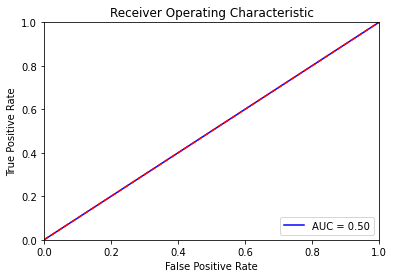

{'max_depth': 7, 'min_samples_leaf': 8}
Mejor ROC-AUC en validación cruzada: 0.579
Mejor valor del hiperparámetro: {'max_depth': 7, 'min_samples_leaf': 8}
0.6
[[11  9]
 [ 7 13]]
Sensibilidad, Accuracy, Especifididad, f1-score 0.65 0.6 0.55 0.6190476190476191


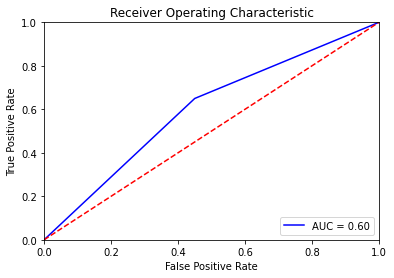

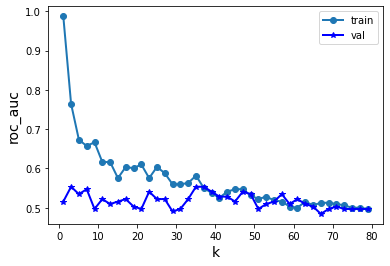

Mayor valor de la figura de mérito en validación con características estandarizadas: 0.553
Valor correspondiente para el hiperparámetro: {'n_neighbors': 3}
0.55
[[11  9]
 [ 9 11]]
Sensibilidad, Accuracy, Especificidad, f1-score 0.55 0.55 0.55 0.55


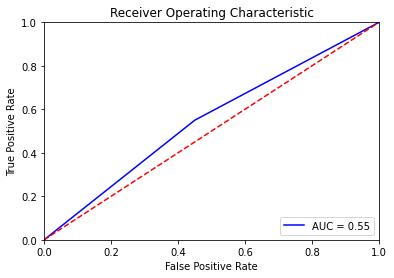

Valor correspondiente para el hiperparámetro: {'C': 50, 'gamma': 0.001, 'kernel': 'rbf'}
Mayor valor de la figura de mérito en validación con características estandarizadas: 0.509
0.5
[[16  4]
 [16  4]]
Sensibilidad, Accuracy, Especificidad, f1-score 0.2 0.5 0.8 0.28571428571428575


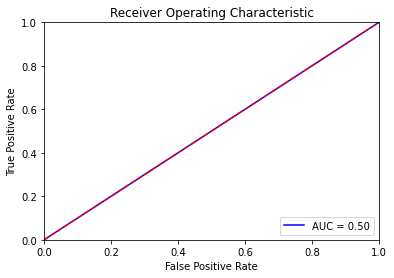

Valor correspondiente para el hiperparámetro: {'C': 0.1, 'gamma': 0.01, 'kernel': 'linear'}
Mayor valor de la figura de mérito en validación con características estandarizadas: 0.509
0.525
[[16  4]
 [15  5]]
Sensibilidad, Accuracy, Especificidad, f1-score 0.25 0.525 0.8 0.3448275862068966


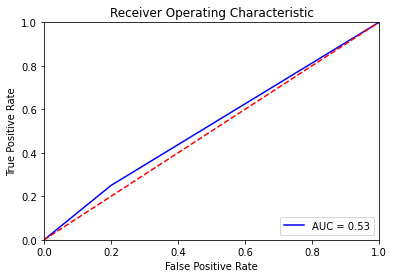

In [103]:
r=regresion_logistica(X_train_0,X_test_0,Y_train_0,Y_test_0,0)
recall_reg.append(r[0])
accuracy_reg.append(r[1])
precision_reg.append(r[2])
f1_reg.append(r[3])
roc_reg.append(r[4])

a=decisionTree(X_train_0,X_test_0,Y_train_0,Y_test_0,0)
recall_arbol.append(a[0])
accuracy_arbol.append(a[1])
precision_arbol.append(a[2])
f1_arbol.append(a[3])
roc_arbol.append(a[4])

k=knn(X_train_0,X_test_0,Y_train_0,Y_test_0)
recall_knn.append(k[0])
accuracy_knn.append(k[1])
precision_knn.append(k[2])
f1_knn.append(k[3])
roc_knn.append(k[4])

s=svc(X_train_0,X_test_0,Y_train_0,Y_test_0,0)
recall_svc.append(s[0])
accuracy_svc.append(s[1])
precision_svc.append(s[2])
f1_svc.append(s[3])
roc_svc.append(s[4])

sl=svc_lineal(X_train_0,X_test_0,Y_train_0,Y_test_0,0)
recall_svc_lin.append(sl[0])
accuracy_svc_lin.append(sl[1])
precision_svc_lin.append(sl[2])
f1_svc_lin.append(sl[3])
roc_svc_lin.append(sl[4])


# ***Segunda partición***

In [104]:
X_train_1=list_x_train[1]
Y_train_1=list_y_train[1]
X_test_1=list_x_test[1]
Y_test_1=list_y_test[1]

In [105]:
X_train_1.isna().sum()

A01AB    0
A02AH    0
A02BA    0
A02BC    0
A03BA    0
        ..
S01GX    0
S01XA    0
V03AN    0
V09CX    0
V09XX    0
Length: 200, dtype: int64

A continuación, aplicacmos los modelos:

Valor correspondiente para el hiperparámetro: {'C': 40, 'penalty': 'l1'}
Mayor valor de la figura de mérito en validación con características estandarizadas: 0.503
0.6
[[13  7]
 [ 9 11]]
Sensibilidad, Accuracy, Especificidad, f1-score 0.55 0.6 0.65 0.5789473684210527


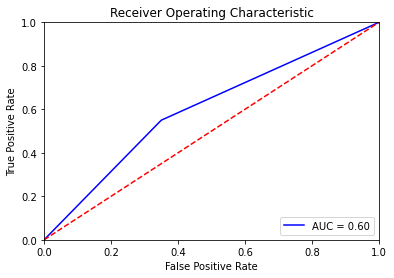

{'max_depth': 1, 'min_samples_leaf': 26}
Mejor ROC-AUC en validación cruzada: 0.553
Mejor valor del hiperparámetro: {'max_depth': 1, 'min_samples_leaf': 26}
0.5
[[ 2 18]
 [ 2 18]]
Sensibilidad, Accuracy, Especifididad, f1-score 0.9 0.5 0.1 0.6428571428571429


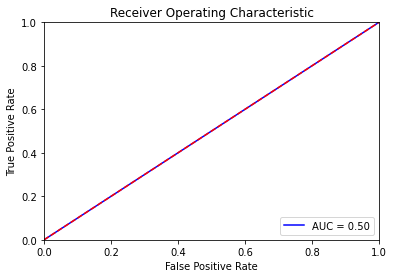

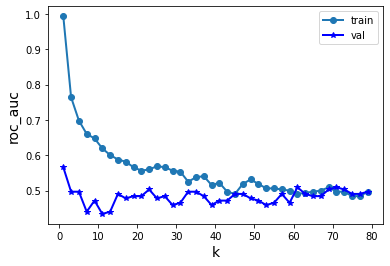

Mayor valor de la figura de mérito en validación con características estandarizadas: 0.566
Valor correspondiente para el hiperparámetro: {'n_neighbors': 1}
0.575
[[11  9]
 [ 8 12]]
Sensibilidad, Accuracy, Especificidad, f1-score 0.6 0.575 0.55 0.5853658536585366


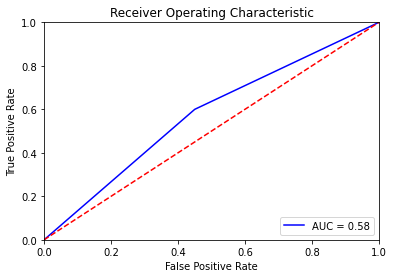

Valor correspondiente para el hiperparámetro: {'C': 25, 'gamma': 0.01, 'kernel': 'rbf'}
Mayor valor de la figura de mérito en validación con características estandarizadas: 0.522
0.675
[[15  5]
 [ 8 12]]
Sensibilidad, Accuracy, Especificidad, f1-score 0.6 0.675 0.75 0.6486486486486486


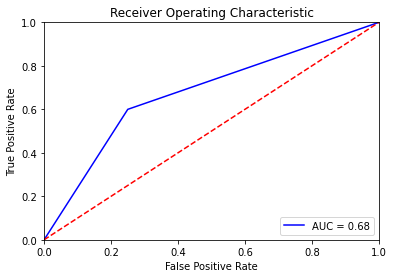

Valor correspondiente para el hiperparámetro: {'C': 25, 'gamma': 0.01, 'kernel': 'linear'}
Mayor valor de la figura de mérito en validación con características estandarizadas: 0.528
0.6
[[12  8]
 [ 8 12]]
Sensibilidad, Accuracy, Especificidad, f1-score 0.6 0.6 0.6 0.6


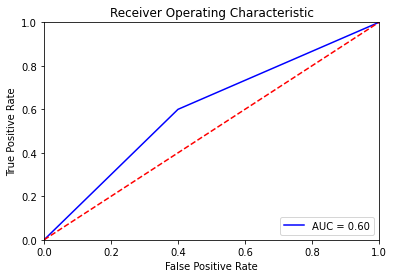

In [106]:
r=regresion_logistica(X_train_1,X_test_1,Y_train_1,Y_test_1,1)
recall_reg.append(r[0])
accuracy_reg.append(r[1])
precision_reg.append(r[2])
f1_reg.append(r[3])
roc_reg.append(r[4])

a=decisionTree(X_train_1,X_test_1,Y_train_1,Y_test_1,1)
recall_arbol.append(a[0])
accuracy_arbol.append(a[1])
precision_arbol.append(a[2])
f1_arbol.append(a[3])
roc_arbol.append(a[4])

k=knn(X_train_1,X_test_1,Y_train_1,Y_test_1)
recall_knn.append(k[0])
accuracy_knn.append(k[1])
precision_knn.append(k[2])
f1_knn.append(k[3])
roc_knn.append(k[4])

s=svc(X_train_1,X_test_1,Y_train_1,Y_test_1,1)
recall_svc.append(s[0])
accuracy_svc.append(s[1])
precision_svc.append(s[2])
f1_svc.append(s[3])
roc_svc.append(s[4])

sl=svc_lineal(X_train_1,X_test_1,Y_train_1,Y_test_1,1)
recall_svc_lin.append(sl[0])
accuracy_svc_lin.append(sl[1])
precision_svc_lin.append(sl[2])
f1_svc_lin.append(sl[3])
roc_svc_lin.append(sl[4])

# ***Tercera partición***

In [47]:
X_train_2=list_x_train[2]
Y_train_2=list_y_train[2]
X_test_2=list_x_test[2]
Y_test_2=list_y_test[2]

In [48]:
X_train_2.isna().sum()

A01AB    0
A02AH    0
A02BA    0
A02BC    0
A03BA    0
        ..
S01GX    0
S01XA    0
V03AN    0
V09CX    0
V09XX    0
Length: 200, dtype: int64

A continuación, aplicacmos los modelos:

Valor correspondiente para el hiperparámetro: {'C': 1, 'penalty': 'l1'}
Mayor valor de la figura de mérito en validación con características estandarizadas: 0.553
0.5
[[12  8]
 [12  8]]
Sensibilidad, Accuracy, Especificidad, f1-score 0.4 0.5 0.6 0.4444444444444445


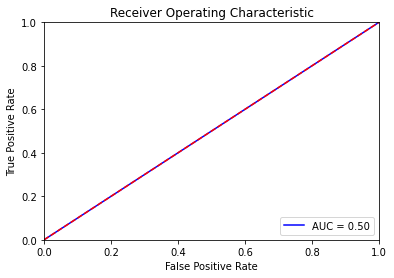

{'max_depth': 1, 'min_samples_leaf': 14}
Mejor ROC-AUC en validación cruzada: 0.585
Mejor valor del hiperparámetro: {'max_depth': 1, 'min_samples_leaf': 14}
0.55
[[19  1]
 [17  3]]
Sensibilidad, Accuracy, Especifididad, f1-score 0.15 0.55 0.95 0.24999999999999997


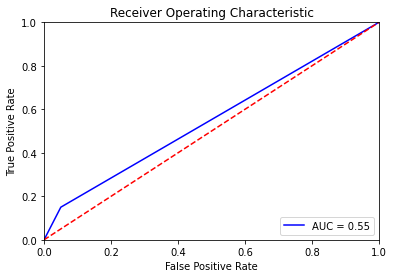

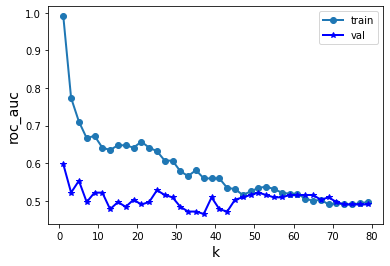

Mayor valor de la figura de mérito en validación con características estandarizadas: 0.597
Valor correspondiente para el hiperparámetro: {'n_neighbors': 1}
0.5
[[11  9]
 [11  9]]
Sensibilidad, Accuracy, Especificidad, f1-score 0.45 0.5 0.55 0.4736842105263158


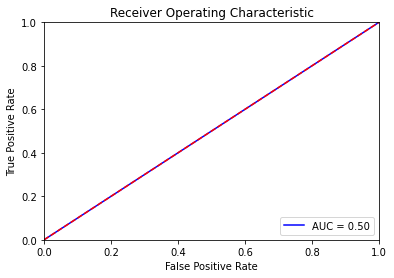

Valor correspondiente para el hiperparámetro: {'C': 25, 'gamma': 0.01, 'kernel': 'rbf'}
Mayor valor de la figura de mérito en validación con características estandarizadas: 0.591
0.45
[[11  9]
 [13  7]]
Sensibilidad, Accuracy, Especificidad, f1-score 0.35 0.45 0.55 0.38888888888888884


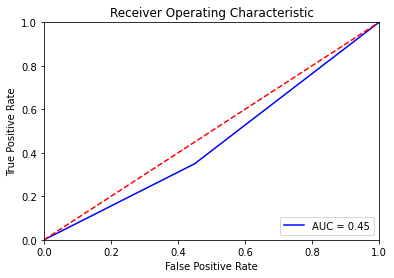

Valor correspondiente para el hiperparámetro: {'C': 0.1, 'gamma': 0.01, 'kernel': 'linear'}
Mayor valor de la figura de mérito en validación con características estandarizadas: 0.584
0.45
[[13  7]
 [15  5]]
Sensibilidad, Accuracy, Especificidad, f1-score 0.25 0.45 0.65 0.3125


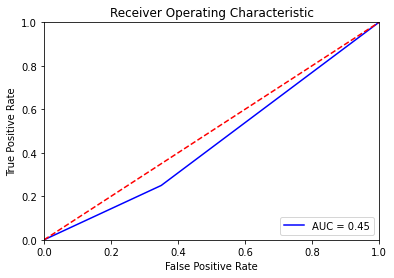

In [49]:
r=regresion_logistica(X_train_2,X_test_2,Y_train_2,Y_test_2,2)
recall_reg.append(r[0])
accuracy_reg.append(r[1])
precision_reg.append(r[2])
f1_reg.append(r[3])
roc_reg.append(r[4])

a=decisionTree(X_train_2,X_test_2,Y_train_2,Y_test_2,2)
recall_arbol.append(a[0])
accuracy_arbol.append(a[1])
precision_arbol.append(a[2])
f1_arbol.append(a[3])
roc_arbol.append(a[4])


k=knn(X_train_2,X_test_2,Y_train_2,Y_test_2)
recall_knn.append(k[0])
accuracy_knn.append(k[1])
precision_knn.append(k[2])
f1_knn.append(k[3])
roc_knn.append(k[4])

s=svc(X_train_2,X_test_2,Y_train_2,Y_test_2,2)
recall_svc.append(s[0])
accuracy_svc.append(s[1])
precision_svc.append(s[2])
f1_svc.append(s[3])
roc_svc.append(s[4])

sl=svc_lineal(X_train_2,X_test_2,Y_train_2,Y_test_2,2)
recall_svc_lin.append(sl[0])
accuracy_svc_lin.append(sl[1])
precision_svc_lin.append(sl[2])
f1_svc_lin.append(sl[3])
roc_svc_lin.append(sl[4])

# ***Cuarta partición***

In [50]:
X_train_3=list_x_train[3]
Y_train_3=list_y_train[3]
X_test_3=list_x_test[3]
Y_test_3=list_y_test[3]

In [51]:
X_train_3.isna().sum()

A01AB    0
A02AH    0
A02BA    0
A02BC    0
A03BA    0
        ..
S01GX    0
S01XA    0
V03AN    0
V09CX    0
V09XX    0
Length: 200, dtype: int64

A continuación, aplicacmos los modelos:

Valor correspondiente para el hiperparámetro: {'C': 1, 'penalty': 'l1'}
Mayor valor de la figura de mérito en validación con características estandarizadas: 0.503
0.525
[[12  8]
 [11  9]]
Sensibilidad, Accuracy, Especificidad, f1-score 0.45 0.525 0.6 0.48648648648648646


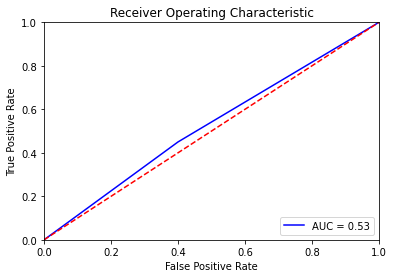

{'max_depth': 1, 'min_samples_leaf': 6}
Mejor ROC-AUC en validación cruzada: 0.503
Mejor valor del hiperparámetro: {'max_depth': 1, 'min_samples_leaf': 6}
0.5
[[20  0]
 [20  0]]
Sensibilidad, Accuracy, Especifididad, f1-score 0.0 0.5 1.0 0.0


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


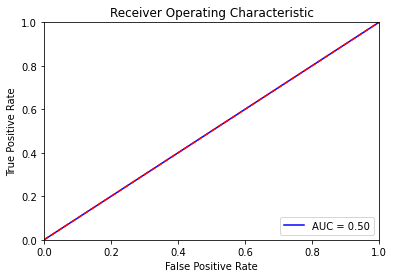

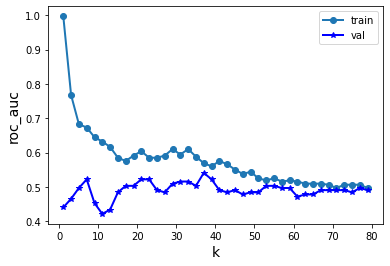

Mayor valor de la figura de mérito en validación con características estandarizadas: 0.541
Valor correspondiente para el hiperparámetro: {'n_neighbors': 37}
0.425
[[ 9 11]
 [12  8]]
Sensibilidad, Accuracy, Especificidad, f1-score 0.4 0.425 0.45 0.41025641025641024


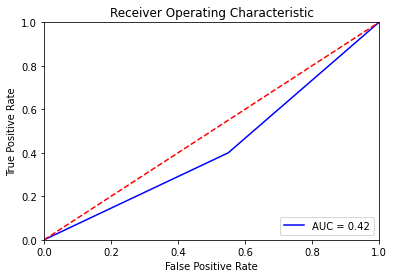

Valor correspondiente para el hiperparámetro: {'C': 0.001, 'gamma': 0.01, 'kernel': 'rbf'}
Mayor valor de la figura de mérito en validación con características estandarizadas: 0.523
0.5
[[ 0 20]
 [ 0 20]]
Sensibilidad, Accuracy, Especificidad, f1-score 1.0 0.5 0.0 0.6666666666666666


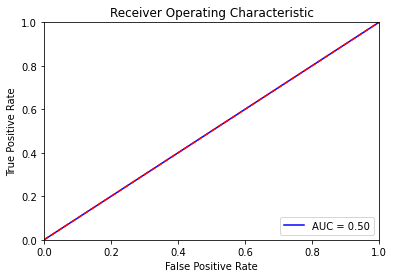

Valor correspondiente para el hiperparámetro: {'C': 0.001, 'gamma': 0.01, 'kernel': 'linear'}
Mayor valor de la figura de mérito en validación con características estandarizadas: 0.523
0.5
[[ 0 20]
 [ 0 20]]
Sensibilidad, Accuracy, Especificidad, f1-score 1.0 0.5 0.0 0.6666666666666666


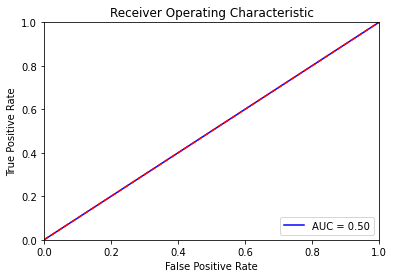

In [52]:
r=regresion_logistica(X_train_3,X_test_3,Y_train_3,Y_test_3,3)
recall_reg.append(r[0])
accuracy_reg.append(r[1])
precision_reg.append(r[2])
f1_reg.append(r[3])
roc_reg.append(r[4])

a=decisionTree(X_train_3,X_test_3,Y_train_3,Y_test_3,3)
recall_arbol.append(a[0])
accuracy_arbol.append(a[1])
precision_arbol.append(a[2])
f1_arbol.append(a[3])
roc_arbol.append(a[4])

k=knn(X_train_3,X_test_3,Y_train_3,Y_test_3)
recall_knn.append(k[0])
accuracy_knn.append(k[1])
precision_knn.append(k[2])
f1_knn.append(k[3])
roc_knn.append(k[4])

s=svc(X_train_3,X_test_3,Y_train_3,Y_test_3,3)
recall_svc.append(s[0])
accuracy_svc.append(s[1])
precision_svc.append(s[2])
f1_svc.append(s[3])
roc_svc.append(s[4])

sl=svc_lineal(X_train_3,X_test_3,Y_train_3,Y_test_3,3)
recall_svc_lin.append(sl[0])
accuracy_svc_lin.append(sl[1])
precision_svc_lin.append(sl[2])
f1_svc_lin.append(sl[3])
roc_svc_lin.append(sl[4])


# ***Quinta partición***

In [53]:
X_train_4=list_x_train[4]
Y_train_4=list_y_train[4]
X_test_4=list_x_test[4]
Y_test_4=list_y_test[4]

In [54]:
X_train_4.isna().sum()

A01AB    0
A02AH    0
A02BA    0
A02BC    0
A03BA    0
        ..
S01GX    0
S01XA    0
V03AN    0
V09CX    0
V09XX    0
Length: 200, dtype: int64

A continuación, aplicacmos los modelos:

Valor correspondiente para el hiperparámetro: {'C': 10, 'penalty': 'l1'}
Mayor valor de la figura de mérito en validación con características estandarizadas: 0.624
0.45
[[ 9 11]
 [11  9]]
Sensibilidad, Accuracy, Especificidad, f1-score 0.45 0.45 0.45 0.45


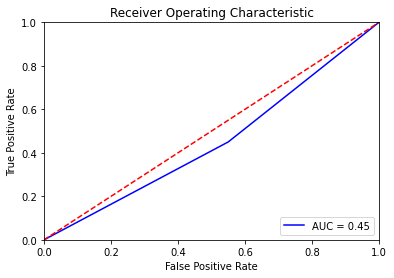

{'max_depth': 1, 'min_samples_leaf': 44}
Mejor ROC-AUC en validación cruzada: 0.547
Mejor valor del hiperparámetro: {'max_depth': 1, 'min_samples_leaf': 44}
0.325
[[ 8 12]
 [15  5]]
Sensibilidad, Accuracy, Especifididad, f1-score 0.25 0.325 0.4 0.27027027027027023


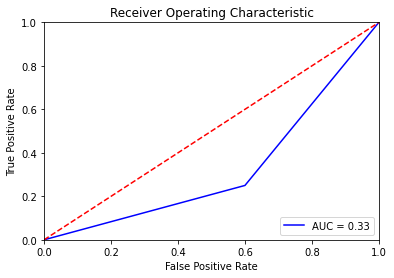

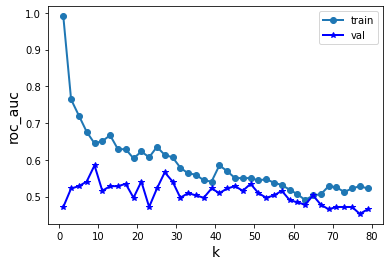

Mayor valor de la figura de mérito en validación con características estandarizadas: 0.585
Valor correspondiente para el hiperparámetro: {'n_neighbors': 9}
0.55
[[ 8 12]
 [ 6 14]]
Sensibilidad, Accuracy, Especificidad, f1-score 0.7 0.55 0.4 0.608695652173913


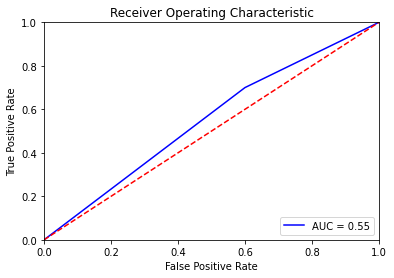

Valor correspondiente para el hiperparámetro: {'C': 1000, 'gamma': 0.01, 'kernel': 'rbf'}
Mayor valor de la figura de mérito en validación con características estandarizadas: 0.554
0.45
[[ 6 14]
 [ 8 12]]
Sensibilidad, Accuracy, Especificidad, f1-score 0.6 0.45 0.3 0.5217391304347826


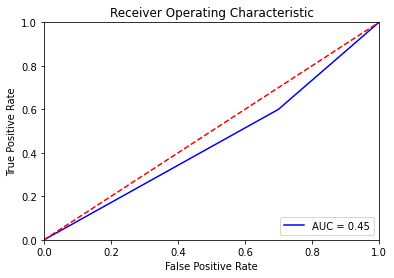

Valor correspondiente para el hiperparámetro: {'C': 50, 'gamma': 0.01, 'kernel': 'linear'}
Mayor valor de la figura de mérito en validación con características estandarizadas: 0.579
0.575
[[ 9 11]
 [ 6 14]]
Sensibilidad, Accuracy, Especificidad, f1-score 0.7 0.575 0.45 0.6222222222222222


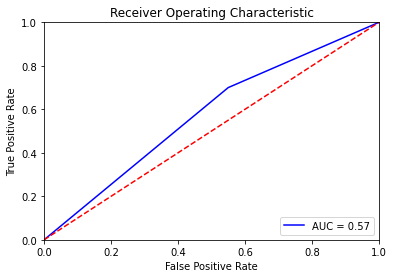

In [55]:
r=regresion_logistica(X_train_4,X_test_4,Y_train_4,Y_test_4,4)
recall_reg.append(r[0])
accuracy_reg.append(r[1])
precision_reg.append(r[2])
f1_reg.append(r[3])
roc_reg.append(r[4])

a=decisionTree(X_train_4,X_test_4,Y_train_4,Y_test_4,4)
recall_arbol.append(a[0])
accuracy_arbol.append(a[1])
precision_arbol.append(a[2])
f1_arbol.append(a[3])
roc_arbol.append(a[4])

k=knn(X_train_4,X_test_4,Y_train_4,Y_test_4)
recall_knn.append(k[0])
accuracy_knn.append(k[1])
precision_knn.append(k[2])
f1_knn.append(k[3])
roc_knn.append(k[4])

s=svc(X_train_4,X_test_4,Y_train_4,Y_test_4,4)
recall_svc.append(s[0])
accuracy_svc.append(s[1])
precision_svc.append(s[2])
f1_svc.append(s[3])
roc_svc.append(s[4])

sl=svc_lineal(X_train_4,X_test_4,Y_train_4,Y_test_4,4)
recall_svc_lin.append(sl[0])
accuracy_svc_lin.append(sl[1])
precision_svc_lin.append(sl[2])
f1_svc_lin.append(sl[3])
roc_svc_lin.append(sl[4])


In [56]:
def plot_mean_std_metric(df_metrics, lims, metric_name='accuracy', title_figure='mean_std_plot', flag_save_figure=False):

    fig, ax = plt.subplots(1, 1, figsize=(6.5, 4.5))

    ax.plot(df_metrics['mean'], df_metrics['model'], ls='', marker='o', color='#8000FF')

    ax.hlines(df_metrics['model'], df_metrics['mean'] - df_metrics['std'], df_metrics['mean'] + df_metrics['std'],
              label='', lw=2, color='#8000FF', ls='-')

    ax.grid(axis='x', ls='-')
    ax.grid(axis='y', ls=':', lw=1, alpha=0.5)
    ax.set(
        xlabel=metric_name,
        xlim=lims,
        title=title_figure
    )

    fig.tight_layout()

    if flag_save_figure:
        fig.savefig(title_figure, dpi=300, bbox_inches='tight')
    else:
        plt.show()

In [57]:

model_scaler=['LASSO', 'DT', 'KNN','Radial SVM', 'Linear SVM']
mean_scaler=[np.mean(accuracy_reg), np.mean(accuracy_arbol),np.mean(accuracy_knn),np.mean(accuracy_svc),np.mean(accuracy_svc_lin)]
std_scaler=[np.std(accuracy_reg), np.std(accuracy_arbol),np.std(accuracy_knn),np.std(accuracy_svc),np.std(accuracy_svc_lin)]

df_acc_scaler= pd.DataFrame()
df_acc_scaler['model'] = None
df_acc_scaler['mean'] = None
df_acc_scaler['std'] = None


df_acc_scaler['model'] = model_scaler
df_acc_scaler['mean'] = mean_scaler
df_acc_scaler['std'] = std_scaler


In [58]:
df_acc_scaler

,model,mean,std
0,LASSO,0.491667,0.031180
1,DT,0.458333,0.096465
2,KNN,0.491667,0.051370
3,Radial SVM,0.466667,0.023570
4,Linear SVM,0.508333,0.051370


In [59]:
model2_scaler=['LASSO', 'DT', 'KNN','Radial SVM', 'Linear SVM']
mean2_scaler=[np.mean(roc_reg), np.mean(roc_arbol),np.mean(roc_knn),np.mean(roc_svc),np.mean(roc_svc_lin)]
std2_scaler=[np.std(roc_reg), np.std(roc_arbol),np.std(roc_knn),np.std(roc_svc),np.std(roc_svc_lin)]

df_roc_scaler= pd.DataFrame()
df_roc_scaler['model'] = None
df_roc_scaler['mean'] = None
df_roc_scaler['std'] = None


df_roc_scaler['model'] = model2_scaler
df_roc_scaler['mean'] = mean2_scaler
df_roc_scaler['std'] = std2_scaler


In [60]:
df_roc_scaler

,model,mean,std
0,LASSO,0.491667,0.031180
1,DT,0.458333,0.096465
2,KNN,0.491667,0.051370
3,Radial SVM,0.466667,0.023570
4,Linear SVM,0.508333,0.051370


In [61]:
#PINTAMOS GRÁFICAS PARA VARIABLES NORMALIZADAS CON STANDARD SCALER PARA ACCURACY Y ROC

plot_mean_std_metric(df_acc_scaler, lims=(0, 0.9), metric_name='',title_figure='', flag_save_figure=True)
# plt.rcParams["figure.figsize"] = (4, 3)
plt.savefig("{}.pdf".format("Medication_acc"))
plt.close()

# plot_mean_std_metric(df_roc_scaler, lims=(0, 0.9), metric_name='',title_figure='', flag_save_figure=True)
# # plt.rcParams["figure.figsize"] = (4, 3)
# plt.savefig("{}.pdf".format("Att_auc"))
# plt.close()

In [62]:
#RECALL
model_scaler3=['LASSO', 'DT', 'KNN','Radial SVM', 'Linear SVM']
mean_scaler3=[np.mean(recall_reg), np.mean(recall_arbol),np.mean(recall_knn),np.mean(recall_svc),np.mean(recall_svc_lin)]
std_scaler3=[np.std(recall_reg), np.std(recall_arbol),np.std(recall_knn),np.std(recall_svc),np.std(recall_svc_lin)]

df_recall_scaler= pd.DataFrame()
df_recall_scaler['model'] = None
df_recall_scaler['mean'] = None
df_recall_scaler['std'] = None


df_recall_scaler['model'] = model_scaler3
df_recall_scaler['mean'] = mean_scaler3
df_recall_scaler['std'] = std_scaler3

In [63]:
df_recall_scaler

,model,mean,std
0,LASSO,0.433333,0.023570
1,DT,0.133333,0.102740
2,KNN,0.516667,0.131233
3,Radial SVM,0.650000,0.267706
4,Linear SVM,0.650000,0.308221


In [64]:
model_scaler4=['LASSO', 'DT', 'KNN','Radial SVM', 'Linear SVM']
mean_scaler4=[np.mean(precision_reg), np.mean(precision_arbol),np.mean(precision_knn),np.mean(precision_svc),np.mean(precision_svc_lin)]
std_scaler4=[np.std(precision_reg), np.std(precision_arbol),np.std(precision_knn),np.std(precision_svc),np.std(precision_svc_lin)]

df_especificidad_scaler= pd.DataFrame()
df_especificidad_scaler['model'] = None
df_especificidad_scaler['mean'] = None
df_especificidad_scaler['std'] = None


df_especificidad_scaler['model'] = model_scaler4
df_especificidad_scaler['mean'] = mean_scaler4
df_especificidad_scaler['std'] = std_scaler4

In [65]:
df_especificidad_scaler


,model,mean,std
0,LASSO,0.550000,0.070711
1,DT,0.783333,0.271825
2,KNN,0.466667,0.062361
3,Radial SVM,0.283333,0.224846
4,Linear SVM,0.366667,0.271825


# ***VALIDACIÓN CRUZADA Y FEATURE SELECTION***

# ***Boostrap***

In [ ]:
data2=data_final.rename(columns={"BCaseControlStatus":"label"})

In [ ]:
def compute_boostrap(df_data, v_column_names, label_name, generic_name, percentage_resampling=0.8, repetitions=30, flag_save_importance=False):

    list_variable_importance = []

    for i in range(len(v_column_names)):
        list_variable_importance.append(bootstrap_ci(df_data, v_column_names[i], (1 / percentage_resampling),
                                                     label_name, repetitions=repetitions))

    m_variable_importance = np.array(list_variable_importance)
    m_variable_importance = m_variable_importance.reshape(m_variable_importance.shape[0], 2)

    m_var_importance_bootstrap = np.c_[v_column_names, m_variable_importance]
    df_var_importance_bootstrap = pd.DataFrame(m_var_importance_bootstrap, columns=['var_name', 'ci_lower', 'ci_upper'])

    if flag_save_importance:
        df_var_importance_bootstrap.to_csv('df_var_importance_boostrap_{}.csv'.format(generic_name))


def bootstrap_ci(df_data, variable, div, classes, repetitions=3000, alpha=0.05, random_state=np.arange(1, 30000, 10)):
    """
    Compute bootstrap method with confidence interval
    :param df_data: a dataframe that includes observations of the two sample (df models)
    :param variable: a column_name of the column that includes observations (sens, espec,acc,precision,auc)
    :param div:
    :param classes: a column_name of the column that includes classes (This column should contain two different group names: dt and lasso, dt and svm, svm and lasso)
    :param repetitions: the number of times you want the bootstrapping to repeat. Default is 1000.
    :param alpha: likelihood that the true population parameter lies outside the confidence interval. Default is 0.05.
    :param random_state: enable users to set their own random_state, default is None
    :return:
    """
    df = df_data[[variable, classes]]
    bootstrap_sample_size = len(df)

    proportion_diffs = []
    print("sample size: ", int(bootstrap_sample_size/div))

    for i in range(repetitions):

        bootstrap_sample = df.sample(n=int(bootstrap_sample_size/div), replace=False, random_state=random_state[i])

        print(bootstrap_sample)

        label_0 = (bootstrap_sample[(bootstrap_sample[classes] == 0)])
        mean_label_0 = label_0[variable].mean()
        label_1 = (bootstrap_sample[(bootstrap_sample[classes] == 1)])
        mean_label_1 = label_1[variable].mean()

        proportion_diff = mean_label_1 - mean_label_0
        proportion_diffs.append(proportion_diff)

        df_proportions = pd.DataFrame(proportion_diffs)

    out = []

    for tt in range(len(df_proportions.columns)):

        left = np.percentile(df_proportions[tt], alpha / 2 * 100)
        right = np.percentile(df_proportions[tt], 100 - alpha / 2 * 100)
        out.append([round(left, 2), round(right, 2)])

    return out

In [ ]:
compute_boostrap(data2,X.columns, 'label', 'importance_bootstrap', flag_save_importance=True)




Se han truncado las últimas 5000 líneas del flujo de salida.
119      0      0
24       0      1
140      0      1

[159 rows x 2 columns]
     R07AX  label
96       0      0
63       0      1
168      0      1
195      0      0
68       0      0
..     ...    ...
111      0      0
95       0      1
21       0      0
31       0      1
94       0      0

[159 rows x 2 columns]
     R07AX  label
35       0      1
88       0      0
156      0      1
7        0      1
176      0      0
..     ...    ...
38       0      1
136      0      0
109      0      1
117      0      1
17       0      0

[159 rows x 2 columns]
     R07AX  label
85       0      0
62       0      1
86       0      1
169      0      1
128      0      1
..     ...    ...
52       0      1
39       0      0
165      0      0
112      0      0
132      0      1

[159 rows x 2 columns]
     R07AX  label
108      0      0
122      0      1
28       0      0
132      0      1
69       0      1
..     ...    ...
96       0     

# ***PRIMERA PARTICIÓN***

In [ ]:
X_train_0=list_x_train[0]
Y_train_0=list_y_train[0]
X_test_0=list_x_test[0]
Y_test_0=list_y_test[0]

In [ ]:
#Concatenamos para min-max

X_train_scaler_all0=X_train_0
X_test_scaler_all0=X_test_0


# ***Métodos *embedded****

In [ ]:
from sklearn.ensemble import ExtraTreesClassifier

# Creamos un bosque aleatorio de árboles de clasificación
forest = ExtraTreesClassifier(n_estimators=250,
                              random_state=0)

# Como en árboles, no es necesario que las características estén normalizadas
# Trabajamos, por tanto, con X_train y X_test (no con las versiones estandarizadas)

forest.fit(X_train_scaler_all0, Y_train_0)
importances = forest.feature_importances_
# print(importances)
# std = np.std([tree.feature_importances_ for tree in forest.estimators_],
#              axis=0)
# indices = np.argsort(importances)[::-1]

# # Muestra el ranking en el ordenamiento
# print("Ranking de Características:")

# for f in range(X_train_scaler_all0.shape[1]):
#   print("%d. Característica %d (%f)" % (f + 1, indices[f], importances[indices[f]]))

# # Plot the impurity-based feature importances of the forest
# plt.figure()
# plt.title("Importancia de las características")
# plt.bar(range(X_train_scaler_all0.shape[1]), importances[indices],
#         color="r", align="center")
# plt.xticks(range(X_train_scaler_all0.shape[1]), indices)
# plt.xlim([-1, 80])
# plt.show()

[0.00062639 0.00330472 0.00710373 0.0187458  0.00673952 0.00198391
 0.00321374 0.00068085 0.00465212 0.00033101 0.00070052 0.00399916
 0.00113684 0.00143969 0.00157077 0.00040202 0.01659159 0.00389419
 0.01901086 0.0066381  0.00115717 0.00261815 0.00272696 0.01098528
 0.00642997 0.01769246 0.00124424 0.00060247 0.02199047 0.00442584
 0.01035695 0.01433028 0.00186512 0.01527412 0.00783371 0.01002765
 0.00764971 0.00088104 0.         0.         0.00200198 0.01381981
 0.00045939 0.00396182 0.01992199 0.00712254 0.00645798 0.0006257
 0.         0.00196807 0.00033273 0.00071531 0.0010833  0.
 0.00735489 0.00401261 0.00974792 0.00801724 0.00036295 0.00182022
 0.02121338 0.0041789  0.02355431 0.00701594 0.00306493 0.00104715
 0.00054396 0.00575214 0.01651133 0.0073392  0.00317635 0.01853504
 0.00426828 0.00394871 0.0239013  0.         0.00086591 0.01889692
 0.00772328 0.00980761 0.03224289 0.00315585 0.00052786 0.00080781
 0.01831719 0.01812691 0.00141743 0.00062173 0.00235619 0.0003809
 0.00

In [ ]:
lista_extra=[ [] for i in range(X.shape[1])]


In [ ]:
contador=0
for i in importances:
  lista_extra[contador].append(i)
  contador+=1

In [ ]:
lista_extra

[[0.0006263941785285694],
 [0.003304718887367299],
 [0.007103729470592696],
 [0.018745800627041054],
 [0.006739515686065476],
 [0.001983914031145706],
 [0.0032137391614512813],
 [0.0006808529791710831],
 [0.004652119227561559],
 [0.0003310140464952455],
 [0.0007005162744261676],
 [0.003999164997975119],
 [0.0011368403778170113],
 [0.0014396932022162324],
 [0.0015707682346030216],
 [0.0004020196575253241],
 [0.016591594976054874],
 [0.0038941937517560817],
 [0.01901085996760932],
 [0.006638102758236305],
 [0.001157174277274088],
 [0.0026181451041708895],
 [0.0027269598337489524],
 [0.010985276140835932],
 [0.006429965574076109],
 [0.01769246046117653],
 [0.0012442401743401501],
 [0.0006024676707721285],
 [0.021990468010443083],
 [0.004425837882442136],
 [0.010356950521752596],
 [0.01433028358269827],
 [0.0018651184646546518],
 [0.01527412247638565],
 [0.00783371148736298],
 [0.010027653773158725],
 [0.0076497051677617365],
 [0.0008810379113419097],
 [0.0],
 [0.0],
 [0.002001984377278511

CARACTERÍSTICAS MÁS IMPORTANTES:
* MoCALang2	
* MoCADelRec

# ***Método filter***

In [ ]:
from sklearn.feature_selection import SelectKBest, chi2, mutual_info_classif
from functools import partial

bestfeatures_Chi2 = SelectKBest(score_func=partial(mutual_info_classif,random_state=0), k='all')
fit_Chi2 = bestfeatures_Chi2.fit(X_train_scaler_all0, Y_train_0)
# fit_Chi2 = pd.Series(fit_Chi2.scores_)
# fit_Chi2.sort_values(ascending=False)

# fit_Chi2.sort_values(ascending=False).plot.bar(figsize=(40,  15))
# plt.xlim([-1, 50])

# # gráfico de barras utilizando matplotlib
# df = pd.DataFrame({'Nombre_feat':names, 'valores':fit_Chi2.scores_})
# ax = df.plot.bar(x='Nombre_feat', y='valores', rot=0, figsize=(5,5))
# # df, ax = plt.subplots(figsize=(50, 8))
# plt.title("Chi2 considerando subconjunto X train")

In [ ]:
lista_chi=[ [] for i in range(X.shape[1])]


In [ ]:
contador=0
for i in fit_Chi2.scores_:
  lista_chi[contador].append(i)
  contador+=1

In [ ]:
lista_chi

[[0.04160271537159921],
 [0.0],
 [0.0],
 [0.0],
 [0.0],
 [0.0741256082718511],
 [0.048343074942147624],
 [0.0],
 [0.0030425857737337303],
 [0.07097451408302069],
 [0.0],
 [0.00359650425218061],
 [0.0],
 [0.0],
 [0.00526403658009067],
 [0.030665469528692757],
 [0.027461711372104736],
 [0.0],
 [0.0],
 [0.0],
 [0.005056115672946282],
 [0.0],
 [0.0],
 [0.0],
 [0.028750630349702933],
 [0.1094908544861537],
 [0.03818164051600714],
 [0.0],
 [0.0],
 [0.035136618575313916],
 [0.0],
 [0.04047365575197359],
 [0.08224476025892735],
 [0.0],
 [0.013479685361777127],
 [0.011599629708136439],
 [0.0],
 [0.031455644639067915],
 [0.0],
 [0.04450761969159811],
 [0.0],
 [0.0001146087891528147],
 [0.02784407708465908],
 [0.07353441051084175],
 [0.0],
 [0.0],
 [0.0],
 [0.013198796665238932],
 [0.0],
 [0.027075570711269537],
 [0.0],
 [0.0],
 [0.0],
 [0.0009925481104882117],
 [0.0],
 [0.0],
 [0.0],
 [0.028975613468692707],
 [0.0],
 [0.0],
 [0.01703341674569736],
 [0.04858439546648663],
 [0.011290452512166649],

# ***RANDOM FOREST***

In [ ]:

from sklearn.feature_selection import SelectFromModel
from sklearn.ensemble import RandomForestClassifier


In [ ]:
feat_labels=X.columns

In [ ]:
# Create a random forest classifier
clf = RandomForestClassifier(n_estimators=250, random_state=0, n_jobs=-1)

# Train the classifier
clf.fit(X_train_scaler_all0, Y_train_0)

# # Print the name and gini importance of each feature
# for feature in zip(feat_labels, clf.feature_importances_):
#     print(feature)

importances = clf.feature_importances_
# std = np.std([tree.feature_importances_ for tree in clf.estimators_],
#              axis=0)
# indices = np.argsort(importances)[::-1]
# # Muestra el ranking en el ordenamiento
# print("Ranking de Características:")

# for f in range(X_train_scaler_all0.shape[1]):
#   print("%d. Característica %d (%f)" % (f + 1, indices[f], importances[indices[f]]))

# # Plot the impurity-based feature importances of the forest
# plt.figure()
# plt.title("Importancia de las características")
# plt.bar(range(X_train_scaler_all0.shape[1]), importances[indices],
#         color="r", align="center")
# plt.xticks(range(X_train_scaler_all0.shape[1]), indices)
# plt.xlim([-1,80])
# plt.show()


In [ ]:
lista_RF=[ [] for i in range(X.shape[1])]


In [ ]:
contador=0
for i in importances:
  lista_RF[contador].append(i)
  contador+=1

In [ ]:
lista_RF

[[0.0010897904501122155],
 [0.004286118845166642],
 [0.006578912053874298],
 [0.02079513678061513],
 [0.003854420395327187],
 [0.002307989355107928],
 [0.003352449915133444],
 [0.0010421458216770443],
 [0.0038366821302156344],
 [0.0005249401568619217],
 [0.001338174933325194],
 [0.005335673272169943],
 [0.0008203986761977347],
 [0.0012087477937367166],
 [0.001315081618930424],
 [0.0006247817078730193],
 [0.01036274690166065],
 [0.003315657759105],
 [0.020922541087414943],
 [0.007855908630757155],
 [0.00117566952500311],
 [0.0020032117775124754],
 [0.002295725177134438],
 [0.00648267910657993],
 [0.004361155116969722],
 [0.019118328102064458],
 [0.001581141571537663],
 [0.0015085331333307014],
 [0.021165760171946567],
 [0.0049236951032318056],
 [0.010666014207557186],
 [0.013596792665228152],
 [0.0014681266565082134],
 [0.01503811587919928],
 [0.00887380473650472],
 [0.010371096401839188],
 [0.00846730445634855],
 [0.0009281618785280766],
 [0.0],
 [0.0],
 [0.002788780325948716],
 [0.013

# ***Segunda partición***

In [ ]:
X_train_1=list_x_train[1]
Y_train_1=list_y_train[1]
X_test_1=list_x_test[1]
Y_test_1=list_y_test[1]


In [ ]:
#Concatenamos para min-max

X_train_scaler_all1=X_train_1
X_test_scaler_all1=X_test_1


# ***Métodos *embedded****

In [ ]:
from sklearn.ensemble import ExtraTreesClassifier

# Creamos un bosque aleatorio de árboles de clasificación
forest = ExtraTreesClassifier(n_estimators=250,
                              random_state=0)

# Como en árboles, no es necesario que las características estén normalizadas
# Trabajamos, por tanto, con X_train y X_test (no con las versiones estandarizadas)

forest.fit(X_train_scaler_all1, Y_train_1)
importances = forest.feature_importances_
# std = np.std([tree.feature_importances_ for tree in forest.estimators_],
#              axis=0)
# indices = np.argsort(importances)[::-1]

# # Muestra el ranking en el ordenamiento
# print("Ranking de Características:")

# for f in range(X_train_scaler_all1.shape[1]):
#   print("%d. Característica %d (%f)" % (f + 1, indices[f], importances[indices[f]]))

# # Plot the impurity-based feature importances of the forest
# plt.figure()
# plt.title("Importancia de las características")
# plt.bar(range(X_train_scaler_all1.shape[1]), importances[indices],
#         color="r", align="center")
# plt.xticks(range(X_train_scaler_all1.shape[1]), indices)
# plt.xlim([-1, 50])
# plt.show()

In [ ]:
contador=0
for i in importances:
  lista_extra[contador].append(i)
  contador+=1

CARACTERÍSTICAS MÁS IMPORTANTES:
- BBGAttitudeScaleCompEnroll	
- HighBGLevTakeAction	
- LowBGLevTakeAction	
- PtCurrA1cGoal

# ***Método filter***

In [ ]:
from sklearn.feature_selection import SelectKBest, chi2, mutual_info_classif

bestfeatures_Chi2 = SelectKBest(score_func=partial(mutual_info_classif,random_state=1), k='all')
fit_Chi2 = bestfeatures_Chi2.fit(X_train_scaler_all1, Y_train_1)
# fit_Chi2 = pd.Series(fit_Chi2.scores_)
# fit_Chi2.sort_values(ascending=False)

# fit_Chi2.sort_values(ascending=False).plot.bar(figsize=(45, 15))
# plt.xlim([-1, 50])
# # gráfico de barras utilizando matplotlib
# df = pd.DataFrame({'Nombre_feat':names, 'valores':fit_Chi2.scores_})
# ax = df.plot.bar(x='Nombre_feat', y='valores', rot=0, figsize=(5,5))
# # df, ax = plt.subplots(figsize=(50, 8))
# plt.title("Chi2 considerando subconjunto X train")

In [ ]:
contador=0
for i in fit_Chi2.scores_:
  lista_chi[contador].append(i)
  contador+=1

# ***RANDOM FOREST***

In [ ]:

from sklearn.feature_selection import SelectFromModel
from sklearn.ensemble import RandomForestClassifier


In [ ]:
feat_labels=X.columns

In [ ]:
# Create a random forest classifier
clf = RandomForestClassifier(n_estimators=250, random_state=0, n_jobs=-1)

# Train the classifier
clf.fit(X_train_scaler_all1, Y_train_1)

# # Print the name and gini importance of each feature
# for feature in zip(feat_labels, clf.feature_importances_):
#     print(feature)

importances = clf.feature_importances_
# std = np.std([tree.feature_importances_ for tree in clf.estimators_],
#              axis=0)
# indices = np.argsort(importances)[::-1]
# # Muestra el ranking en el ordenamiento
# print("Ranking de Características:")

# for f in range(X_train_scaler_all1.shape[1]):
#   print("%d. Característica %d (%f)" % (f + 1, indices[f], importances[indices[f]]))

# # Plot the impurity-based feature importances of the forest
# plt.figure()
# plt.title("Importancia de las características")
# plt.bar(range(X_train_scaler_all1.shape[1]), importances[indices],
#         color="r", align="center")
# plt.xticks(range(X_train_scaler_all1.shape[1]), indices)
# plt.xlim([-1, 50])
# plt.show()


In [ ]:
contador=0
for i in importances:
  lista_RF[contador].append(i)
  contador+=1

# ***Tercera partición***

In [ ]:
X_train_2=list_x_train[2]
Y_train_2=list_y_train[2]
X_test_2=list_x_test[2]
Y_test_2=list_y_test[2]

In [ ]:
#Concatenamos para min-max

X_train_scaler_all2=X_train_2
X_test_scaler_all2=X_test_2


# ***Métodos *embedded****

In [ ]:
from sklearn.ensemble import ExtraTreesClassifier

# Creamos un bosque aleatorio de árboles de clasificación
forest = ExtraTreesClassifier(n_estimators=250,
                              random_state=0)

# Como en árboles, no es necesario que las características estén normalizadas
# Trabajamos, por tanto, con X_train y X_test (no con las versiones estandarizadas)

forest.fit(X_train_scaler_all2, Y_train_2)
importances = forest.feature_importances_
# std = np.std([tree.feature_importances_ for tree in forest.estimators_],
#              axis=0)
# indices = np.argsort(importances)[::-1]

# # Muestra el ranking en el ordenamiento
# print("Ranking de Características:")

# for f in range(X_train_scaler_all2.shape[1]):
#   print("%d. Característica %d (%f)" % (f + 1, indices[f], importances[indices[f]]))

# # Plot the impurity-based feature importances of the forest
# plt.figure()
# plt.title("Importancia de las características")
# plt.bar(range(X_train_scaler_all2.shape[1]), importances[indices],
#         color="r", align="center")
# plt.xticks(range(X_train_scaler_all2.shape[1]), indices)
# plt.xlim([-1, 50])
# plt.show()

In [ ]:
contador=0
for i in importances:
  lista_extra[contador].append(i)
  contador+=1

# ***Método filter***

In [ ]:
from sklearn.feature_selection import SelectKBest, chi2, mutual_info_classif

bestfeatures_Chi2 = SelectKBest(score_func=partial(mutual_info_classif,random_state=2), k='all')
fit_Chi2 = bestfeatures_Chi2.fit(X_train_scaler_all2, Y_train_2)
# fit_Chi2 = pd.Series(fit_Chi2.scores_)
# fit_Chi2.sort_values(ascending=False)

# fit_Chi2.sort_values(ascending=False).plot.bar(figsize=(45, 15))
# plt.xlim([-1, 50])

# # gráfico de barras utilizando matplotlib
# df = pd.DataFrame({'Nombre_feat':names, 'valores':fit_Chi2.scores_})
# ax = df.plot.bar(x='Nombre_feat', y='valores', rot=0, figsize=(5,5))
# # df, ax = plt.subplots(figsize=(50, 8))
# plt.title("Chi2 considerando subconjunto X train")

In [ ]:
contador=0
for i in fit_Chi2.scores_:
  lista_chi[contador].append(i)
  contador+=1

# ***RANDOM FOREST***

In [ ]:

from sklearn.feature_selection import SelectFromModel
from sklearn.ensemble import RandomForestClassifier


In [ ]:
feat_labels=X.columns

In [ ]:
# Create a random forest classifier
clf = RandomForestClassifier(n_estimators=250, random_state=0, n_jobs=-1)

# Train the classifier
clf.fit(X_train_scaler_all2, Y_train_2)

# # Print the name and gini importance of each feature
# for feature in zip(feat_labels, clf.feature_importances_):
#     print(feature)

importances = clf.feature_importances_
# std = np.std([tree.feature_importances_ for tree in clf.estimators_],
#              axis=0)
# indices = np.argsort(importances)[::-1]
# # Muestra el ranking en el ordenamiento
# print("Ranking de Características:")

# for f in range(X_train_scaler_all2.shape[1]):
#   print("%d. Característica %d (%f)" % (f + 1, indices[f], importances[indices[f]]))

# # Plot the impurity-based feature importances of the forest
# plt.figure()
# plt.title("Importancia de las características")
# plt.bar(range(X_train_scaler_all2.shape[1]), importances[indices],
#         color="r",  align="center")
# plt.xticks(range(X_train_scaler_all2.shape[1]), indices)
# plt.xlim([-1, 50])
# plt.show()


In [ ]:
contador=0
for i in importances:
  lista_RF[contador].append(i)
  contador+=1

# ***Cuarta partición***

In [ ]:
X_train_3=list_x_train[3]
Y_train_3=list_y_train[3]
X_test_3=list_x_test[3]
Y_test_3=list_y_test[3]

In [ ]:
#Concatenamos para min-max

X_train_scaler_all3=X_train_3
X_test_scaler_all3=X_test_3


# ***Métodos *embedded****

In [ ]:
from sklearn.ensemble import ExtraTreesClassifier

# Creamos un bosque aleatorio de árboles de clasificación
forest = ExtraTreesClassifier(n_estimators=250,
                              random_state=0)

# Como en árboles, no es necesario que las características estén normalizadas
# Trabajamos, por tanto, con X_train y X_test (no con las versiones estandarizadas)

forest.fit(X_train_scaler_all3, Y_train_3)
importances = forest.feature_importances_
# std = np.std([tree.feature_importances_ for tree in forest.estimators_],
#              axis=0)
# indices = np.argsort(importances)[::-1]

# # Muestra el ranking en el ordenamiento
# print("Ranking de Características:")

# for f in range(X_train_scaler_all3.shape[1]):
#   print("%d. Característica %d (%f)" % (f + 1, indices[f], importances[indices[f]]))

# # Plot the impurity-based feature importances of the forest
# plt.figure()
# plt.title("Importancia de las características")
# plt.bar(range(X_train_scaler_all3.shape[1]), importances[indices],
#         color="r", align="center")
# plt.xticks(range(X_train_scaler_all3.shape[1]), indices)
# plt.xlim([-1, 50])
# plt.show()

In [ ]:
contador=0
for i in importances:
  lista_extra[contador].append(i)
  contador+=1

# ***Método filter***

In [ ]:
from sklearn.feature_selection import SelectKBest, chi2, mutual_info_classif

bestfeatures_Chi2 = SelectKBest(score_func=partial(mutual_info_classif,random_state=3), k='all')
fit_Chi2 = bestfeatures_Chi2.fit(X_train_scaler_all3, Y_train_3)
# fit_Chi2 = pd.Series(fit_Chi2.scores_)
# fit_Chi2.sort_values(ascending=False)

# fit_Chi2.sort_values(ascending=False).plot.bar(figsize=(45, 15))
# plt.xlim([-1, 50])

# # gráfico de barras utilizando matplotlib
# df = pd.DataFrame({'Nombre_feat':names, 'valores':fit_Chi2.scores_})
# ax = df.plot.bar(x='Nombre_feat', y='valores', rot=0, figsize=(5,5))
# # df, ax = plt.subplots(figsize=(50, 8))
# plt.title("Chi2 considerando subconjunto X train")

In [ ]:
contador=0
for i in fit_Chi2.scores_:
  lista_chi[contador].append(i)
  contador+=1

# ***RANDOM FOREST***

In [ ]:

from sklearn.feature_selection import SelectFromModel
from sklearn.ensemble import RandomForestClassifier


In [ ]:
feat_labels=X.columns

In [ ]:
# Create a random forest classifier
clf = RandomForestClassifier(n_estimators=250, random_state=0, n_jobs=-1)

# Train the classifier
clf.fit(X_train_scaler_all3, Y_train_3)

# # Print the name and gini importance of each feature
# for feature in zip(feat_labels, clf.feature_importances_):
#     print(feature)

importances = clf.feature_importances_
# std = np.std([tree.feature_importances_ for tree in clf.estimators_],
#              axis=0)
# indices = np.argsort(importances)[::-1]
# # Muestra el ranking en el ordenamiento
# print("Ranking de Características:")

# for f in range(X_train_scaler_all3.shape[1]):
#   print("%d. Característica %d (%f)" % (f + 1, indices[f], importances[indices[f]]))

# # Plot the impurity-based feature importances of the forest
# plt.figure()
# plt.title("Importancia de las características")
# plt.bar(range(X_train_scaler_all3.shape[1]), importances[indices],
#         color="r", align="center")
# plt.xticks(range(X_train_scaler_all3.shape[1]), indices)
# plt.xlim([-1, 50])
# plt.show()


In [ ]:
contador=0
for i in importances:
  lista_RF[contador].append(i)
  contador+=1

# ***Quinta partición***

In [ ]:
X_train_4=list_x_train[4]
Y_train_4=list_y_train[4]
X_test_4=list_x_test[4]
Y_test_4=list_y_test[4]

In [ ]:
#Concatenamos para min-max

X_train_scaler_all4=X_train_4
X_test_scaler_all4=X_test_4


# ***Métodos *embedded****

In [ ]:
from sklearn.ensemble import ExtraTreesClassifier

# Creamos un bosque aleatorio de árboles de clasificación
forest = ExtraTreesClassifier(n_estimators=250,
                              random_state=0)

# Como en árboles, no es necesario que las características estén normalizadas
# Trabajamos, por tanto, con X_train y X_test (no con las versiones estandarizadas)

forest.fit(X_train_scaler_all4, Y_train_4)
importances = forest.feature_importances_
# std = np.std([tree.feature_importances_ for tree in forest.estimators_],
#              axis=0)
# indices = np.argsort(importances)[::-1]

# # Muestra el ranking en el ordenamiento
# print("Ranking de Características:")

# for f in range(X_train_scaler_all4.shape[1]):
#   print("%d. Característica %d (%f)" % (f + 1, indices[f], importances[indices[f]]))

# # Plot the impurity-based feature importances of the forest
# plt.figure()
# plt.title("Importancia de las características")
# plt.bar(range(X_train_scaler_all4.shape[1]), importances[indices],
#         color="r", align="center")
# plt.xticks(range(X_train_scaler_all4.shape[1]), indices)
# plt.xlim([-1, 50])
# plt.show()

In [ ]:
contador=0
for i in importances:
  lista_extra[contador].append(i)
  contador+=1

In [ ]:
for i in range(len(lista_extra)):
  lista_extra[i]=np.mean(lista_extra[i])

In [ ]:
lista_extra

[0.0006367741993966052,
 0.002010003359135722,
 0.004482798500638309,
 0.017644897979716603,
 0.00417829306425765,
 0.0014493262891511819,
 0.003969557954898359,
 0.0005922849202179256,
 0.005449190212602729,
 0.0005781061908478829,
 0.0013283081494020678,
 0.0056966152036580535,
 0.0011767112693771723,
 0.0012779782788407456,
 0.008539620048225487,
 0.00027773366888148184,
 0.012250248733086985,
 0.003997959729299069,
 0.022040115138790586,
 0.004723439811725242,
 0.0007754748691615537,
 0.0032948605897003534,
 0.004166694407143415,
 0.010336544651228564,
 0.005999063861707246,
 0.01808498937822107,
 0.0013627651230155818,
 0.000589354886380423,
 0.025916621300436482,
 0.004954655378625246,
 0.010105786167126592,
 0.011532867721246858,
 0.003336830870463871,
 0.014237260727897397,
 0.008190867778085092,
 0.010299926659020374,
 0.005927028132079673,
 0.0008044131585534145,
 0.0011938158523790861,
 0.0005457092096909232,
 0.0025313930655138173,
 0.011591311467811,
 0.0006730069227805026

In [ ]:
lista_chi

[0.008320543074319842,
 0.008394210218633891,
 0.0,
 0.010830135280144848,
 0.010545161572523254,
 0.016861434817934073,
 0.03458216191507937,
 0.020595925858196383,
 0.023829832184561937,
 0.03361833405963437,
 0.0007337867139786347,
 0.013626832757027784,
 0.00978498278310247,
 0.010963881566714972,
 0.01348641250151963,
 0.011317016857481432,
 0.016534545240211918,
 0.004531679945834144,
 0.032866191467144514,
 0.0017793258519768873,
 0.010075535951738646,
 0.0,
 0.01318482542822803,
 0.0,
 0.005836199211677329,
 0.039989631383977466,
 0.023504120459679402,
 0.010322670925504252,
 0.0,
 0.013114104744299837,
 0.006848318583227408,
 0.02782813727814686,
 0.03951281609584134,
 0.023932933948981237,
 0.008280748144912042,
 0.005093687939923974,
 0.013157131249590438,
 0.018631753134481954,
 0.005028526108601472,
 0.05282971113244641,
 0.014672152801407634,
 0.0075342697201283395,
 0.037373379318564125,
 0.038166578856141345,
 0.018500933270757348,
 0.0,
 0.0,
 0.0026397593330477866,
 0

Dibujo la media de las 5 particiones para información utua:

In [ ]:
fit_Chi2 = pd.Series(lista_extra, index=X.columns)
# fit_Chi2.sort_values(ascending=False)

fit_Chi2.sort_values(ascending=False).plot.bar(figsize=(45, 15))
# gráfico de barras utilizando matplotlib
# df = pd.DataFrame({'Nombre_feat':names, 'valores':fit_Chi2.scores_})
# ax = df.plot.bar(x='Nombre_feat', y='valores', rot=0, figsize=(5,5))
# # df, ax = plt.subplots(figsize=(50, 8))
# plt.title("Chi2 considerando subconjunto X train")
# indices = np.argsort(fit_Chi2)[::-1]

# plt.figure()
# # plt.title("Importancia de las características")
# plt.bar(X.columns, fit_Chi2.scores_),
#         color="r", align="center")
# plt.xticks(rotation='vertical')
# plt.xlim([-1, X_train_scaler_all0.shape[1]])
# plt.rcParams["figure.figsize"] = (5, 5)
# plt.tight_layout()
plt.savefig("{}.pdf".format("ERTCMedicamentos"))
plt.close()
# plt.show()

# ***Método filter***

In [ ]:
from sklearn.feature_selection import SelectKBest, chi2, mutual_info_classif

bestfeatures_Chi2 = SelectKBest(score_func=partial(mutual_info_classif,random_state=4), k='all')
fit_Chi2 = bestfeatures_Chi2.fit(X_train_scaler_all4, Y_train_4)
# fit_Chi2 = pd.Series(fit_Chi2.scores_)
# fit_Chi2.sort_values(ascending=False)

# fit_Chi2.sort_values(ascending=False).plot.bar(figsize=(45,  15))
# plt.xlim([-1, 50])

# # gráfico de barras utilizando matplotlib
# df = pd.DataFrame({'Nombre_feat':names, 'valores':fit_Chi2.scores_})
# ax = df.plot.bar(x='Nombre_feat', y='valores', rot=0, figsize=(5,5))
# # df, ax = plt.subplots(figsize=(50, 8))
# plt.title("Chi2 considerando subconjunto X train")

In [ ]:
contador=0
for i in fit_Chi2.scores_:
  lista_chi[contador].append(i)
  contador+=1

In [ ]:
for i in range(len(lista_chi)):
  lista_chi[i]=np.mean(lista_chi[i])

In [ ]:
lista_chi

[0.008320543074319842,
 0.008394210218633891,
 0.0,
 0.010830135280144848,
 0.010545161572523254,
 0.016861434817934073,
 0.03458216191507937,
 0.020595925858196383,
 0.023829832184561937,
 0.03361833405963437,
 0.0007337867139786347,
 0.013626832757027784,
 0.00978498278310247,
 0.010963881566714972,
 0.01348641250151963,
 0.011317016857481432,
 0.016534545240211918,
 0.004531679945834144,
 0.032866191467144514,
 0.0017793258519768873,
 0.010075535951738646,
 0.0,
 0.01318482542822803,
 0.0,
 0.005836199211677329,
 0.039989631383977466,
 0.023504120459679402,
 0.010322670925504252,
 0.0,
 0.013114104744299837,
 0.006848318583227408,
 0.02782813727814686,
 0.03951281609584134,
 0.023932933948981237,
 0.008280748144912042,
 0.005093687939923974,
 0.013157131249590438,
 0.018631753134481954,
 0.005028526108601472,
 0.05282971113244641,
 0.014672152801407634,
 0.0075342697201283395,
 0.037373379318564125,
 0.038166578856141345,
 0.018500933270757348,
 0.0,
 0.0,
 0.0026397593330477866,
 0

Dibujo la media de las 5 particiones para información utua:

In [ ]:
fit_Chi2 = pd.Series(lista_chi, index=X.columns)
# fit_Chi2.sort_values(ascending=False)

fit_Chi2.sort_values(ascending=False).plot.bar(figsize=(45, 15))
plt.savefig("{}.pdf".format("MedicamentosIM"))
plt.close()
# gráfico de barras utilizando matplotlib
# df = pd.DataFrame({'Nombre_feat':names, 'valores':fit_Chi2.scores_})
# ax = df.plot.bar(x='Nombre_feat', y='valores', rot=0, figsize=(5,5))
# # df, ax = plt.subplots(figsize=(50, 8))
# plt.title("Chi2 considerando subconjunto X train")
# indices = np.argsort(fit_Chi2)[::-1]

# plt.figure()
# # plt.title("Importancia de las características")
# plt.bar(X.columns, fit_Chi2.scores_),
#         color="r", align="center")
# plt.xticks(rotation='vertical')
# plt.xlim([-1, X_train_scaler_all0.shape[1]])
# plt.rcParams["figure.figsize"] = (5, 5)
# plt.tight_layout()
# plt.savefig("{}.pdf".format("IMutuaAttitudeScale"))
# plt.close()
# plt.show()

# ***RANDOM FOREST***

In [ ]:

from sklearn.feature_selection import SelectFromModel
from sklearn.ensemble import RandomForestClassifier


In [ ]:
feat_labels=X.columns

In [ ]:
# Create a random forest classifier
clf = RandomForestClassifier(n_estimators=250, random_state=0, n_jobs=-1)

# Train the classifier
clf.fit(X_train_scaler_all4, Y_train_4)

# Print the name and gini importance of each feature
# for feature in zip(feat_labels, clf.feature_importances_):
#     print(feature)

importances = clf.feature_importances_
# std = np.std([tree.feature_importances_ for tree in clf.estimators_],
#              axis=0)
# indices = np.argsort(importances)[::-1]
# # Muestra el ranking en el ordenamiento
# print("Ranking de Características:")

# for f in range(X_train_scaler_all4.shape[1]):
#   print("%d. Característica %d (%f)" % (f + 1, indices[f], importances[indices[f]]))

# # Plot the impurity-based feature importances of the forest
# plt.figure()
# plt.title("Importancia de las características")
# plt.bar(range(X_train_scaler_all4.shape[1]), importances[indices],
#         color="r", align="center")
# plt.xticks(range(X_train_scaler_all4.shape[1]), indices)
# plt.xlim([-1, 50])
# plt.show()


In [ ]:
contador=0
for i in importances:
  lista_RF[contador].append(i)
  contador+=1

In [ ]:
for i in range(len(lista_RF)):
  lista_RF[i]=np.mean(lista_RF[i])

Dibujo la media de las 5 particiones para información utua:

In [ ]:
fit_Chi2 = pd.Series(lista_RF, index=X.columns)
# fit_Chi2.sort_values(ascending=False)

fit_Chi2.sort_values(ascending=False).plot.bar(figsize=(45, 15))
# plt.savefig("{}.pdf".format("MedicamentosIM"))
# plt.close()
# gráfico de barras utilizando matplotlib
# df = pd.DataFrame({'Nombre_feat':names, 'valores':fit_Chi2.scores_})
# ax = df.plot.bar(x='Nombre_feat', y='valores', rot=0, figsize=(5,5))
# # df, ax = plt.subplots(figsize=(50, 8))
# plt.title("Chi2 considerando subconjunto X train")
# indices = np.argsort(fit_Chi2)[::-1]

# plt.figure()
# # plt.title("Importancia de las características")
# plt.bar(X.columns, fit_Chi2.scores_),
#         color="r", align="center")
# plt.xticks(rotation='vertical')
# plt.xlim([-1, X_train_scaler_all0.shape[1]])
# plt.rcParams["figure.figsize"] = (5, 5)
# plt.tight_layout()
plt.savefig("{}.pdf".format("RFMedicamentos"))
plt.close()
# plt.show()

# ***RESULTADOS CON FS***

In [ ]:
recall_reg_scaler = []
accuracy_reg_scaler = []
precision_reg_scaler=[]
f1_reg_scaler=[]
roc_reg_scaler= []

recall_arbol_scaler = []
accuracy_arbol_scaler = []
precision_arbol_scaler=[]
f1_arbol_scaler=[]
roc_arbol_scaler= []

recall_knn_scaler = []
accuracy_knn_scaler = []
precision_knn_scaler=[]
f1_knn_scaler=[]
roc_knn_scaler= []

recall_svc_scaler = []
accuracy_svc_scaler = []
precision_svc_scaler=[]
f1_svc_scaler=[]
roc_svc_scaler= []

recall_svc_lin_scaler = []
accuracy_svc_lin_scaler = []
precision_svc_lin_scaler=[]
f1_svc_lin_scaler=[]
roc_svc_lin_scaler= []

recall_mlp_lin_scaler = []
accuracy_mlp_lin_scaler = []
precision_mlp_lin_scaler=[]
f1_mlp_lin_scaler=[]
roc_mlp_lin_scaler= []

In [ ]:
# from sklearn.model_selection import train_test_split, cross_val_score
X_train_scaler_all0=np.array(X_train_scaler_all0)
X_test_scaler_all0=np.array(X_test_scaler_all0)
X_train_ec = X_train_scaler_all0[:,[3,16,18,25,28,32,33,43,44,60,62,68,71,74,77,80,84,85,104,108,110,144,150,163,164]]
X_test_ec = X_test_scaler_all0[:,[3,16,18,25,28,32,33,43,44,60,62,68,71,74,77,80,84,85,104,108,110,144,150,163,164]]


Valor correspondiente para el hiperparámetro: {'C': 20, 'penalty': 'l1'}
Mayor valor de la figura de mérito en validación con características estandarizadas: 0.515
0.55
[[15  5]
 [13  7]]
Sensibilidad, Accuracy, Especificidad, f1-score 0.35 0.55 0.75 0.4375


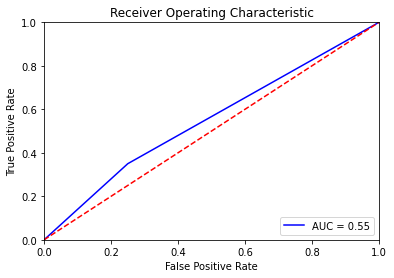

{'max_depth': 6, 'min_samples_leaf': 7}
Mejor ROC-AUC en validación cruzada: 0.579
Mejor valor del hiperparámetro: {'max_depth': 6, 'min_samples_leaf': 7}
0.675
[[16  4]
 [ 9 11]]
Sensibilidad, Accuracy, Especifididad, f1-score 0.55 0.675 0.8 0.6285714285714286


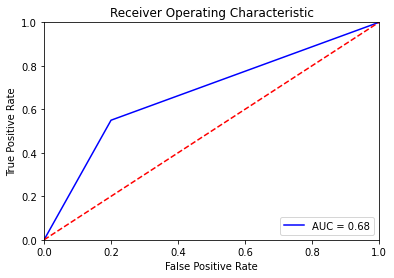

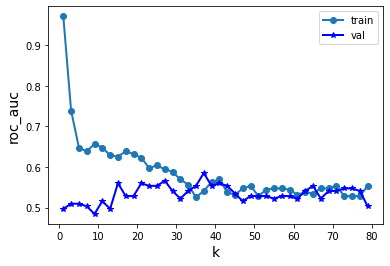

Mayor valor de la figura de mérito en validación con características estandarizadas: 0.585
Valor correspondiente para el hiperparámetro: {'n_neighbors': 37}
0.45
[[ 6 14]
 [ 8 12]]
Sensibilidad, Accuracy, Especificidad, f1-score 0.6 0.45 0.3 0.5217391304347826


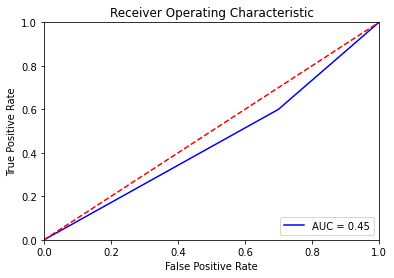

Valor correspondiente para el hiperparámetro: {'C': 10, 'gamma': 0.01, 'kernel': 'rbf'}
Mayor valor de la figura de mérito en validación con características estandarizadas: 0.565
0.5
[[13  7]
 [13  7]]
Sensibilidad, Accuracy, Especificidad, f1-score 0.35 0.5 0.65 0.4117647058823529


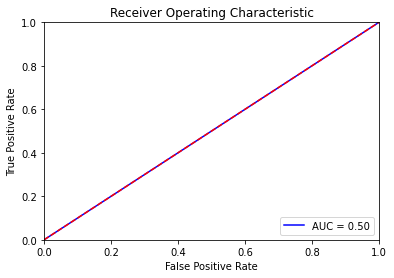

Valor correspondiente para el hiperparámetro: {'C': 1000, 'gamma': 0.01, 'kernel': 'linear'}
Mayor valor de la figura de mérito en validación con características estandarizadas: 0.565
0.525
[[15  5]
 [14  6]]
Sensibilidad, Accuracy, Especificidad, f1-score 0.3 0.525 0.75 0.3870967741935483


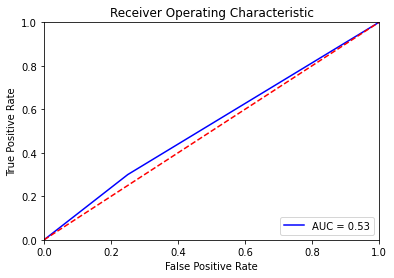

In [ ]:
#VARIABLES NORMALIZADAS CON MIN-MAX

r=regresion_logistica(X_train_ec,X_test_ec,Y_train_0,Y_test_0,0)
recall_reg_scaler.append(r[0])
accuracy_reg_scaler.append(r[1])
precision_reg_scaler.append(r[2])
f1_reg_scaler.append(r[3])
roc_reg_scaler.append(r[4])

a=decisionTree(X_train_ec,X_test_ec,Y_train_0,Y_test_0,0)
recall_arbol_scaler.append(a[0])
accuracy_arbol_scaler.append(a[1])
precision_arbol_scaler.append(a[2])
f1_arbol_scaler.append(a[3])
roc_arbol_scaler.append(a[4])

k=knn(X_train_ec,X_test_ec,Y_train_0,Y_test_0)
recall_knn_scaler.append(k[0])
accuracy_knn_scaler.append(k[1])
precision_knn_scaler.append(k[2])
f1_knn_scaler.append(k[3])
roc_knn_scaler.append(k[4])

s=svc(X_train_ec,X_test_ec,Y_train_0,Y_test_0,0)
recall_svc_scaler.append(s[0])
accuracy_svc_scaler.append(s[1])
precision_svc_scaler.append(s[2])
f1_svc_scaler.append(s[3])
roc_svc_scaler.append(s[4])

sl=svc_lineal(X_train_ec,X_test_ec,Y_train_0,Y_test_0,0)
recall_svc_lin_scaler.append(sl[0])
accuracy_svc_lin_scaler.append(sl[1])
precision_svc_lin_scaler.append(sl[2])
f1_svc_lin_scaler.append(sl[3])
roc_svc_lin_scaler.append(sl[4])

In [ ]:
# from sklearn.model_selection import train_test_split, cross_val_score
X_train_scaler_all1=np.array(X_train_scaler_all1)
X_test_scaler_all1=np.array(X_test_scaler_all1)

X_train_ec = X_train_scaler_all1[:,[3,16,18,25,28,32,33,43,44,60,62,68,71,74,77,80,84,85,104,108,110,144,150,163,164]]
X_test_ec = X_test_scaler_all1[:,[3,16,18,25,28,32,33,43,44,60,62,68,71,74,77,80,84,85,104,108,110,144,150,163,164]]


Valor correspondiente para el hiperparámetro: {'C': 1, 'penalty': 'l1'}
Mayor valor de la figura de mérito en validación con características estandarizadas: 0.548
0.725
[[15  5]
 [ 6 14]]
Sensibilidad, Accuracy, Especificidad, f1-score 0.7 0.725 0.75 0.717948717948718


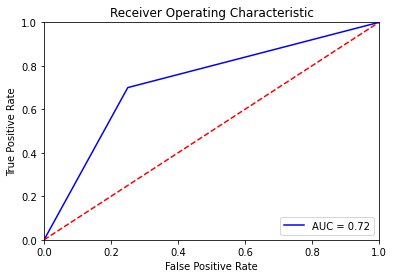

{'max_depth': 8, 'min_samples_leaf': 7}
Mejor ROC-AUC en validación cruzada: 0.572
Mejor valor del hiperparámetro: {'max_depth': 8, 'min_samples_leaf': 7}
0.675
[[15  5]
 [ 8 12]]
Sensibilidad, Accuracy, Especifididad, f1-score 0.6 0.675 0.75 0.6486486486486486


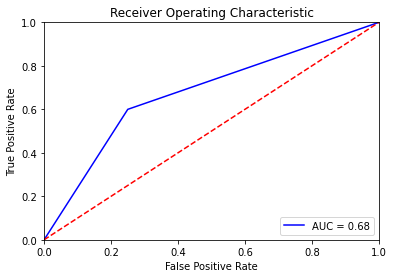

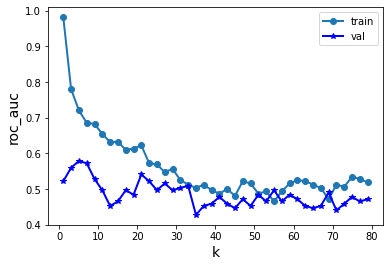

Mayor valor de la figura de mérito en validación con características estandarizadas: 0.579
Valor correspondiente para el hiperparámetro: {'n_neighbors': 5}
0.45
[[ 9 11]
 [11  9]]
Sensibilidad, Accuracy, Especificidad, f1-score 0.45 0.45 0.45 0.45


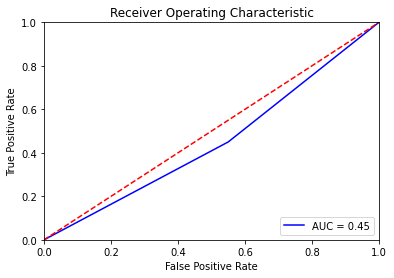

Valor correspondiente para el hiperparámetro: {'C': 100, 'gamma': 0.01, 'kernel': 'rbf'}
Mayor valor de la figura de mérito en validación con características estandarizadas: 0.566
0.575
[[11  9]
 [ 8 12]]
Sensibilidad, Accuracy, Especificidad, f1-score 0.6 0.575 0.55 0.5853658536585366


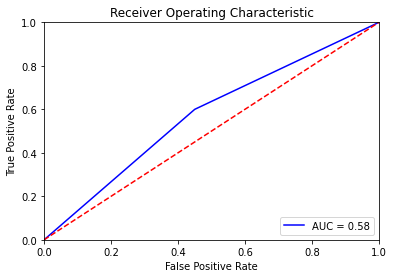

Valor correspondiente para el hiperparámetro: {'C': 10, 'gamma': 0.01, 'kernel': 'linear'}
Mayor valor de la figura de mérito en validación con características estandarizadas: 0.541
0.75
[[14  6]
 [ 4 16]]
Sensibilidad, Accuracy, Especificidad, f1-score 0.8 0.75 0.7 0.761904761904762


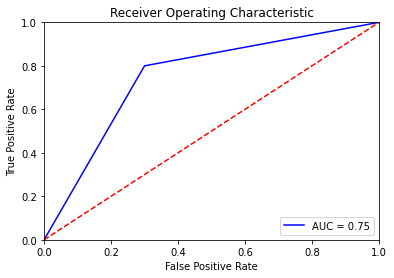

In [ ]:
#VARIABLES NORMALIZADAS CON MIN-MAX

r=regresion_logistica(X_train_ec,X_test_ec,Y_train_1,Y_test_1,1)
recall_reg_scaler.append(r[0])
accuracy_reg_scaler.append(r[1])
precision_reg_scaler.append(r[2])
f1_reg_scaler.append(r[3])
roc_reg_scaler.append(r[4])

a=decisionTree(X_train_ec,X_test_ec,Y_train_1,Y_test_1,1)
recall_arbol_scaler.append(a[0])
accuracy_arbol_scaler.append(a[1])
precision_arbol_scaler.append(a[2])
f1_arbol_scaler.append(a[3])
roc_arbol_scaler.append(a[4])

k=knn(X_train_ec,X_test_ec,Y_train_1,Y_test_1)
recall_knn_scaler.append(k[0])
accuracy_knn_scaler.append(k[1])
precision_knn_scaler.append(k[2])
f1_knn_scaler.append(k[3])
roc_knn_scaler.append(k[4])

s=svc(X_train_ec,X_test_ec,Y_train_1,Y_test_1,1)
recall_svc_scaler.append(s[0])
accuracy_svc_scaler.append(s[1])
precision_svc_scaler.append(s[2])
f1_svc_scaler.append(s[3])
roc_svc_scaler.append(s[4])

sl=svc_lineal(X_train_ec,X_test_ec,Y_train_1,Y_test_1,1)
recall_svc_lin_scaler.append(sl[0])
accuracy_svc_lin_scaler.append(sl[1])
precision_svc_lin_scaler.append(sl[2])
f1_svc_lin_scaler.append(sl[3])
roc_svc_lin_scaler.append(sl[4])


In [ ]:
# from sklearn.model_selection import train_test_split, cross_val_score
X_train_scaler_all2=np.array(X_train_scaler_all2)
X_test_scaler_all2=np.array(X_test_scaler_all2)

X_train_ec = X_train_scaler_all2[:,[3,16,18,25,28,32,33,43,44,60,62,68,71,74,77,80,84,85,104,108,110,144,150,163,164]]
X_test_ec = X_test_scaler_all2[:,[3,16,18,25,28,32,33,43,44,60,62,68,71,74,77,80,84,85,104,108,110,144,150,163,164]]


Valor correspondiente para el hiperparámetro: {'C': 20, 'penalty': 'l1'}
Mayor valor de la figura de mérito en validación con características estandarizadas: 0.641
0.6
[[13  7]
 [ 9 11]]
Sensibilidad, Accuracy, Especificidad, f1-score 0.55 0.6 0.65 0.5789473684210527


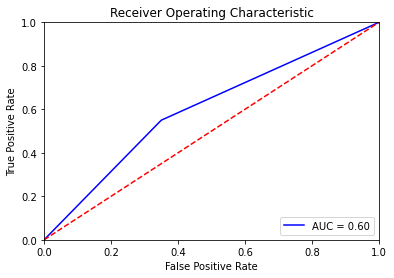

{'max_depth': 1, 'min_samples_leaf': 14}
Mejor ROC-AUC en validación cruzada: 0.585
Mejor valor del hiperparámetro: {'max_depth': 1, 'min_samples_leaf': 14}
0.55
[[19  1]
 [17  3]]
Sensibilidad, Accuracy, Especifididad, f1-score 0.15 0.55 0.95 0.24999999999999997


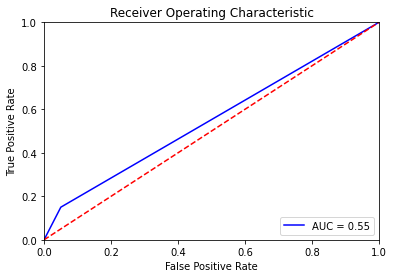

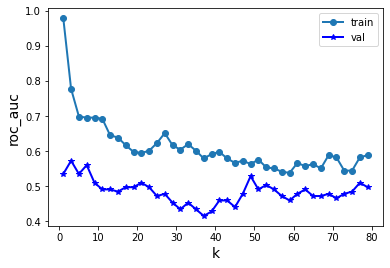

Mayor valor de la figura de mérito en validación con características estandarizadas: 0.572
Valor correspondiente para el hiperparámetro: {'n_neighbors': 3}
0.55
[[12  8]
 [10 10]]
Sensibilidad, Accuracy, Especificidad, f1-score 0.5 0.55 0.6 0.5263157894736842


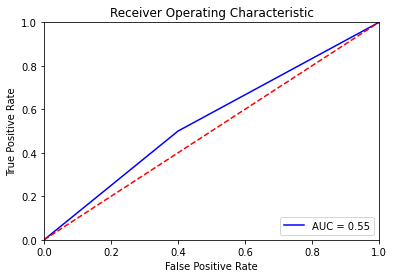

Valor correspondiente para el hiperparámetro: {'C': 1000, 'gamma': 0.001, 'kernel': 'rbf'}
Mayor valor de la figura de mérito en validación con características estandarizadas: 0.622
0.55
[[14  6]
 [12  8]]
Sensibilidad, Accuracy, Especificidad, f1-score 0.4 0.55 0.7 0.47058823529411764


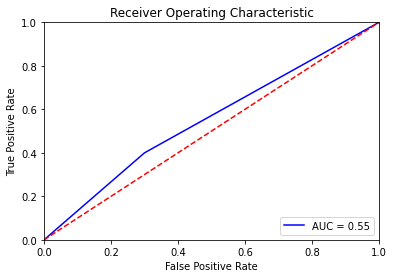

Valor correspondiente para el hiperparámetro: {'C': 0.1, 'gamma': 0.01, 'kernel': 'linear'}
Mayor valor de la figura de mérito en validación con características estandarizadas: 0.616
0.475
[[16  4]
 [17  3]]
Sensibilidad, Accuracy, Especificidad, f1-score 0.15 0.475 0.8 0.2222222222222222


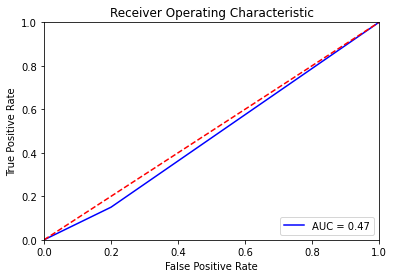

In [ ]:
# #VARIABLES NORMALIZADAS CON MIN-MAX

r=regresion_logistica(X_train_ec,X_test_ec,Y_train_2,Y_test_2,2)
recall_reg_scaler.append(r[0])
accuracy_reg_scaler.append(r[1])
precision_reg_scaler.append(r[2])
f1_reg_scaler.append(r[3])
roc_reg_scaler.append(r[4])

a=decisionTree(X_train_ec,X_test_ec,Y_train_2,Y_test_2,2)
recall_arbol_scaler.append(a[0])
accuracy_arbol_scaler.append(a[1])
precision_arbol_scaler.append(a[2])
f1_arbol_scaler.append(a[3])
roc_arbol_scaler.append(a[4])

k=knn(X_train_ec,X_test_ec,Y_train_2,Y_test_2)
recall_knn_scaler.append(k[0])
accuracy_knn_scaler.append(k[1])
precision_knn_scaler.append(k[2])
f1_knn_scaler.append(k[3])
roc_knn_scaler.append(k[4])

s=svc(X_train_ec,X_test_ec,Y_train_2,Y_test_2,2)
recall_svc_scaler.append(s[0])
accuracy_svc_scaler.append(s[1])
precision_svc_scaler.append(s[2])
f1_svc_scaler.append(s[3])
roc_svc_scaler.append(s[4])

sl=svc_lineal(X_train_ec,X_test_ec,Y_train_2,Y_test_2,2)
recall_svc_lin_scaler.append(sl[0])
accuracy_svc_lin_scaler.append(sl[1])
precision_svc_lin_scaler.append(sl[2])
f1_svc_lin_scaler.append(sl[3])
roc_svc_lin_scaler.append(sl[4])


In [ ]:
# from sklearn.model_selection import train_test_split, cross_val_score
X_train_scaler_all3=np.array(X_train_scaler_all3)
X_test_scaler_all3=np.array(X_test_scaler_all3)

X_train_ec = X_train_scaler_all3[:,[3,16,18,25,28,32,33,43,44,60,62,68,71,74,77,80,84,85,104,108,110,144,150,163,164]]
X_test_ec = X_test_scaler_all3[:,[3,16,18,25,28,32,33,43,44,60,62,68,71,74,77,80,84,85,104,108,110,144,150,163,164]]


Valor correspondiente para el hiperparámetro: {'C': 50, 'penalty': 'l1'}
Mayor valor de la figura de mérito en validación con características estandarizadas: 0.497
0.475
[[15  5]
 [16  4]]
Sensibilidad, Accuracy, Especificidad, f1-score 0.2 0.475 0.75 0.2758620689655173


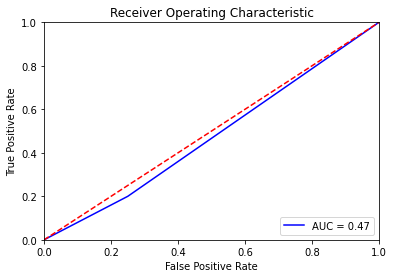

{'max_depth': 2, 'min_samples_leaf': 5}
Mejor ROC-AUC en validación cruzada: 0.528
Mejor valor del hiperparámetro: {'max_depth': 2, 'min_samples_leaf': 5}
0.475
[[17  3]
 [18  2]]
Sensibilidad, Accuracy, Especifididad, f1-score 0.1 0.475 0.85 0.16000000000000003


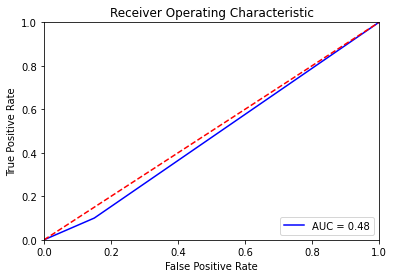

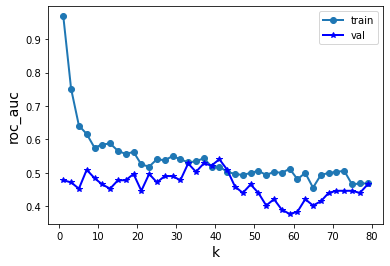

Mayor valor de la figura de mérito en validación con características estandarizadas: 0.541
Valor correspondiente para el hiperparámetro: {'n_neighbors': 41}
0.55
[[17  3]
 [15  5]]
Sensibilidad, Accuracy, Especificidad, f1-score 0.25 0.55 0.85 0.35714285714285715


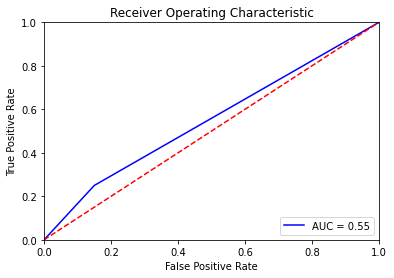

Valor correspondiente para el hiperparámetro: {'C': 1000, 'gamma': 0.001, 'kernel': 'rbf'}
Mayor valor de la figura de mérito en validación con características estandarizadas: 0.504
0.575
[[14  6]
 [11  9]]
Sensibilidad, Accuracy, Especificidad, f1-score 0.45 0.575 0.7 0.5142857142857143


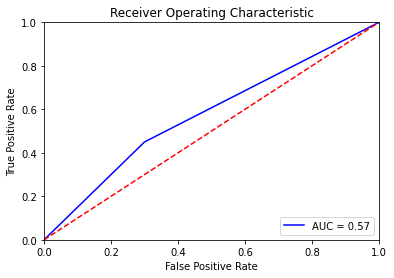

Valor correspondiente para el hiperparámetro: {'C': 10, 'gamma': 0.01, 'kernel': 'linear'}
Mayor valor de la figura de mérito en validación con características estandarizadas: 0.523
0.55
[[14  6]
 [12  8]]
Sensibilidad, Accuracy, Especificidad, f1-score 0.4 0.55 0.7 0.47058823529411764


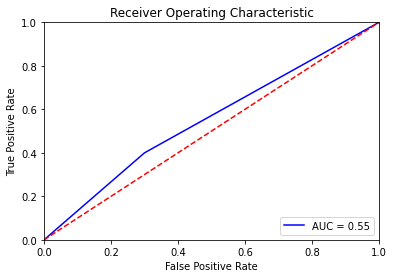

In [ ]:
#VARIABLES NORMALIZADAS CON MIN-MAX

r=regresion_logistica(X_train_ec,X_test_ec,Y_train_3,Y_test_3,3)
recall_reg_scaler.append(r[0])
accuracy_reg_scaler.append(r[1])
precision_reg_scaler.append(r[2])
f1_reg_scaler.append(r[3])
roc_reg_scaler.append(r[4])

a=decisionTree(X_train_ec,X_test_ec,Y_train_3,Y_test_3,3)
recall_arbol_scaler.append(a[0])
accuracy_arbol_scaler.append(a[1])
precision_arbol_scaler.append(a[2])
f1_arbol_scaler.append(a[3])
roc_arbol_scaler.append(a[4])

k=knn(X_train_ec,X_test_ec,Y_train_3,Y_test_3)
recall_knn_scaler.append(k[0])
accuracy_knn_scaler.append(k[1])
precision_knn_scaler.append(k[2])
f1_knn_scaler.append(k[3])
roc_knn_scaler.append(k[4])

s=svc(X_train_ec,X_test_ec,Y_train_3,Y_test_3,3)
recall_svc_scaler.append(s[0])
accuracy_svc_scaler.append(s[1])
precision_svc_scaler.append(s[2])
f1_svc_scaler.append(s[3])
roc_svc_scaler.append(s[4])

sl=svc_lineal(X_train_ec,X_test_ec,Y_train_3,Y_test_3,3)
recall_svc_lin_scaler.append(sl[0])
accuracy_svc_lin_scaler.append(sl[1])
precision_svc_lin_scaler.append(sl[2])
f1_svc_lin_scaler.append(sl[3])
roc_svc_lin_scaler.append(sl[4])



In [ ]:
# from sklearn.model_selection import train_test_split, cross_val_score
X_train_scaler_all4=np.array(X_train_scaler_all4)
X_test_scaler_all4=np.array(X_test_scaler_all4)

X_train_ec = X_train_scaler_all4[:,[3,16,18,25,28,32,33,43,44,60,62,68,71,74,77,80,84,85,104,108,110,144,150,163,164]]
X_test_ec = X_test_scaler_all4[:,[3,16,18,25,28,32,33,43,44,60,62,68,71,74,77,80,84,85,104,108,110,144,150,163,164]]


Valor correspondiente para el hiperparámetro: {'C': 1, 'penalty': 'l1'}
Mayor valor de la figura de mérito en validación con características estandarizadas: 0.573
0.7
[[13  7]
 [ 5 15]]
Sensibilidad, Accuracy, Especificidad, f1-score 0.75 0.7 0.65 0.7142857142857143


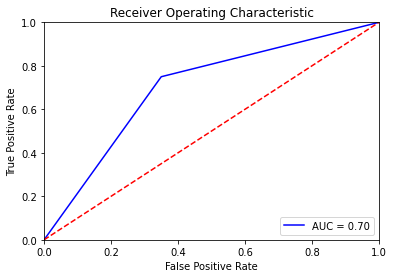

{'max_depth': 1, 'min_samples_leaf': 21}
Mejor ROC-AUC en validación cruzada: 0.623
Mejor valor del hiperparámetro: {'max_depth': 1, 'min_samples_leaf': 21}
0.725
[[15  5]
 [ 6 14]]
Sensibilidad, Accuracy, Especifididad, f1-score 0.7 0.725 0.75 0.717948717948718


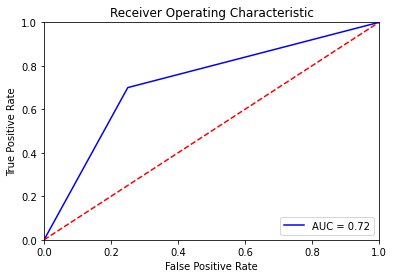

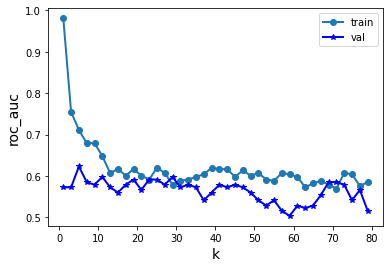

Mayor valor de la figura de mérito en validación con características estandarizadas: 0.623
Valor correspondiente para el hiperparámetro: {'n_neighbors': 5}
0.5
[[11  9]
 [11  9]]
Sensibilidad, Accuracy, Especificidad, f1-score 0.45 0.5 0.55 0.4736842105263158


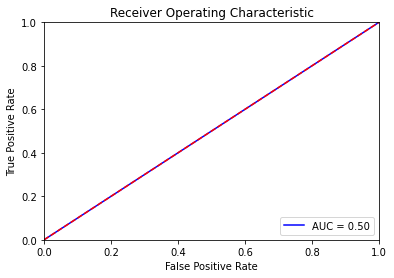

Valor correspondiente para el hiperparámetro: {'C': 25, 'gamma': 0.001, 'kernel': 'rbf'}
Mayor valor de la figura de mérito en validación con características estandarizadas: 0.578
0.7
[[13  7]
 [ 5 15]]
Sensibilidad, Accuracy, Especificidad, f1-score 0.75 0.7 0.65 0.7142857142857143


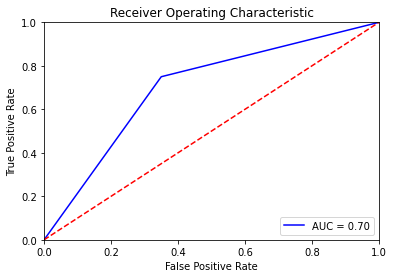

Valor correspondiente para el hiperparámetro: {'C': 0.1, 'gamma': 0.01, 'kernel': 'linear'}
Mayor valor de la figura de mérito en validación con características estandarizadas: 0.560
0.7
[[13  7]
 [ 5 15]]
Sensibilidad, Accuracy, Especificidad, f1-score 0.75 0.7 0.65 0.7142857142857143


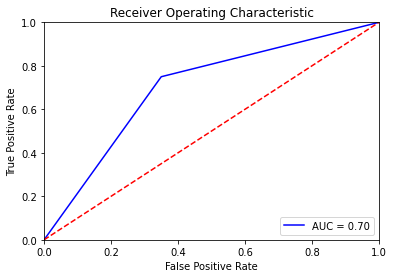

In [ ]:
#VARIABLES NORMALIZADAS CON MIN-MAX

r=regresion_logistica(X_train_ec,X_test_ec,Y_train_4,Y_test_4,4)
recall_reg_scaler.append(r[0])
accuracy_reg_scaler.append(r[1])
precision_reg_scaler.append(r[2])
f1_reg_scaler.append(r[3])
roc_reg_scaler.append(r[4])

a=decisionTree(X_train_ec,X_test_ec,Y_train_4,Y_test_4,4)
recall_arbol_scaler.append(a[0])
accuracy_arbol_scaler.append(a[1])
precision_arbol_scaler.append(a[2])
f1_arbol_scaler.append(a[3])
roc_arbol_scaler.append(a[4])

k=knn(X_train_ec,X_test_ec,Y_train_4,Y_test_4)
recall_knn_scaler.append(k[0])
accuracy_knn_scaler.append(k[1])
precision_knn_scaler.append(k[2])
f1_knn_scaler.append(k[3])
roc_knn_scaler.append(k[4])

s=svc(X_train_ec,X_test_ec,Y_train_4,Y_test_4,4)
recall_svc_scaler.append(s[0])
accuracy_svc_scaler.append(s[1])
precision_svc_scaler.append(s[2])
f1_svc_scaler.append(s[3])
roc_svc_scaler.append(s[4])

sl=svc_lineal(X_train_ec,X_test_ec,Y_train_4,Y_test_4,4)
recall_svc_lin_scaler.append(sl[0])
accuracy_svc_lin_scaler.append(sl[1])
precision_svc_lin_scaler.append(sl[2])
f1_svc_lin_scaler.append(sl[3])
roc_svc_lin_scaler.append(sl[4])


In [ ]:
def plot_mean_std_metric(df_metrics, lims, metric_name='accuracy', title_figure='mean_std_plot', flag_save_figure=False):

    fig, ax = plt.subplots(1, 1, figsize=(6.5, 4.5))


    ax.plot(df_metrics['mean'], df_metrics['model'], ls='', marker='o', color='#8000FF')

    ax.hlines(df_metrics['model'], df_metrics['mean'] - df_metrics['std'], df_metrics['mean'] + df_metrics['std'],
              label='', lw=2, color='#8000FF', ls='-')

    ax.grid(axis='x', ls='-')
    ax.grid(axis='y', ls=':', lw=1, alpha=0.5)
    ax.set(
        xlabel=metric_name,
        xlim=lims,
        title=title_figure
    )

    fig.tight_layout()

    if flag_save_figure:
        fig.savefig(title_figure, dpi=300, bbox_inches='tight')
    else:
        plt.show()

In [ ]:

model_scaler=['LASSO', 'DT', 'KNN','Radial SVM', 'Linear SVM']
mean_scaler=[np.mean(accuracy_reg_scaler), np.mean(accuracy_arbol_scaler),np.mean(accuracy_knn_scaler),np.mean(accuracy_svc_scaler),np.mean(accuracy_svc_lin_scaler)]
std_scaler=[np.std(accuracy_reg_scaler), np.std(accuracy_arbol_scaler),np.std(accuracy_knn_scaler),np.std(accuracy_svc_scaler),np.std(accuracy_svc_lin_scaler)]

df_acc_scaler= pd.DataFrame()
df_acc_scaler['model'] = None
df_acc_scaler['mean'] = None
df_acc_scaler['std'] = None


df_acc_scaler['model'] = model_scaler
df_acc_scaler['mean'] = mean_scaler
df_acc_scaler['std'] = std_scaler


In [ ]:
df_acc_scaler

,model,mean,std
0,LASSO,0.61,0.093005
1,DT,0.62,0.092736
2,KNN,0.50,0.044721
3,Radial SVM,0.58,0.065955
4,Linear SVM,0.60,0.106066


In [ ]:
model2_scaler=['LASSO', 'DT', 'KNN','Radial SVM', 'Linear SVM']
mean2_scaler=[np.mean(roc_reg_scaler), np.mean(roc_arbol_scaler),np.mean(roc_knn_scaler),np.mean(roc_svc_scaler),np.mean(roc_svc_lin_scaler)]
std2_scaler=[np.std(roc_reg_scaler), np.std(roc_arbol_scaler),np.std(roc_knn_scaler),np.std(roc_svc_scaler),np.std(roc_svc_lin_scaler)]

df_roc_scaler= pd.DataFrame()
df_roc_scaler['model'] = None
df_roc_scaler['mean'] = None
df_roc_scaler['std'] = None


df_roc_scaler['model'] = model2_scaler
df_roc_scaler['mean'] = mean2_scaler
df_roc_scaler['std'] = std2_scaler


In [ ]:
df_roc_scaler

,model,mean,std
0,LASSO,0.61,0.093005
1,DT,0.62,0.092736
2,KNN,0.50,0.044721
3,Radial SVM,0.58,0.065955
4,Linear SVM,0.60,0.106066


In [ ]:
#PINTAMOS GRÁFICAS PARA VARIABLES NORMALIZADAS CON STANDARD SCALER PARA ACCURACY Y ROC

plot_mean_std_metric(df_acc_scaler, lims=(0, 0.9), metric_name='',title_figure='', flag_save_figure=True)
# plt.rcParams["figure.figsize"] = (4, 3)
plt.savefig("{}.pdf".format("Medication_FS_acc"))
plt.close()

# plot_mean_std_metric(df_roc_scaler, lims=(0, 0.9), metric_name='',title_figure='', flag_save_figure=True)
# # plt.rcParams["figure.figsize"] = (4, 3)
# plt.savefig("{}.pdf".format("Att_auc"))
# plt.close()

In [ ]:
#RECALL
model_scaler3=['LASSO', 'DT', 'KNN','Radial SVM', 'Linear SVM']
mean_scaler3=[np.mean(recall_reg_scaler), np.mean(recall_arbol_scaler),np.mean(recall_knn_scaler),np.mean(recall_svc_scaler),np.mean(recall_svc_lin_scaler)]
std_scaler3=[np.std(recall_reg_scaler), np.std(recall_arbol_scaler),np.std(recall_knn_scaler),np.std(recall_svc_scaler),np.std(recall_svc_lin_scaler)]

df_recall_scaler= pd.DataFrame()
df_recall_scaler['model'] = None
df_recall_scaler['mean'] = None
df_recall_scaler['std'] = None


df_recall_scaler['model'] = model_scaler3
df_recall_scaler['mean'] = mean_scaler3
df_recall_scaler['std'] = std_scaler3

In [ ]:
df_recall_scaler

,model,mean,std
0,LASSO,0.51,0.208327
1,DT,0.42,0.246171
2,KNN,0.45,0.114018
3,Radial SVM,0.51,0.146287
4,Linear SVM,0.48,0.254165


In [ ]:
model_scaler4=['LASSO', 'DT', 'KNN','Radial SVM', 'Linear SVM']
mean_scaler4=[np.mean(precision_reg_scaler), np.mean(precision_arbol_scaler),np.mean(precision_knn_scaler),np.mean(precision_svc_scaler),np.mean(precision_svc_lin_scaler)]
std_scaler4=[np.std(precision_reg_scaler), np.std(precision_arbol_scaler),np.std(precision_knn_scaler),np.std(precision_svc_scaler),np.std(precision_svc_lin_scaler)]

df_especificidad_scaler= pd.DataFrame()
df_especificidad_scaler['model'] = None
df_especificidad_scaler['mean'] = None
df_especificidad_scaler['std'] = None


df_especificidad_scaler['model'] = model_scaler4
df_especificidad_scaler['mean'] = mean_scaler4
df_especificidad_scaler['std'] = std_scaler4

In [ ]:
df_especificidad_scaler


,model,mean,std
0,LASSO,0.71,0.048990
1,DT,0.82,0.074833
2,KNN,0.55,0.181659
3,Radial SVM,0.65,0.054772
4,Linear SVM,0.72,0.050990


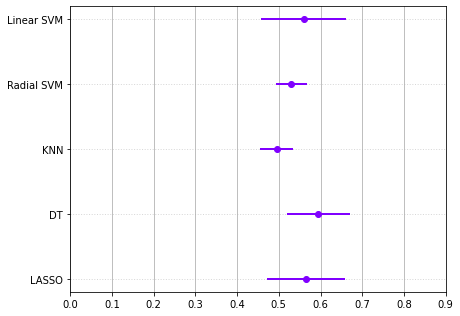

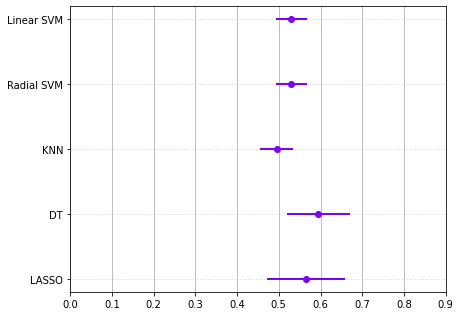

In [ ]:
#PINTAMOS GRÁFICAS PARA VARIABLES NORMALIZADAS CON STANDARD SCALER PARA ACCURACY Y ROC

plot_mean_std_metric(df_acc_scaler, lims=(0, 0.9), metric_name='',title_figure='', flag_save_figure=True)

plot_mean_std_metric(df_roc_scaler, lims=(0, 0.9), metric_name='',title_figure='', flag_save_figure=True)


# ***A PARTIR DE AQUÍ: PRUEBAS VARIAS***

# ***PARA BOOTSTRAP ESCOGEMOS LAS SIGUIENTES CARACTERÍSTICAS***

In [ ]:
recall_reg_scaler = []
accuracy_reg_scaler = []
precision_reg_scaler=[]
f1_reg_scaler=[]
roc_reg_scaler= []

recall_arbol_scaler = []
accuracy_arbol_scaler = []
precision_arbol_scaler=[]
f1_arbol_scaler=[]
roc_arbol_scaler= []

recall_knn_scaler = []
accuracy_knn_scaler = []
precision_knn_scaler=[]
f1_knn_scaler=[]
roc_knn_scaler= []

recall_svc_scaler = []
accuracy_svc_scaler = []
precision_svc_scaler=[]
f1_svc_scaler=[]
roc_svc_scaler= []

recall_svc_lin_scaler = []
accuracy_svc_lin_scaler = []
precision_svc_lin_scaler=[]
f1_svc_lin_scaler=[]
roc_svc_lin_scaler= []

recall_mlp_lin_scaler = []
accuracy_mlp_lin_scaler = []
precision_mlp_lin_scaler=[]
f1_mlp_lin_scaler=[]
roc_mlp_lin_scaler= []

In [ ]:
# from sklearn.model_selection import train_test_split, cross_val_score
X_train_scaler_all0=np.array(X_train_scaler_all0)
X_test_scaler_all0=np.array(X_test_scaler_all0)
X_train_ec = X_train_scaler_all0[:,[4,8,14,16,18,19,23,25,29,32,35,43,44,53,55,56,62,63,68,69,72,73,80,81,85,104,110,128,139,148,150,160,171,179,180,185,193,198,199]]
X_test_ec = X_test_scaler_all0[:,[4,8,14,16,18,19,23,25,29,32,35,43,44,53,55,56,62,63,68,69,72,73,80,81,85,104,110,128,139,148,150,160,171,179,180,185,193,198,199]]


Valor correspondiente para el hiperparámetro: {'C': 30, 'penalty': 'l2'}
Mayor valor de la figura de mérito en validación con características estandarizadas: 0.572
0.675
[[15  5]
 [ 8 12]]
Sensibilidad, Accuracy, precision, f1-score 0.6 0.675 0.7058823529411765 0.6486486486486486


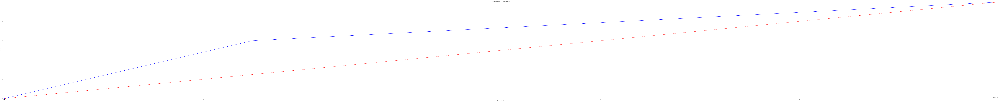

{'max_depth': 13, 'min_samples_leaf': 2}
Mejor ROC-AUC en validación cruzada: 0.572
Mejor valor del hiperparámetro: {'max_depth': 13, 'min_samples_leaf': 2}
0.525
[[17  3]
 [16  4]]
Sensibilidad, Accuracy, precision, f1-score 0.2 0.525 0.5714285714285714 0.29629629629629634


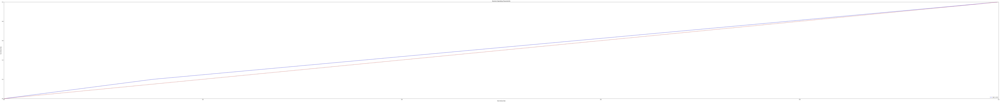

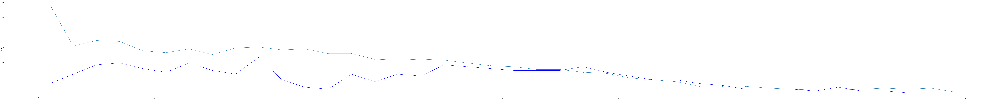

Mayor valor de la figura de mérito en validación con características estandarizadas: 0.616
Valor correspondiente para el hiperparámetro: {'n_neighbors': 19}
0.525
[[ 8 12]
 [ 7 13]]
Sensibilidad, Accuracy, precision, f1-score 0.65 0.525 0.52 0.5777777777777778


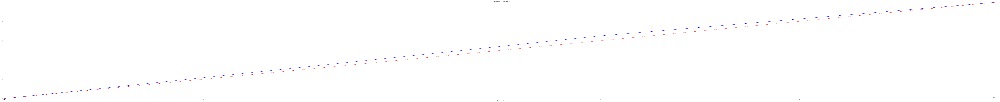

Valor correspondiente para el hiperparámetro: {'C': 100, 'gamma': 0.01, 'kernel': 'rbf'}
Mayor valor de la figura de mérito en validación con características estandarizadas: 0.591
0.625
[[17  3]
 [12  8]]
Sensibilidad, Accuracy, precision, f1-score 0.4 0.625 0.7272727272727273 0.5161290322580645


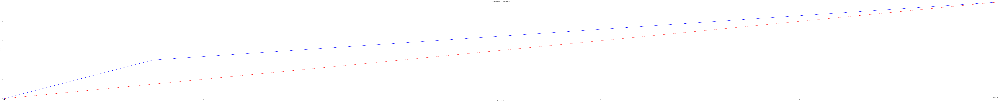

Valor correspondiente para el hiperparámetro: {'C': 0.1, 'gamma': 0.01, 'kernel': 'linear'}
Mayor valor de la figura de mérito en validación con características estandarizadas: 0.571
0.675
[[18  2]
 [11  9]]
Sensibilidad, Accuracy, precision, f1-score 0.45 0.675 0.8181818181818182 0.5806451612903226


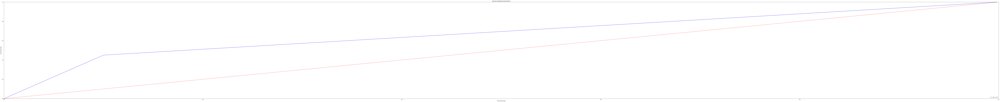

In [ ]:
#VARIABLES NORMALIZADAS CON MIN-MAX

r=regresion_logistica(X_train_ec,X_test_ec,Y_train_0,Y_test_0,0)
recall_reg_scaler.append(r[0])
accuracy_reg_scaler.append(r[1])
precision_reg_scaler.append(r[2])
f1_reg_scaler.append(r[3])
roc_reg_scaler.append(r[4])

a=decisionTree(X_train_ec,X_test_ec,Y_train_0,Y_test_0,0)
recall_arbol_scaler.append(a[0])
accuracy_arbol_scaler.append(a[1])
precision_arbol_scaler.append(a[2])
f1_arbol_scaler.append(a[3])
roc_arbol_scaler.append(a[4])

k=knn(X_train_ec,X_test_ec,Y_train_0,Y_test_0)
recall_knn_scaler.append(k[0])
accuracy_knn_scaler.append(k[1])
precision_knn_scaler.append(k[2])
f1_knn_scaler.append(k[3])
roc_knn_scaler.append(k[4])

s=svc(X_train_ec,X_test_ec,Y_train_0,Y_test_0,0)
recall_svc_scaler.append(s[0])
accuracy_svc_scaler.append(s[1])
precision_svc_scaler.append(s[2])
f1_svc_scaler.append(s[3])
roc_svc_scaler.append(s[4])

sl=svc_lineal(X_train_ec,X_test_ec,Y_train_0,Y_test_0,0)
recall_svc_lin_scaler.append(sl[0])
accuracy_svc_lin_scaler.append(sl[1])
precision_svc_lin_scaler.append(sl[2])
f1_svc_lin_scaler.append(sl[3])
roc_svc_lin_scaler.append(s[4])

# mlp=MLP(X_train_ec,X_test_ec,Y_train_0,Y_test_0,0)
# recall_mlp_lin_scaler.append(mlp[0])
# accuracy_mlp_lin_scaler.append(mlp[1])
# precision_mlp_lin_scaler.append(mlp[2])
# f1_mlp_lin_scaler.append(mlp[3])
# roc_mlp_lin_scaler.append(mlp[4])

In [ ]:
# from sklearn.model_selection import train_test_split, cross_val_score
X_train_scaler_all1=np.array(X_train_scaler_all1)
X_test_scaler_all1=np.array(X_test_scaler_all1)

X_train_ec = X_train_scaler_all1[:,[4,8,14,16,18,19,23,25,29,32,35,43,44,53,55,56,62,63,68,69,72,73,80,81,85,104,110,128,139,148,150,160,171,179,180,185,193,198,199]]
X_test_ec = X_test_scaler_all1[:,[4,8,14,16,18,19,23,25,29,32,35,43,44,53,55,56,62,63,68,69,72,73,80,81,85,104,110,128,139,148,150,160,171,179,180,185,193,198,199]]


Valor correspondiente para el hiperparámetro: {'C': 100, 'penalty': 'l1'}
Mayor valor de la figura de mérito en validación con características estandarizadas: 0.604
0.7
[[17  3]
 [ 9 11]]
Sensibilidad, Accuracy, precision, f1-score 0.55 0.7 0.7857142857142857 0.6470588235294117


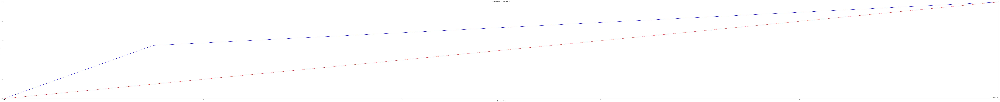

{'max_depth': 3, 'min_samples_leaf': 6}
Mejor ROC-AUC en validación cruzada: 0.522
Mejor valor del hiperparámetro: {'max_depth': 3, 'min_samples_leaf': 6}
0.7
[[20  0]
 [12  8]]
Sensibilidad, Accuracy, precision, f1-score 0.4 0.7 1.0 0.5714285714285715


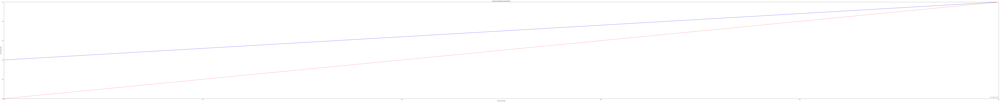

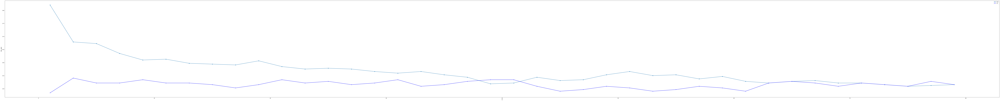

Mayor valor de la figura de mérito en validación con características estandarizadas: 0.541
Valor correspondiente para el hiperparámetro: {'n_neighbors': 3}
0.575
[[14  6]
 [11  9]]
Sensibilidad, Accuracy, precision, f1-score 0.45 0.575 0.6 0.5142857142857143


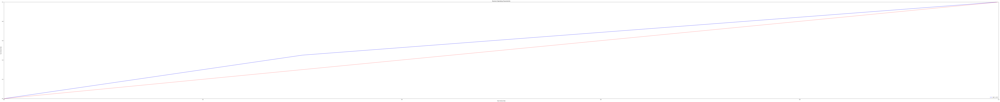

Valor correspondiente para el hiperparámetro: {'C': 25, 'gamma': 0.01, 'kernel': 'rbf'}
Mayor valor de la figura de mérito en validación con características estandarizadas: 0.604
0.75
[[18  2]
 [ 8 12]]
Sensibilidad, Accuracy, precision, f1-score 0.6 0.75 0.8571428571428571 0.7058823529411764


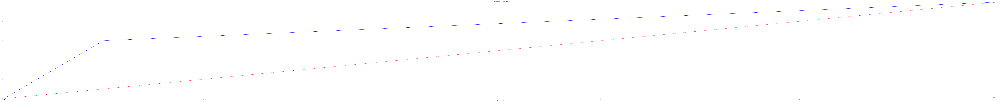

Valor correspondiente para el hiperparámetro: {'C': 0.1, 'gamma': 0.01, 'kernel': 'linear'}
Mayor valor de la figura de mérito en validación con características estandarizadas: 0.560
0.7
[[16  4]
 [ 8 12]]
Sensibilidad, Accuracy, precision, f1-score 0.6 0.7 0.75 0.6666666666666665


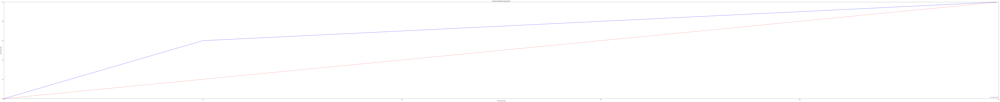

In [ ]:
#VARIABLES NORMALIZADAS CON MIN-MAX

r=regresion_logistica(X_train_ec,X_test_ec,Y_train_1,Y_test_1,1)
recall_reg_scaler.append(r[0])
accuracy_reg_scaler.append(r[1])
precision_reg_scaler.append(r[2])
f1_reg_scaler.append(r[3])
roc_reg_scaler.append(r[4])

a=decisionTree(X_train_ec,X_test_ec,Y_train_1,Y_test_1,1)
recall_arbol_scaler.append(a[0])
accuracy_arbol_scaler.append(a[1])
precision_arbol_scaler.append(a[2])
f1_arbol_scaler.append(a[3])
roc_arbol_scaler.append(a[4])

k=knn(X_train_ec,X_test_ec,Y_train_1,Y_test_1)
recall_knn_scaler.append(k[0])
accuracy_knn_scaler.append(k[1])
precision_knn_scaler.append(k[2])
f1_knn_scaler.append(k[3])
roc_knn_scaler.append(k[4])

s=svc(X_train_ec,X_test_ec,Y_train_1,Y_test_1,1)
recall_svc_scaler.append(s[0])
accuracy_svc_scaler.append(s[1])
precision_svc_scaler.append(s[2])
f1_svc_scaler.append(s[3])
roc_svc_scaler.append(s[4])

sl=svc_lineal(X_train_ec,X_test_ec,Y_train_1,Y_test_1,1)
recall_svc_lin_scaler.append(sl[0])
accuracy_svc_lin_scaler.append(sl[1])
precision_svc_lin_scaler.append(sl[2])
f1_svc_lin_scaler.append(sl[3])
roc_svc_lin_scaler.append(s[4])

# mlp=MLP(X_train_ec,X_test_ec,Y_train_1,Y_test_1,1)
# recall_mlp_lin_scaler.append(mlp[0])
# accuracy_mlp_lin_scaler.append(mlp[1])
# precision_mlp_lin_scaler.append(mlp[2])
# f1_mlp_lin_scaler.append(mlp[3])
# roc_mlp_lin_scaler.append(mlp[4])


In [ ]:
# from sklearn.model_selection import train_test_split, cross_val_score
X_train_scaler_all2=np.array(X_train_scaler_all2)
X_test_scaler_all2=np.array(X_test_scaler_all2)

X_train_ec = X_train_scaler_all2[:,[4,8,14,16,18,19,23,25,29,32,35,43,44,53,55,56,62,63,68,69,72,73,80,81,85,104,110,128,139,148,150,160,171,179,180,185,193,198,199]]
X_test_ec = X_test_scaler_all2[:,[4,8,14,16,18,19,23,25,29,32,35,43,44,53,55,56,62,63,68,69,72,73,80,81,85,104,110,128,139,148,150,160,171,179,180,185,193,198,199]]


Valor correspondiente para el hiperparámetro: {'C': 1, 'penalty': 'l2'}
Mayor valor de la figura de mérito en validación con características estandarizadas: 0.685
0.575
[[12  8]
 [ 9 11]]
Sensibilidad, Accuracy, precision, f1-score 0.55 0.575 0.5789473684210527 0.5641025641025641


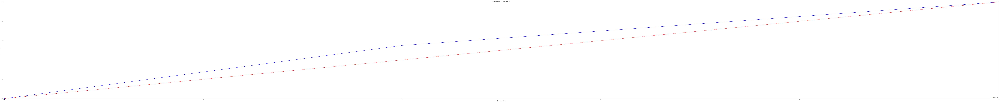

{'max_depth': 10, 'min_samples_leaf': 3}
Mejor ROC-AUC en validación cruzada: 0.642
Mejor valor del hiperparámetro: {'max_depth': 10, 'min_samples_leaf': 3}
0.575
[[14  6]
 [11  9]]
Sensibilidad, Accuracy, precision, f1-score 0.45 0.575 0.6 0.5142857142857143


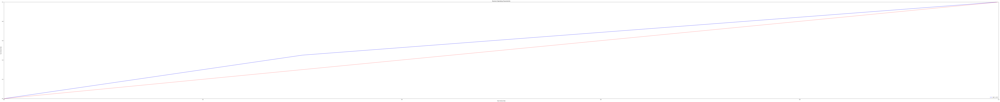

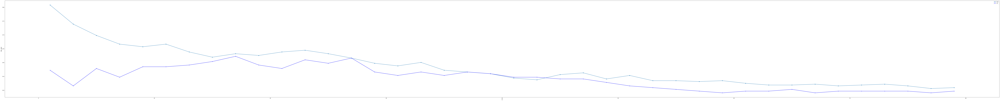

Mayor valor de la figura de mérito en validación con características estandarizadas: 0.623
Valor correspondiente para el hiperparámetro: {'n_neighbors': 17}
0.65
[[12  8]
 [ 6 14]]
Sensibilidad, Accuracy, precision, f1-score 0.7 0.65 0.6363636363636364 0.6666666666666666


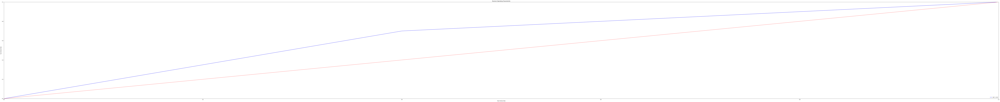

Valor correspondiente para el hiperparámetro: {'C': 50, 'gamma': 0.01, 'kernel': 'rbf'}
Mayor valor de la figura de mérito en validación con características estandarizadas: 0.666
0.625
[[14  6]
 [ 9 11]]
Sensibilidad, Accuracy, precision, f1-score 0.55 0.625 0.6470588235294118 0.5945945945945946


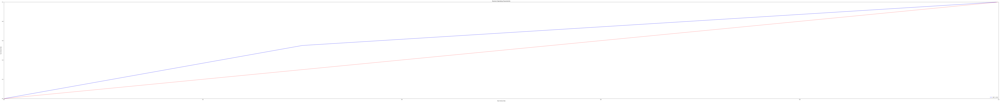

Valor correspondiente para el hiperparámetro: {'C': 10, 'gamma': 0.01, 'kernel': 'linear'}
Mayor valor de la figura de mérito en validación con características estandarizadas: 0.653
0.55
[[13  7]
 [11  9]]
Sensibilidad, Accuracy, precision, f1-score 0.45 0.55 0.5625 0.5


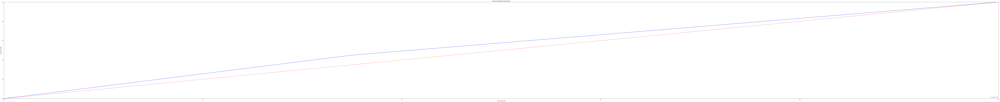

In [ ]:
#VARIABLES NORMALIZADAS CON MIN-MAX

r=regresion_logistica(X_train_ec,X_test_ec,Y_train_2,Y_test_2,2)
recall_reg_scaler.append(r[0])
accuracy_reg_scaler.append(r[1])
precision_reg_scaler.append(r[2])
f1_reg_scaler.append(r[3])
roc_reg_scaler.append(r[4])

a=decisionTree(X_train_ec,X_test_ec,Y_train_2,Y_test_2,2)
recall_arbol_scaler.append(a[0])
accuracy_arbol_scaler.append(a[1])
precision_arbol_scaler.append(a[2])
f1_arbol_scaler.append(a[3])
roc_arbol_scaler.append(a[4])

k=knn(X_train_ec,X_test_ec,Y_train_2,Y_test_2)
recall_knn_scaler.append(k[0])
accuracy_knn_scaler.append(k[1])
precision_knn_scaler.append(k[2])
f1_knn_scaler.append(k[3])
roc_knn_scaler.append(k[4])

s=svc(X_train_ec,X_test_ec,Y_train_2,Y_test_2,2)
recall_svc_scaler.append(s[0])
accuracy_svc_scaler.append(s[1])
precision_svc_scaler.append(s[2])
f1_svc_scaler.append(s[3])
roc_svc_scaler.append(s[4])

sl=svc_lineal(X_train_ec,X_test_ec,Y_train_2,Y_test_2,2)
recall_svc_lin_scaler.append(sl[0])
accuracy_svc_lin_scaler.append(sl[1])
precision_svc_lin_scaler.append(sl[2])
f1_svc_lin_scaler.append(sl[3])
roc_svc_lin_scaler.append(s[4])

# mlp=MLP(X_train_ec,X_test_ec,Y_train_2,Y_test_2,2)
# recall_mlp_lin_scaler.append(mlp[0])
# accuracy_mlp_lin_scaler.append(mlp[1])
# precision_mlp_lin_scaler.append(mlp[2])
# f1_mlp_lin_scaler.append(mlp[3])
# roc_mlp_lin_scaler.append(mlp[4])


In [ ]:
# from sklearn.model_selection import train_test_split, cross_val_score
X_train_scaler_all3=np.array(X_train_scaler_all3)
X_test_scaler_all3=np.array(X_test_scaler_all3)

X_train_ec = X_train_scaler_all3[:,[4,8,14,16,18,19,23,25,29,32,35,43,44,53,55,56,62,63,68,69,72,73,80,81,85,104,110,128,139,148,150,160,171,179,180,185,193,198,199]]
X_test_ec = X_test_scaler_all3[:,[4,8,14,16,18,19,23,25,29,32,35,43,44,53,55,56,62,63,68,69,72,73,80,81,85,104,110,128,139,148,150,160,171,179,180,185,193,198,199]]


Valor correspondiente para el hiperparámetro: {'C': 1, 'penalty': 'l2'}
Mayor valor de la figura de mérito en validación con características estandarizadas: 0.610
0.675
[[13  7]
 [ 6 14]]
Sensibilidad, Accuracy, precision, f1-score 0.7 0.675 0.6666666666666666 0.6829268292682926


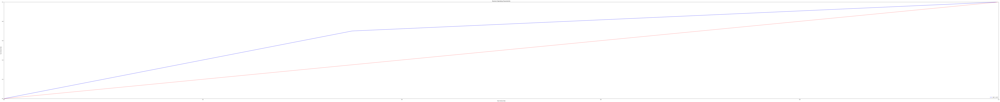

{'max_depth': 10, 'min_samples_leaf': 3}
Mejor ROC-AUC en validación cruzada: 0.566
Mejor valor del hiperparámetro: {'max_depth': 10, 'min_samples_leaf': 3}
0.6
[[13  7]
 [ 9 11]]
Sensibilidad, Accuracy, precision, f1-score 0.55 0.6 0.6111111111111112 0.5789473684210527


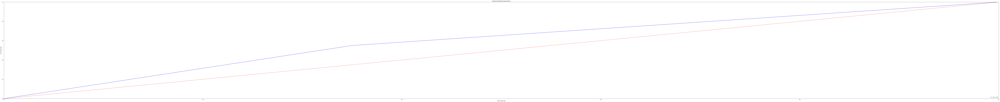

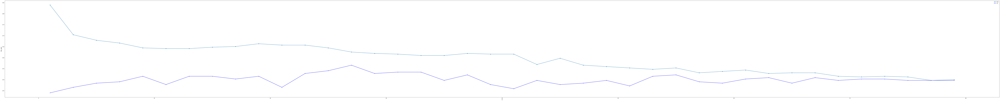

Mayor valor de la figura de mérito en validación con características estandarizadas: 0.566
Valor correspondiente para el hiperparámetro: {'n_neighbors': 27}
0.6
[[13  7]
 [ 9 11]]
Sensibilidad, Accuracy, precision, f1-score 0.55 0.6 0.6111111111111112 0.5789473684210527


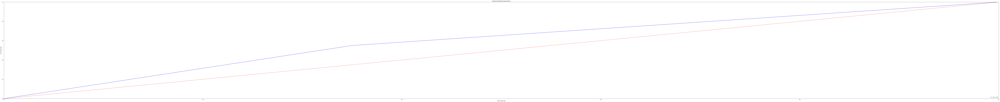

Valor correspondiente para el hiperparámetro: {'C': 100, 'gamma': 0.001, 'kernel': 'rbf'}
Mayor valor de la figura de mérito en validación con características estandarizadas: 0.642
0.65
[[14  6]
 [ 8 12]]
Sensibilidad, Accuracy, precision, f1-score 0.6 0.65 0.6666666666666666 0.631578947368421


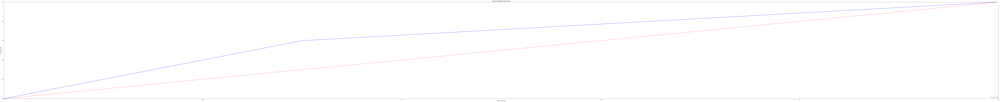

Valor correspondiente para el hiperparámetro: {'C': 0.1, 'gamma': 0.01, 'kernel': 'linear'}
Mayor valor de la figura de mérito en validación con características estandarizadas: 0.635
0.65
[[13  7]
 [ 7 13]]
Sensibilidad, Accuracy, precision, f1-score 0.65 0.65 0.65 0.65


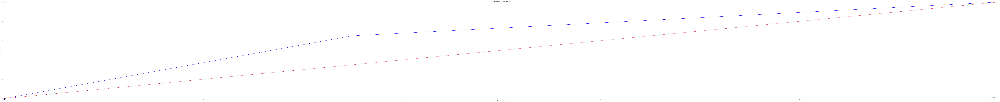

In [ ]:
#VARIABLES NORMALIZADAS CON MIN-MAX

r=regresion_logistica(X_train_ec,X_test_ec,Y_train_3,Y_test_3,3)
recall_reg_scaler.append(r[0])
accuracy_reg_scaler.append(r[1])
precision_reg_scaler.append(r[2])
f1_reg_scaler.append(r[3])
roc_reg_scaler.append(r[4])

a=decisionTree(X_train_ec,X_test_ec,Y_train_3,Y_test_3,3)
recall_arbol_scaler.append(a[0])
accuracy_arbol_scaler.append(a[1])
precision_arbol_scaler.append(a[2])
f1_arbol_scaler.append(a[3])
roc_arbol_scaler.append(a[4])

k=knn(X_train_ec,X_test_ec,Y_train_3,Y_test_3)
recall_knn_scaler.append(k[0])
accuracy_knn_scaler.append(k[1])
precision_knn_scaler.append(k[2])
f1_knn_scaler.append(k[3])
roc_knn_scaler.append(k[4])

s=svc(X_train_ec,X_test_ec,Y_train_3,Y_test_3,3)
recall_svc_scaler.append(s[0])
accuracy_svc_scaler.append(s[1])
precision_svc_scaler.append(s[2])
f1_svc_scaler.append(s[3])
roc_svc_scaler.append(s[4])

sl=svc_lineal(X_train_ec,X_test_ec,Y_train_3,Y_test_3,3)
recall_svc_lin_scaler.append(sl[0])
accuracy_svc_lin_scaler.append(sl[1])
precision_svc_lin_scaler.append(sl[2])
f1_svc_lin_scaler.append(sl[3])
roc_svc_lin_scaler.append(s[4])

# mlp=MLP(X_train_ec,X_test_ec,Y_train_3,Y_test_3,3)
# recall_mlp_lin_scaler.append(mlp[0])
# accuracy_mlp_lin_scaler.append(mlp[1])
# precision_mlp_lin_scaler.append(mlp[2])
# f1_mlp_lin_scaler.append(mlp[3])
# roc_mlp_lin_scaler.append(mlp[4])




In [ ]:
# from sklearn.model_selection import train_test_split, cross_val_score
X_train_scaler_all4=np.array(X_train_scaler_all4)
X_test_scaler_all4=np.array(X_test_scaler_all4)

X_train_ec = X_train_scaler_all4[:,[4,8,14,16,18,19,23,25,29,32,35,43,44,53,55,56,62,63,68,69,72,73,80,81,85,104,110,128,139,148,150,160,171,179,180,185,193,198,199]]
X_test_ec = X_test_scaler_all4[:,[4,8,14,16,18,19,23,25,29,32,35,43,44,53,55,56,62,63,68,69,72,73,80,81,85,104,110,128,139,148,150,160,171,179,180,185,193,198,199]]


In [ ]:
X_train_ec.shape

(159, 39)

Valor correspondiente para el hiperparámetro: {'C': 10, 'penalty': 'l1'}
Mayor valor de la figura de mérito en validación con características estandarizadas: 0.654
0.525
[[14  6]
 [13  7]]
Sensibilidad, Accuracy, precision, f1-score 0.35 0.525 0.5384615384615384 0.4242424242424242


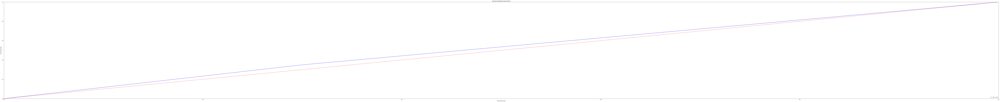

{'max_depth': 9, 'min_samples_leaf': 3}
Mejor ROC-AUC en validación cruzada: 0.623
Mejor valor del hiperparámetro: {'max_depth': 9, 'min_samples_leaf': 3}
0.6
[[18  2]
 [14  6]]
Sensibilidad, Accuracy, precision, f1-score 0.3 0.6 0.75 0.4285714285714285


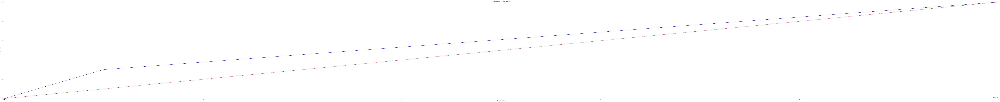

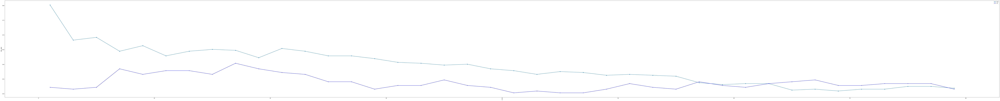

Mayor valor de la figura de mérito en validación con características estandarizadas: 0.604
Valor correspondiente para el hiperparámetro: {'n_neighbors': 17}
0.6
[[20  0]
 [16  4]]
Sensibilidad, Accuracy, precision, f1-score 0.2 0.6 1.0 0.33333333333333337


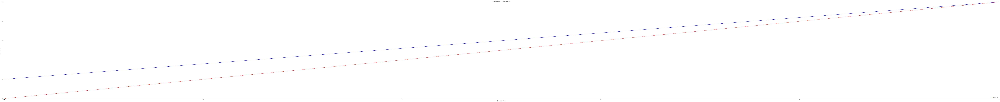

Valor correspondiente para el hiperparámetro: {'C': 25, 'gamma': 0.01, 'kernel': 'rbf'}
Mayor valor de la figura de mérito en validación con características estandarizadas: 0.654
0.575
[[14  6]
 [11  9]]
Sensibilidad, Accuracy, precision, f1-score 0.45 0.575 0.6 0.5142857142857143


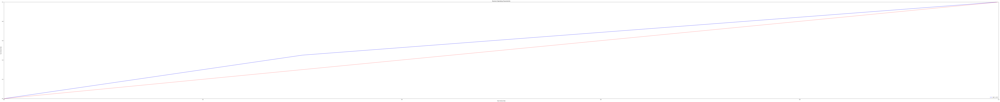

Valor correspondiente para el hiperparámetro: {'C': 10, 'gamma': 0.01, 'kernel': 'linear'}
Mayor valor de la figura de mérito en validación con características estandarizadas: 0.616
0.6
[[14  6]
 [10 10]]
Sensibilidad, Accuracy, precision, f1-score 0.5 0.6 0.625 0.5555555555555556


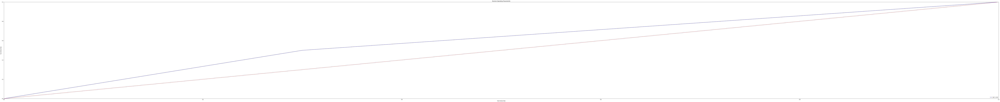

Valor correspondiente para el hiperparámetro: {'hidden_layer_sizes': 2}
Mayor valor de la figura de mérito en validación con características estandarizadas: 0.686
0.6
[[14  6]
 [10 10]]
Sensibilidad, Accuracy, precision, f1-score 0.5 0.6 0.625 0.5555555555555556


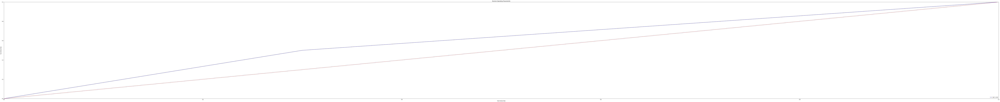

In [ ]:
#VARIABLES NORMALIZADAS CON MIN-MAX

r=regresion_logistica(X_train_ec,X_test_ec,Y_train_4,Y_test_4,4)
recall_reg_scaler.append(r[0])
accuracy_reg_scaler.append(r[1])
precision_reg_scaler.append(r[2])
f1_reg_scaler.append(r[3])
roc_reg_scaler.append(r[4])

a=decisionTree(X_train_ec,X_test_ec,Y_train_4,Y_test_4,4)
recall_arbol_scaler.append(a[0])
accuracy_arbol_scaler.append(a[1])
precision_arbol_scaler.append(a[2])
f1_arbol_scaler.append(a[3])
roc_arbol_scaler.append(a[4])

k=knn(X_train_ec,X_test_ec,Y_train_4,Y_test_4)
recall_knn_scaler.append(k[0])
accuracy_knn_scaler.append(k[1])
precision_knn_scaler.append(k[2])
f1_knn_scaler.append(k[3])
roc_knn_scaler.append(k[4])

s=svc(X_train_ec,X_test_ec,Y_train_4,Y_test_4,4)
recall_svc_scaler.append(s[0])
accuracy_svc_scaler.append(s[1])
precision_svc_scaler.append(s[2])
f1_svc_scaler.append(s[3])
roc_svc_scaler.append(s[4])

sl=svc_lineal(X_train_ec,X_test_ec,Y_train_4,Y_test_4,4)
recall_svc_lin_scaler.append(sl[0])
accuracy_svc_lin_scaler.append(sl[1])
precision_svc_lin_scaler.append(sl[2])
f1_svc_lin_scaler.append(sl[3])
roc_svc_lin_scaler.append(s[4])

mlp=MLP(X_train_ec,X_test_ec,Y_train_4,Y_test_4,4)
recall_mlp_lin_scaler.append(mlp[0])
accuracy_mlp_lin_scaler.append(mlp[1])
precision_mlp_lin_scaler.append(mlp[2])
f1_mlp_lin_scaler.append(mlp[3])
roc_mlp_lin_scaler.append(mlp[4])


In [ ]:
def plot_mean_std_metric(df_metrics, lims, metric_name='accuracy', title_figure='mean_std_plot', flag_save_figure=False):

    fig, ax = plt.subplots(1, 1, figsize=(6.5, 4.5))


    ax.plot(df_metrics['mean'], df_metrics['model'], ls='', marker='o', color='#8000FF')

    ax.hlines(df_metrics['model'], df_metrics['mean'] - df_metrics['std'], df_metrics['mean'] + df_metrics['std'],
              label='', lw=2, color='#8000FF', ls='-')

    ax.grid(axis='x', ls='-')
    ax.grid(axis='y', ls=':', lw=1, alpha=0.5)
    ax.set(
        xlabel=metric_name,
        xlim=lims,
        title=title_figure
    )

    fig.tight_layout()

    if flag_save_figure:
        fig.savefig(title_figure, dpi=300, bbox_inches='tight')
    else:
        plt.show()

In [ ]:
model_scaler=['LASSO', 'DT', 'KNN','Radial SVM', 'Linear SVM']
mean_scaler=[np.mean(accuracy_reg_scaler), np.mean(accuracy_arbol_scaler),np.mean(accuracy_knn_scaler),np.mean(accuracy_svc_scaler),np.mean(accuracy_svc_lin_scaler)]
std_scaler=[np.std(accuracy_reg_scaler), np.std(accuracy_arbol_scaler),np.std(accuracy_knn_scaler),np.std(accuracy_svc_scaler),np.std(accuracy_svc_lin_scaler)]

df_acc_scaler= pd.DataFrame()
df_acc_scaler['model'] = None
df_acc_scaler['mean'] = None
df_acc_scaler['std'] = None


df_acc_scaler['model'] = model_scaler
df_acc_scaler['mean'] = mean_scaler
df_acc_scaler['std'] = std_scaler


In [ ]:
model2_scaler=['LASSO', 'DT', 'KNN','Radial SVM', 'Linear SVM']
mean2_scaler=[np.mean(roc_reg_scaler), np.mean(roc_arbol_scaler),np.mean(roc_knn_scaler),np.mean(roc_svc_scaler),np.mean(roc_svc_lin_scaler)]
std2_scaler=[np.std(roc_reg_scaler), np.std(roc_arbol_scaler),np.std(roc_knn_scaler),np.std(roc_svc_scaler),np.std(roc_svc_lin_scaler)]

df_roc_scaler= pd.DataFrame()
df_roc_scaler['model'] = None
df_roc_scaler['mean'] = None
df_roc_scaler['std'] = None


df_roc_scaler['model'] = model2_scaler
df_roc_scaler['mean'] = mean2_scaler
df_roc_scaler['std'] = std2_scaler


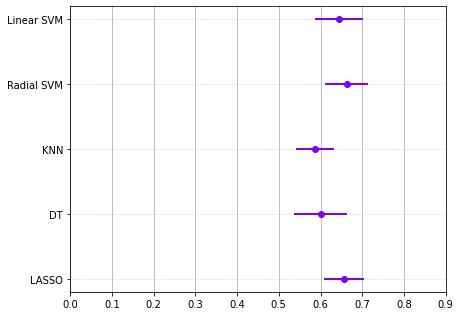

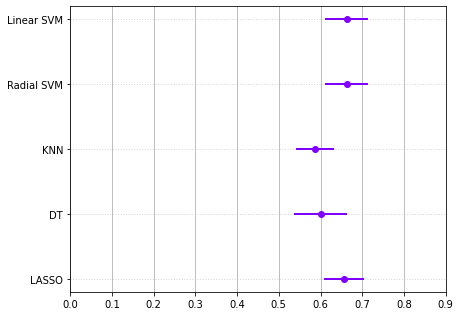

In [ ]:

#PINTAMOS GRÁFICAS PARA VARIABLES NORMALIZADAS CON STANDARD SCALER PARA ACCURACY Y ROC

plot_mean_std_metric(df_acc_scaler, lims=(0, 0.9), metric_name='',title_figure='', flag_save_figure=True)

plot_mean_std_metric(df_roc_scaler, lims=(0, 0.9), metric_name='',title_figure='', flag_save_figure=True)

# plot_mean_std_metric(df_recall_scaler, lims=(0, 0.9), metric_name='recall',title_figure='Recall', flag_save_figure=True)


In [ ]:
df_acc_scaler

,model,mean,std
0,LASSO,0.65625,0.048007
1,DT,0.60000,0.063738
2,KNN,0.58750,0.045069
3,Radial SVM,0.66250,0.051539
4,Linear SVM,0.64375,0.056940


In [ ]:

model_scaler=['regresión_logistica', 'árbol', 'knn','svc','svc_lineal','mlp']
mean_scaler=[np.mean(accuracy_reg_scaler), np.mean(accuracy_arbol_scaler),np.mean(accuracy_knn_scaler),np.mean(accuracy_svc_scaler),np.mean(accuracy_svc_lin_scaler),np.mean(accuracy_mlp_lin_scaler)]
std_scaler=[np.std(accuracy_reg_scaler), np.std(accuracy_arbol_scaler),np.std(accuracy_knn_scaler),np.std(accuracy_svc_scaler),np.std(accuracy_svc_lin_scaler),np.std(accuracy_mlp_lin_scaler)]

df_acc_scaler= pd.DataFrame()
df_acc_scaler['model'] = None
df_acc_scaler['mean'] = None
df_acc_scaler['std'] = None


df_acc_scaler['model'] = model_scaler
df_acc_scaler['mean'] = mean_scaler
df_acc_scaler['std'] = std_scaler


In [ ]:
df_acc_scaler

,model,mean,std
0,regresión_logistica,0.65625,0.048007
1,árbol,0.57500,0.039528
2,knn,0.56875,0.048007
3,svc,0.66250,0.051539
4,svc_lineal,0.64375,0.056940
5,mlp,0.68750,0.045069


In [ ]:
model2_scaler=['regresión_logistica', 'árbol', 'knn','svc', 'svc_lineal','mlp']
mean2_scaler=[np.mean(roc_reg_scaler), np.mean(roc_arbol_scaler),np.mean(roc_knn_scaler),np.mean(roc_svc_scaler),np.mean(roc_svc_lin_scaler),np.mean(roc_mlp_lin_scaler)]
std2_scaler=[np.std(roc_reg_scaler), np.std(roc_arbol_scaler),np.std(roc_knn_scaler),np.std(roc_svc_scaler),np.std(roc_svc_lin_scaler),np.std(roc_mlp_lin_scaler)]

df_roc_scaler= pd.DataFrame()
df_roc_scaler['model'] = None
df_roc_scaler['mean'] = None
df_roc_scaler['std'] = None


df_roc_scaler['model'] = model2_scaler
df_roc_scaler['mean'] = mean2_scaler
df_roc_scaler['std'] = std2_scaler


In [ ]:
model3_scaler=['regresión_logistica', 'árbol', 'knn','svc', 'svc_lineal','mlp']
mean3_scaler=[np.mean(recall_reg_scaler), np.mean(recall_arbol_scaler),np.mean(recall_knn_scaler),np.mean(recall_svc_scaler),np.mean(recall_svc_lin_scaler),np.mean(recall_mlp_lin_scaler)]
std3_scaler=[np.std(recall_reg_scaler), np.std(recall_arbol_scaler),np.std(recall_knn_scaler),np.std(recall_svc_scaler),np.std(recall_svc_lin_scaler),np.std(recall_mlp_lin_scaler)]

df_recall_scaler= pd.DataFrame()
df_recall_scaler['model'] = None
df_recall_scaler['mean'] = None
df_recall_scaler['std'] = None


df_recall_scaler['model'] = model3_scaler
df_recall_scaler['mean'] = mean3_scaler
df_recall_scaler['std'] = std3_scaler

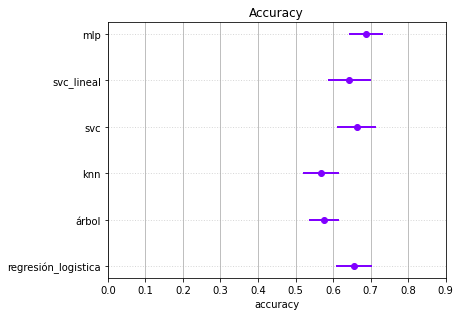

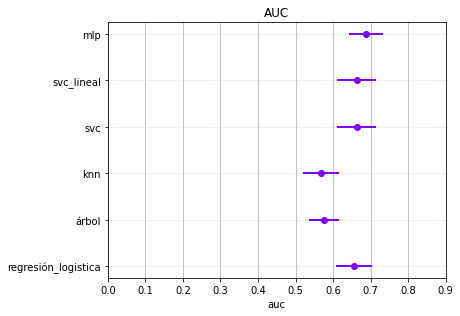

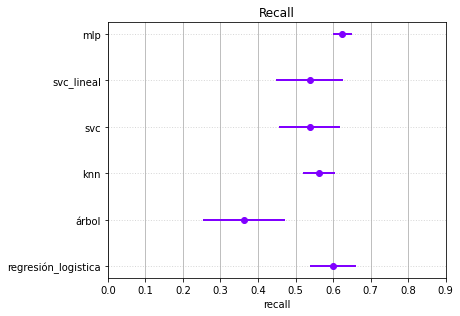

In [ ]:

#PINTAMOS GRÁFICAS PARA VARIABLES NORMALIZADAS CON STANDARD SCALER PARA ACCURACY Y ROC

plot_mean_std_metric(df_acc_scaler, lims=(0, 0.9), metric_name='accuracy',title_figure='Accuracy', flag_save_figure=True)

plot_mean_std_metric(df_roc_scaler, lims=(0, 0.9), metric_name='auc',title_figure='AUC', flag_save_figure=True)

plot_mean_std_metric(df_recall_scaler, lims=(0, 0.9), metric_name='recall',title_figure='Recall', flag_save_figure=True)


In [ ]:
model_scaler=['regresión_logistica', 'árbol', 'knn','svc','svc_lineal']
mean_scaler=[np.mean(accuracy_reg_scaler), np.mean(accuracy_arbol_scaler),np.mean(accuracy_knn_scaler),np.mean(accuracy_svc_scaler),np.mean(accuracy_svc_lin_scaler)]
std_scaler=[np.std(accuracy_reg_scaler), np.std(accuracy_arbol_scaler),np.std(accuracy_knn_scaler),np.std(accuracy_svc_scaler),np.std(accuracy_svc_lin_scaler)]

df_acc_scaler= pd.DataFrame()
df_acc_scaler['model'] = None
df_acc_scaler['mean'] = None
df_acc_scaler['std'] = None


df_acc_scaler['model'] = model_scaler
df_acc_scaler['mean'] = mean_scaler
df_acc_scaler['std'] = std_scaler

In [ ]:
results = pd.DataFrame()
accuracy_scaler_ec=[]
accuracy_scaler_ec.append([np.mean(accuracy_reg_scaler), np.mean(accuracy_arbol_scaler),np.mean(accuracy_knn_scaler),np.mean(accuracy_svc_scaler),np.mean(accuracy_svc_lin_scaler)])
recall_ec=[]
recall_ec.append([np.mean(recall_reg_scaler), np.mean(recall_arbol_scaler),np.mean(recall_knn_scaler),np.mean(recall_svc_scaler),np.mean(recall_svc_lin_scaler)])
f1_scaler_ec=[]
f1_scaler_ec.append([np.mean(f1_reg_scaler), np.mean(f1_arbol_scaler),np.mean(f1_knn_scaler),np.mean(f1_svc_scaler),np.mean(f1_svc_lin_scaler)])
roc_scaler_ec=[]
roc_scaler_ec.append([np.mean(roc_reg_scaler), np.mean(roc_arbol_scaler),np.mean(roc_knn_scaler),np.mean(roc_svc_scaler),np.mean(roc_svc_lin_scaler)])
precision_scaler_ec=[]
precision_scaler_ec.append([np.mean(precision_reg_scaler), np.mean(precision_arbol_scaler),np.mean(precision_knn_scaler),np.mean(precision_svc_scaler),np.mean(precision_svc_lin_scaler)])

results["Accuracy"]=accuracy_scaler_ec[0]
results["Recall"]=recall_ec[0]
results["F1-score"]=f1_scaler_ec[0]
results["Auc"]=roc_scaler_ec[0]
results["Precision"]=precision_scaler_ec[0]

#results
results["Modelos"] = ["Regresión logística","árbol", "Knn","SVC","SVC-lineal"]
results.set_index("Modelos", inplace = True)

In [ ]:
results

,Accuracy,Recall,F1-score,Auc,Precision
Modelos,,,,,
Regresión logística,0.645,0.58,0.619658,0.645,0.672442
árbol,0.575,0.33,0.425040,0.575,0.669127
Knn,0.560,0.54,0.550704,0.560,0.569385
SVC,0.645,0.52,0.592494,0.645,0.699628
SVC-lineal,0.635,0.53,0.590573,0.645,0.681136


Volvemos a hacer bootstrap

In [ ]:
def compute_boostrap(df_data, v_column_names, label_name, generic_name, percentage_resampling=0.8, repetitions=30, flag_save_importance=False):

    list_variable_importance = []

    for i in range(len(v_column_names)):
        list_variable_importance.append(bootstrap_ci(df_data, v_column_names[i], (1 / percentage_resampling),
                                                     label_name, repetitions=repetitions))

    m_variable_importance = np.array(list_variable_importance)
    m_variable_importance = m_variable_importance.reshape(m_variable_importance.shape[0], 2)

    m_var_importance_bootstrap = np.c_[v_column_names, m_variable_importance]
    df_var_importance_bootstrap = pd.DataFrame(m_var_importance_bootstrap, columns=['var_name', 'ci_lower', 'ci_upper'])

    if flag_save_importance:
        df_var_importance_bootstrap.to_csv('df_var_importance_boostrap_{}.csv'.format(generic_name))


def bootstrap_ci(df_data, variable, div, classes, repetitions=3000, alpha=0.05, random_state=np.arange(1, 30000, 10)):
    """
    Compute bootstrap method with confidence interval
    :param df_data: a dataframe that includes observations of the two sample (df models)
    :param variable: a column_name of the column that includes observations (sens, espec,acc,precision,auc)
    :param div:
    :param classes: a column_name of the column that includes classes (This column should contain two different group names: dt and lasso, dt and svm, svm and lasso)
    :param repetitions: the number of times you want the bootstrapping to repeat. Default is 1000.
    :param alpha: likelihood that the true population parameter lies outside the confidence interval. Default is 0.05.
    :param random_state: enable users to set their own random_state, default is None
    :return:
    """
    df = df_data[[variable, classes]]
    bootstrap_sample_size = len(df)

    proportion_diffs = []
    print("sample size: ", int(bootstrap_sample_size/div))

    for i in range(repetitions):

        bootstrap_sample = df.sample(n=int(bootstrap_sample_size/div), replace=False, random_state=random_state[i])

        print(bootstrap_sample)

        label_0 = (bootstrap_sample[(bootstrap_sample[classes] == 0)])
        mean_label_0 = label_0[variable].mean()
        label_1 = (bootstrap_sample[(bootstrap_sample[classes] == 1)])
        mean_label_1 = label_1[variable].mean()

        proportion_diff = mean_label_1 - mean_label_0
        proportion_diffs.append(proportion_diff)

        df_proportions = pd.DataFrame(proportion_diffs)

    out = []

    for tt in range(len(df_proportions.columns)):

        left = np.percentile(df_proportions[tt], alpha / 2 * 100)
        right = np.percentile(df_proportions[tt], 100 - alpha / 2 * 100)
        out.append([round(left, 2), round(right, 2)])

    return out

In [ ]:
data_num=data_final[['A02BC','A05A1','A07AA','A07EA','A07FA','A10AB','A10BJ','A11AA','A11CC','A11HA','A12AX','B01AE','B02BC','C01BD','C01DA','C01EA','C03BA','C03CA','C05AE','C07AB','C08CA','C08DA','C09DB','C10AA','C10AX','G04BE','H04AA','L04AB','M04AC','N03AA','N03AF','N05CD','R03BA','N07AX','R03AL','R05CA','S01EA','V03AN','V09CX','BCaseControlStatus']]
# data_num=data_num.rename(columns={"BCaseControlStatus":"label"})

In [ ]:

data_num.columns[0:-1]

Index(['A02BC', 'A05A1', 'A07AA', 'A07EA', 'A07FA', 'A10AB', 'A10BJ', 'A11AA',
       'A11CC', 'A11HA', 'A12AX', 'B01AE', 'B02BC', 'C01BD', 'C01DA', 'C01EA',
       'C03BA', 'C03CA', 'C05AE', 'C07AB', 'C08CA', 'C08DA', 'C09DB', 'C10AA',
       'C10AX', 'G04BE', 'H04AA', 'L04AB', 'M04AC', 'N03AA', 'N03AF', 'N05CD',
       'R03BA', 'N07AX', 'R03AL', 'R05CA', 'S01EA', 'V03AN', 'V09CX'],
      dtype='object')

In [ ]:
data_num.shape

(199, 40)

In [ ]:
data_num.columns[0]

'label'

In [ ]:
data_final.columns[199]
#193,198,199

'V09CX'

In [ ]:
print(data_final.loc[:, [4,8,14,16,18,19,23,25,29,32,35,43,44,53,55,56,62,63,68,69,72,73,80,81,85,104,110,128,139,148,150,160,171,179,180,185,193,198,199]]


SyntaxError: ignored

In [ ]:

compute_boostrap(data_num,data_num.columns[0:-1], 'label', 'importance_bootstrap', flag_save_importance=True)




Se han truncado las últimas 5000 líneas del flujo de salida.
119      0      0
24       0      1
140      0      1

[159 rows x 2 columns]
     L04AB  label
96       0      0
63       0      1
168      0      1
195      0      0
68       0      0
..     ...    ...
111      0      0
95       0      1
21       0      0
31       0      1
94       0      0

[159 rows x 2 columns]
     L04AB  label
35       0      1
88       0      0
156      0      1
7        0      1
176      0      0
..     ...    ...
38       0      1
136      0      0
109      0      1
117      0      1
17       1      0

[159 rows x 2 columns]
     L04AB  label
85       0      0
62       0      1
86       0      1
169      0      1
128      0      1
..     ...    ...
52       0      1
39       0      0
165      0      0
112      0      0
132      0      1

[159 rows x 2 columns]
     L04AB  label
108      0      0
122      0      1
28       0      0
132      0      1
69       0      1
..     ...    ...
96       0     

# ***PARA BOOTSTRAP ESCOGEMOS LAS SIGUIENTES CARACTERÍSTICAS***

In [ ]:

recall_reg_scaler = []
accuracy_reg_scaler = []
precision_reg_scaler=[]
f1_reg_scaler=[]
roc_reg_scaler= []

recall_arbol_scaler = []
accuracy_arbol_scaler = []
precision_arbol_scaler=[]
f1_arbol_scaler=[]
roc_arbol_scaler= []

recall_knn_scaler = []
accuracy_knn_scaler = []
precision_knn_scaler=[]
f1_knn_scaler=[]
roc_knn_scaler= []

recall_svc_scaler = []
accuracy_svc_scaler = []
precision_svc_scaler=[]
f1_svc_scaler=[]
roc_svc_scaler= []

recall_svc_lin_scaler = []
accuracy_svc_lin_scaler = []
precision_svc_lin_scaler=[]
f1_svc_lin_scaler=[]
roc_svc_lin_scaler= []

In [ ]:
# X = data_num.loc[:, data_num.columns != 'BCaseControlStatus']
# Y= data_num["BCaseControlStatus"]

# X.shape, Y.shape

((199, 39), (199,))

In [ ]:
# from sklearn.model_selection import train_test_split, cross_val_score
X_train_scaler_all0=np.array(X_train_scaler_all0)
X_test_scaler_all0=np.array(X_test_scaler_all0)
X_train_ec = X_train_scaler_all0[:,[18,43,55,62,68,72,80,179,198]]
X_test_ec = X_test_scaler_all0[:,[18,43,55,62,68,72,80,179,198]]


Valor correspondiente para el hiperparámetro: {'C': 1, 'penalty': 'l2'}
Mayor valor de la figura de mérito en validación con características estandarizadas: 0.547
0.65
[[16  4]
 [10 10]]
Sensibilidad, Accuracy, precision, f1-score 0.5 0.65 0.7142857142857143 0.588235294117647


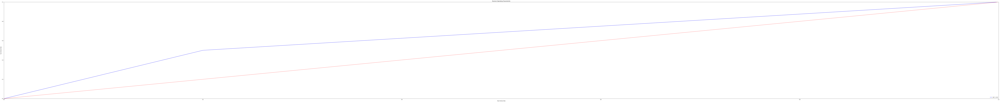

{'max_depth': 10}


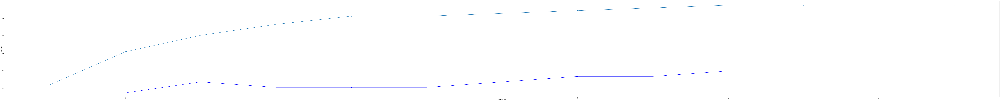

Mejor ROC-AUC en validación cruzada: 0.560
Mejor valor del hiperparámetro: {'max_depth': 10}
0.6
[[17  3]
 [13  7]]
Sensibilidad, Accuracy, precision, f1-score 0.35 0.6 0.7 0.4666666666666667


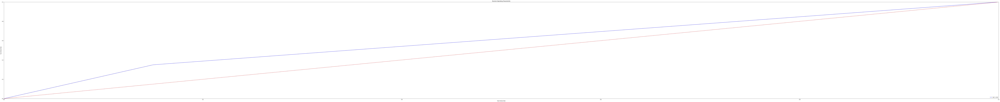

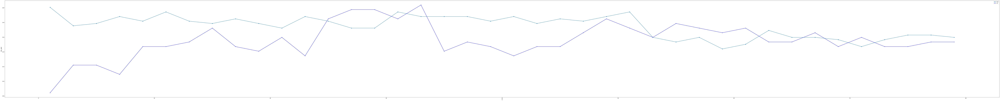

Mayor valor de la figura de mérito en validación con características estandarizadas: 0.604
Valor correspondiente para el hiperparámetro: {'n_neighbors': 33}
0.575
[[ 9 11]
 [ 6 14]]
Sensibilidad, Accuracy, precision, f1-score 0.7 0.575 0.56 0.6222222222222222


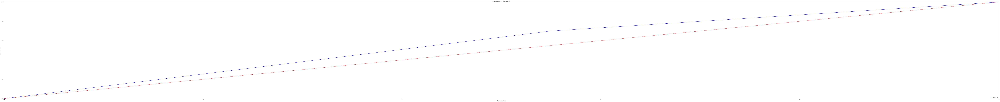

Valor correspondiente para el hiperparámetro: {'C': 50, 'gamma': 0.001, 'kernel': 'rbf'}
Mayor valor de la figura de mérito en validación con características estandarizadas: 0.541
0.6
[[16  4]
 [12  8]]
Sensibilidad, Accuracy, precision, f1-score 0.4 0.6 0.6666666666666666 0.5


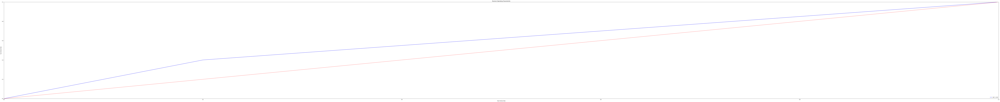

Valor correspondiente para el hiperparámetro: {'C': 0.1, 'gamma': 0.01, 'kernel': 'linear'}
Mayor valor de la figura de mérito en validación con características estandarizadas: 0.553
0.6
[[16  4]
 [12  8]]
Sensibilidad, Accuracy, precision, f1-score 0.4 0.6 0.6666666666666666 0.5


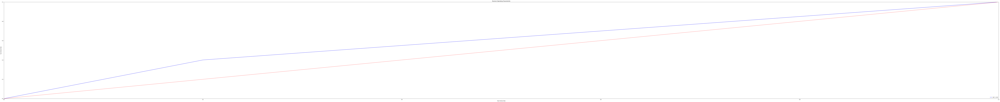

In [ ]:
#VARIABLES NORMALIZADAS CON MIN-MAX

r=regresion_logistica(X_train_ec,X_test_ec,Y_train_0,Y_test_0,0)
recall_reg_scaler.append(r[0])
accuracy_reg_scaler.append(r[1])
precision_reg_scaler.append(r[2])
f1_reg_scaler.append(r[3])
roc_reg_scaler.append(r[4])

a=decisionTree(X_train_ec,X_test_ec,Y_train_0,Y_test_0,0)
recall_arbol_scaler.append(a[0])
accuracy_arbol_scaler.append(a[1])
precision_arbol_scaler.append(a[2])
f1_arbol_scaler.append(a[3])
roc_arbol_scaler.append(a[4])

k=knn(X_train_ec,X_test_ec,Y_train_0,Y_test_0)
recall_knn_scaler.append(k[0])
accuracy_knn_scaler.append(k[1])
precision_knn_scaler.append(k[2])
f1_knn_scaler.append(k[3])
roc_knn_scaler.append(k[4])

s=svc(X_train_ec,X_test_ec,Y_train_0,Y_test_0,0)
recall_svc_scaler.append(s[0])
accuracy_svc_scaler.append(s[1])
precision_svc_scaler.append(s[2])
f1_svc_scaler.append(s[3])
roc_svc_scaler.append(s[4])

sl=svc_lineal(X_train_ec,X_test_ec,Y_train_0,Y_test_0,0)
recall_svc_lin_scaler.append(sl[0])
accuracy_svc_lin_scaler.append(sl[1])
precision_svc_lin_scaler.append(sl[2])
f1_svc_lin_scaler.append(sl[3])
roc_svc_lin_scaler.append(s[4])

In [ ]:
# from sklearn.model_selection import train_test_split, cross_val_score
X_train_scaler_all1=np.array(X_train_scaler_all1)
X_test_scaler_all1=np.array(X_test_scaler_all1)

X_train_ec = X_train_scaler_all1[:,[18,43,55,62,68,72,80,179,198]]
X_test_ec = X_test_scaler_all1[:,[18,43,55,62,68,72,80,179,198]]


Valor correspondiente para el hiperparámetro: {'C': 10, 'penalty': 'l2'}
Mayor valor de la figura de mérito en validación con características estandarizadas: 0.547
0.75
[[17  3]
 [ 7 13]]
Sensibilidad, Accuracy, precision, f1-score 0.65 0.75 0.8125 0.7222222222222223


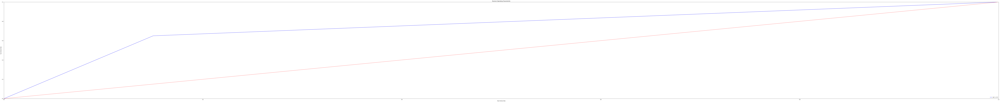

{'max_depth': 4}


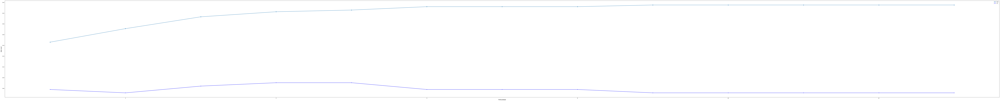

Mejor ROC-AUC en validación cruzada: 0.491
Mejor valor del hiperparámetro: {'max_depth': 4}
0.475
[[ 5 15]
 [ 6 14]]
Sensibilidad, Accuracy, precision, f1-score 0.7 0.475 0.4827586206896552 0.5714285714285714


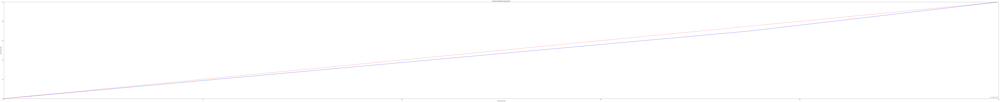

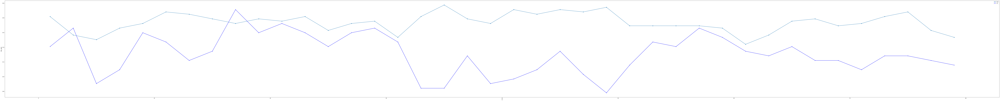

Mayor valor de la figura de mérito en validación con características estandarizadas: 0.591
Valor correspondiente para el hiperparámetro: {'n_neighbors': 17}
0.5
[[ 5 15]
 [ 5 15]]
Sensibilidad, Accuracy, precision, f1-score 0.75 0.5 0.5 0.6


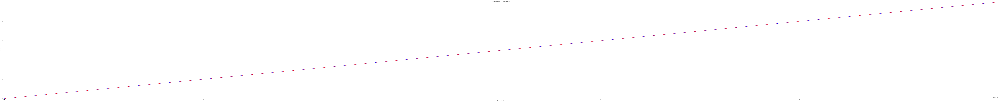

Valor correspondiente para el hiperparámetro: {'C': 50, 'gamma': 0.001, 'kernel': 'rbf'}
Mayor valor de la figura de mérito en validación con características estandarizadas: 0.560
0.5
[[ 5 15]
 [ 5 15]]
Sensibilidad, Accuracy, precision, f1-score 0.75 0.5 0.5 0.6


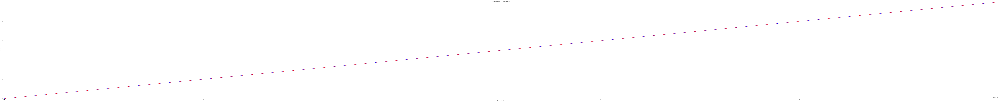

Valor correspondiente para el hiperparámetro: {'C': 0.1, 'gamma': 0.01, 'kernel': 'linear'}
Mayor valor de la figura de mérito en validación con características estandarizadas: 0.566
0.5
[[ 5 15]
 [ 5 15]]
Sensibilidad, Accuracy, precision, f1-score 0.75 0.5 0.5 0.6


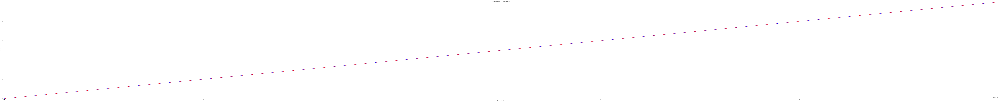

In [ ]:
#VARIABLES NORMALIZADAS CON MIN-MAX

r=regresion_logistica(X_train_ec,X_test_ec,Y_train_1,Y_test_1,1)
recall_reg_scaler.append(r[0])
accuracy_reg_scaler.append(r[1])
precision_reg_scaler.append(r[2])
f1_reg_scaler.append(r[3])
roc_reg_scaler.append(r[4])

a=decisionTree(X_train_ec,X_test_ec,Y_train_1,Y_test_1,1)
recall_arbol_scaler.append(a[0])
accuracy_arbol_scaler.append(a[1])
precision_arbol_scaler.append(a[2])
f1_arbol_scaler.append(a[3])
roc_arbol_scaler.append(a[4])

k=knn(X_train_ec,X_test_ec,Y_train_1,Y_test_1)
recall_knn_scaler.append(k[0])
accuracy_knn_scaler.append(k[1])
precision_knn_scaler.append(k[2])
f1_knn_scaler.append(k[3])
roc_knn_scaler.append(k[4])

s=svc(X_train_ec,X_test_ec,Y_train_1,Y_test_1,1)
recall_svc_scaler.append(s[0])
accuracy_svc_scaler.append(s[1])
precision_svc_scaler.append(s[2])
f1_svc_scaler.append(s[3])
roc_svc_scaler.append(s[4])

sl=svc_lineal(X_train_ec,X_test_ec,Y_train_1,Y_test_1,1)
recall_svc_lin_scaler.append(sl[0])
accuracy_svc_lin_scaler.append(sl[1])
precision_svc_lin_scaler.append(sl[2])
f1_svc_lin_scaler.append(sl[3])
roc_svc_lin_scaler.append(s[4])


In [ ]:
# from sklearn.model_selection import train_test_split, cross_val_score
X_train_scaler_all2=np.array(X_train_scaler_all2)
X_test_scaler_all2=np.array(X_test_scaler_all2)

X_train_ec = X_train_scaler_all2[:,[18,43,55,62,68,72,80,179,198]]
X_test_ec = X_test_scaler_all2[:,[18,43,55,62,68,72,80,179,198]]


Valor correspondiente para el hiperparámetro: {'C': 10, 'penalty': 'l1'}
Mayor valor de la figura de mérito en validación con características estandarizadas: 0.622
0.475
[[13  7]
 [14  6]]
Sensibilidad, Accuracy, precision, f1-score 0.3 0.475 0.46153846153846156 0.3636363636363637


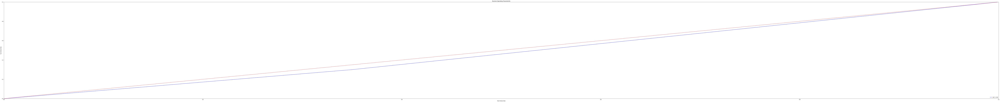

{'max_depth': 2}


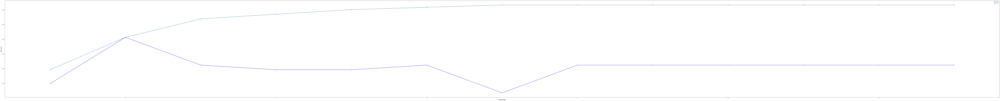

Mejor ROC-AUC en validación cruzada: 0.623
Mejor valor del hiperparámetro: {'max_depth': 2}
0.475
[[14  6]
 [15  5]]
Sensibilidad, Accuracy, precision, f1-score 0.25 0.475 0.45454545454545453 0.3225806451612903


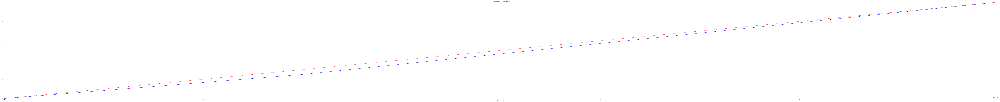

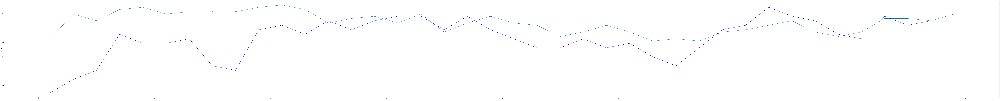

Mayor valor de la figura de mérito en validación con características estandarizadas: 0.629
Valor correspondiente para el hiperparámetro: {'n_neighbors': 63}
0.5
[[15  5]
 [15  5]]
Sensibilidad, Accuracy, precision, f1-score 0.25 0.5 0.5 0.3333333333333333


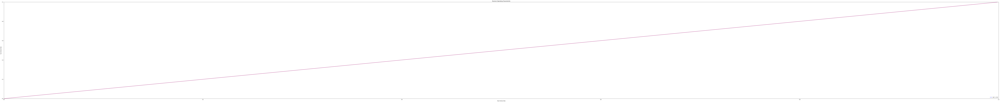

Valor correspondiente para el hiperparámetro: {'C': 50, 'gamma': 0.001, 'kernel': 'rbf'}
Mayor valor de la figura de mérito en validación con características estandarizadas: 0.629
0.45
[[14  6]
 [16  4]]
Sensibilidad, Accuracy, precision, f1-score 0.2 0.45 0.4 0.26666666666666666


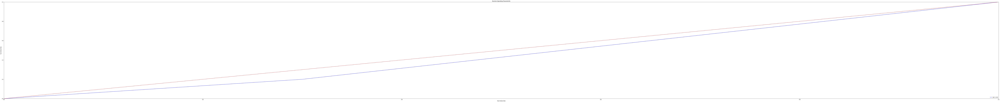

Valor correspondiente para el hiperparámetro: {'C': 0.1, 'gamma': 0.01, 'kernel': 'linear'}
Mayor valor de la figura de mérito en validación con características estandarizadas: 0.629
0.45
[[14  6]
 [16  4]]
Sensibilidad, Accuracy, precision, f1-score 0.2 0.45 0.4 0.26666666666666666


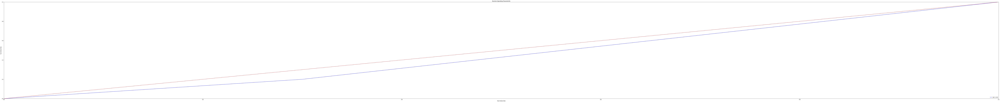

In [ ]:
#VARIABLES NORMALIZADAS CON MIN-MAX

r=regresion_logistica(X_train_ec,X_test_ec,Y_train_2,Y_test_2,2)
recall_reg_scaler.append(r[0])
accuracy_reg_scaler.append(r[1])
precision_reg_scaler.append(r[2])
f1_reg_scaler.append(r[3])
roc_reg_scaler.append(r[4])

a=decisionTree(X_train_ec,X_test_ec,Y_train_2,Y_test_2,2)
recall_arbol_scaler.append(a[0])
accuracy_arbol_scaler.append(a[1])
precision_arbol_scaler.append(a[2])
f1_arbol_scaler.append(a[3])
roc_arbol_scaler.append(a[4])

k=knn(X_train_ec,X_test_ec,Y_train_2,Y_test_2)
recall_knn_scaler.append(k[0])
accuracy_knn_scaler.append(k[1])
precision_knn_scaler.append(k[2])
f1_knn_scaler.append(k[3])
roc_knn_scaler.append(k[4])

s=svc(X_train_ec,X_test_ec,Y_train_2,Y_test_2,2)
recall_svc_scaler.append(s[0])
accuracy_svc_scaler.append(s[1])
precision_svc_scaler.append(s[2])
f1_svc_scaler.append(s[3])
roc_svc_scaler.append(s[4])

sl=svc_lineal(X_train_ec,X_test_ec,Y_train_2,Y_test_2,2)
recall_svc_lin_scaler.append(sl[0])
accuracy_svc_lin_scaler.append(sl[1])
precision_svc_lin_scaler.append(sl[2])
f1_svc_lin_scaler.append(sl[3])
roc_svc_lin_scaler.append(s[4])


In [ ]:
# from sklearn.model_selection import train_test_split, cross_val_score
X_train_scaler_all3=np.array(X_train_scaler_all3)
X_test_scaler_all3=np.array(X_test_scaler_all3)

X_train_ec = X_train_scaler_all3[:,[18,43,55,62,68,72,80,179,198]]
X_test_ec = X_test_scaler_all3[:,[18,43,55,62,68,72,80,179,198]]


Valor correspondiente para el hiperparámetro: {'C': 1e-07, 'penalty': 'l2'}
Mayor valor de la figura de mérito en validación con características estandarizadas: 0.560
0.5
[[ 0 20]
 [ 0 20]]
Sensibilidad, Accuracy, precision, f1-score 1.0 0.5 0.5 0.6666666666666666


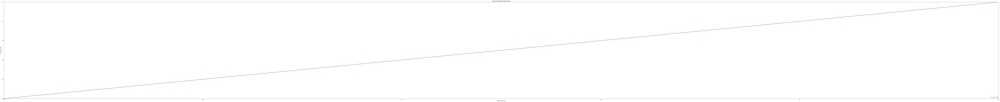

{'max_depth': 7}


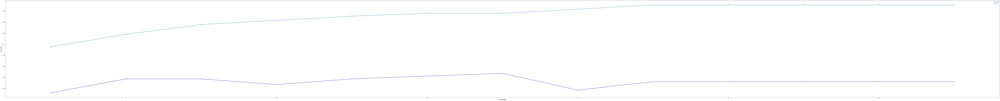

Mejor ROC-AUC en validación cruzada: 0.509
Mejor valor del hiperparámetro: {'max_depth': 7}
0.575
[[15  5]
 [12  8]]
Sensibilidad, Accuracy, precision, f1-score 0.4 0.575 0.6153846153846154 0.4848484848484849


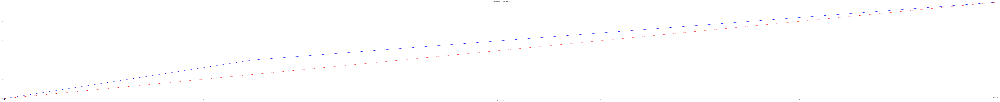

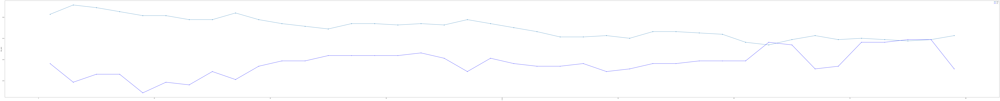

Mayor valor de la figura de mérito en validación con características estandarizadas: 0.547
Valor correspondiente para el hiperparámetro: {'n_neighbors': 75}
0.55
[[13  7]
 [11  9]]
Sensibilidad, Accuracy, precision, f1-score 0.45 0.55 0.5625 0.5


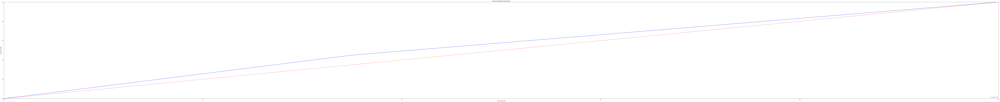

Valor correspondiente para el hiperparámetro: {'C': 50, 'gamma': 0.01, 'kernel': 'rbf'}
Mayor valor de la figura de mérito en validación con características estandarizadas: 0.535
0.575
[[13  7]
 [10 10]]
Sensibilidad, Accuracy, precision, f1-score 0.5 0.575 0.5882352941176471 0.5405405405405405


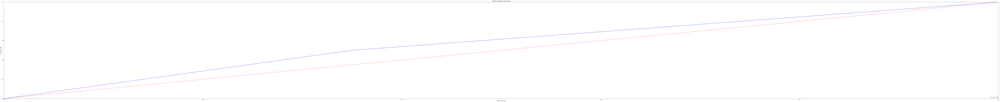

Valor correspondiente para el hiperparámetro: {'C': 1000, 'gamma': 0.01, 'kernel': 'linear'}
Mayor valor de la figura de mérito en validación con características estandarizadas: 0.542
0.575
[[13  7]
 [10 10]]
Sensibilidad, Accuracy, precision, f1-score 0.5 0.575 0.5882352941176471 0.5405405405405405


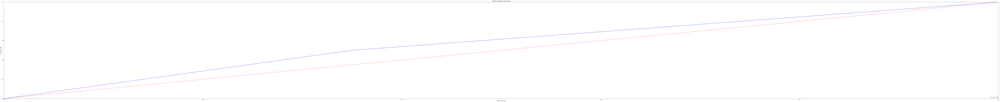

In [ ]:
#VARIABLES NORMALIZADAS CON MIN-MAX

r=regresion_logistica(X_train_ec,X_test_ec,Y_train_3,Y_test_3,3)
recall_reg_scaler.append(r[0])
accuracy_reg_scaler.append(r[1])
precision_reg_scaler.append(r[2])
f1_reg_scaler.append(r[3])
roc_reg_scaler.append(r[4])

a=decisionTree(X_train_ec,X_test_ec,Y_train_3,Y_test_3,3)
recall_arbol_scaler.append(a[0])
accuracy_arbol_scaler.append(a[1])
precision_arbol_scaler.append(a[2])
f1_arbol_scaler.append(a[3])
roc_arbol_scaler.append(a[4])

k=knn(X_train_ec,X_test_ec,Y_train_3,Y_test_3)
recall_knn_scaler.append(k[0])
accuracy_knn_scaler.append(k[1])
precision_knn_scaler.append(k[2])
f1_knn_scaler.append(k[3])
roc_knn_scaler.append(k[4])

s=svc(X_train_ec,X_test_ec,Y_train_3,Y_test_3,3)
recall_svc_scaler.append(s[0])
accuracy_svc_scaler.append(s[1])
precision_svc_scaler.append(s[2])
f1_svc_scaler.append(s[3])
roc_svc_scaler.append(s[4])

sl=svc_lineal(X_train_ec,X_test_ec,Y_train_3,Y_test_3,3)
recall_svc_lin_scaler.append(sl[0])
accuracy_svc_lin_scaler.append(sl[1])
precision_svc_lin_scaler.append(sl[2])
f1_svc_lin_scaler.append(sl[3])
roc_svc_lin_scaler.append(s[4])



In [ ]:
# from sklearn.model_selection import train_test_split, cross_val_score
X_train_scaler_all4=np.array(X_train_scaler_all4)
X_test_scaler_all4=np.array(X_test_scaler_all4)

X_train_ec = X_train_scaler_all4[:,[18,43,55,62,68,72,80,179,198]]
X_test_ec = X_test_scaler_all4[:,[18,43,55,62,68,72,80,179,198]]


Valor correspondiente para el hiperparámetro: {'C': 10, 'penalty': 'l1'}
Mayor valor de la figura de mérito en validación con características estandarizadas: 0.598
0.625
[[17  3]
 [12  8]]
Sensibilidad, Accuracy, precision, f1-score 0.4 0.625 0.7272727272727273 0.5161290322580645


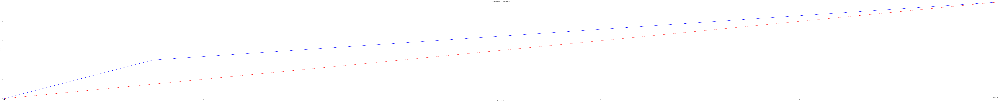

{'max_depth': 1}


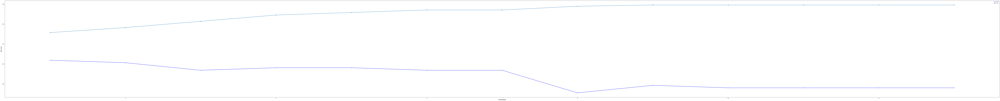

Mejor ROC-AUC en validación cruzada: 0.509
Mejor valor del hiperparámetro: {'max_depth': 1}
0.6
[[19  1]
 [15  5]]
Sensibilidad, Accuracy, precision, f1-score 0.25 0.6 0.8333333333333334 0.3846153846153846


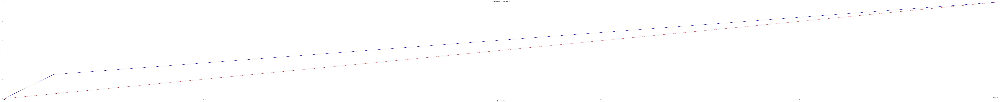

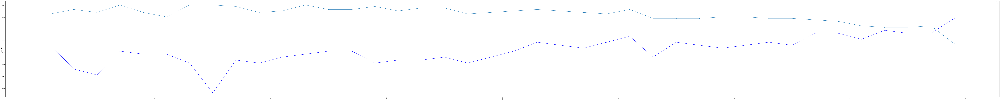

Mayor valor de la figura de mérito en validación con características estandarizadas: 0.572
Valor correspondiente para el hiperparámetro: {'n_neighbors': 79}
0.575
[[ 8 12]
 [ 5 15]]
Sensibilidad, Accuracy, precision, f1-score 0.75 0.575 0.5555555555555556 0.6382978723404256


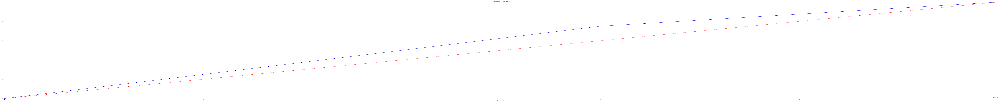

Valor correspondiente para el hiperparámetro: {'C': 100, 'gamma': 0.01, 'kernel': 'rbf'}
Mayor valor de la figura de mérito en validación con características estandarizadas: 0.540
0.6
[[16  4]
 [12  8]]
Sensibilidad, Accuracy, precision, f1-score 0.4 0.6 0.6666666666666666 0.5


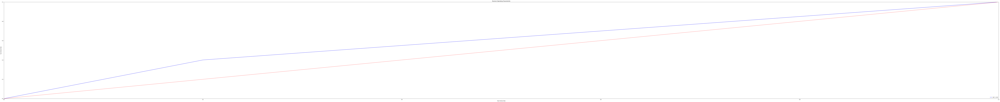

Valor correspondiente para el hiperparámetro: {'C': 25, 'gamma': 0.01, 'kernel': 'linear'}
Mayor valor de la figura de mérito en validación con características estandarizadas: 0.528
0.6
[[16  4]
 [12  8]]
Sensibilidad, Accuracy, precision, f1-score 0.4 0.6 0.6666666666666666 0.5


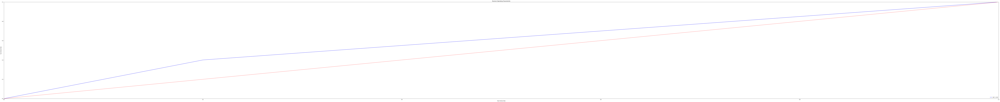

In [ ]:
#VARIABLES NORMALIZADAS CON MIN-MAX

r=regresion_logistica(X_train_ec,X_test_ec,Y_train_4,Y_test_4,4)
recall_reg_scaler.append(r[0])
accuracy_reg_scaler.append(r[1])
precision_reg_scaler.append(r[2])
f1_reg_scaler.append(r[3])
roc_reg_scaler.append(r[4])

a=decisionTree(X_train_ec,X_test_ec,Y_train_4,Y_test_4,4)
recall_arbol_scaler.append(a[0])
accuracy_arbol_scaler.append(a[1])
precision_arbol_scaler.append(a[2])
f1_arbol_scaler.append(a[3])
roc_arbol_scaler.append(a[4])

k=knn(X_train_ec,X_test_ec,Y_train_4,Y_test_4)
recall_knn_scaler.append(k[0])
accuracy_knn_scaler.append(k[1])
precision_knn_scaler.append(k[2])
f1_knn_scaler.append(k[3])
roc_knn_scaler.append(k[4])

s=svc(X_train_ec,X_test_ec,Y_train_4,Y_test_4,4)
recall_svc_scaler.append(s[0])
accuracy_svc_scaler.append(s[1])
precision_svc_scaler.append(s[2])
f1_svc_scaler.append(s[3])
roc_svc_scaler.append(s[4])

sl=svc_lineal(X_train_ec,X_test_ec,Y_train_4,Y_test_4,4)
recall_svc_lin_scaler.append(sl[0])
accuracy_svc_lin_scaler.append(sl[1])
precision_svc_lin_scaler.append(sl[2])
f1_svc_lin_scaler.append(sl[3])
roc_svc_lin_scaler.append(s[4])


In [ ]:
def plot_mean_std_metric(df_metrics, lims, metric_name='accuracy', title_figure='mean_std_plot', flag_save_figure=False):

    fig, ax = plt.subplots(1, 1, figsize=(6.5, 4.5))


    ax.plot(df_metrics['mean'], df_metrics['model'], ls='', marker='o', color='#8000FF')

    ax.hlines(df_metrics['model'], df_metrics['mean'] - df_metrics['std'], df_metrics['mean'] + df_metrics['std'],
              label='', lw=2, color='#8000FF', ls='-')

    ax.grid(axis='x', ls='-')
    ax.grid(axis='y', ls=':', lw=1, alpha=0.5)
    ax.set(
        xlabel=metric_name,
        xlim=lims,
        title=title_figure
    )

    fig.tight_layout()

    if flag_save_figure:
        fig.savefig(title_figure, dpi=300, bbox_inches='tight')
    else:
        plt.show()

In [ ]:

model_scaler=['regresión_logistica', 'árbol', 'knn','svc','svc_lineal']
mean_scaler=[np.mean(accuracy_reg_scaler), np.mean(accuracy_arbol_scaler),np.mean(accuracy_knn_scaler),np.mean(accuracy_svc_scaler),np.mean(accuracy_svc_lin_scaler)]
std_scaler=[np.std(accuracy_reg_scaler), np.std(accuracy_arbol_scaler),np.std(accuracy_knn_scaler),np.std(accuracy_svc_scaler),np.std(accuracy_svc_lin_scaler)]

df_acc_scaler= pd.DataFrame()
df_acc_scaler['model'] = None
df_acc_scaler['mean'] = None
df_acc_scaler['std'] = None


df_acc_scaler['model'] = model_scaler
df_acc_scaler['mean'] = mean_scaler
df_acc_scaler['std'] = std_scaler


In [ ]:
df_acc_scaler

,model,mean,std
0,regresión_logistica,0.600,0.101242
1,árbol,0.545,0.057879
2,knn,0.540,0.033912
3,svc,0.545,0.060000
4,svc_lineal,0.545,0.060000


In [ ]:
model2_scaler=['regresión_logistica', 'árbol', 'knn','svc', 'svc_lineal']
mean2_scaler=[np.mean(roc_reg_scaler), np.mean(roc_arbol_scaler),np.mean(roc_knn_scaler),np.mean(roc_svc_scaler),np.mean(roc_svc_lin_scaler)]
std2_scaler=[np.std(roc_reg_scaler), np.std(roc_arbol_scaler),np.std(roc_knn_scaler),np.std(roc_svc_scaler),np.std(roc_svc_lin_scaler)]

df_roc_scaler= pd.DataFrame()
df_roc_scaler['model'] = None
df_roc_scaler['mean'] = None
df_roc_scaler['std'] = None


df_roc_scaler['model'] = model2_scaler
df_roc_scaler['mean'] = mean2_scaler
df_roc_scaler['std'] = std2_scaler


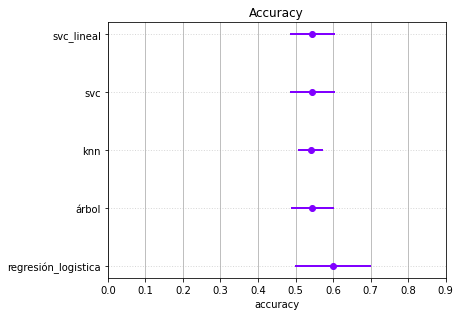

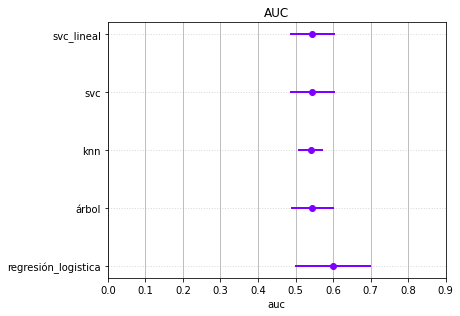

In [ ]:
#PINTAMOS GRÁFICAS PARA VARIABLES NORMALIZADAS CON STANDARD SCALER PARA ACCURACY Y ROC

plot_mean_std_metric(df_acc_scaler, lims=(0, 0.9), metric_name='accuracy',title_figure='Accuracy', flag_save_figure=True)

plot_mean_std_metric(df_roc_scaler, lims=(0, 0.9), metric_name='auc',title_figure='AUC', flag_save_figure=True)


In [ ]:
model_scaler=['regresión_logistica', 'árbol', 'knn','svc','svc_lineal']
mean_scaler=[np.mean(accuracy_reg_scaler), np.mean(accuracy_arbol_scaler),np.mean(accuracy_knn_scaler),np.mean(accuracy_svc_scaler),np.mean(accuracy_svc_lin_scaler)]
std_scaler=[np.std(accuracy_reg_scaler), np.std(accuracy_arbol_scaler),np.std(accuracy_knn_scaler),np.std(accuracy_svc_scaler),np.std(accuracy_svc_lin_scaler)]

df_acc_scaler= pd.DataFrame()
df_acc_scaler['model'] = None

df_acc_scaler['mean'] = None
df_acc_scaler['std'] = None


df_acc_scaler['model'] = model_scaler
df_acc_scaler['mean'] = mean_scaler
df_acc_scaler['std'] = std_scaler

In [ ]:
results = pd.DataFrame()
accuracy_scaler_ec=[]
accuracy_scaler_ec.append([np.mean(accuracy_reg_scaler), np.mean(accuracy_arbol_scaler),np.mean(accuracy_knn_scaler),np.mean(accuracy_svc_scaler),np.mean(accuracy_svc_lin_scaler)])
recall_ec=[]
recall_ec.append([np.mean(recall_reg_scaler), np.mean(recall_arbol_scaler),np.mean(recall_knn_scaler),np.mean(recall_svc_scaler),np.mean(recall_svc_lin_scaler)])
f1_scaler_ec=[]
f1_scaler_ec.append([np.mean(f1_reg_scaler), np.mean(f1_arbol_scaler),np.mean(f1_knn_scaler),np.mean(f1_svc_scaler),np.mean(f1_svc_lin_scaler)])
roc_scaler_ec=[]
roc_scaler_ec.append([np.mean(roc_reg_scaler), np.mean(roc_arbol_scaler),np.mean(roc_knn_scaler),np.mean(roc_svc_scaler),np.mean(roc_svc_lin_scaler)])
precision_scaler_ec=[]
precision_scaler_ec.append([np.mean(precision_reg_scaler), np.mean(precision_arbol_scaler),np.mean(precision_knn_scaler),np.mean(precision_svc_scaler),np.mean(precision_svc_lin_scaler)])

results["Accuracy"]=accuracy_scaler_ec[0]
results["Recall"]=recall_ec[0]
results["F1-score"]=f1_scaler_ec[0]
results["Auc"]=roc_scaler_ec[0]
results["Precision"]=precision_scaler_ec[0]

#results
results["Modelos"] = ["Regresión logística","árbol", "Knn","SVC","SVC-lineal"]
results.set_index("Modelos", inplace = True)

In [ ]:
results

,Accuracy,Recall,F1-score,Auc,Precision
Modelos,,,,,
Regresión logística,0.600,0.57,0.571378,0.600,0.643119
árbol,0.545,0.39,0.446028,0.545,0.617204
Knn,0.540,0.58,0.538771,0.540,0.535611
SVC,0.545,0.45,0.481441,0.545,0.564314
SVC-lineal,0.545,0.45,0.481441,0.545,0.564314


# ***Feature selection***

In [ ]:
# Creamos x (input) e y (output)
X = data_final.loc[:, data_final.columns != 'BCaseControlStatus']
Y = data_final["BCaseControlStatus"]

X.shape, Y.shape

((199, 200), (199,))

In [ ]:
X

,A01AB,A02AH,A02BA,A02BC,A03BA,A03FA,A04AA,A05A1,A05AA,A05BA,...,S01BC,S01CA,S01EA,S01ED,S01EE,S01GX,S01XA,V03AN,V09CX,V09XX
0,0,0,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,0,0,0,1,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,0,0,0,1,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
194,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
195,0,0,0,1,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
196,0,0,0,1,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
197,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [ ]:
from sklearn.model_selection import train_test_split
from sklearn.utils import shuffle

X_train, X_test, Y_train, Y_test = train_test_split(X, Y,stratify=Y,test_size=0.2, random_state=3)

In [ ]:
X_train_scaler_all=X_train
X_test_scaler_all=X_test


In [ ]:
X_train_scaler_all.shape

(159, 200)

# ***Feature selection***

# ***Métodos *embedded****

In [ ]:
feat_labels=X.columns

('A01AB', 0.00040704418207770704)
('A02AH', 0.0)
('A02BA', 0.002406716571290379)
('A02BC', 0.014341080780161244)
('A03BA', 0.006792623980565389)
('A03FA', 0.001536490689821523)
('A04AA', 0.00788351853411448)
('A05A1', 0.0008327152848381063)
('A05AA', 0.005663868295815007)
('A05BA', 0.0006059675396723826)
('A06AA', 0.0014799092459492295)
('A06AC', 0.004736616123851103)
('A06AG', 0.001362391385582244)
('A07AA', 0.001041415573823137)
('A07DA', 0.013004536145022767)
('A07EA', 0.0002970770959112428)
('A07EC', 0.009467738144618668)
('A07FA', 0.006443947464538468)
('A10AB', 0.024585150783928582)
('A10AE', 0.0037741867746303895)
('A10BA', 0.00025674574556927755)
('A10BH', 0.0027295294380401906)
('A10BJ', 0.007755460599861828)
('A10BX', 0.012800319957515469)
('A11AA', 0.00547916575646519)
('A11BA', 0.017101483305351575)
('A11CA', 0.0007122028602994921)
('A11CB', 0.0008262961208496438)
('A11CC', 0.023464342201958307)
('A11EA', 0.004763398690682089)
('A11GA', 0.007830215601463133)
('A11HA', 0.011

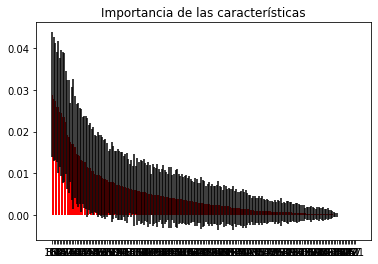

In [ ]:
from sklearn.ensemble import ExtraTreesClassifier

# Creamos un bosque aleatorio de árboles de clasificación
forest = ExtraTreesClassifier(n_estimators=250,
                              random_state=0)

# Como en árboles, no es necesario que las características estén normalizadas
# Trabajamos, por tanto, con X_train y X_test (no con las versiones estandarizadas)

forest.fit(X_train_scaler_all, Y_train)

for feature in zip(feat_labels, forest.feature_importances_):
    print(feature)
    
importances = forest.feature_importances_
std = np.std([tree.feature_importances_ for tree in forest.estimators_],
             axis=0)
indices = np.argsort(importances)[::-1]

# Muestra el ranking en el ordenamiento
print("Ranking de Características:")

for f in range(X_train_scaler_all.shape[1]):
  print("%d. Característica %d (%f)" % (f + 1, indices[f], importances[indices[f]]))

# Plot the impurity-based feature importances of the forest
plt.figure()
plt.title("Importancia de las características")
plt.bar(range(X_train_scaler_all.shape[1]), importances[indices],
        color="r", yerr=std[indices], align="center")
plt.xticks(range(X_train_scaler_all.shape[1]), indices)
plt.figsize=(60,5)
# plt.xlim([-1, X_train_scaler_all.shape[1]])
plt.show()

In [ ]:
# Create a selector object that will use the random forest classifier to identify
# features that have an importance of more than 0.15
sfm = SelectFromModel(forest, threshold=0.02)

# Train the selectorr
sfm.fit(X_train_scaler_all, Y_train)

SelectFromModel(estimator=ExtraTreesClassifier(n_estimators=250,
                                               random_state=0),
                threshold=0.02)

In [ ]:
# Print the names of the most important features
for feature_list_index in sfm.get_support(indices=True):
    print(feat_labels[feature_list_index])

A10AB
A11CC
B03AA
C03CA
C07AB
C10AA
C10BA
H03AA
N02BA
N06AB


In [ ]:
X_train_scaler_all=np.array(X_train_scaler_all)
X_test_scaler_all=np.array(X_test_scaler_all)

In [ ]:
# from sklearn.model_selection import train_test_split, cross_val_score

X_train_ec = X_train_scaler_all[:,[85,108,68,80,144,18,44,28,163,62]]
X_test_ec = X_test_scaler_all[:,[85,108,68,80,144,18,44,28,163,62]]


A continuación, evaluamos los distintos modelos con únicamente las características seleccionadas:

In [ ]:
recall_ec=[]
accuracy_scaler_ec=[]
precision_scaler_ec=[]
f1_scaler_ec=[]
roc_scaler_ec=[]

Valor correspondiente para el hiperparámetro: {'C': 1, 'penalty': 'l1'}
Mayor valor de la figura de mérito en validación con características estandarizadas: 0.579
0.625
[[14  6]
 [ 9 11]]
Sensibilidad, Accuracy, precision, f1-score 0.55 0.625 0.6470588235294118 0.5945945945945946


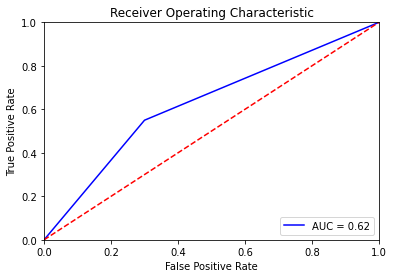

{'max_depth': 10}


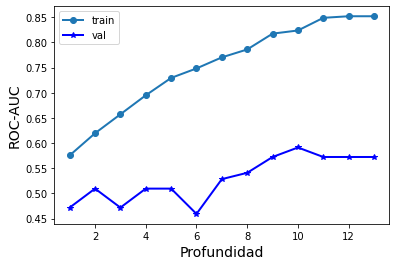

Mejor ROC-AUC en validación cruzada: 0.591
Mejor valor del hiperparámetro: {'max_depth': 10}
0.575
[[14  6]
 [11  9]]
Sensibilidad, Accuracy, precision, f1-score 0.45 0.575 0.6 0.5142857142857143


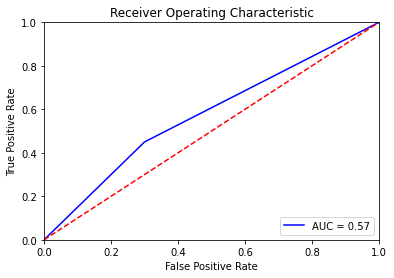

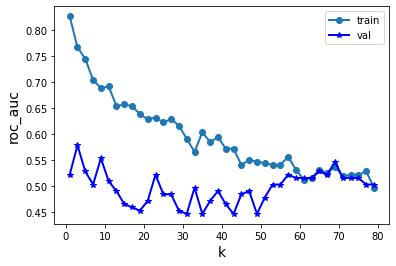

Mayor valor de la figura de mérito en validación con características estandarizadas: 0.579
Valor correspondiente para el hiperparámetro: {'n_neighbors': 3}
0.575
[[11  9]
 [ 8 12]]
Sensibilidad, Accuracy, precision, f1-score 0.6 0.575 0.5714285714285714 0.5853658536585366


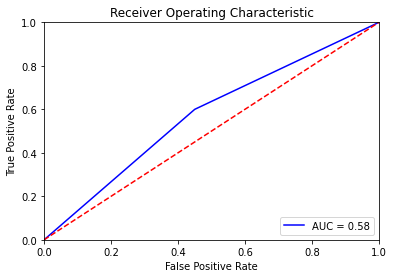

Valor correspondiente para el hiperparámetro: {'C': 100, 'gamma': 0.01, 'kernel': 'rbf'}
Mayor valor de la figura de mérito en validación con características estandarizadas: 0.598
0.625
[[14  6]
 [ 9 11]]
Sensibilidad, Accuracy, precision, f1-score 0.55 0.625 0.6470588235294118 0.5945945945945946


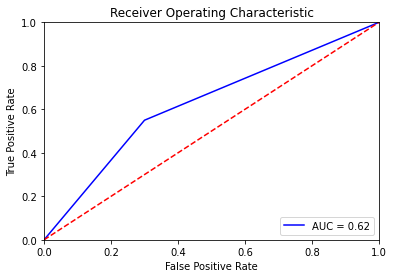

Valor correspondiente para el hiperparámetro: {'C': 100, 'gamma': 0.01, 'kernel': 'linear'}
Mayor valor de la figura de mérito en validación con características estandarizadas: 0.617
0.625
[[14  6]
 [ 9 11]]
Sensibilidad, Accuracy, precision, f1-score 0.55 0.625 0.6470588235294118 0.5945945945945946


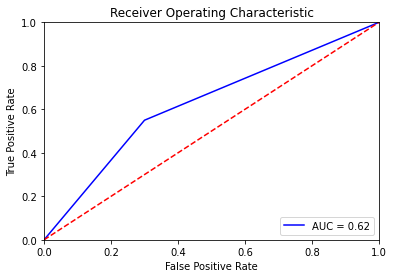

In [ ]:
#VARIABLES NORMALIZADAS CON MIN-MAX

r=regresion_logistica(X_train_ec,X_test_ec,Y_train,Y_test,3)
recall_ec.append(r[0])
accuracy_scaler_ec.append(r[1])
precision_scaler_ec.append(r[2])
f1_scaler_ec.append(r[3])
roc_scaler_ec.append(r[4])

a=decisionTree(X_train_ec,X_test_ec,Y_train,Y_test,3)
recall_ec.append(a[0])
accuracy_scaler_ec.append(a[1])
precision_scaler_ec.append(a[2])
f1_scaler_ec.append(a[3])
roc_scaler_ec.append(a[4])

k=knn(X_train_ec,X_test_ec,Y_train,Y_test)
recall_ec.append(k[0])
accuracy_scaler_ec.append(k[1])
precision_scaler_ec.append(k[2])
f1_scaler_ec.append(k[3])
roc_scaler_ec.append(k[4])

s=svc(X_train_ec,X_test_ec,Y_train,Y_test,3)
recall_ec.append(s[0])
accuracy_scaler_ec.append(s[1])
precision_scaler_ec.append(s[2])
f1_scaler_ec.append(s[3])
roc_scaler_ec.append(s[4])

sl=svc_lineal(X_train_ec,X_test_ec,Y_train,Y_test,3)
recall_ec.append(sl[0])
accuracy_scaler_ec.append(sl[1])
precision_scaler_ec.append(sl[2])
f1_scaler_ec.append(sl[3])
roc_scaler_ec.append(s[4])


In [ ]:
results = pd.DataFrame()

results["Accuracy"]=accuracy_scaler_ec
results["Recall"]=recall_ec
results["F1-score"]=f1_scaler_ec
results["Auc"]=roc_scaler_ec
results["Precision"]=precision_scaler_ec

#results
results["Modelos"] = ["Regresión logística","árbol", "Knn","SVC","SVC-lineal"]
results.set_index("Modelos", inplace = True)

In [ ]:
results

,Accuracy,Recall,F1-score,Auc,Precision
Modelos,,,,,
Regresión logística,0.625,0.55,0.594595,0.625,0.647059
árbol,0.575,0.45,0.514286,0.575,0.600000
Knn,0.575,0.60,0.585366,0.575,0.571429
SVC,0.625,0.55,0.594595,0.625,0.647059
SVC-lineal,0.625,0.55,0.594595,0.625,0.647059


# ***Método filter***

A continuación, a partir de validación cruzada con 3 folds, obtenemos el fold1, fold2 y fold3:

In [ ]:
# Convertimos el objeto dataframe en un array (mayor velocidad de cómputo)
# # array = data.values
X_train_scaler_all=np.array(X_train_scaler_all)
X_test_scaler_all=np.array(X_test_scaler_all)
Y_train=(np.array(Y_train))
Y_test=np.array(Y_test)
# # Separamos en variables de entrada al modelo (8 primeras) y de salida (1 variable) 
# X = array[:,1:59]
# Y = array[:,0]

names=[]
for i in range(19):
  names.append(str(i))
# names = ['f0', 'f1', 'f2', 'f3', 'f4', 'f5', 'f6', 'f7', 'f8', 'f9', 'f10', 'f11','f12','f13','f13','f13','f13','f13','f13','f13','f13','f13','f13','f13','f13','f13','f13','f13','f13','f13']
# names = data.columns[1:]
names

['0',
 '1',
 '2',
 '3',
 '4',
 '5',
 '6',
 '7',
 '8',
 '9',
 '10',
 '11',
 '12',
 '13',
 '14',
 '15',
 '16',
 '17',
 '18']

In [ ]:
from sklearn.model_selection import KFold
kf = KFold(n_splits=3)  # In this case, k=3, 

for train, val in kf.split(X_train_scaler_all):
  # print("%s %s" % (train, val))
  # print(len(val))
  # print(val)
  if (len(val)==53) and (val[0]==106):
    fold3=list(val)
    print(len(fold3))
    print(fold3)
  if (len(val)==53) and (val[0]==0):
    fold1=list(val)
    print(len(fold1))
    print(fold1)
  if (len(val)==53) and (val[0]==53):
    fold2=list(val)
    print(len(fold2))
    print(fold2)

53
[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52]
53
[53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105]
53
[106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158]


# ***COMBINACIÓN PRIMERA***


En esta primera combinación utilizaremos fold1 y fold2 para entrenar, y fold3 para validar:

In [ ]:
X_entrenamiento=np.concatenate((X_train_scaler_all[fold1], X_train_scaler_all[fold2]))
Y_entrenamiento=np.concatenate((Y_train[fold1], Y_train[fold2]))
X_val=X_train_scaler_all[fold3]
Y_val=Y_train[fold3]

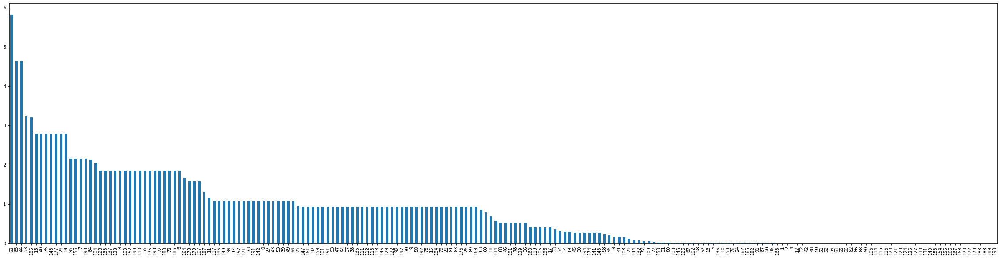

In [ ]:
from sklearn.feature_selection import SelectKBest, chi2, mutual_info_classif

bestfeatures_Chi2 = SelectKBest(score_func=chi2, k='all')
fit_Chi2 = bestfeatures_Chi2.fit(X_entrenamiento, Y_entrenamiento)
fit_Chi2 = pd.Series(fit_Chi2.scores_)
fit_Chi2.sort_values(ascending=False)

fit_Chi2.sort_values(ascending=False).plot.bar(figsize=(40, 10))

# # gráfico de barras utilizando matplotlib
# df = pd.DataFrame({'Nombre_feat':names, 'valores':fit_Chi2.scores_})
# ax = df.plot.bar(x='Nombre_feat', y='valores', rot=0, figsize=(5,5))
# # df, ax = plt.subplots(figsize=(50, 8))
# plt.title("Chi2 considerando subconjunto X train")

# ***COMBINACIÓN 2***

En esta combinación usaremos fold1 y fold3 para entrenar y usaremos fold 2 para validar:

In [ ]:
X_entrenamiento2=np.concatenate((X_train_scaler_all[fold1], X_train_scaler_all[fold3]))
Y_entrenamiento2=np.concatenate((Y_train[fold1], Y_train[fold3]))
X_val2=X_train_scaler_all[fold2]
Y_val2=Y_train[fold2]

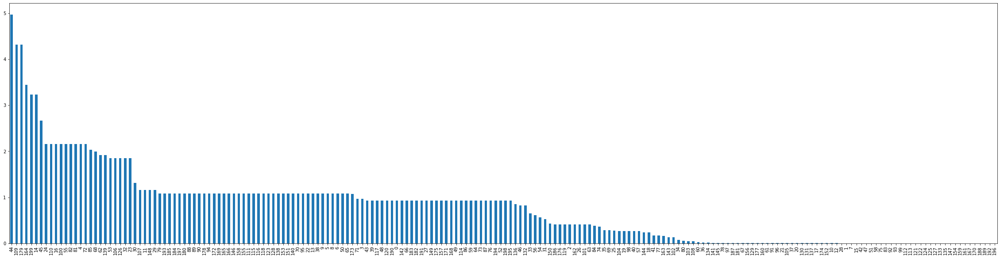

In [ ]:
bestfeatures_Chi2_2 = SelectKBest(score_func=chi2, k='all')
fit_Chi2_2 = bestfeatures_Chi2_2.fit(X_entrenamiento2, Y_entrenamiento2)
fit_Chi2_2 = pd.Series(fit_Chi2_2.scores_)
fit_Chi2_2.sort_values(ascending=False)

fit_Chi2_2.sort_values(ascending=False).plot.bar(figsize=(40, 10))

# # gráfico de barras utilizando matplotlib
# df = pd.DataFrame({'Nombre_feat':names, 'valores':fit_Chi2_2.scores_.sort_values})
# ax = df.plot.bar(x='Nombre_feat', y='valores', rot=0,figsize=(50,8))
# plt.title("Estadístico chi cuadrado considerando subconjunto X train")

# ***COMBINACIÓN 3***

En este último caso, utilizaremos el fold 2 y fold3 para entrenar y el fold 1 para validar:

In [ ]:
X_entrenamiento3=np.concatenate((X_train_scaler_all[fold2], X_train_scaler_all[fold3]))
Y_entrenamiento3=np.concatenate((Y_train[fold2], Y_train[fold3]))
X_val3=X_train_scaler_all[fold1]
Y_val3=Y_train[fold1]

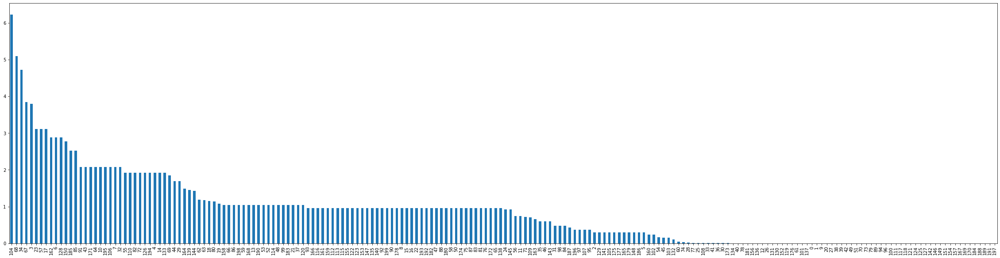

In [ ]:
bestfeatures_Chi2_3 = SelectKBest(score_func=chi2, k='all')
fit_Chi2_3 = bestfeatures_Chi2_3.fit(X_entrenamiento3, Y_entrenamiento3)
fit_Chi2_3 = pd.Series(fit_Chi2_3.scores_)
fit_Chi2_3.sort_values(ascending=False)

fit_Chi2_3.sort_values(ascending=False).plot.bar(figsize=(40, 10))
# gráfico de barras utilizando matplotlib
# df = pd.DataFrame({'Nombre_feat':names, 'valores':fit_Chi2_3.scores_})
# ax = df.plot.bar(x='Nombre_feat', y='valores', rot=0, figsize=(50,8))
# plt.title("Estadístico chi cuadrado considerando subconjunto X train")

In [ ]:
# from sklearn.model_selection import train_test_split, cross_val_score

X_train_ec = X_train_scaler_all[:,[44,23,17]]
X_test_ec = X_test_scaler_all[:,[44,23,17]]


In [ ]:
X.iloc[:, 23]

0      0
1      0
2      0
3      0
4      0
      ..
194    0
195    0
196    0
197    0
198    0
Name: A10BX, Length: 199, dtype: int64

* B03AA
* A10BX


A continuación, evaluamos los distintos modelos con únicamente las características seleccionadas:

In [ ]:
recall_ec=[]
accuracy_scaler_ec=[]
precision_scaler_ec=[]
f1_scaler_ec=[]
roc_scaler_ec=[]

Valor correspondiente para el hiperparámetro: {'C': 1e-07, 'penalty': 'l2'}
Mayor valor de la figura de mérito en validación con características estandarizadas: 0.541
0.5
[[ 0 20]
 [ 0 20]]
Sensibilidad, Accuracy, precision, f1-score 1.0 0.5 0.5 0.6666666666666666


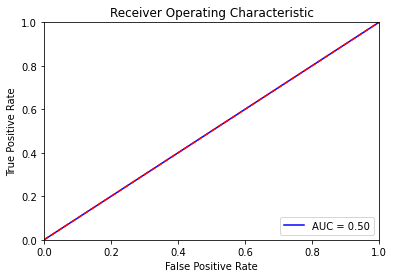

{'max_depth': 2}


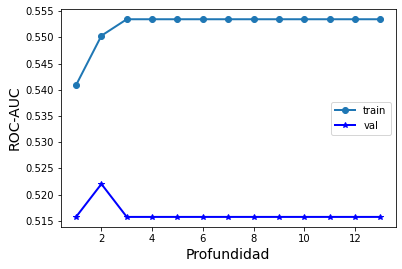

Mejor ROC-AUC en validación cruzada: 0.522
Mejor valor del hiperparámetro: {'max_depth': 2}
0.5
[[20  0]
 [20  0]]
Sensibilidad, Accuracy, precision, f1-score 0.0 0.5 0.0 0.0


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


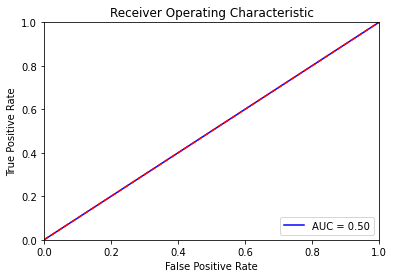

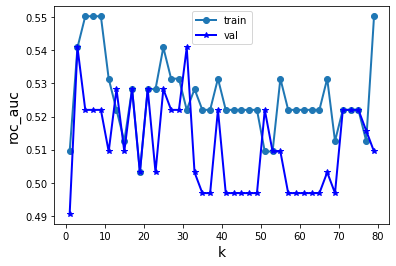

Mayor valor de la figura de mérito en validación con características estandarizadas: 0.541
Valor correspondiente para el hiperparámetro: {'n_neighbors': 3}
0.5
[[20  0]
 [20  0]]
Sensibilidad, Accuracy, precision, f1-score 0.0 0.5 0.0 0.0


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


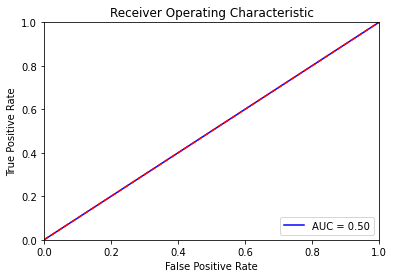

Valor correspondiente para el hiperparámetro: {'C': 10, 'gamma': 0.01, 'kernel': 'rbf'}
Mayor valor de la figura de mérito en validación con características estandarizadas: 0.522
0.5
[[20  0]
 [20  0]]
Sensibilidad, Accuracy, precision, f1-score 0.0 0.5 0.0 0.0


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


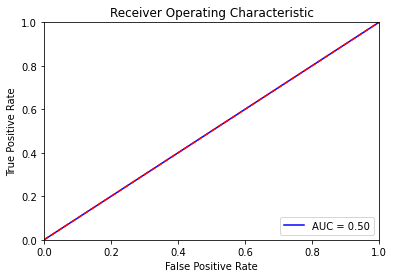

Valor correspondiente para el hiperparámetro: {'C': 10, 'gamma': 0.01, 'kernel': 'linear'}
Mayor valor de la figura de mérito en validación con características estandarizadas: 0.522
0.5
[[20  0]
 [20  0]]
Sensibilidad, Accuracy, precision, f1-score 0.0 0.5 0.0 0.0


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


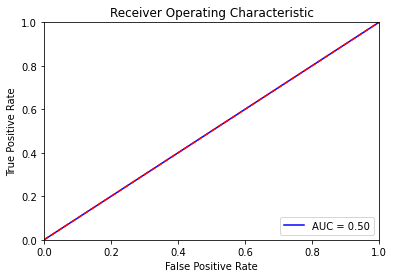

In [ ]:
#VARIABLES NORMALIZADAS CON MIN-MAX

r=regresion_logistica(X_train_ec,X_test_ec,Y_train,Y_test,3)
recall_ec.append(r[0])
accuracy_scaler_ec.append(r[1])
precision_scaler_ec.append(r[2])
f1_scaler_ec.append(r[3])
roc_scaler_ec.append(r[4])

a=decisionTree(X_train_ec,X_test_ec,Y_train,Y_test,3)
recall_ec.append(a[0])
accuracy_scaler_ec.append(a[1])
precision_scaler_ec.append(a[2])
f1_scaler_ec.append(a[3])
roc_scaler_ec.append(a[4])

k=knn(X_train_ec,X_test_ec,Y_train,Y_test)
recall_ec.append(k[0])
accuracy_scaler_ec.append(k[1])
precision_scaler_ec.append(k[2])
f1_scaler_ec.append(k[3])
roc_scaler_ec.append(k[4])

s=svc(X_train_ec,X_test_ec,Y_train,Y_test,3)
recall_ec.append(s[0])
accuracy_scaler_ec.append(s[1])
precision_scaler_ec.append(s[2])
f1_scaler_ec.append(s[3])
roc_scaler_ec.append(s[4])

sl=svc_lineal(X_train_ec,X_test_ec,Y_train,Y_test,3)
recall_ec.append(sl[0])
accuracy_scaler_ec.append(sl[1])
precision_scaler_ec.append(sl[2])
f1_scaler_ec.append(sl[3])
roc_scaler_ec.append(s[4])


In [ ]:
results = pd.DataFrame()

results["Accuracy"]=accuracy_scaler_ec
results["Recall"]=recall_ec
results["F1-score"]=f1_scaler_ec
results["Auc"]=roc_scaler_ec
results["Precision"]=precision_scaler_ec

#results
results["Modelos"] = ["Regresión logística","árbol", "Knn","SVC","SVC-lineal"]
results.set_index("Modelos", inplace = True)

In [ ]:
results

,Accuracy,Recall,F1-score,Auc,Precision
Modelos,,,,,
Regresión logística,0.5,1.0,0.666667,0.5,0.5
árbol,0.5,0.0,0.000000,0.5,0.0
Knn,0.5,0.0,0.000000,0.5,0.0
SVC,0.5,0.0,0.000000,0.5,0.0
SVC-lineal,0.5,0.0,0.000000,0.5,0.0


# ***RANDOM FOREST***

In [ ]:

from sklearn.feature_selection import SelectFromModel
from sklearn.ensemble import RandomForestClassifier


In [ ]:
feat_labels=X.columns

('A01AB', 0.000736596862102396)
('A02AH', 0.0)
('A02BA', 0.004153923999523395)
('A02BC', 0.016679751443544406)
('A03BA', 0.003671351910736247)
('A03FA', 0.0013948089871471856)
('A04AA', 0.004754392259410239)
('A05A1', 0.0008613110743246975)
('A05AA', 0.0038644994427412035)
('A05BA', 0.000698445520474075)
('A06AA', 0.0019370974441975945)
('A06AC', 0.005639612729163631)
('A06AG', 0.0011578626142737243)
('A07AA', 0.001195457330039751)
('A07DA', 0.00814809159999114)
('A07EA', 0.0005162667292999884)
('A07EC', 0.00569469722027852)
('A07FA', 0.005010587011218913)
('A10AB', 0.02517445195026333)
('A10AE', 0.006360192306446904)
('A10BA', 0.0008722807312683833)
('A10BH', 0.0028229544483293124)
('A10BJ', 0.004383508445092691)
('A10BX', 0.007156712194747518)
('A11AA', 0.0039063357035926515)
('A11BA', 0.01821060542396803)
('A11CA', 0.0015541789267976562)
('A11CB', 0.0012249210932044167)
('A11CC', 0.024981157561014808)
('A11EA', 0.006511717232380097)
('A11GA', 0.009170441534063196)
('A11HA', 0.013554

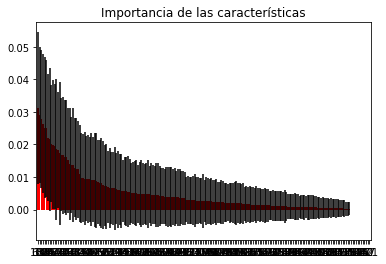

In [ ]:
# Create a random forest classifier
clf = RandomForestClassifier(n_estimators=10000, random_state=0, n_jobs=-1)

# Train the classifier
clf.fit(X_train_scaler_all, Y_train)

# Print the name and gini importance of each feature
for feature in zip(feat_labels, clf.feature_importances_):
    print(feature)

importances = clf.feature_importances_
std = np.std([tree.feature_importances_ for tree in clf.estimators_],
             axis=0)
indices = np.argsort(importances)[::-1]
# Muestra el ranking en el ordenamiento
print("Ranking de Características:")

for f in range(X_train_scaler_all.shape[1]):
  print("%d. Característica %d (%f)" % (f + 1, indices[f], importances[indices[f]]))

# Plot the impurity-based feature importances of the forest
plt.figure()
plt.title("Importancia de las características")
plt.bar(range(X_train_scaler_all.shape[1]), importances[indices],
        color="r", yerr=std[indices], align="center")
plt.xticks(range(X_train_scaler_all.shape[1]), indices)
plt.xlim([-1, X_train_scaler_all.shape[1]])
plt.show()


In [ ]:
# Create a selector object that will use the random forest classifier to identify
# features that have an importance of more than 0.15
sfm = SelectFromModel(clf, threshold=0.01)

# Train the selector
sfm.fit(X_train_scaler_all, Y_train)

SelectFromModel(estimator=RandomForestClassifier(n_estimators=10000, n_jobs=-1,
                                                 random_state=0),
                threshold=0.01)

In [ ]:
# Print the names of the most important features
for feature_list_index in sfm.get_support(indices=True):
    print(feat_labels[feature_list_index])

A02BC
A10AB
A11BA
A11CC
A11HA
A12AA
B01AC
B03AA
C01DA
C03AA
C03CA
C07AB
C08CA
C09AA
C09CA
C10AA
C10AX
C10BA
G04BE
G04CA
H03AA
N02BA
N03AX
N06AB
N06AX
R06AX


In [ ]:
# from sklearn.model_selection import train_test_split, cross_val_score

X_train_ec = X_train_scaler_all[:,[68,108,80,144,18,28,74,85,77]]
X_test_ec = X_test_scaler_all[:,[68,108,80,144,18,28,74,85,77]]


A continuación, evaluamos los distintos modelos con únicamente las características seleccionadas:

In [ ]:
recall_ec=[]
accuracy_scaler_ec=[]
precision_scaler_ec=[]
f1_scaler_ec=[]
roc_scaler_ec=[]

Valor correspondiente para el hiperparámetro: {'C': 10, 'penalty': 'l2'}
Mayor valor de la figura de mérito en validación con características estandarizadas: 0.516
0.525
[[11  9]
 [10 10]]
Sensibilidad, Accuracy, precision, f1-score 0.5 0.525 0.5263157894736842 0.5128205128205129


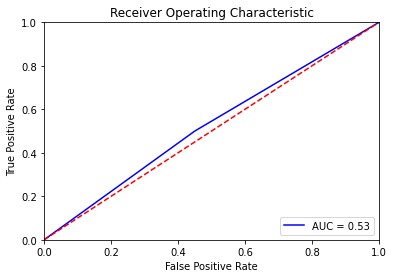

{'max_depth': 8}


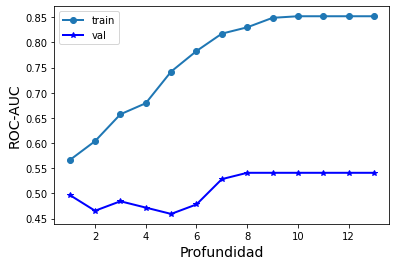

Mejor ROC-AUC en validación cruzada: 0.541
Mejor valor del hiperparámetro: {'max_depth': 8}
0.45
[[12  8]
 [14  6]]
Sensibilidad, Accuracy, precision, f1-score 0.3 0.45 0.42857142857142855 0.3529411764705882


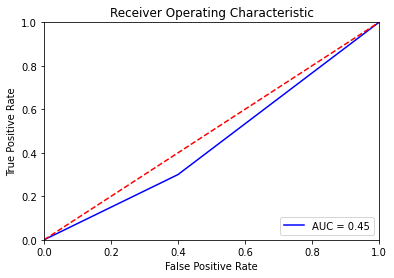

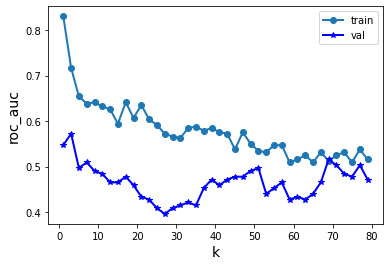

Mayor valor de la figura de mérito en validación con características estandarizadas: 0.572
Valor correspondiente para el hiperparámetro: {'n_neighbors': 3}
0.45
[[ 9 11]
 [11  9]]
Sensibilidad, Accuracy, precision, f1-score 0.45 0.45 0.45 0.45


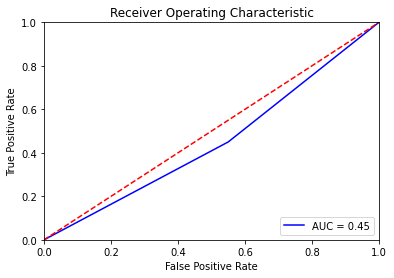

Valor correspondiente para el hiperparámetro: {'C': 0.001, 'gamma': 0.01, 'kernel': 'rbf'}
Mayor valor de la figura de mérito en validación con características estandarizadas: 0.516
0.5
[[ 0 20]
 [ 0 20]]
Sensibilidad, Accuracy, precision, f1-score 1.0 0.5 0.5 0.6666666666666666


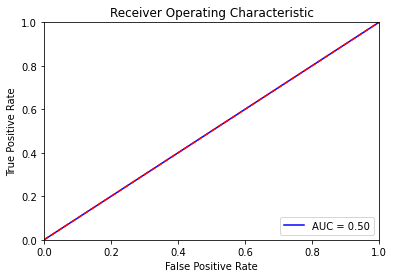

Valor correspondiente para el hiperparámetro: {'C': 0.001, 'gamma': 0.01, 'kernel': 'linear'}
Mayor valor de la figura de mérito en validación con características estandarizadas: 0.516
0.5
[[ 0 20]
 [ 0 20]]
Sensibilidad, Accuracy, precision, f1-score 1.0 0.5 0.5 0.6666666666666666


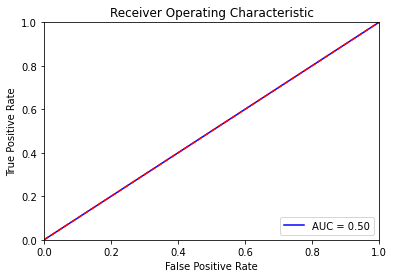

In [ ]:
#VARIABLES NORMALIZADAS CON MIN-MAX

r=regresion_logistica(X_train_ec,X_test_ec,Y_train,Y_test,3)
recall_ec.append(r[0])
accuracy_scaler_ec.append(r[1])
precision_scaler_ec.append(r[2])
f1_scaler_ec.append(r[3])
roc_scaler_ec.append(r[4])

a=decisionTree(X_train_ec,X_test_ec,Y_train,Y_test,3)
recall_ec.append(a[0])
accuracy_scaler_ec.append(a[1])
precision_scaler_ec.append(a[2])
f1_scaler_ec.append(a[3])
roc_scaler_ec.append(a[4])

k=knn(X_train_ec,X_test_ec,Y_train,Y_test)
recall_ec.append(k[0])
accuracy_scaler_ec.append(k[1])
precision_scaler_ec.append(k[2])
f1_scaler_ec.append(k[3])
roc_scaler_ec.append(k[4])

s=svc(X_train_ec,X_test_ec,Y_train,Y_test,3)
recall_ec.append(s[0])
accuracy_scaler_ec.append(s[1])
precision_scaler_ec.append(s[2])
f1_scaler_ec.append(s[3])
roc_scaler_ec.append(s[4])

sl=svc_lineal(X_train_ec,X_test_ec,Y_train,Y_test,3)
recall_ec.append(sl[0])
accuracy_scaler_ec.append(sl[1])
precision_scaler_ec.append(sl[2])
f1_scaler_ec.append(sl[3])
roc_scaler_ec.append(s[4])


In [ ]:
results = pd.DataFrame()

results["Accuracy"]=accuracy_scaler_ec
results["Recall"]=recall_ec
results["F1-score"]=f1_scaler_ec
results["Auc"]=roc_scaler_ec
results["Precision"]=precision_scaler_ec

#results
results["Modelos"] = ["Regresión logística","árbol", "Knn","SVC","SVC-lineal"]
results.set_index("Modelos", inplace = True)

In [ ]:
results

,Accuracy,Recall,F1-score,Auc,Precision
Modelos,,,,,
Regresión logística,0.525,0.50,0.512821,0.525,0.526316
árbol,0.450,0.30,0.352941,0.450,0.428571
Knn,0.450,0.45,0.450000,0.450,0.450000
SVC,0.500,1.00,0.666667,0.500,0.500000
SVC-lineal,0.500,1.00,0.666667,0.500,0.500000


# ***Visualización de datos***

# ***Preprocesado de datos***

# ***Valores perdidos***

In [ ]:
(data_final == 0).sum(axis=0)

BCaseControlStatus     99
A01AB                 198
A02AH                 198
A02BA                 194
A02BC                 153
                     ... 
S01GX                 197
S01XA                 196
V03AN                 198
V09CX                 197
V09XX                 195
Length: 201, dtype: int64

In [ ]:
data_final.isna().sum()

BCaseControlStatus    0
A01AB                 0
A02AH                 0
A02BA                 0
A02BC                 0
                     ..
S01GX                 0
S01XA                 0
V03AN                 0
V09CX                 0
V09XX                 0
Length: 201, dtype: int64

Vemos que para la variable Column1 y _1, prácticamente todos los pacientes presentan valores nulos, por lo que lo más adecuado sería eliminar esas variables de nuestro dataframe. 

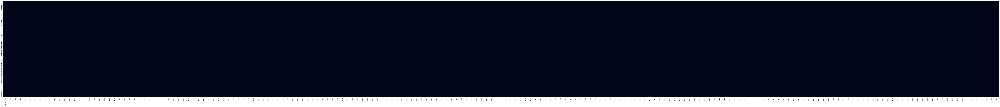

In [ ]:
import seaborn as sns

# Identificamos los missing values visualmente
sns.heatmap(data_final.isnull(), cbar=False)

In [ ]:
X = data_final.loc[:, data_final.columns != 'BCaseControlStatus']
Y= data_final["BCaseControlStatus"]

X.shape, Y.shape

((199, 200), (199,))

In [ ]:
from sklearn.model_selection import train_test_split
from sklearn.utils import shuffle

X_train, X_test, Y_train, Y_test = train_test_split(X, Y,stratify=Y,test_size=0.2, random_state=4)

In [ ]:
X_train.shape

(159, 200)

In [ ]:


from sklearn.preprocessing import StandardScaler
from sklearn import preprocessing


std_all2 = preprocessing.StandardScaler().fit(X_train)
X_std_train2 = std_all2.transform(X_train) #Tendriamos todas las características estandarizadas
X_std_test2 = std_all2.transform(X_test)

In [ ]:
# Regresión logística con regularización 
from sklearn.linear_model import LogisticRegression
from sklearn import model_selection   
from sklearn import metrics
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split, GridSearchCV

logreg= LogisticRegression(solver='liblinear')
parameters = {"C":[1e-8,1e-4,10,100],"penalty":["l1","l2"]}# l1 lasso l2 ridge
valor_C=np.array([1e-8,1e-4,10,100])
log_regression=GridSearchCV(logreg, parameters, scoring='roc_auc', cv=5, return_train_score=True)

log_regression.fit(X_train, Y_train) #Entrenamos

# #Evaluamos las prestaciones para el conjunto de entrenamiento, de validación y representamos
roc_log_train = np.array(log_regression.cv_results_['mean_train_score']) 
roc_loc_val = np.array(log_regression.cv_results_['mean_test_score'])

# #Pintamos la evolución de nuestro modelo tanto en train como en validación para ver cuál es el mejor hiperparámetro para generalizar
# plt.plot(valor_C,roc_log_train,'-o',label="train", linewidth=2)
# plt.plot(valor_C,roc_loc_val,'-*b',label="val", linewidth=2)
# plt.xlabel('C',fontsize=14)
# plt.ylabel('Roc_auc',fontsize=14)
# plt.legend()
# plt.show()

# Mostramos el mejor valor del parámetro y el score
print("Valor correspondiente para el hiperparámetro: {}".format(log_regression.best_params_))
print("Mayor valor de la figura de mérito en validación con características estandarizadas: {:.3f}".format(log_regression.best_score_))






Valor correspondiente para el hiperparámetro: {'C': 100, 'penalty': 'l1'}
Mayor valor de la figura de mérito en validación con características estandarizadas: 0.595


In [ ]:
from sklearn.linear_model import Lasso

logridge=LogisticRegression(solver='liblinear', penalty='l1', C=100)
modelo_rid_log=logridge.fit(X_train, Y_train)

# Obtenemos la salida predicha
y_pred_ridlog = modelo_rid_log.predict(X_test)




In [ ]:
from sklearn.metrics import confusion_matrix
from sklearn.metrics import accuracy_score
from sklearn.metrics import classification_report
from sklearn.metrics import recall_score

#  Calculamos la matriz de confusión
cm = confusion_matrix(Y_test, y_pred_ridlog)
print(cm)

tn, fp, fn, tp = confusion_matrix(Y_test, y_pred_ridlog).ravel()
print(f'tn: {tn}, fp:{fp}, fn:{fn}, tp:{tp}')

# Calcumos accuracy_score
Accuracy=accuracy_score(Y_test, y_pred_ridlog)
print(f'Accuracy: {Accuracy}')

target_names = ['Paciente control', 'Paciente caso']
print(classification_report(Y_test, y_pred_ridlog, target_names=target_names))
              
#Sensibilidad
Sensibilidad_3 = recall_score(Y_test, y_pred_ridlog)
# S_results.append(Sensibilidad_3)
print(f'Sensibilidad: {Sensibilidad_3}')

[[ 9 11]
 [ 4 16]]
tn: 9, fp:11, fn:4, tp:16
Accuracy: 0.625
                  precision    recall  f1-score   support

Paciente control       0.69      0.45      0.55        20
   Paciente caso       0.59      0.80      0.68        20

        accuracy                           0.62        40
       macro avg       0.64      0.62      0.61        40
    weighted avg       0.64      0.62      0.61        40

Sensibilidad: 0.8


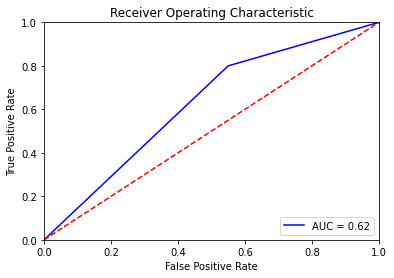

In [ ]:
fpr, tpr, threshold = metrics.roc_curve(Y_test, y_pred_ridlog)
roc_auc_1 = metrics.auc(fpr, tpr)
# AUC_results.append(roc_auc_1)

# Plot the ROC curve
import matplotlib.pyplot as plt
plt.title('Receiver Operating Characteristic')
plt.plot(fpr, tpr, 'b', label = 'AUC = %0.2f' % roc_auc_1)
plt.legend(loc = 'lower right')
plt.plot([0, 1], [0, 1],'r--')
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.show()

In [ ]:
res_accuracy=[]
res_recall=[]
res_f1=[]
res_roc=[]

In [ ]:

A1_score = accuracy_score(Y_test, y_pred_ridlog)
f11_score = f1_score(Y_test, y_pred_ridlog)
r1_score = recall_score(Y_test, y_pred_ridlog)
fpr, tpr, threshold = metrics.roc_curve(Y_test, y_pred_ridlog)
roc_auc_1 = metrics.auc(fpr, tpr)
print("El valor de accuracy obtenido:", A1_score)
print("La matriz de confusión obtenida:", confusion_matrix(Y_test, y_pred_ridlog))
print("El valor de f1_score obtenido:", f11_score)
print("El valor de recall es", r1_score)

El valor de accuracy obtenido: 0.625
La matriz de confusión obtenida: [[ 9 11]
 [ 4 16]]
El valor de f1_score obtenido: 0.6808510638297872
El valor de recall es 0.8


In [ ]:
res_accuracy.append(A1_score)
res_recall.append(r1_score)
res_f1.append(f11_score)
res_roc.append(roc_auc_1)

# **Knn por votación**

In [ ]:

from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.neighbors import KNeighborsRegressor
from sklearn.metrics import mean_absolute_error, mean_squared_error
from sklearn import model_selection
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix
from sklearn.metrics import accuracy_score
from sklearn.metrics import f1_score
from sklearn.metrics import recall_score
from sklearn.neighbors import KNeighborsClassifier
from sklearn import preprocessing
#from mlxtend.plotting import plot_learning_curves

In [ ]:
def knn (figura):
  # 5. Selección del hiper-parámetro haciendo uso del conjunto de diseño con características estandarizadas. 

  param_grid = {'n_neighbors': range(1,81,2)}
  k_grid = np.array(range(1,81,2))
  grid_knn = GridSearchCV(KNeighborsClassifier(), param_grid = param_grid, scoring = figura, cv=3, return_train_score=True)
  grid_knn.fit(X_train, Y_train) 

  #Evaluamos las prestaciones para el conjunto de entrenamiento, de validación y representamos
  
  auc_knn_all_train = np.array(grid_knn.cv_results_['mean_train_score'])
  auc_knn_all_val = np.array(grid_knn.cv_results_['mean_test_score'])


  plt.plot(k_grid,auc_knn_all_train,'-o',label="train", linewidth=2)
  plt.plot(k_grid,auc_knn_all_val,'-*b',label="val", linewidth=2)
  plt.xlabel('k',fontsize=14)
  plt.ylabel(figura,fontsize=14)
  plt.legend()
  plt.show()

  print("Mayor valor de la figura de mérito en validación con características estandarizadas: {:.3f}".format(grid_knn.best_score_))
  print("Valor correspondiente para el hiperparámetro: {}".format(grid_knn.best_params_))

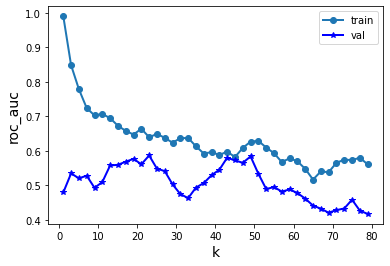

Mayor valor de la figura de mérito en validación con características estandarizadas: 0.587
Valor correspondiente para el hiperparámetro: {'n_neighbors': 23}


In [ ]:
knn('roc_auc')

In [ ]:
kNN_clasif_all = KNeighborsClassifier(n_neighbors = 23)
modelo_knn_clasif2 = kNN_clasif_all.fit(X_train, Y_train) 
y_output_knn2 = modelo_knn_clasif2.predict(X_test)
A1_score = accuracy_score(Y_test, y_output_knn2)
f11_score = f1_score(Y_test, y_output_knn2)
r1_score = recall_score(Y_test, y_output_knn2)

print("El valor de accuracy obtenido:", A1_score)
print("La matriz de confusión obtenida:", confusion_matrix(Y_test, y_output_knn2))
print("El valor de f1_score obtenido:", f11_score)
print("El valor de recall es", r1_score)

El valor de accuracy obtenido: 0.45
La matriz de confusión obtenida: [[ 6 14]
 [ 8 12]]
El valor de f1_score obtenido: 0.5217391304347826
El valor de recall es 0.6


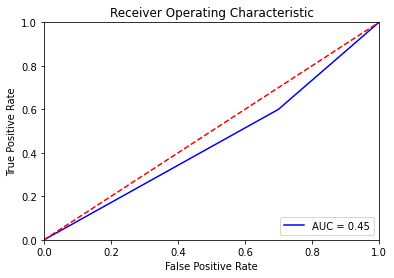

In [ ]:
fpr, tpr, threshold = metrics.roc_curve(Y_test, y_output_knn2)
roc_auc_1 = metrics.auc(fpr, tpr)
# AUC_results.append(roc_auc_1)

# Plot the ROC curve
import matplotlib.pyplot as plt
plt.title('Receiver Operating Characteristic')
plt.plot(fpr, tpr, 'b', label = 'AUC = %0.2f' % roc_auc_1)
plt.legend(loc = 'lower right')
plt.plot([0, 1], [0, 1],'r--')
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.show()

In [ ]:

#  Calculamos la matriz de confusión
cm = confusion_matrix(Y_test, y_output_knn2)
print(cm)

tn, fp, fn, tp = confusion_matrix(Y_test, y_output_knn2).ravel()
print(f'tn: {tn}, fp:{fp}, fn:{fn}, tp:{tp}')

# Calcumos accuracy_score
Accuracy=accuracy_score(Y_test, y_output_knn2)
print(f'Accuracy: {Accuracy}')

target_names = ['Paciente control', 'Paciente caso']
print(classification_report(Y_test, y_output_knn2, target_names=target_names))
              
#Sensibilidad
Sensibilidad_3 = recall_score(Y_test, y_output_knn2)
# S_results.append(Sensibilidad_3)
print(f'Sensibilidad: {Sensibilidad_3}')

[[ 6 14]
 [ 8 12]]
tn: 6, fp:14, fn:8, tp:12
Accuracy: 0.45
                  precision    recall  f1-score   support

Paciente control       0.43      0.30      0.35        20
   Paciente caso       0.46      0.60      0.52        20

        accuracy                           0.45        40
       macro avg       0.45      0.45      0.44        40
    weighted avg       0.45      0.45      0.44        40

Sensibilidad: 0.6


In [ ]:
res_accuracy.append(A1_score)
res_recall.append(r1_score)
res_f1.append(f11_score)
res_roc.append(roc_auc_1)

# ***ÁRBOLES***

In [ ]:
from sklearn.tree import DecisionTreeClassifier

def arbol(figura):
  # 1. Selección de hiper-parámetros del árbol. En principio, consideraremos sólo la profundidad máxima
  param_grid = {'max_depth': range(1,201)}
  profundidad_grid = np.array(range(1,201))


  grid_arbol_clasif = GridSearchCV(DecisionTreeClassifier(random_state=0), param_grid = param_grid, scoring = figura, cv=3, return_train_score=True)
  modelo_arbol_clasif = grid_arbol_clasif.fit(X_train, Y_train)
  print(grid_arbol_clasif.best_params_)

  perf_train_arbol = np.array(grid_arbol_clasif.cv_results_['mean_train_score'])
  perf_val_arbol = np.array(grid_arbol_clasif.cv_results_['mean_test_score'])

  plt.plot(profundidad_grid,perf_train_arbol,'-o',label="train", linewidth=2)
  plt.plot(profundidad_grid,perf_val_arbol,'-*b',label="val", linewidth=2)
  plt.xlabel('Profundidad',fontsize=14)
  plt.ylabel(figura,fontsize=14)
  plt.legend()
  plt.show()

  print("Mejor valor de la figura de mérito en validación cruzada: {:.3f}".format(grid_arbol_clasif.best_score_))
  print("Mejor valor del hiperparámetro: {}".format(grid_arbol_clasif.best_params_))


{'max_depth': 23}


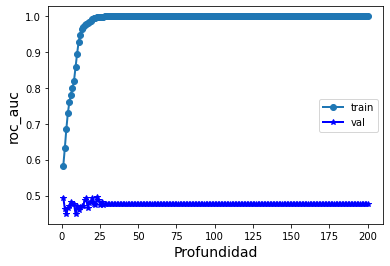

Mejor valor de la figura de mérito en validación cruzada: 0.495
Mejor valor del hiperparámetro: {'max_depth': 23}


In [ ]:
arbol('roc_auc')

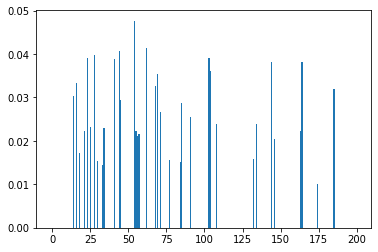

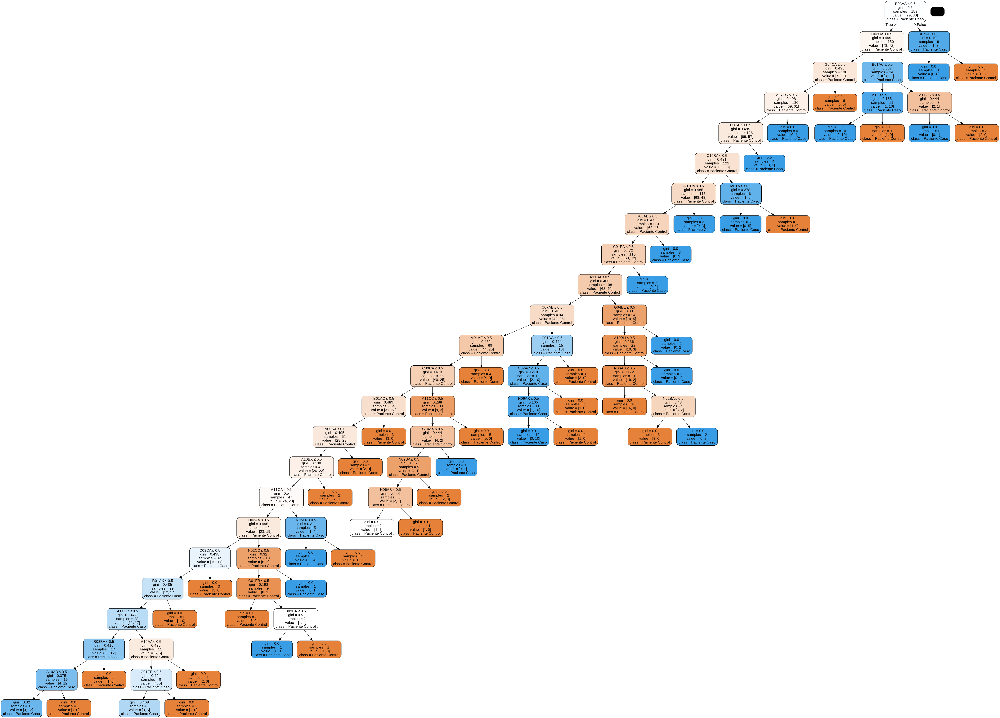

In [ ]:
# 4. Se representa la importancia de cada característica para el árbol diseñado
from matplotlib import pyplot
Arbol_clasif_all = DecisionTreeClassifier(max_depth=23)
modelo_arbol_clasif = Arbol_clasif_all.fit(X_train, Y_train)
y_output_arbol = modelo_arbol_clasif.predict(X_test)
importance_arbol = modelo_arbol_clasif.feature_importances_
pyplot.bar([x for x in range(len(importance_arbol))], importance_arbol)
pyplot.show()

# 5. Se representa gráficamente el modelo de clasificación
from sklearn.tree import export_graphviz
#from sklearn.externals.six import StringIO  
from six import StringIO
from IPython.display import Image  
import pydotplus

dot_data = StringIO()

export_graphviz(modelo_arbol_clasif, out_file=dot_data,  
                filled=True, rounded=True,
                special_characters=True,feature_names = data_final.columns[1:],class_names=['Paciente Control','Paciente Caso'])

graph = pydotplus.graph_from_dot_data(dot_data.getvalue())  
graph.write_png('Tree_Clasif_all.png')
Image(graph.create_png())

In [ ]:
A1_score = accuracy_score(Y_test, y_output_arbol)
f11_score = f1_score(Y_test, y_output_arbol)
r1_score = recall_score(Y_test, y_output_arbol)

print("El valor de accuracy obtenido:", A1_score)
print("La matriz de confusión obtenida:", confusion_matrix(Y_test, y_output_arbol))
print("El valor de f1_score obtenido:", f11_score)
print("El valor de recall es", r1_score)

El valor de accuracy obtenido: 0.5
La matriz de confusión obtenida: [[11  9]
 [11  9]]
El valor de f1_score obtenido: 0.4736842105263158
El valor de recall es 0.45


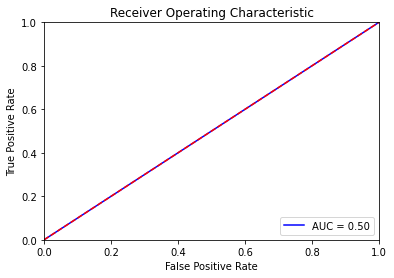

In [ ]:
fpr, tpr, threshold = metrics.roc_curve(Y_test, y_output_arbol)
roc_auc_1 = metrics.auc(fpr, tpr)
# AUC_results.append(roc_auc_1)

# Plot the ROC curve
import matplotlib.pyplot as plt
plt.title('Receiver Operating Characteristic')
plt.plot(fpr, tpr, 'b', label = 'AUC = %0.2f' % roc_auc_1)
plt.legend(loc = 'lower right')
plt.plot([0, 1], [0, 1],'r--')
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.show()

In [ ]:
res_accuracy.append(A1_score)
res_recall.append(r1_score)
res_f1.append(f11_score)
res_roc.append(roc_auc_1)

# ***SVC***

In [ ]:
from sklearn.svm import SVC


In [ ]:
# Regresión logística con regularización 
from sklearn.linear_model import LogisticRegression
from sklearn import model_selection   
from sklearn import metrics
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split, GridSearchCV

svc=SVC(decision_function_shape='ovo')

# logreg= LogisticRegression(solver='liblinear')
parameters = {'kernel': ['rbf','poly'], 'gamma': [1e-2, 1e-3, 1e-4, 1e-5],
                     'C': [0.001, 0.10, 0.1, 10, 25, 50, 100, 1000]}# l1 lasso l2 ridge
# valor_C=np.array([1e-8,1e-4,1,10,100])
svc=GridSearchCV(svc, parameters, scoring='roc_auc', cv=5, return_train_score=True)

svc.fit(X_train, Y_train) #Entrenamos

# #Evaluamos las prestaciones para el conjunto de entrenamiento, de validación y representamos
roc_log_train = np.array(svc.cv_results_['mean_train_score']) 
roc_loc_val = np.array(svc.cv_results_['mean_test_score'])

# #Pintamos la evolución de nuestro modelo tanto en train como en validación para ver cuál es el mejor hiperparámetro para generalizar
# plt.plot(valor_C,roc_log_train,'-o',label="train", linewidth=2)
# plt.plot(valor_C,roc_loc_val,'-*b',label="val", linewidth=2)
# plt.xlabel('C',fontsize=14)
# plt.ylabel('Roc_auc',fontsize=14)
# plt.legend()
# plt.show()

# Mostramos el mejor valor del parámetro y el score
print("Valor correspondiente para el hiperparámetro: {}".format(svc.best_params_))
print("Mayor valor de la figura de mérito en validación con características estandarizadas: {:.3f}".format(svc.best_score_))


Valor correspondiente para el hiperparámetro: {'C': 1000, 'gamma': 0.0001, 'kernel': 'rbf'}
Mayor valor de la figura de mérito en validación con características estandarizadas: 0.588


In [ ]:


svc=SVC(C=1000,kernel='rbf',gamma=0.0001,decision_function_shape='ovo')
svc.fit(X_train,Y_train)
y_test_pred=svc.predict(X_test)

In [ ]:
A1_score = accuracy_score(Y_test, y_test_pred)
f11_score = f1_score(Y_test, y_test_pred)
r1_score = recall_score(Y_test, y_test_pred)

print("El valor de accuracy obtenido:", A1_score)
print("La matriz de confusión obtenida:", confusion_matrix(Y_test, y_test_pred))
print("El valor de f1_score obtenido:", f11_score)
print("El valor de recall es", r1_score)

El valor de accuracy obtenido: 0.425
La matriz de confusión obtenida: [[11  9]
 [14  6]]
El valor de f1_score obtenido: 0.34285714285714286
El valor de recall es 0.3


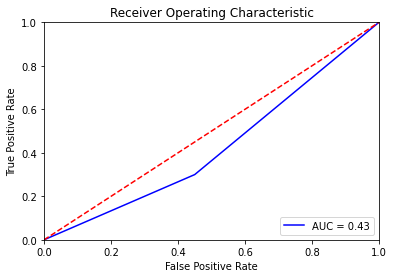

In [ ]:
fpr, tpr, threshold = metrics.roc_curve(Y_test, y_test_pred)
roc_auc_1 = metrics.auc(fpr, tpr)
# AUC_results.append(roc_auc_1)

# Plot the ROC curve
import matplotlib.pyplot as plt
plt.title('Receiver Operating Characteristic')
plt.plot(fpr, tpr, 'b', label = 'AUC = %0.2f' % roc_auc_1)
plt.legend(loc = 'lower right')
plt.plot([0, 1], [0, 1],'r--')
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.show()

In [ ]:
res_accuracy.append(A1_score)
res_recall.append(r1_score)
res_f1.append(f11_score)
res_roc.append(roc_auc_1)

In [ ]:
results = pd.DataFrame()

results["Accuracy"]=res_accuracy
results["Recall"]=res_recall
results["F1-score"]=res_f1
results["Auc"]=res_roc

#results
results["Modelos"] = ["Regresión logística", "Knn","Árbol","SVC"]
results.set_index("Modelos", inplace = True)

In [ ]:
results

,Accuracy,Recall,F1-score,Auc
Modelos,,,,
Regresión logística,0.625,0.80,0.680851,0.625
Knn,0.450,0.60,0.521739,0.450
Árbol,0.500,0.45,0.473684,0.500
SVC,0.425,0.30,0.342857,0.425


# ***Selección de características***

# ***Métodos *embedded****

Ranking de Características:
1. Característica 80 (0.032880)
2. Característica 68 (0.029694)
3. Característica 62 (0.026639)
4. Característica 25 (0.023658)
5. Característica 28 (0.023236)
6. Característica 44 (0.023146)
7. Característica 108 (0.022838)
8. Característica 74 (0.021191)
9. Característica 144 (0.020411)
10. Característica 18 (0.019198)
11. Característica 163 (0.018953)
12. Característica 104 (0.018868)
13. Característica 60 (0.018263)
14. Característica 84 (0.017640)
15. Característica 3 (0.016984)
16. Característica 77 (0.016829)
17. Característica 85 (0.015715)
18. Característica 16 (0.015471)
19. Característica 71 (0.014083)
20. Característica 164 (0.013647)
21. Característica 33 (0.013592)
22. Característica 103 (0.013511)
23. Característica 150 (0.013236)
24. Característica 41 (0.013236)
25. Característica 31 (0.012176)
26. Característica 23 (0.011886)
27. Característica 14 (0.011802)
28. Característica 54 (0.011250)
29. Característica 55 (0.011091)
30. Característica

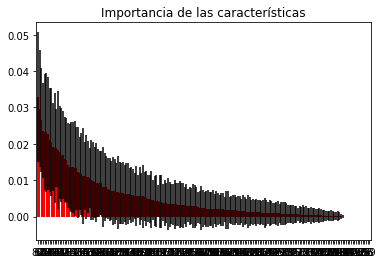

In [ ]:
from sklearn.ensemble import ExtraTreesClassifier

# Creamos un bosque aleatorio de árboles de clasificación
forest = ExtraTreesClassifier(n_estimators=250,
                              random_state=0)

# Como en árboles, no es necesario que las características estén normalizadas
# Trabajamos, por tanto, con X_train y X_test (no con las versiones estandarizadas)

forest.fit(X_train, Y_train)
importances = forest.feature_importances_
std = np.std([tree.feature_importances_ for tree in forest.estimators_],
             axis=0)
indices = np.argsort(importances)[::-1]

# Muestra el ranking en el ordenamiento
print("Ranking de Características:")

for f in range(X_train.shape[1]):
  print("%d. Característica %d (%f)" % (f + 1, indices[f], importances[indices[f]]))

# Plot the impurity-based feature importances of the forest
plt.figure()
plt.title("Importancia de las características")
plt.bar(range(X_train.shape[1]), importances[indices],
        color="r", yerr=std[indices], align="center")
plt.xticks(range(X_train.shape[1]), indices)
plt.xlim([-1, X_train.shape[1]])
plt.show()

In [ ]:
X_train =X_train.to_numpy()
X_test= X_test.to_numpy()

In [ ]:
# from sklearn.model_selection import train_test_split, cross_val_score

X_train_emb = X_train[:,[80,68,62,25,28,44,108,74,144,18]]
X_test_emb = X_test[:,[80,68,62,25,28,44,108,74,144,18]]


# ***Regresión logística con regularización***

In [ ]:
# Regresión logística con regularización 
from sklearn.linear_model import LogisticRegression
from sklearn import model_selection   
from sklearn import metrics
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split, GridSearchCV

logreg= LogisticRegression(solver='liblinear')
parameters = {"C":[1e-8,1e-4,10,100],"penalty":["l1","l2"]}# l1 lasso l2 ridge
valor_C=np.array([1e-8,1e-4,10,100])
log_regression=GridSearchCV(logreg, parameters, scoring='roc_auc', cv=5, return_train_score=True)

log_regression.fit(X_train_emb, Y_train) #Entrenamos

# #Evaluamos las prestaciones para el conjunto de entrenamiento, de validación y representamos
roc_log_train = np.array(log_regression.cv_results_['mean_train_score']) 
roc_loc_val = np.array(log_regression.cv_results_['mean_test_score'])

# #Pintamos la evolución de nuestro modelo tanto en train como en validación para ver cuál es el mejor hiperparámetro para generalizar
# plt.plot(valor_C,roc_log_train,'-o',label="train", linewidth=2)
# plt.plot(valor_C,roc_loc_val,'-*b',label="val", linewidth=2)
# plt.xlabel('C',fontsize=14)
# plt.ylabel('Roc_auc',fontsize=14)
# plt.legend()
# plt.show()

# Mostramos el mejor valor del parámetro y el score
print("Valor correspondiente para el hiperparámetro: {}".format(log_regression.best_params_))
print("Mayor valor de la figura de mérito en validación con características estandarizadas: {:.3f}".format(log_regression.best_score_))


Valor correspondiente para el hiperparámetro: {'C': 10, 'penalty': 'l1'}
Mayor valor de la figura de mérito en validación con características estandarizadas: 0.619


In [ ]:
from sklearn.linear_model import Lasso

logridge=LogisticRegression(solver='liblinear', penalty='l1', C=10)
modelo_rid_log=logridge.fit(X_train_emb, Y_train)

# Obtenemos la salida predicha
y_pred_ridlog = modelo_rid_log.predict(X_test_emb)

In [ ]:
from sklearn.metrics import confusion_matrix
from sklearn.metrics import accuracy_score
from sklearn.metrics import classification_report
from sklearn.metrics import recall_score

#  Calculamos la matriz de confusión
cm = confusion_matrix(Y_test, y_pred_ridlog)
print(cm)

tn, fp, fn, tp = confusion_matrix(Y_test, y_pred_ridlog).ravel()
print(f'tn: {tn}, fp:{fp}, fn:{fn}, tp:{tp}')

# Calcumos accuracy_score
Accuracy=accuracy_score(Y_test, y_pred_ridlog)
print(f'Accuracy: {Accuracy}')

target_names = ['Paciente control', 'Paciente caso']
print(classification_report(Y_test, y_pred_ridlog, target_names=target_names))
              
#Sensibilidad
Sensibilidad_3 = recall_score(Y_test, y_pred_ridlog)
# S_results.append(Sensibilidad_3)
print(f'Sensibilidad: {Sensibilidad_3}')

[[11  9]
 [13  7]]
tn: 11, fp:9, fn:13, tp:7
Accuracy: 0.45
                  precision    recall  f1-score   support

Paciente control       0.46      0.55      0.50        20
   Paciente caso       0.44      0.35      0.39        20

        accuracy                           0.45        40
       macro avg       0.45      0.45      0.44        40
    weighted avg       0.45      0.45      0.44        40

Sensibilidad: 0.35


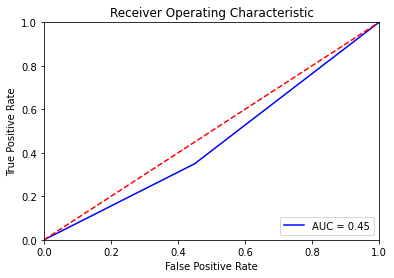

In [ ]:
fpr, tpr, threshold = metrics.roc_curve(Y_test, y_pred_ridlog)
roc_auc_1 = metrics.auc(fpr, tpr)
# AUC_results.append(roc_auc_1)

# Plot the ROC curve
import matplotlib.pyplot as plt
plt.title('Receiver Operating Characteristic')
plt.plot(fpr, tpr, 'b', label = 'AUC = %0.2f' % roc_auc_1)
plt.legend(loc = 'lower right')
plt.plot([0, 1], [0, 1],'r--')
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.show()

In [ ]:
res_accuracy=[]
res_recall=[]
res_f1=[]
res_roc=[]

In [ ]:

A1_score = accuracy_score(Y_test, y_pred_ridlog)
f11_score = f1_score(Y_test, y_pred_ridlog)
r1_score = recall_score(Y_test, y_pred_ridlog)
fpr, tpr, threshold = metrics.roc_curve(Y_test, y_pred_ridlog)
roc_auc_1 = metrics.auc(fpr, tpr)
print("El valor de accuracy obtenido:", A1_score)
print("La matriz de confusión obtenida:", confusion_matrix(Y_test, y_pred_ridlog))
print("El valor de f1_score obtenido:", f11_score)
print("El valor de recall es", r1_score)

El valor de accuracy obtenido: 0.45
La matriz de confusión obtenida: [[11  9]
 [13  7]]
El valor de f1_score obtenido: 0.38888888888888884
El valor de recall es 0.35


In [ ]:
res_accuracy.append(A1_score)
res_recall.append(r1_score)
res_f1.append(f11_score)
res_roc.append(roc_auc_1)

# **Knn por votación**

In [ ]:

from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.neighbors import KNeighborsRegressor
from sklearn.metrics import mean_absolute_error, mean_squared_error
from sklearn import model_selection
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix
from sklearn.metrics import accuracy_score
from sklearn.metrics import f1_score
from sklearn.metrics import recall_score
from sklearn.neighbors import KNeighborsClassifier
from sklearn import preprocessing
#from mlxtend.plotting import plot_learning_curves

In [ ]:
def knn (figura):
  # 5. Selección del hiper-parámetro haciendo uso del conjunto de diseño con características estandarizadas. 

  param_grid = {'n_neighbors': range(1,81,2)}
  k_grid = np.array(range(1,81,2))
  grid_knn = GridSearchCV(KNeighborsClassifier(), param_grid = param_grid, scoring = figura, cv=3, return_train_score=True)
  grid_knn.fit(X_train_emb, Y_train) 

  #Evaluamos las prestaciones para el conjunto de entrenamiento, de validación y representamos
  
  auc_knn_all_train = np.array(grid_knn.cv_results_['mean_train_score'])
  auc_knn_all_val = np.array(grid_knn.cv_results_['mean_test_score'])


  plt.plot(k_grid,auc_knn_all_train,'-o',label="train", linewidth=2)
  plt.plot(k_grid,auc_knn_all_val,'-*b',label="val", linewidth=2)
  plt.xlabel('k',fontsize=14)
  plt.ylabel(figura,fontsize=14)
  plt.legend()
  plt.show()

  print("Mayor valor de la figura de mérito en validación con características estandarizadas: {:.3f}".format(grid_knn.best_score_))
  print("Valor correspondiente para el hiperparámetro: {}".format(grid_knn.best_params_))

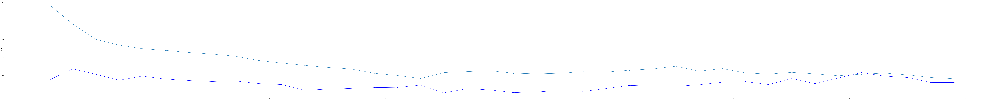

Mayor valor de la figura de mérito en validación con características estandarizadas: 0.638
Valor correspondiente para el hiperparámetro: {'n_neighbors': 3}


In [ ]:
knn('roc_auc')

In [ ]:
kNN_clasif_all = KNeighborsClassifier(n_neighbors = 3)
modelo_knn_clasif2 = kNN_clasif_all.fit(X_train_emb, Y_train) 
y_output_knn2 = modelo_knn_clasif2.predict(X_test_emb)
A1_score = accuracy_score(Y_test, y_output_knn2)
f11_score = f1_score(Y_test, y_output_knn2)
r1_score = recall_score(Y_test, y_output_knn2)

print("El valor de accuracy obtenido:", A1_score)
print("La matriz de confusión obtenida:", confusion_matrix(Y_test, y_output_knn2))
print("El valor de f1_score obtenido:", f11_score)
print("El valor de recall es", r1_score)

El valor de accuracy obtenido: 0.6
La matriz de confusión obtenida: [[13  7]
 [ 9 11]]
El valor de f1_score obtenido: 0.5789473684210527
El valor de recall es 0.55


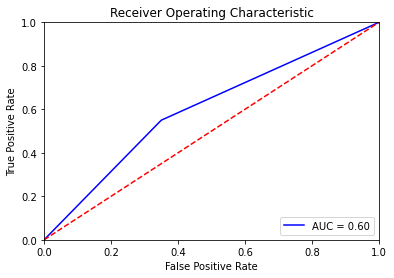

In [ ]:
fpr, tpr, threshold = metrics.roc_curve(Y_test, y_output_knn2)
roc_auc_1 = metrics.auc(fpr, tpr)
# AUC_results.append(roc_auc_1)

# Plot the ROC curve
import matplotlib.pyplot as plt
plt.title('Receiver Operating Characteristic')
plt.plot(fpr, tpr, 'b', label = 'AUC = %0.2f' % roc_auc_1)
plt.legend(loc = 'lower right')
plt.plot([0, 1], [0, 1],'r--')
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.show()

In [ ]:

A1_score = accuracy_score(Y_test, y_output_knn2)
f11_score = f1_score(Y_test, y_output_knn2)
r1_score = recall_score(Y_test, y_output_knn2)
fpr, tpr, threshold = metrics.roc_curve(Y_test, y_output_knn2)
roc_auc_1 = metrics.auc(fpr, tpr)
print("El valor de accuracy obtenido:", A1_score)
print("La matriz de confusión obtenida:", confusion_matrix(Y_test, y_output_knn2))
print("El valor de f1_score obtenido:", f11_score)
print("El valor de recall es", r1_score)

El valor de accuracy obtenido: 0.6
La matriz de confusión obtenida: [[13  7]
 [ 9 11]]
El valor de f1_score obtenido: 0.5789473684210527
El valor de recall es 0.55


In [ ]:
res_accuracy.append(A1_score)
res_recall.append(r1_score)
res_f1.append(f11_score)
res_roc.append(roc_auc_1)

# ***ÁRBOLES***

In [ ]:
from sklearn.tree import DecisionTreeClassifier

def arbol(figura):
  # 1. Selección de hiper-parámetros del árbol. En principio, consideraremos sólo la profundidad máxima
  param_grid = {'max_depth': range(1,11)}
  profundidad_grid = np.array(range(1,11))


  grid_arbol_clasif = GridSearchCV(DecisionTreeClassifier(random_state=0), param_grid = param_grid, scoring = figura, cv=3, return_train_score=True)
  modelo_arbol_clasif = grid_arbol_clasif.fit(X_train_emb, Y_train)
  print(grid_arbol_clasif.best_params_)

  perf_train_arbol = np.array(grid_arbol_clasif.cv_results_['mean_train_score'])
  perf_val_arbol = np.array(grid_arbol_clasif.cv_results_['mean_test_score'])

  plt.plot(profundidad_grid,perf_train_arbol,'-o',label="train", linewidth=2)
  plt.plot(profundidad_grid,perf_val_arbol,'-*b',label="val", linewidth=2)
  plt.xlabel('Profundidad',fontsize=14)
  plt.ylabel(figura,fontsize=14)
  plt.legend()
  plt.show()

  print("Mejor valor de la figura de mérito en validación cruzada: {:.3f}".format(grid_arbol_clasif.best_score_))
  print("Mejor valor del hiperparámetro: {}".format(grid_arbol_clasif.best_params_))


{'max_depth': 10}


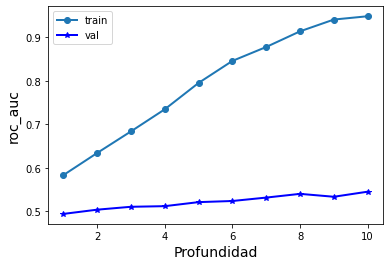

Mejor valor de la figura de mérito en validación cruzada: 0.545
Mejor valor del hiperparámetro: {'max_depth': 10}


In [ ]:
arbol('roc_auc')

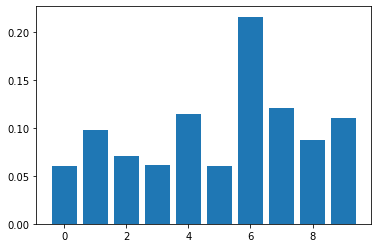

AttributeError: ignored

In [ ]:
# 4. Se representa la importancia de cada característica para el árbol diseñado
from matplotlib import pyplot
Arbol_clasif_all = DecisionTreeClassifier(max_depth=10)
modelo_arbol_clasif = Arbol_clasif_all.fit(X_train_emb, Y_train)
y_output_arbol = modelo_arbol_clasif.predict(X_test_emb)
importance_arbol = modelo_arbol_clasif.feature_importances_
pyplot.bar([x for x in range(len(importance_arbol))], importance_arbol)
pyplot.show()

# 5. Se representa gráficamente el modelo de clasificación
from sklearn.tree import export_graphviz
#from sklearn.externals.six import StringIO  
from six import StringIO
from IPython.display import Image  
import pydotplus

dot_data = StringIO()

export_graphviz(modelo_arbol_clasif, out_file=dot_data,  
                filled=True, rounded=True,
                special_characters=True,feature_names = X_train_emb.columns[0:],class_names=['Paciente Control','Paciente Caso'])

graph = pydotplus.graph_from_dot_data(dot_data.getvalue())  
graph.write_png('Tree_Clasif_all.png')
Image(graph.create_png())

In [ ]:
print("El valor de precisión obtenido:", accuracy_score(Y_test, y_output_arbol))
print("La matriz de confusión obtenida:", confusion_matrix(Y_test, y_output_arbol))
print("El valor de f1_score obtenido:", f1_score(Y_test, y_output_arbol))
print("El valor de sensibilidad es", recall_score(Y_test, y_output_arbol))

El valor de precisión obtenido: 0.675
La matriz de confusión obtenida: [[15  5]
 [ 8 12]]
El valor de f1_score obtenido: 0.6486486486486486
El valor de sensibilidad es 0.6


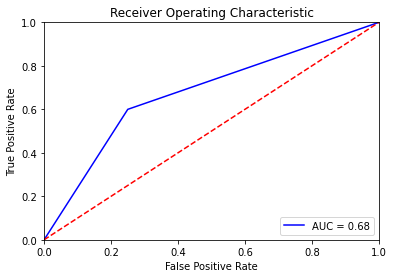

In [ ]:
fpr, tpr, threshold = metrics.roc_curve(Y_test, y_output_arbol)
roc_auc_1 = metrics.auc(fpr, tpr)
# AUC_results.append(roc_auc_1)

# Plot the ROC curve
import matplotlib.pyplot as plt
plt.title('Receiver Operating Characteristic')
plt.plot(fpr, tpr, 'b', label = 'AUC = %0.2f' % roc_auc_1)
plt.legend(loc = 'lower right')
plt.plot([0, 1], [0, 1],'r--')
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.show()

In [ ]:
A1_score = accuracy_score(Y_test, y_output_arbol)
f11_score = f1_score(Y_test, y_output_arbol)
r1_score = recall_score(Y_test, y_output_arbol)

print("El valor de accuracy obtenido:", A1_score)
print("La matriz de confusión obtenida:", confusion_matrix(Y_test, y_output_arbol))
print("El valor de f1_score obtenido:", f11_score)
print("El valor de recall es", r1_score)

El valor de accuracy obtenido: 0.675
La matriz de confusión obtenida: [[15  5]
 [ 8 12]]
El valor de f1_score obtenido: 0.6486486486486486
El valor de recall es 0.6


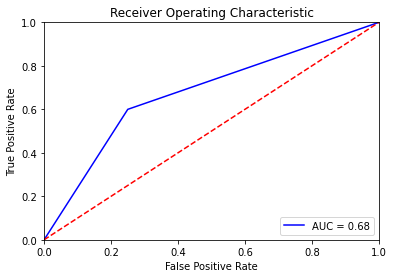

In [ ]:
fpr, tpr, threshold = metrics.roc_curve(Y_test, y_output_arbol)
roc_auc_1 = metrics.auc(fpr, tpr)
# AUC_results.append(roc_auc_1)

# Plot the ROC curve
import matplotlib.pyplot as plt
plt.title('Receiver Operating Characteristic')
plt.plot(fpr, tpr, 'b', label = 'AUC = %0.2f' % roc_auc_1)
plt.legend(loc = 'lower right')
plt.plot([0, 1], [0, 1],'r--')
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.show()

In [ ]:
res_accuracy.append(A1_score)
res_recall.append(r1_score)
res_f1.append(f11_score)
res_roc.append(roc_auc_1)

# ***SVC***

In [ ]:
# Regresión logística con regularización 
from sklearn.linear_model import LogisticRegression
from sklearn import model_selection   
from sklearn import metrics
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split, GridSearchCV

svc=SVC(decision_function_shape='ovo')

# logreg= LogisticRegression(solver='liblinear')
parameters = {'kernel': ['rbf','poly'], 'gamma': [1e-2, 1e-3, 1e-4, 1e-5],
                     'C': [0.001, 0.10, 0.1, 10, 25, 50, 100, 1000]}# l1 lasso l2 ridge
# valor_C=np.array([1e-8,1e-4,1,10,100])
svc=GridSearchCV(svc, parameters, scoring='roc_auc', cv=5, return_train_score=True)

svc.fit(X_train_emb, Y_train) #Entrenamos

# #Evaluamos las prestaciones para el conjunto de entrenamiento, de validación y representamos
roc_log_train = np.array(svc.cv_results_['mean_train_score']) 
roc_loc_val = np.array(svc.cv_results_['mean_test_score'])

# #Pintamos la evolución de nuestro modelo tanto en train como en validación para ver cuál es el mejor hiperparámetro para generalizar
# plt.plot(valor_C,roc_log_train,'-o',label="train", linewidth=2)
# plt.plot(valor_C,roc_loc_val,'-*b',label="val", linewidth=2)
# plt.xlabel('C',fontsize=14)
# plt.ylabel('Roc_auc',fontsize=14)
# plt.legend()
# plt.show()

# Mostramos el mejor valor del parámetro y el score
print("Valor correspondiente para el hiperparámetro: {}".format(svc.best_params_))
print("Mayor valor de la figura de mérito en validación con características estandarizadas: {:.3f}".format(svc.best_score_))


Valor correspondiente para el hiperparámetro: {'C': 1000, 'gamma': 0.001, 'kernel': 'rbf'}
Mayor valor de la figura de mérito en validación con características estandarizadas: 0.572


In [ ]:


svc=SVC(C=1000,kernel='rbf',gamma=0.001,decision_function_shape='ovo')
svc.fit(X_train_emb,Y_train)
y_test_pred=svc.predict(X_test_emb)

In [ ]:
A1_score = accuracy_score(Y_test, y_test_pred)
f11_score = f1_score(Y_test, y_test_pred)
r1_score = recall_score(Y_test, y_test_pred)

print("El valor de accuracy obtenido:", A1_score)
print("La matriz de confusión obtenida:", confusion_matrix(Y_test, y_test_pred))
print("El valor de f1_score obtenido:", f11_score)
print("El valor de recall es", r1_score)

El valor de accuracy obtenido: 0.475
La matriz de confusión obtenida: [[12  8]
 [13  7]]
El valor de f1_score obtenido: 0.4
El valor de recall es 0.35


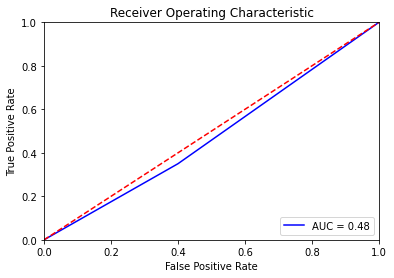

In [ ]:
fpr, tpr, threshold = metrics.roc_curve(Y_test, y_test_pred)
roc_auc_1 = metrics.auc(fpr, tpr)
# AUC_results.append(roc_auc_1)

# Plot the ROC curve
import matplotlib.pyplot as plt
plt.title('Receiver Operating Characteristic')
plt.plot(fpr, tpr, 'b', label = 'AUC = %0.2f' % roc_auc_1)
plt.legend(loc = 'lower right')
plt.plot([0, 1], [0, 1],'r--')
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.show()

In [ ]:
res_accuracy.append(A1_score)
res_recall.append(r1_score)
res_f1.append(f11_score)
res_roc.append(roc_auc_1)

# ***Método filter***

A continuación, a partir de validación cruzada con 3 folds, obtenemos el fold1, fold2 y fold3:

In [ ]:
# Convertimos el objeto dataframe en un array (mayor velocidad de cómputo)
# array = data.values
X_train=np.array(X_train)
X_text=np.array(X_test)
Y_train=(np.array(Y_train))
Y_test=np.array(Y_test)
# Separamos en variables de entrada al modelo (8 primeras) y de salida (1 variable) 
# X = array[:,1:59]
# Y = array[:,0]

names=[]
for i in range(200):
  names.append(str(i))
# names = ['f0', 'f1', 'f2', 'f3', 'f4', 'f5', 'f6', 'f7', 'f8', 'f9', 'f10', 'f11','f12','f13','f13','f13','f13','f13','f13','f13','f13','f13','f13','f13','f13','f13','f13','f13','f13','f13']
# names = data.columns[1:]
names

['0',
 '1',
 '2',
 '3',
 '4',
 '5',
 '6',
 '7',
 '8',
 '9',
 '10',
 '11',
 '12',
 '13',
 '14',
 '15',
 '16',
 '17',
 '18',
 '19',
 '20',
 '21',
 '22',
 '23',
 '24',
 '25',
 '26',
 '27',
 '28',
 '29',
 '30',
 '31',
 '32',
 '33',
 '34',
 '35',
 '36',
 '37',
 '38',
 '39',
 '40',
 '41',
 '42',
 '43',
 '44',
 '45',
 '46',
 '47',
 '48',
 '49',
 '50',
 '51',
 '52',
 '53',
 '54',
 '55',
 '56',
 '57',
 '58',
 '59',
 '60',
 '61',
 '62',
 '63',
 '64',
 '65',
 '66',
 '67',
 '68',
 '69',
 '70',
 '71',
 '72',
 '73',
 '74',
 '75',
 '76',
 '77',
 '78',
 '79',
 '80',
 '81',
 '82',
 '83',
 '84',
 '85',
 '86',
 '87',
 '88',
 '89',
 '90',
 '91',
 '92',
 '93',
 '94',
 '95',
 '96',
 '97',
 '98',
 '99',
 '100',
 '101',
 '102',
 '103',
 '104',
 '105',
 '106',
 '107',
 '108',
 '109',
 '110',
 '111',
 '112',
 '113',
 '114',
 '115',
 '116',
 '117',
 '118',
 '119',
 '120',
 '121',
 '122',
 '123',
 '124',
 '125',
 '126',
 '127',
 '128',
 '129',
 '130',
 '131',
 '132',
 '133',
 '134',
 '135',
 '136',
 '137',
 '138'

In [ ]:
from sklearn.model_selection import KFold
kf = KFold(n_splits=3)  # In this case, k=3, 

for train, val in kf.split(X_train):
  # print("%s %s" % (train, val))
  # print(len(val))
  # print(val)
  if (len(val)==53) and (val[0]==106):
    fold3=list(val)
    print(len(fold3))
    print(fold3)
  if (len(val)==53) and (val[0]==0):
    fold1=list(val)
    print(len(fold1))
    print(fold1)
  if (len(val)==53) and (val[0]==53):
    fold2=list(val)
    print(len(fold2))
    print(fold2)

53
[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52]
53
[53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105]
53
[106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158]


# ***COMBINACIÓN PRIMERA***


En esta primera combinación utilizaremos fold1 y fold2 para entrenar, y fold3 para validar:

In [ ]:
X_entrenamiento=np.concatenate((X_train[fold1], X_train[fold2]))
Y_entrenamiento=np.concatenate((Y_train[fold1], Y_train[fold2]))
X_val=X_train[fold3]
Y_val=Y_train[fold3]

Text(0.5, 1.0, 'Chi2 considerando subconjunto X train')

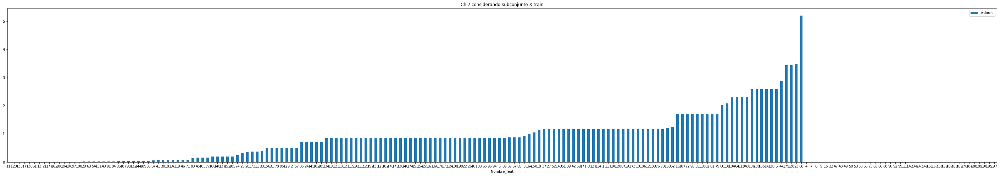

In [ ]:
from sklearn.feature_selection import SelectKBest, chi2, mutual_info_classif

bestfeatures_Chi2 = SelectKBest(score_func=chi2, k=200)
fit_Chi2 = bestfeatures_Chi2.fit(X_entrenamiento, Y_entrenamiento)

# gráfico de barras utilizando matplotlib
df = pd.DataFrame({'Nombre_feat':names, 'valores':fit_Chi2.scores_}).sort_values(by='valores')
ax = df.plot.bar(x='Nombre_feat', y='valores', rot=0, figsize=(50,8))
# df, ax = plt.subplots(figsize=(50, 8))
plt.title("Chi2 considerando subconjunto X train")

In [ ]:
X_val=X_val[:, [11,14,24,54,62,68,104,114,134,150,164]] 
print(len(X_val), len(Y_val))

53 53


In [ ]:
X_entrenamiento=X_entrenamiento[:, [11,14,24,54,62,68,104,114,134,150,164]]

Ahora con esas características elegidas, entrenaremos nuestro modelo knn y además también haremos validación para así obtener el mejor valor de k a partir de una figura de mérico que en este caso será el accuracy:

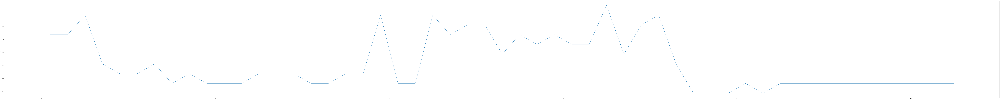

0.49056603773584906


In [ ]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix
from sklearn.metrics import accuracy_score
k_range = range(1, 107, 2)
scores = []
for k in k_range:
    knn = KNeighborsClassifier(n_neighbors = k)
    knn.fit(X_entrenamiento, Y_entrenamiento)
    scores.append(knn.score(X_val, Y_val))
plt.plot(k_range, scores)
plt.xlabel('k')
plt.ylabel('Accuraccy en validación cruzada (3 fold) - FS con chi2')
plt.show()
print(knn.score(X_val, Y_val))

El valor de k será 11, ya que es dónde mayor accuracy obtenemos, y además se empieza a estabilizar

# ***COMBINACIÓN 2***

En esta combinación usaremos fold1 y fold3 para entrenar y usaremos fold 2 para validar:

In [ ]:
X_entrenamiento2=np.concatenate((X_train[fold1], X_train[fold3]))
Y_entrenamiento2=np.concatenate((Y_train[fold1], Y_train[fold3]))
X_val2=X_train[fold2]
Y_val2=Y_train[fold2]

In [ ]:
bestfeatures_Chi2_2 = SelectKBest(score_func=chi2, k=200)
fit_Chi2_2 = bestfeatures_Chi2_2.fit(X_entrenamiento2, Y_entrenamiento2)

# gráfico de barras utilizando matplotlib
df = pd.DataFrame({'Nombre_feat':names, 'valores':fit_Chi2_2.scores_})
ax = df.plot.bar(x='Nombre_feat', y='valores', rot=0,figsize=(50,8))
plt.title("Estadístico chi cuadrado considerando subconjunto X train")

ValueError: ignored

Escogemos de nuestra X de validación y de nuestra X de train únicamente las características:

In [ ]:
X_val2=X_val2[:, [35,44,62,85,98,164,179,187]] 
X_entrenamiento2=X_entrenamiento2[:, [35,44,62,85,98,164,179,187]]

Ahora igual que antes, entrenamos nuestro modelo knn y elegimos el valor de k a partir de validación:

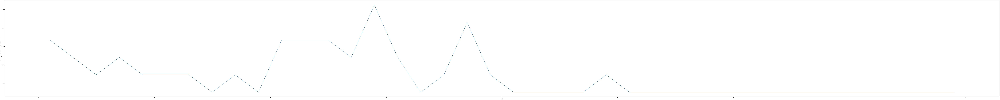

0.49056603773584906


In [ ]:
k_range = range(1, 81, 2)
scores2 = []
for k in k_range:
    knn = KNeighborsClassifier(n_neighbors = k)
    
    knn.fit(X_entrenamiento2, Y_entrenamiento2)
    scores2.append(knn.score(X_val2, Y_val2))
plt.plot(k_range, scores2)
plt.xlabel('k')
plt.ylabel('Accuraccy en validación cruzada (3 fold) - FS con chi2')
plt.show()
print(knn.score(X_val2, Y_val2))

Vemos que el mayor valor de accuracy es de 0.675 y elegiríamos un valor de k de aproximadamente 27

# ***COMBINACIÓN 3***

En este último caso, utilizaremos el fold 2 y fold3 para entrenar y el fold 1 para validar:

In [ ]:
X_entrenamiento3=np.concatenate((X_train[fold2], X_train[fold3]))
Y_entrenamiento3=np.concatenate((Y_train[fold2], Y_train[fold3]))
X_val3=X_train[fold1]
Y_val3=Y_train[fold1]

Text(0.5, 1.0, 'Estadístico chi cuadrado considerando subconjunto X train')

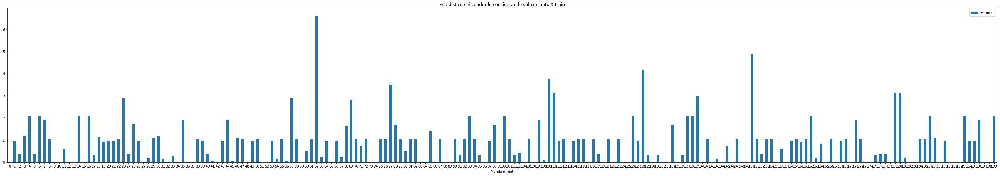

In [ ]:
bestfeatures_Chi2_3 = SelectKBest(score_func=chi2, k=200)
fit_Chi2_3 = bestfeatures_Chi2_3.fit(X_entrenamiento3, Y_entrenamiento3)

# gráfico de barras utilizando matplotlib
df = pd.DataFrame({'Nombre_feat':names, 'valores':fit_Chi2_3.scores_})
ax = df.plot.bar(x='Nombre_feat', y='valores', rot=0, figsize=(50,8))
plt.title("Estadístico chi cuadrado considerando subconjunto X train")

En esta ocasión, elegiremos como mejores características, de nuevo f6, pero en este caso, en vez de f11 elegiremos f2.

A continuación, elegimos esas dos características en nuestros conjuntos de X de entrenamiento y la X de validación:

In [ ]:
X_val3=X_val3[:, [2]] 
X_entrenamiento3=X_entrenamiento3[:, [2]]

Ahora construimos nuestro modelo knn y lo entrenamos y elegiremos el valor de k a partir de validación cruzada:

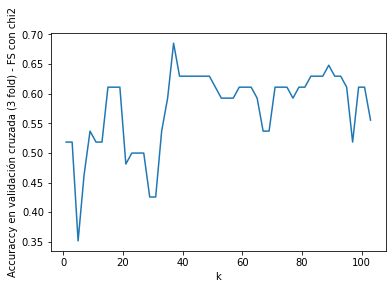

0.5555555555555556


In [ ]:
k_range = range(1, 105, 2)
scores3 = []
for k in k_range:
    knn = KNeighborsClassifier(n_neighbors = k)
    knn.fit(X_entrenamiento3, Y_entrenamiento3)
    scores3.append(knn.score(X_val3, Y_val3))
plt.plot(k_range, scores3)
plt.xlabel('k')
plt.ylabel('Accuraccy en validación cruzada (3 fold) - FS con chi2')
plt.show()
print(knn.score(X_val3, Y_val3))

Obtenemos un valor de accuracy en 0.65 en validación eligiendo un valor de k de aproximadamente 40.

Una vez hechas todas las combinaciones posibles, vemos que la característica f6 aparece en las 3 combinaciones, por lo que suponemos que será una característica relevante, y otra de las que aparece dos de las 3 veces es f11, por lo que también la elegiremos como caracterísitca relevante.

Una vez hecho esto, nuestra base de datos ya solo la utilizaremos con esas dos características y a continuación construiremos un modelo knn, y para elegir el valor de k realizaremos de nuevo validación cruzada, y posteriormente lo evaluaremos en nuestro conjunto independiente (test)

In [ ]:

X_train_filt = X_std_train[:,[1,2]]
X_test_filt = X_std_test[:,[1,2]]


# ***Regresión logística con regularización***

In [ ]:
# Regresión logística con regularización 
from sklearn.linear_model import LogisticRegression
from sklearn import model_selection   
from sklearn import metrics
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split, GridSearchCV

logreg= LogisticRegression(solver='liblinear')
parameters = {"C":[1e-8,1e-4,10,100],"penalty":["l1","l2"]}# l1 lasso l2 ridge
valor_C=np.array([1e-8,1e-4,10,100])
log_regression=GridSearchCV(logreg, parameters, scoring='roc_auc', cv=5, return_train_score=True)

log_regression.fit(X_train_filt, Y_train) #Entrenamos

# #Evaluamos las prestaciones para el conjunto de entrenamiento, de validación y representamos
roc_log_train = np.array(log_regression.cv_results_['mean_train_score']) 
roc_loc_val = np.array(log_regression.cv_results_['mean_test_score'])

# #Pintamos la evolución de nuestro modelo tanto en train como en validación para ver cuál es el mejor hiperparámetro para generalizar
# plt.plot(valor_C,roc_log_train,'-o',label="train", linewidth=2)
# plt.plot(valor_C,roc_loc_val,'-*b',label="val", linewidth=2)
# plt.xlabel('C',fontsize=14)
# plt.ylabel('Roc_auc',fontsize=14)
# plt.legend()
# plt.show()

# Mostramos el mejor valor del parámetro y el score
print("Valor correspondiente para el hiperparámetro: {}".format(log_regression.best_params_))
print("Mayor valor de la figura de mérito en validación con características estandarizadas: {:.3f}".format(log_regression.best_score_))


Valor correspondiente para el hiperparámetro: {'C': 1e-08, 'penalty': 'l2'}
Mayor valor de la figura de mérito en validación con características estandarizadas: 0.580


In [ ]:
from sklearn.linear_model import Lasso

logridge=LogisticRegression(solver='liblinear', penalty='l2', C=1e-08)
modelo_rid_log=logridge.fit(X_train_filt, Y_train)

# Obtenemos la salida predicha
y_pred_ridlog = modelo_rid_log.predict(X_test_filt)

In [ ]:
from sklearn.metrics import confusion_matrix
from sklearn.metrics import accuracy_score
from sklearn.metrics import classification_report
from sklearn.metrics import recall_score

#  Calculamos la matriz de confusión
cm = confusion_matrix(Y_test, y_pred_ridlog)
print(cm)

tn, fp, fn, tp = confusion_matrix(Y_test, y_pred_ridlog).ravel()
print(f'tn: {tn}, fp:{fp}, fn:{fn}, tp:{tp}')

# Calcumos accuracy_score
Accuracy=accuracy_score(Y_test, y_pred_ridlog)
print(f'Accuracy: {Accuracy}')

target_names = ['Paciente control', 'Paciente caso']
print(classification_report(Y_test, y_pred_ridlog, target_names=target_names))
              
#Sensibilidad
Sensibilidad_3 = recall_score(Y_test, y_pred_ridlog)
# S_results.append(Sensibilidad_3)
print(f'Sensibilidad: {Sensibilidad_3}')

[[11 12]
 [ 9  9]]
tn: 11, fp:12, fn:9, tp:9
Accuracy: 0.4878048780487805
                  precision    recall  f1-score   support

Paciente control       0.55      0.48      0.51        23
   Paciente caso       0.43      0.50      0.46        18

        accuracy                           0.49        41
       macro avg       0.49      0.49      0.49        41
    weighted avg       0.50      0.49      0.49        41

Sensibilidad: 0.5


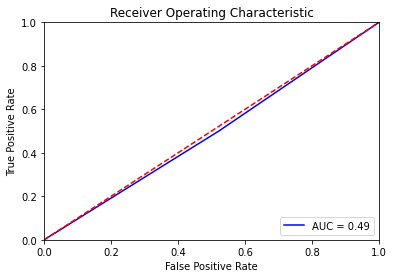

In [ ]:
fpr, tpr, threshold = metrics.roc_curve(Y_test, y_pred_ridlog)
roc_auc_1 = metrics.auc(fpr, tpr)
# AUC_results.append(roc_auc_1)

# Plot the ROC curve
import matplotlib.pyplot as plt
plt.title('Receiver Operating Characteristic')
plt.plot(fpr, tpr, 'b', label = 'AUC = %0.2f' % roc_auc_1)
plt.legend(loc = 'lower right')
plt.plot([0, 1], [0, 1],'r--')
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.show()

In [ ]:

A1_score = accuracy_score(Y_test, y_pred_ridlog)
f11_score = f1_score(Y_test, y_pred_ridlog)
r1_score = recall_score(Y_test, y_pred_ridlog)
fpr, tpr, threshold = metrics.roc_curve(Y_test, y_pred_ridlog)
roc_auc_1 = metrics.auc(fpr, tpr)
print("El valor de accuracy obtenido:", A1_score)
print("La matriz de confusión obtenida:", confusion_matrix(Y_test, y_pred_ridlog))
print("El valor de f1_score obtenido:", f11_score)
print("El valor de recall es", r1_score)

El valor de accuracy obtenido: 0.4878048780487805
La matriz de confusión obtenida: [[11 12]
 [ 9  9]]
El valor de f1_score obtenido: 0.4615384615384615
El valor de recall es 0.5


In [ ]:
res_accuracy.append(A1_score)
res_recall.append(r1_score)
res_f1.append(f11_score)
res_roc.append(roc_auc_1)

# **Knn por votación**

In [ ]:

from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.neighbors import KNeighborsRegressor
from sklearn.metrics import mean_absolute_error, mean_squared_error
from sklearn import model_selection
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix
from sklearn.metrics import accuracy_score
from sklearn.metrics import f1_score
from sklearn.metrics import recall_score
from sklearn.neighbors import KNeighborsClassifier
from sklearn import preprocessing
#from mlxtend.plotting import plot_learning_curves

In [ ]:
def knn (figura):
  # 5. Selección del hiper-parámetro haciendo uso del conjunto de diseño con características estandarizadas. 

  param_grid = {'n_neighbors': range(1,81,2)}
  k_grid = np.array(range(1,81,2))
  grid_knn = GridSearchCV(KNeighborsClassifier(), param_grid = param_grid, scoring = figura, cv=3, return_train_score=True)
  grid_knn.fit(X_train_filt, Y_train) 

  #Evaluamos las prestaciones para el conjunto de entrenamiento, de validación y representamos
  
  auc_knn_all_train = np.array(grid_knn.cv_results_['mean_train_score'])
  auc_knn_all_val = np.array(grid_knn.cv_results_['mean_test_score'])


  plt.plot(k_grid,auc_knn_all_train,'-o',label="train", linewidth=2)
  plt.plot(k_grid,auc_knn_all_val,'-*b',label="val", linewidth=2)
  plt.xlabel('k',fontsize=14)
  plt.ylabel(figura,fontsize=14)
  plt.legend()
  plt.show()

  print("Mayor valor de la figura de mérito en validación con características estandarizadas: {:.3f}".format(grid_knn.best_score_))
  print("Valor correspondiente para el hiperparámetro: {}".format(grid_knn.best_params_))

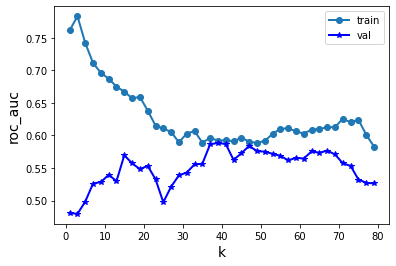

Mayor valor de la figura de mérito en validación con características estandarizadas: 0.589
Valor correspondiente para el hiperparámetro: {'n_neighbors': 39}


In [ ]:
knn('roc_auc')

In [ ]:
kNN_clasif_all = KNeighborsClassifier(n_neighbors = 39)
modelo_knn_clasif2 = kNN_clasif_all.fit(X_train_filt, Y_train) 
y_output_knn2 = modelo_knn_clasif2.predict(X_test_filt)
A1_score = accuracy_score(Y_test, y_output_knn2)
f11_score = f1_score(Y_test, y_output_knn2)
r1_score = recall_score(Y_test, y_output_knn2)

print("El valor de accuracy obtenido:", A1_score)
print("La matriz de confusión obtenida:", confusion_matrix(Y_test, y_output_knn2))
print("El valor de f1_score obtenido:", f11_score)
print("El valor de recall es", r1_score)

El valor de accuracy obtenido: 0.4634146341463415
La matriz de confusión obtenida: [[10 13]
 [ 9  9]]
El valor de f1_score obtenido: 0.45
El valor de recall es 0.5


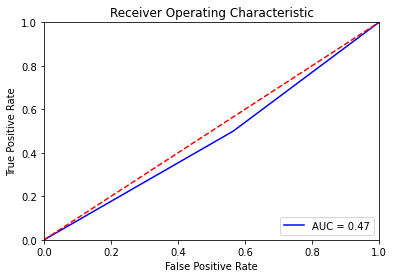

In [ ]:
fpr, tpr, threshold = metrics.roc_curve(Y_test, y_output_knn2)
roc_auc_1 = metrics.auc(fpr, tpr)
# AUC_results.append(roc_auc_1)

# Plot the ROC curve
import matplotlib.pyplot as plt
plt.title('Receiver Operating Characteristic')
plt.plot(fpr, tpr, 'b', label = 'AUC = %0.2f' % roc_auc_1)
plt.legend(loc = 'lower right')
plt.plot([0, 1], [0, 1],'r--')
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.show()

In [ ]:

A1_score = accuracy_score(Y_test, y_output_knn2)
f11_score = f1_score(Y_test, y_output_knn2)
r1_score = recall_score(Y_test, y_output_knn2)
fpr, tpr, threshold = metrics.roc_curve(Y_test, y_output_knn2)
roc_auc_1 = metrics.auc(fpr, tpr)
print("El valor de accuracy obtenido:", A1_score)
print("La matriz de confusión obtenida:", confusion_matrix(Y_test, y_output_knn2))
print("El valor de f1_score obtenido:", f11_score)
print("El valor de recall es", r1_score)

El valor de accuracy obtenido: 0.4634146341463415
La matriz de confusión obtenida: [[10 13]
 [ 9  9]]
El valor de f1_score obtenido: 0.45
El valor de recall es 0.5


In [ ]:
res_accuracy.append(A1_score)
res_recall.append(r1_score)
res_f1.append(f11_score)
res_roc.append(roc_auc_1)

# ***ÁRBOLES***

In [ ]:
from sklearn.tree import DecisionTreeClassifier

def arbol(figura):
  # 1. Selección de hiper-parámetros del árbol. En principio, consideraremos sólo la profundidad máxima
  param_grid = {'max_depth': range(1,3)}
  profundidad_grid = np.array(range(1,3))


  grid_arbol_clasif = GridSearchCV(DecisionTreeClassifier(random_state=0), param_grid = param_grid, scoring = figura, cv=3, return_train_score=True)
  modelo_arbol_clasif = grid_arbol_clasif.fit(X_train_filt, Y_train)
  print(grid_arbol_clasif.best_params_)

  perf_train_arbol = np.array(grid_arbol_clasif.cv_results_['mean_train_score'])
  perf_val_arbol = np.array(grid_arbol_clasif.cv_results_['mean_test_score'])

  plt.plot(profundidad_grid,perf_train_arbol,'-o',label="train", linewidth=2)
  plt.plot(profundidad_grid,perf_val_arbol,'-*b',label="val", linewidth=2)
  plt.xlabel('Profundidad',fontsize=14)
  plt.ylabel(figura,fontsize=14)
  plt.legend()
  plt.show()

  print("Mejor valor de la figura de mérito en validación cruzada: {:.3f}".format(grid_arbol_clasif.best_score_))
  print("Mejor valor del hiperparámetro: {}".format(grid_arbol_clasif.best_params_))


{'max_depth': 1}


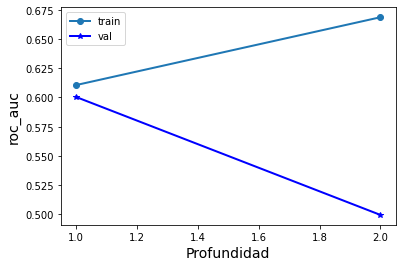

Mejor valor de la figura de mérito en validación cruzada: 0.600
Mejor valor del hiperparámetro: {'max_depth': 1}


In [ ]:
arbol('roc_auc')

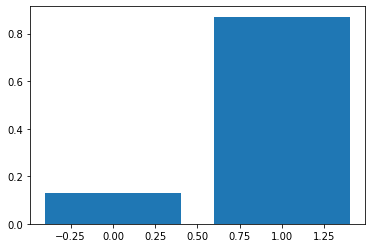

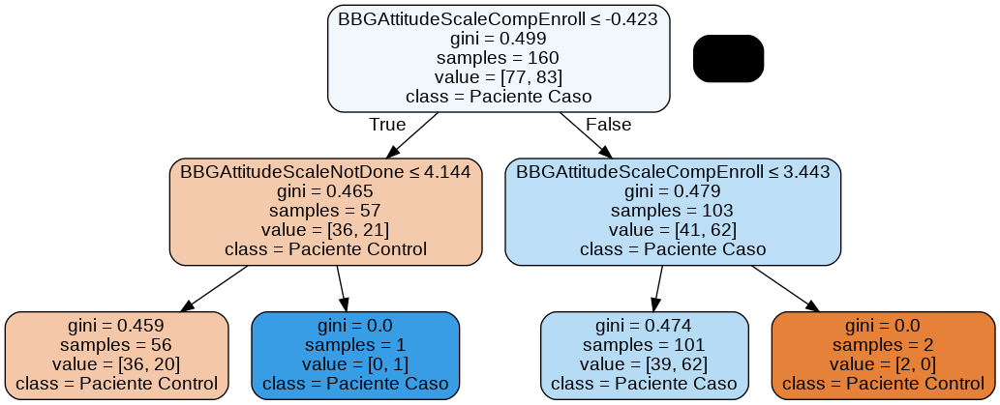

In [ ]:
# 4. Se representa la importancia de cada característica para el árbol diseñado
from matplotlib import pyplot
Arbol_clasif_all = DecisionTreeClassifier(max_depth=2)
modelo_arbol_clasif = Arbol_clasif_all.fit(X_train_filt, Y_train)
y_output_arbol = modelo_arbol_clasif.predict(X_test_filt)
importance_arbol = modelo_arbol_clasif.feature_importances_
pyplot.bar([x for x in range(len(importance_arbol))], importance_arbol)
pyplot.show()

# 5. Se representa gráficamente el modelo de clasificación
from sklearn.tree import export_graphviz
#from sklearn.externals.six import StringIO  
from six import StringIO
from IPython.display import Image  
import pydotplus

dot_data = StringIO()

export_graphviz(modelo_arbol_clasif, out_file=dot_data,  
                filled=True, rounded=True,
                special_characters=True,feature_names = data.columns[[1,2]],class_names=['Paciente Control','Paciente Caso'])

graph = pydotplus.graph_from_dot_data(dot_data.getvalue())  
graph.write_png('Tree_Clasif_all.png')
Image(graph.create_png())

In [ ]:
print("El valor de precisión obtenido:", accuracy_score(Y_test, y_output_arbol))
print("La matriz de confusión obtenida:", confusion_matrix(Y_test, y_output_arbol))
print("El valor de f1_score obtenido:", f1_score(Y_test, y_output_arbol))
print("El valor de sensibilidad es", recall_score(Y_test, y_output_arbol))

El valor de precisión obtenido: 0.4634146341463415
La matriz de confusión obtenida: [[10 13]
 [ 9  9]]
El valor de f1_score obtenido: 0.45
El valor de sensibilidad es 0.5


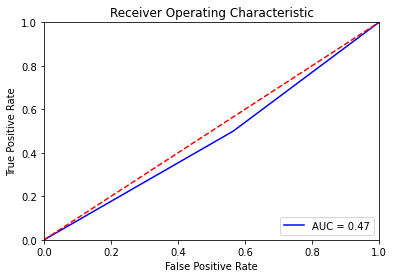

In [ ]:
fpr, tpr, threshold = metrics.roc_curve(Y_test, y_output_arbol)
roc_auc_1 = metrics.auc(fpr, tpr)
# AUC_results.append(roc_auc_1)

# Plot the ROC curve
import matplotlib.pyplot as plt
plt.title('Receiver Operating Characteristic')
plt.plot(fpr, tpr, 'b', label = 'AUC = %0.2f' % roc_auc_1)
plt.legend(loc = 'lower right')
plt.plot([0, 1], [0, 1],'r--')
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.show()

In [ ]:
A1_score = accuracy_score(Y_test, y_output_arbol)
f11_score = f1_score(Y_test, y_output_arbol)
r1_score = recall_score(Y_test, y_output_arbol)

print("El valor de accuracy obtenido:", A1_score)
print("La matriz de confusión obtenida:", confusion_matrix(Y_test, y_output_arbol))
print("El valor de f1_score obtenido:", f11_score)
print("El valor de recall es", r1_score)

El valor de accuracy obtenido: 0.4634146341463415
La matriz de confusión obtenida: [[10 13]
 [ 9  9]]
El valor de f1_score obtenido: 0.45
El valor de recall es 0.5


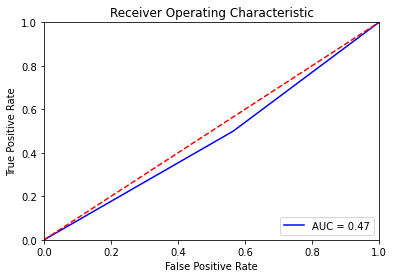

In [ ]:
fpr, tpr, threshold = metrics.roc_curve(Y_test, y_output_arbol)
roc_auc_1 = metrics.auc(fpr, tpr)
# AUC_results.append(roc_auc_1)

# Plot the ROC curve
import matplotlib.pyplot as plt
plt.title('Receiver Operating Characteristic')
plt.plot(fpr, tpr, 'b', label = 'AUC = %0.2f' % roc_auc_1)
plt.legend(loc = 'lower right')
plt.plot([0, 1], [0, 1],'r--')
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.show()

In [ ]:
res_accuracy.append(A1_score)
res_recall.append(r1_score)
res_f1.append(f11_score)
res_roc.append(roc_auc_1)

# ***SVC***

In [ ]:
# Regresión logística con regularización 
from sklearn.linear_model import LogisticRegression
from sklearn import model_selection   
from sklearn import metrics
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split, GridSearchCV

svc=SVC(decision_function_shape='ovo')

# logreg= LogisticRegression(solver='liblinear')
parameters = {'kernel': ['rbf','poly'], 'gamma': [1e-2, 1e-3, 1e-4, 1e-5],
                     'C': [0.001, 0.10, 0.1, 10, 25, 50, 100, 1000]}# l1 lasso l2 ridge
# valor_C=np.array([1e-8,1e-4,1,10,100])
svc=GridSearchCV(svc, parameters, scoring='roc_auc', cv=5, return_train_score=True)

svc.fit(X_train_filt, Y_train) #Entrenamos

# #Evaluamos las prestaciones para el conjunto de entrenamiento, de validación y representamos
roc_log_train = np.array(svc.cv_results_['mean_train_score']) 
roc_loc_val = np.array(svc.cv_results_['mean_test_score'])

# #Pintamos la evolución de nuestro modelo tanto en train como en validación para ver cuál es el mejor hiperparámetro para generalizar
# plt.plot(valor_C,roc_log_train,'-o',label="train", linewidth=2)
# plt.plot(valor_C,roc_loc_val,'-*b',label="val", linewidth=2)
# plt.xlabel('C',fontsize=14)
# plt.ylabel('Roc_auc',fontsize=14)
# plt.legend()
# plt.show()

# Mostramos el mejor valor del parámetro y el score
print("Valor correspondiente para el hiperparámetro: {}".format(svc.best_params_))
print("Mayor valor de la figura de mérito en validación con características estandarizadas: {:.3f}".format(svc.best_score_))


Valor correspondiente para el hiperparámetro: {'C': 0.1, 'gamma': 0.01, 'kernel': 'rbf'}
Mayor valor de la figura de mérito en validación con características estandarizadas: 0.610


In [ ]:


svc=SVC(C=0.1,kernel='rbf',gamma=0.01,decision_function_shape='ovo')
svc.fit(X_train_filt,Y_train)
y_test_pred=svc.predict(X_test_filt)

In [ ]:
A1_score = accuracy_score(Y_test, y_test_pred)
f11_score = f1_score(Y_test, y_test_pred)
r1_score = recall_score(Y_test, y_test_pred)

print("El valor de accuracy obtenido:", A1_score)
print("La matriz de confusión obtenida:", confusion_matrix(Y_test, y_test_pred))
print("El valor de f1_score obtenido:", f11_score)
print("El valor de recall es", r1_score)

El valor de accuracy obtenido: 0.43902439024390244
La matriz de confusión obtenida: [[ 0 23]
 [ 0 18]]
El valor de f1_score obtenido: 0.6101694915254238
El valor de recall es 1.0


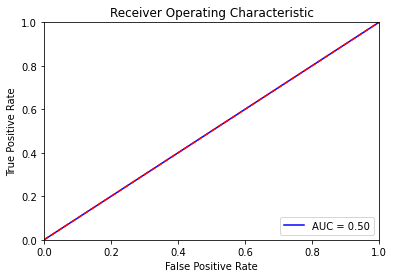

In [ ]:
fpr, tpr, threshold = metrics.roc_curve(Y_test, y_test_pred)
roc_auc_1 = metrics.auc(fpr, tpr)
# AUC_results.append(roc_auc_1)

# Plot the ROC curve
import matplotlib.pyplot as plt
plt.title('Receiver Operating Characteristic')
plt.plot(fpr, tpr, 'b', label = 'AUC = %0.2f' % roc_auc_1)
plt.legend(loc = 'lower right')
plt.plot([0, 1], [0, 1],'r--')
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.show()

In [ ]:
res_accuracy.append(A1_score)
res_recall.append(r1_score)
res_f1.append(f11_score)
res_roc.append(roc_auc_1)

# **Métodos wrapper con k-nn**

Con respecto al valor de k, elegiremos k=3, ya que es el valor obtenido al principio del proyecto con validación que nos daba mejores valores de figura de mérito.

# Sequential Forward Selection

In [ ]:
!pip install mlxtend
import joblib
import sys
sys.modules['sklearn.externals.joblib'] = joblib
from mlxtend.feature_selection import SequentialFeatureSelector as SFS

In [ ]:

from mlxtend.plotting import plot_sequential_feature_selection as plot_sfs
from sklearn.neighbors import KNeighborsClassifier

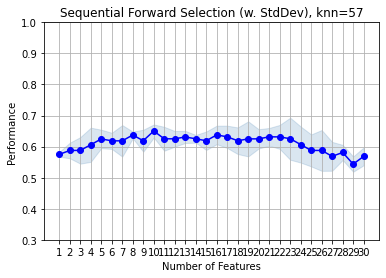

,feature_idx,cv_scores,avg_score,feature_names,ci_bound,std_dev,std_err
1,"(11,)","[0.5740740740740741, 0.5660377358490566, 0.584...",0.575006,"(11,)",0.017397,0.007731,0.005467
2,"(11, 20)","[0.5740740740740741, 0.5660377358490566, 0.622...",0.587584,"(11, 20)",0.05627,0.025005,0.017681
3,"(5, 11, 20)","[0.5370370370370371, 0.6415094339622641, 0.584...",0.587817,"(5, 11, 20)",0.09609,0.0427,0.030194
4,"(5, 11, 14, 20)","[0.6481481481481481, 0.6415094339622641, 0.528...",0.605986,"(5, 11, 14, 20)",0.123764,0.054998,0.03889
5,"(2, 5, 11, 14, 20)","[0.6666666666666666, 0.6037735849056604, 0.603...",0.624738,"(2, 5, 11, 14, 20)",0.066718,0.029648,0.020964
6,"(2, 5, 8, 11, 14, 20)","[0.6481481481481481, 0.6226415094339622, 0.584...",0.618565,"(2, 5, 8, 11, 14, 20)",0.058461,0.025979,0.01837
7,"(2, 3, 5, 8, 11, 14, 20)","[0.6481481481481481, 0.660377358490566, 0.5471...",0.618565,"(2, 3, 5, 8, 11, 14, 20)",0.11416,0.05073,0.035872
8,"(2, 3, 5, 8, 11, 13, 14, 20)","[0.6481481481481481, 0.6415094339622641, 0.622...",0.637433,"(2, 3, 5, 8, 11, 13, 14, 20)",0.024314,0.010805,0.00764
9,"(1, 2, 3, 5, 8, 11, 13, 14, 20)","[0.5740740740740741, 0.6226415094339622, 0.660...",0.619031,"(1, 2, 3, 5, 8, 11, 13, 14, 20)",0.079494,0.035326,0.024979
10,"(1, 2, 3, 5, 8, 11, 13, 14, 20, 27)","[0.6296296296296297, 0.6415094339622641, 0.679...",0.650128,"(1, 2, 3, 5, 8, 11, 13, 14, 20, 27)",0.0476,0.021152,0.014957


In [ ]:
valor_k = 57
knn = KNeighborsClassifier(n_neighbors=valor_k)
sfs = SFS(knn, 
           k_features=30, #Queremos llegar a 30 caracteristicas
           forward=True, 
           floating=False, 
           scoring='accuracy',
           cv=3)

sfs = sfs.fit(X_std_train, Y_train)

# Representar los resultados
fig1 = plot_sfs(sfs.get_metric_dict(), kind='std_dev')
plt.ylim([0.3, 1])
plt.title('Sequential Forward Selection (w. StdDev), knn=' + str(valor_k))
plt.grid()
plt.show()

pd.DataFrame.from_dict(sfs.get_metric_dict()).T


cogemos la combinación 8

Evaluamos nuestro modelo knn=3 con las características elegidas en nuestro conjunto de test:

In [ ]:
from sklearn.model_selection import train_test_split, cross_val_score

# Según SFS, escogería f0, f1, f5 y f7 
X_train_norm_SFS = X_std_train[:,[2, 3, 5, 8, 11, 13, 14, 20]]
X_test_norm_SFS = X_std_test[:,[2, 3, 5, 8, 11, 13, 14, 20]]


# ***Regresión logística con regularización***

In [ ]:
# Regresión logística con regularización 
from sklearn.linear_model import LogisticRegression
from sklearn import model_selection   
from sklearn import metrics
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split, GridSearchCV

logreg= LogisticRegression(solver='liblinear')
parameters = {"C":[1e-8,1e-4,10,100],"penalty":["l1","l2"]}# l1 lasso l2 ridge
valor_C=np.array([1e-8,1e-4,10,100])
log_regression=GridSearchCV(logreg, parameters, scoring='roc_auc', cv=5, return_train_score=True)

log_regression.fit(X_train_norm_SFS, Y_train) #Entrenamos

# #Evaluamos las prestaciones para el conjunto de entrenamiento, de validación y representamos
roc_log_train = np.array(log_regression.cv_results_['mean_train_score']) 
roc_loc_val = np.array(log_regression.cv_results_['mean_test_score'])

# #Pintamos la evolución de nuestro modelo tanto en train como en validación para ver cuál es el mejor hiperparámetro para generalizar
# plt.plot(valor_C,roc_log_train,'-o',label="train", linewidth=2)
# plt.plot(valor_C,roc_loc_val,'-*b',label="val", linewidth=2)
# plt.xlabel('C',fontsize=14)
# plt.ylabel('Roc_auc',fontsize=14)
# plt.legend()
# plt.show()

# Mostramos el mejor valor del parámetro y el score
print("Valor correspondiente para el hiperparámetro: {}".format(log_regression.best_params_))
print("Mayor valor de la figura de mérito en validación con características estandarizadas: {:.3f}".format(log_regression.best_score_))


Valor correspondiente para el hiperparámetro: {'C': 1e-08, 'penalty': 'l2'}
Mayor valor de la figura de mérito en validación con características estandarizadas: 0.617


In [ ]:
from sklearn.linear_model import Lasso

logridge=LogisticRegression(solver='liblinear', penalty='l2', C=1e-08)
modelo_rid_log=logridge.fit(X_train_norm_SFS, Y_train)

# Obtenemos la salida predicha
y_pred_ridlog = modelo_rid_log.predict(X_test_norm_SFS)

In [ ]:
from sklearn.metrics import confusion_matrix
from sklearn.metrics import accuracy_score
from sklearn.metrics import classification_report
from sklearn.metrics import recall_score

#  Calculamos la matriz de confusión
cm = confusion_matrix(Y_test, y_pred_ridlog)
print(cm)

tn, fp, fn, tp = confusion_matrix(Y_test, y_pred_ridlog).ravel()
print(f'tn: {tn}, fp:{fp}, fn:{fn}, tp:{tp}')

# Calcumos accuracy_score
Accuracy=accuracy_score(Y_test, y_pred_ridlog)
print(f'Accuracy: {Accuracy}')

target_names = ['Paciente control', 'Paciente caso']
print(classification_report(Y_test, y_pred_ridlog, target_names=target_names))
              
#Sensibilidad
Sensibilidad_3 = recall_score(Y_test, y_pred_ridlog)
# S_results.append(Sensibilidad_3)
print(f'Sensibilidad: {Sensibilidad_3}')

[[ 9 14]
 [ 6 12]]
tn: 9, fp:14, fn:6, tp:12
Accuracy: 0.5121951219512195
                  precision    recall  f1-score   support

Paciente control       0.60      0.39      0.47        23
   Paciente caso       0.46      0.67      0.55        18

        accuracy                           0.51        41
       macro avg       0.53      0.53      0.51        41
    weighted avg       0.54      0.51      0.51        41

Sensibilidad: 0.6666666666666666


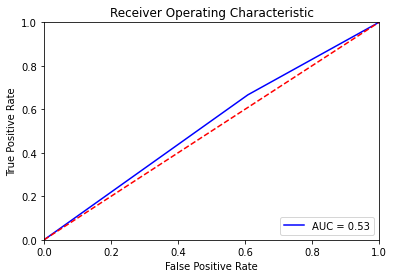

In [ ]:
fpr, tpr, threshold = metrics.roc_curve(Y_test, y_pred_ridlog)
roc_auc_1 = metrics.auc(fpr, tpr)
# AUC_results.append(roc_auc_1)

# Plot the ROC curve
import matplotlib.pyplot as plt
plt.title('Receiver Operating Characteristic')
plt.plot(fpr, tpr, 'b', label = 'AUC = %0.2f' % roc_auc_1)
plt.legend(loc = 'lower right')
plt.plot([0, 1], [0, 1],'r--')
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.show()

In [ ]:

A1_score = accuracy_score(Y_test, y_pred_ridlog)
f11_score = f1_score(Y_test, y_pred_ridlog)
r1_score = recall_score(Y_test, y_pred_ridlog)
fpr, tpr, threshold = metrics.roc_curve(Y_test, y_pred_ridlog)
roc_auc_1 = metrics.auc(fpr, tpr)
print("El valor de accuracy obtenido:", A1_score)
print("La matriz de confusión obtenida:", confusion_matrix(Y_test, y_pred_ridlog))
print("El valor de f1_score obtenido:", f11_score)
print("El valor de recall es", r1_score)

El valor de accuracy obtenido: 0.5121951219512195
La matriz de confusión obtenida: [[ 9 14]
 [ 6 12]]
El valor de f1_score obtenido: 0.5454545454545455
El valor de recall es 0.6666666666666666


In [ ]:
res_accuracy.append(A1_score)
res_recall.append(r1_score)
res_f1.append(f11_score)
res_roc.append(roc_auc_1)

# **Knn por votación**

In [ ]:

from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.neighbors import KNeighborsRegressor
from sklearn.metrics import mean_absolute_error, mean_squared_error
from sklearn import model_selection
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix
from sklearn.metrics import accuracy_score
from sklearn.metrics import f1_score
from sklearn.metrics import recall_score
from sklearn.neighbors import KNeighborsClassifier
from sklearn import preprocessing
#from mlxtend.plotting import plot_learning_curves

In [ ]:
def knn (figura):
  # 5. Selección del hiper-parámetro haciendo uso del conjunto de diseño con características estandarizadas. 

  param_grid = {'n_neighbors': range(1,81,2)}
  k_grid = np.array(range(1,81,2))
  grid_knn = GridSearchCV(KNeighborsClassifier(), param_grid = param_grid, scoring = figura, cv=3, return_train_score=True)
  grid_knn.fit(X_train_norm_SFS, Y_train) 

  #Evaluamos las prestaciones para el conjunto de entrenamiento, de validación y representamos
  
  auc_knn_all_train = np.array(grid_knn.cv_results_['mean_train_score'])
  auc_knn_all_val = np.array(grid_knn.cv_results_['mean_test_score'])


  plt.plot(k_grid,auc_knn_all_train,'-o',label="train", linewidth=2)
  plt.plot(k_grid,auc_knn_all_val,'-*b',label="val", linewidth=2)
  plt.xlabel('k',fontsize=14)
  plt.ylabel(figura,fontsize=14)
  plt.legend()
  plt.show()

  print("Mayor valor de la figura de mérito en validación con características estandarizadas: {:.3f}".format(grid_knn.best_score_))
  print("Valor correspondiente para el hiperparámetro: {}".format(grid_knn.best_params_))

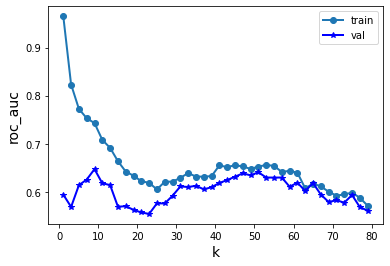

Mayor valor de la figura de mérito en validación con características estandarizadas: 0.647
Valor correspondiente para el hiperparámetro: {'n_neighbors': 9}


In [ ]:
knn('roc_auc')

In [ ]:
kNN_clasif_all = KNeighborsClassifier(n_neighbors = 9)
modelo_knn_clasif2 = kNN_clasif_all.fit(X_train_norm_SFS, Y_train) 
y_output_knn2 = modelo_knn_clasif2.predict(X_test_norm_SFS)
A1_score = accuracy_score(Y_test, y_output_knn2)
f11_score = f1_score(Y_test, y_output_knn2)
r1_score = recall_score(Y_test, y_output_knn2)

print("El valor de accuracy obtenido:", A1_score)
print("La matriz de confusión obtenida:", confusion_matrix(Y_test, y_output_knn2))
print("El valor de f1_score obtenido:", f11_score)
print("El valor de recall es", r1_score)

El valor de accuracy obtenido: 0.5365853658536586
La matriz de confusión obtenida: [[12 11]
 [ 8 10]]
El valor de f1_score obtenido: 0.5128205128205129
El valor de recall es 0.5555555555555556


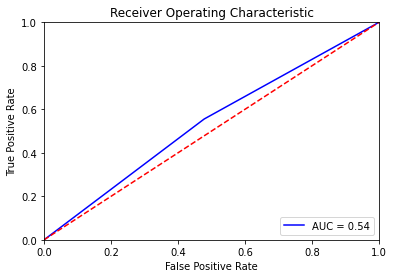

In [ ]:
fpr, tpr, threshold = metrics.roc_curve(Y_test, y_output_knn2)
roc_auc_1 = metrics.auc(fpr, tpr)
# AUC_results.append(roc_auc_1)

# Plot the ROC curve
import matplotlib.pyplot as plt
plt.title('Receiver Operating Characteristic')
plt.plot(fpr, tpr, 'b', label = 'AUC = %0.2f' % roc_auc_1)
plt.legend(loc = 'lower right')
plt.plot([0, 1], [0, 1],'r--')
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.show()

In [ ]:

A1_score = accuracy_score(Y_test, y_output_knn2)
f11_score = f1_score(Y_test, y_output_knn2)
r1_score = recall_score(Y_test, y_output_knn2)
fpr, tpr, threshold = metrics.roc_curve(Y_test, y_output_knn2)
roc_auc_1 = metrics.auc(fpr, tpr)
print("El valor de accuracy obtenido:", A1_score)
print("La matriz de confusión obtenida:", confusion_matrix(Y_test, y_output_knn2))
print("El valor de f1_score obtenido:", f11_score)
print("El valor de recall es", r1_score)

El valor de accuracy obtenido: 0.5365853658536586
La matriz de confusión obtenida: [[12 11]
 [ 8 10]]
El valor de f1_score obtenido: 0.5128205128205129
El valor de recall es 0.5555555555555556


In [ ]:
res_accuracy.append(A1_score)
res_recall.append(r1_score)
res_f1.append(f11_score)
res_roc.append(roc_auc_1)

# ***ÁRBOLES***

In [ ]:
from sklearn.tree import DecisionTreeClassifier

def arbol(figura):
  # 1. Selección de hiper-parámetros del árbol. En principio, consideraremos sólo la profundidad máxima
  param_grid = {'max_depth': range(1,9)}
  profundidad_grid = np.array(range(1,9))


  grid_arbol_clasif = GridSearchCV(DecisionTreeClassifier(random_state=0), param_grid = param_grid, scoring = figura, cv=3, return_train_score=True)
  modelo_arbol_clasif = grid_arbol_clasif.fit(X_train_norm_SFS, Y_train)
  print(grid_arbol_clasif.best_params_)

  perf_train_arbol = np.array(grid_arbol_clasif.cv_results_['mean_train_score'])
  perf_val_arbol = np.array(grid_arbol_clasif.cv_results_['mean_test_score'])

  plt.plot(profundidad_grid,perf_train_arbol,'-o',label="train", linewidth=2)
  plt.plot(profundidad_grid,perf_val_arbol,'-*b',label="val", linewidth=2)
  plt.xlabel('Profundidad',fontsize=14)
  plt.ylabel(figura,fontsize=14)
  plt.legend()
  plt.show()

  print("Mejor valor de la figura de mérito en validación cruzada: {:.3f}".format(grid_arbol_clasif.best_score_))
  print("Mejor valor del hiperparámetro: {}".format(grid_arbol_clasif.best_params_))


{'max_depth': 4}


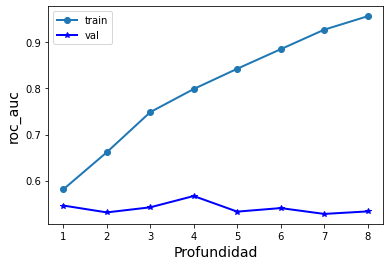

Mejor valor de la figura de mérito en validación cruzada: 0.567
Mejor valor del hiperparámetro: {'max_depth': 4}


In [ ]:
arbol('roc_auc')

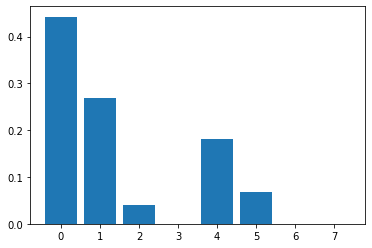

ValueError: ignored

In [ ]:
# 4. Se representa la importancia de cada característica para el árbol diseñado
from matplotlib import pyplot
Arbol_clasif_all = DecisionTreeClassifier(max_depth=4)
modelo_arbol_clasif = Arbol_clasif_all.fit(X_train_norm_SFS, Y_train)
y_output_arbol = modelo_arbol_clasif.predict(X_test_norm_SFS)
importance_arbol = modelo_arbol_clasif.feature_importances_
pyplot.bar([x for x in range(len(importance_arbol))], importance_arbol)
pyplot.show()

# 5. Se representa gráficamente el modelo de clasificación
from sklearn.tree import export_graphviz
#from sklearn.externals.six import StringIO  
from six import StringIO
from IPython.display import Image  
import pydotplus

dot_data = StringIO()

export_graphviz(modelo_arbol_clasif, out_file=dot_data,  
                filled=True, rounded=True,
                special_characters=True,feature_names = data.columns[[1,2]],class_names=['Paciente Control','Paciente Caso'])

graph = pydotplus.graph_from_dot_data(dot_data.getvalue())  
graph.write_png('Tree_Clasif_all.png')
Image(graph.create_png())

In [ ]:
print("El valor de precisión obtenido:", accuracy_score(Y_test, y_output_arbol))
print("La matriz de confusión obtenida:", confusion_matrix(Y_test, y_output_arbol))
print("El valor de f1_score obtenido:", f1_score(Y_test, y_output_arbol))
print("El valor de sensibilidad es", recall_score(Y_test, y_output_arbol))

El valor de precisión obtenido: 0.5365853658536586
La matriz de confusión obtenida: [[15  8]
 [11  7]]
El valor de f1_score obtenido: 0.42424242424242425
El valor de sensibilidad es 0.3888888888888889


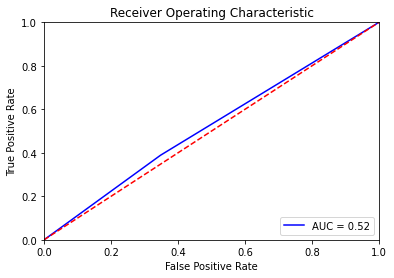

In [ ]:
fpr, tpr, threshold = metrics.roc_curve(Y_test, y_output_arbol)
roc_auc_1 = metrics.auc(fpr, tpr)
# AUC_results.append(roc_auc_1)

# Plot the ROC curve
import matplotlib.pyplot as plt
plt.title('Receiver Operating Characteristic')
plt.plot(fpr, tpr, 'b', label = 'AUC = %0.2f' % roc_auc_1)
plt.legend(loc = 'lower right')
plt.plot([0, 1], [0, 1],'r--')
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.show()

In [ ]:
A1_score = accuracy_score(Y_test, y_output_arbol)
f11_score = f1_score(Y_test, y_output_arbol)
r1_score = recall_score(Y_test, y_output_arbol)

print("El valor de accuracy obtenido:", A1_score)
print("La matriz de confusión obtenida:", confusion_matrix(Y_test, y_output_arbol))
print("El valor de f1_score obtenido:", f11_score)
print("El valor de recall es", r1_score)

El valor de accuracy obtenido: 0.5365853658536586
La matriz de confusión obtenida: [[15  8]
 [11  7]]
El valor de f1_score obtenido: 0.42424242424242425
El valor de recall es 0.3888888888888889


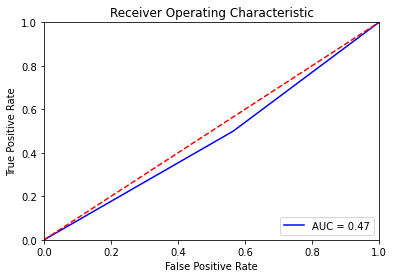

In [ ]:
fpr, tpr, threshold = metrics.roc_curve(Y_test, y_output_arbol)
roc_auc_1 = metrics.auc(fpr, tpr)
# AUC_results.append(roc_auc_1)

# Plot the ROC curve
import matplotlib.pyplot as plt
plt.title('Receiver Operating Characteristic')
plt.plot(fpr, tpr, 'b', label = 'AUC = %0.2f' % roc_auc_1)
plt.legend(loc = 'lower right')
plt.plot([0, 1], [0, 1],'r--')
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.show()

In [ ]:
res_accuracy.append(A1_score)
res_recall.append(r1_score)
res_f1.append(f11_score)
res_roc.append(roc_auc_1)

# ***SVC***

In [ ]:
# Regresión logística con regularización 
from sklearn.linear_model import LogisticRegression
from sklearn import model_selection   
from sklearn import metrics
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split, GridSearchCV

svc=SVC(decision_function_shape='ovo')

# logreg= LogisticRegression(solver='liblinear')
parameters = {'kernel': ['rbf','poly'], 'gamma': [1e-2, 1e-3, 1e-4, 1e-5],
                     'C': [0.001, 0.10, 0.1, 10, 25, 50, 100, 1000]}# l1 lasso l2 ridge
# valor_C=np.array([1e-8,1e-4,1,10,100])
svc=GridSearchCV(svc, parameters, scoring='roc_auc', cv=5, return_train_score=True)

svc.fit(X_train_norm_SFS, Y_train) #Entrenamos

# #Evaluamos las prestaciones para el conjunto de entrenamiento, de validación y representamos
roc_log_train = np.array(svc.cv_results_['mean_train_score']) 
roc_loc_val = np.array(svc.cv_results_['mean_test_score'])

# #Pintamos la evolución de nuestro modelo tanto en train como en validación para ver cuál es el mejor hiperparámetro para generalizar
# plt.plot(valor_C,roc_log_train,'-o',label="train", linewidth=2)
# plt.plot(valor_C,roc_loc_val,'-*b',label="val", linewidth=2)
# plt.xlabel('C',fontsize=14)
# plt.ylabel('Roc_auc',fontsize=14)
# plt.legend()
# plt.show()

# Mostramos el mejor valor del parámetro y el score
print("Valor correspondiente para el hiperparámetro: {}".format(svc.best_params_))
print("Mayor valor de la figura de mérito en validación con características estandarizadas: {:.3f}".format(svc.best_score_))


Valor correspondiente para el hiperparámetro: {'C': 1000, 'gamma': 0.01, 'kernel': 'rbf'}
Mayor valor de la figura de mérito en validación con características estandarizadas: 0.648


In [ ]:


svc=SVC(C=1000,kernel='rbf',gamma=0.01,decision_function_shape='ovo')
svc.fit(X_train_norm_SFS,Y_train)
y_test_pred=svc.predict(X_test_norm_SFS)

In [ ]:
A1_score = accuracy_score(Y_test, y_test_pred)
f11_score = f1_score(Y_test, y_test_pred)
r1_score = recall_score(Y_test, y_test_pred)

print("El valor de accuracy obtenido:", A1_score)
print("La matriz de confusión obtenida:", confusion_matrix(Y_test, y_test_pred))
print("El valor de f1_score obtenido:", f11_score)
print("El valor de recall es", r1_score)

El valor de accuracy obtenido: 0.5365853658536586
La matriz de confusión obtenida: [[14  9]
 [10  8]]
El valor de f1_score obtenido: 0.45714285714285713
El valor de recall es 0.4444444444444444


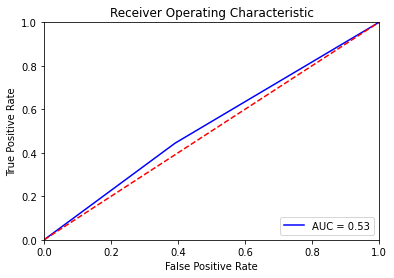

In [ ]:
fpr, tpr, threshold = metrics.roc_curve(Y_test, y_test_pred)
roc_auc_1 = metrics.auc(fpr, tpr)
# AUC_results.append(roc_auc_1)

# Plot the ROC curve
import matplotlib.pyplot as plt
plt.title('Receiver Operating Characteristic')
plt.plot(fpr, tpr, 'b', label = 'AUC = %0.2f' % roc_auc_1)
plt.legend(loc = 'lower right')
plt.plot([0, 1], [0, 1],'r--')
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.show()

In [ ]:
res_accuracy.append(A1_score)
res_recall.append(r1_score)
res_f1.append(f11_score)
res_roc.append(roc_auc_1)

# Sequential Backward Elimination

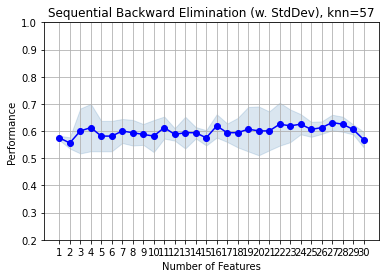

,feature_idx,cv_scores,avg_score,feature_names,ci_bound,std_dev,std_err
30,"(0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13,...","[0.5925925925925926, 0.5283018867924528, 0.584...",0.5686,"(0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13,...",0.064511,0.028667,0.020271
29,"(0, 1, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...","[0.6296296296296297, 0.6037735849056604, 0.584...",0.606103,"(0, 1, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...",0.041254,0.018333,0.012963
28,"(0, 1, 3, 4, 5, 6, 7, 8, 10, 11, 12, 13, 14, 1...","[0.5925925925925926, 0.6226415094339622, 0.660...",0.625204,"(0, 1, 3, 4, 5, 6, 7, 8, 10, 11, 12, 13, 14, 1...",0.062407,0.027732,0.01961
27,"(1, 3, 4, 5, 6, 7, 8, 10, 11, 12, 13, 14, 15, ...","[0.5925925925925926, 0.6415094339622641, 0.660...",0.631493,"(1, 3, 4, 5, 6, 7, 8, 10, 11, 12, 13, 14, 15, ...",0.064281,0.028565,0.020199
26,"(1, 3, 4, 5, 6, 7, 10, 11, 12, 13, 14, 15, 16,...","[0.6111111111111112, 0.6415094339622641, 0.584...",0.612509,"(1, 3, 4, 5, 6, 7, 10, 11, 12, 13, 14, 15, 16,...",0.052049,0.02313,0.016355
25,"(1, 3, 4, 5, 6, 7, 10, 11, 12, 13, 14, 15, 16,...","[0.5740740740740741, 0.6415094339622641, 0.603...",0.606452,"(1, 3, 4, 5, 6, 7, 10, 11, 12, 13, 14, 15, 16,...",0.062099,0.027595,0.019513
24,"(1, 3, 5, 6, 7, 10, 11, 12, 13, 14, 15, 16, 17...","[0.5740740740740741, 0.660377358490566, 0.6415...",0.62532,"(1, 3, 5, 6, 7, 10, 11, 12, 13, 14, 15, 16, 17...",0.083366,0.037046,0.026196
23,"(1, 3, 5, 6, 7, 10, 11, 12, 13, 14, 15, 16, 18...","[0.5370370370370371, 0.6792452830188679, 0.641...",0.619264,"(1, 3, 5, 6, 7, 10, 11, 12, 13, 14, 15, 16, 18...",0.135356,0.06015,0.042532
22,"(1, 3, 6, 7, 10, 11, 12, 13, 14, 15, 16, 18, 1...","[0.5555555555555556, 0.5849056603773585, 0.735...",0.625437,"(1, 3, 6, 7, 10, 11, 12, 13, 14, 15, 16, 18, 1...",0.177748,0.078987,0.055853
21,"(1, 3, 6, 7, 10, 11, 12, 13, 14, 16, 18, 19, 2...","[0.5, 0.6415094339622641, 0.660377358490566]",0.600629,"(1, 3, 6, 7, 10, 11, 12, 13, 14, 16, 18, 19, 2...",0.161059,0.071571,0.050608


In [ ]:
# Sequential Backward Selection
valor_k = 57
knn = KNeighborsClassifier(n_neighbors=valor_k)

sbs = SFS(knn, 
          k_features=1, 
          forward=False, 
          floating=False, 
          scoring='accuracy',
          cv=3)
sbs = sbs.fit(X_std_train, Y_train)



# Plotting the results
fig4 = plot_sfs(sbs.get_metric_dict(), kind='std_dev')
plt.ylim([0.2, 1])
plt.title('Sequential Backward Elimination (w. StdDev), knn=' + str(valor_k))
plt.grid()
plt.show()

pd.DataFrame.from_dict(sbs.get_metric_dict()).T

In [ ]:
from sklearn.model_selection import train_test_split, cross_val_score

# Según SFS, escogería f0, f1, f5 y f7 
X_train_SFS = X_std_train[:,[11, 16, 22, 29]]
X_test_SFS = X_std_test[:,[11, 16, 22, 29]]


# ***Regresión logística con regularización***

In [ ]:
# Regresión logística con regularización 
from sklearn.linear_model import LogisticRegression
from sklearn import model_selection   
from sklearn import metrics
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split, GridSearchCV

logreg= LogisticRegression(solver='liblinear')
parameters = {"C":[1e-8,1e-4,10,100],"penalty":["l1","l2"]}# l1 lasso l2 ridge
valor_C=np.array([1e-8,1e-4,10,100])
log_regression=GridSearchCV(logreg, parameters, scoring='roc_auc', cv=5, return_train_score=True)

log_regression.fit(X_train_SFS, Y_train) #Entrenamos

# #Evaluamos las prestaciones para el conjunto de entrenamiento, de validación y representamos
roc_log_train = np.array(log_regression.cv_results_['mean_train_score']) 
roc_loc_val = np.array(log_regression.cv_results_['mean_test_score'])

# #Pintamos la evolución de nuestro modelo tanto en train como en validación para ver cuál es el mejor hiperparámetro para generalizar
# plt.plot(valor_C,roc_log_train,'-o',label="train", linewidth=2)
# plt.plot(valor_C,roc_loc_val,'-*b',label="val", linewidth=2)
# plt.xlabel('C',fontsize=14)
# plt.ylabel('Roc_auc',fontsize=14)
# plt.legend()
# plt.show()

# Mostramos el mejor valor del parámetro y el score
print("Valor correspondiente para el hiperparámetro: {}".format(log_regression.best_params_))
print("Mayor valor de la figura de mérito en validación con características estandarizadas: {:.3f}".format(log_regression.best_score_))


Valor correspondiente para el hiperparámetro: {'C': 1e-08, 'penalty': 'l2'}
Mayor valor de la figura de mérito en validación con características estandarizadas: 0.564


In [ ]:
from sklearn.linear_model import Lasso

logridge=LogisticRegression(solver='liblinear', penalty='l2', C=1e-08)
modelo_rid_log=logridge.fit(X_train_SFS, Y_train)

# Obtenemos la salida predicha
y_pred_ridlog = modelo_rid_log.predict(X_test_SFS)

In [ ]:
from sklearn.metrics import confusion_matrix
from sklearn.metrics import accuracy_score
from sklearn.metrics import classification_report
from sklearn.metrics import recall_score

#  Calculamos la matriz de confusión
cm = confusion_matrix(Y_test, y_pred_ridlog)
print(cm)

tn, fp, fn, tp = confusion_matrix(Y_test, y_pred_ridlog).ravel()
print(f'tn: {tn}, fp:{fp}, fn:{fn}, tp:{tp}')

# Calcumos accuracy_score
Accuracy=accuracy_score(Y_test, y_pred_ridlog)
print(f'Accuracy: {Accuracy}')

target_names = ['Paciente control', 'Paciente caso']
print(classification_report(Y_test, y_pred_ridlog, target_names=target_names))
              
#Sensibilidad
Sensibilidad_3 = recall_score(Y_test, y_pred_ridlog)
# S_results.append(Sensibilidad_3)
print(f'Sensibilidad: {Sensibilidad_3}')

[[10 13]
 [ 9  9]]
tn: 10, fp:13, fn:9, tp:9
Accuracy: 0.4634146341463415
                  precision    recall  f1-score   support

Paciente control       0.53      0.43      0.48        23
   Paciente caso       0.41      0.50      0.45        18

        accuracy                           0.46        41
       macro avg       0.47      0.47      0.46        41
    weighted avg       0.47      0.46      0.46        41

Sensibilidad: 0.5


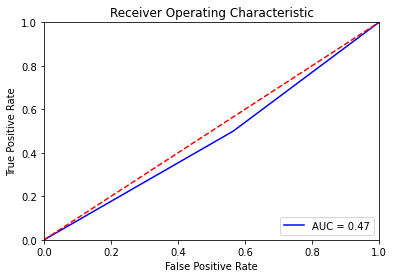

In [ ]:
fpr, tpr, threshold = metrics.roc_curve(Y_test, y_pred_ridlog)
roc_auc_1 = metrics.auc(fpr, tpr)
# AUC_results.append(roc_auc_1)

# Plot the ROC curve
import matplotlib.pyplot as plt
plt.title('Receiver Operating Characteristic')
plt.plot(fpr, tpr, 'b', label = 'AUC = %0.2f' % roc_auc_1)
plt.legend(loc = 'lower right')
plt.plot([0, 1], [0, 1],'r--')
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.show()

In [ ]:

A1_score = accuracy_score(Y_test, y_pred_ridlog)
f11_score = f1_score(Y_test, y_pred_ridlog)
r1_score = recall_score(Y_test, y_pred_ridlog)
fpr, tpr, threshold = metrics.roc_curve(Y_test, y_pred_ridlog)
roc_auc_1 = metrics.auc(fpr, tpr)
print("El valor de accuracy obtenido:", A1_score)
print("La matriz de confusión obtenida:", confusion_matrix(Y_test, y_pred_ridlog))
print("El valor de f1_score obtenido:", f11_score)
print("El valor de recall es", r1_score)

El valor de accuracy obtenido: 0.4634146341463415
La matriz de confusión obtenida: [[10 13]
 [ 9  9]]
El valor de f1_score obtenido: 0.45
El valor de recall es 0.5


In [ ]:
res_accuracy.append(A1_score)
res_recall.append(r1_score)
res_f1.append(f11_score)
res_roc.append(roc_auc_1)

# **Knn por votación**

In [ ]:

from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.neighbors import KNeighborsRegressor
from sklearn.metrics import mean_absolute_error, mean_squared_error
from sklearn import model_selection
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix
from sklearn.metrics import accuracy_score
from sklearn.metrics import f1_score
from sklearn.metrics import recall_score
from sklearn.neighbors import KNeighborsClassifier
from sklearn import preprocessing
#from mlxtend.plotting import plot_learning_curves

In [ ]:
def knn (figura):
  # 5. Selección del hiper-parámetro haciendo uso del conjunto de diseño con características estandarizadas. 

  param_grid = {'n_neighbors': range(1,81,2)}
  k_grid = np.array(range(1,81,2))
  grid_knn = GridSearchCV(KNeighborsClassifier(), param_grid = param_grid, scoring = figura, cv=3, return_train_score=True)
  grid_knn.fit(X_train_SFS, Y_train) 

  #Evaluamos las prestaciones para el conjunto de entrenamiento, de validación y representamos
  
  auc_knn_all_train = np.array(grid_knn.cv_results_['mean_train_score'])
  auc_knn_all_val = np.array(grid_knn.cv_results_['mean_test_score'])


  plt.plot(k_grid,auc_knn_all_train,'-o',label="train", linewidth=2)
  plt.plot(k_grid,auc_knn_all_val,'-*b',label="val", linewidth=2)
  plt.xlabel('k',fontsize=14)
  plt.ylabel(figura,fontsize=14)
  plt.legend()
  plt.show()

  print("Mayor valor de la figura de mérito en validación con características estandarizadas: {:.3f}".format(grid_knn.best_score_))
  print("Valor correspondiente para el hiperparámetro: {}".format(grid_knn.best_params_))

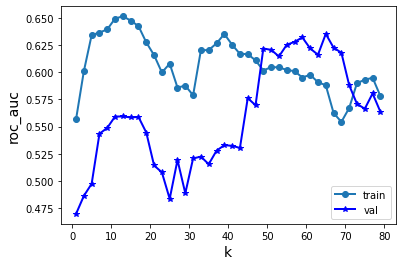

Mayor valor de la figura de mérito en validación con características estandarizadas: 0.635
Valor correspondiente para el hiperparámetro: {'n_neighbors': 65}


In [ ]:
knn('roc_auc')

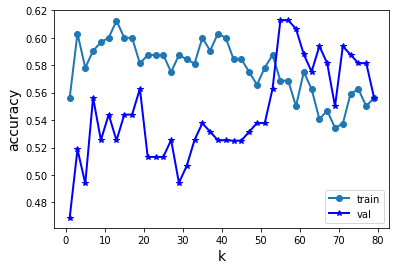

Mayor valor de la figura de mérito en validación con características estandarizadas: 0.613
Valor correspondiente para el hiperparámetro: {'n_neighbors': 55}


In [ ]:
knn('accuracy')

In [ ]:
kNN_clasif_all = KNeighborsClassifier(n_neighbors = 55)
modelo_knn_clasif2 = kNN_clasif_all.fit(X_train_SFS, Y_train) 
y_output_knn2 = modelo_knn_clasif2.predict(X_test_SFS)
A1_score = accuracy_score(Y_test, y_output_knn2)
f11_score = f1_score(Y_test, y_output_knn2)
r1_score = recall_score(Y_test, y_output_knn2)

print("El valor de accuracy obtenido:", A1_score)
print("La matriz de confusión obtenida:", confusion_matrix(Y_test, y_output_knn2))
print("El valor de f1_score obtenido:", f11_score)
print("El valor de recall es", r1_score)

El valor de accuracy obtenido: 0.5121951219512195
La matriz de confusión obtenida: [[ 6 17]
 [ 3 15]]
El valor de f1_score obtenido: 0.6
El valor de recall es 0.8333333333333334


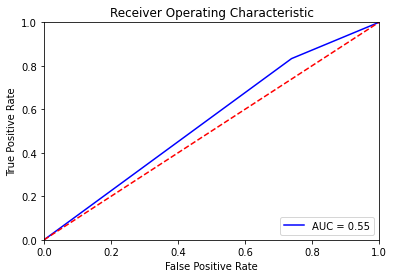

In [ ]:
fpr, tpr, threshold = metrics.roc_curve(Y_test, y_output_knn2)
roc_auc_1 = metrics.auc(fpr, tpr)
# AUC_results.append(roc_auc_1)

# Plot the ROC curve
import matplotlib.pyplot as plt
plt.title('Receiver Operating Characteristic')
plt.plot(fpr, tpr, 'b', label = 'AUC = %0.2f' % roc_auc_1)
plt.legend(loc = 'lower right')
plt.plot([0, 1], [0, 1],'r--')
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.show()

In [ ]:

A1_score = accuracy_score(Y_test, y_output_knn2)
f11_score = f1_score(Y_test, y_output_knn2)
r1_score = recall_score(Y_test, y_output_knn2)
fpr, tpr, threshold = metrics.roc_curve(Y_test, y_output_knn2)
roc_auc_1 = metrics.auc(fpr, tpr)
print("El valor de accuracy obtenido:", A1_score)
print("La matriz de confusión obtenida:", confusion_matrix(Y_test, y_output_knn2))
print("El valor de f1_score obtenido:", f11_score)
print("El valor de recall es", r1_score)

El valor de accuracy obtenido: 0.5121951219512195
La matriz de confusión obtenida: [[ 6 17]
 [ 3 15]]
El valor de f1_score obtenido: 0.6
El valor de recall es 0.8333333333333334


In [ ]:
res_accuracy.append(A1_score)
res_recall.append(r1_score)
res_f1.append(f11_score)
res_roc.append(roc_auc_1)

# ***ÁRBOLES***

In [ ]:
from sklearn.tree import DecisionTreeClassifier

def arbol(figura):
  # 1. Selección de hiper-parámetros del árbol. En principio, consideraremos sólo la profundidad máxima
  param_grid = {'max_depth': range(1,5)}
  profundidad_grid = np.array(range(1,5))


  grid_arbol_clasif = GridSearchCV(DecisionTreeClassifier(random_state=0), param_grid = param_grid, scoring = figura, cv=3, return_train_score=True)
  modelo_arbol_clasif = grid_arbol_clasif.fit(X_train_SFS, Y_train)
  print(grid_arbol_clasif.best_params_)

  perf_train_arbol = np.array(grid_arbol_clasif.cv_results_['mean_train_score'])
  perf_val_arbol = np.array(grid_arbol_clasif.cv_results_['mean_test_score'])

  plt.plot(profundidad_grid,perf_train_arbol,'-o',label="train", linewidth=2)
  plt.plot(profundidad_grid,perf_val_arbol,'-*b',label="val", linewidth=2)
  plt.xlabel('Profundidad',fontsize=14)
  plt.ylabel(figura,fontsize=14)
  plt.legend()
  plt.show()

  print("Mejor valor de la figura de mérito en validación cruzada: {:.3f}".format(grid_arbol_clasif.best_score_))
  print("Mejor valor del hiperparámetro: {}".format(grid_arbol_clasif.best_params_))


{'max_depth': 2}


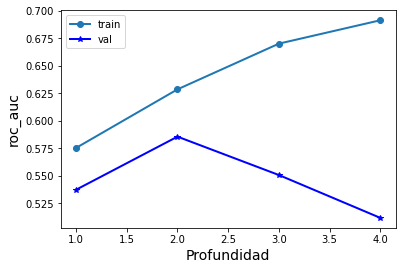

Mejor valor de la figura de mérito en validación cruzada: 0.586
Mejor valor del hiperparámetro: {'max_depth': 2}


In [ ]:
arbol('roc_auc')

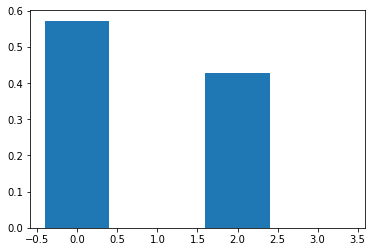

ValueError: ignored

In [ ]:
# 4. Se representa la importancia de cada característica para el árbol diseñado
from matplotlib import pyplot
Arbol_clasif_all = DecisionTreeClassifier(max_depth=2)
modelo_arbol_clasif = Arbol_clasif_all.fit(X_train_SFS, Y_train)
y_output_arbol = modelo_arbol_clasif.predict(X_test_SFS)
importance_arbol = modelo_arbol_clasif.feature_importances_
pyplot.bar([x for x in range(len(importance_arbol))], importance_arbol)
pyplot.show()

# 5. Se representa gráficamente el modelo de clasificación
from sklearn.tree import export_graphviz
#from sklearn.externals.six import StringIO  
from six import StringIO
from IPython.display import Image  
import pydotplus

dot_data = StringIO()

export_graphviz(modelo_arbol_clasif, out_file=dot_data,  
                filled=True, rounded=True,
                special_characters=True,feature_names = data.columns[:,],class_names=['Paciente Control','Paciente Caso'])

graph = pydotplus.graph_from_dot_data(dot_data.getvalue())  
graph.write_png('Tree_Clasif_all.png')
Image(graph.create_png())

In [ ]:
print("El valor de precisión obtenido:", accuracy_score(Y_test, y_output_arbol))
print("La matriz de confusión obtenida:", confusion_matrix(Y_test, y_output_arbol))
print("El valor de f1_score obtenido:", f1_score(Y_test, y_output_arbol))
print("El valor de sensibilidad es", recall_score(Y_test, y_output_arbol))

El valor de precisión obtenido: 0.5365853658536586
La matriz de confusión obtenida: [[15  8]
 [11  7]]
El valor de f1_score obtenido: 0.42424242424242425
El valor de sensibilidad es 0.3888888888888889


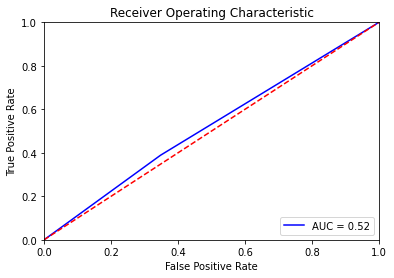

In [ ]:
fpr, tpr, threshold = metrics.roc_curve(Y_test, y_output_arbol)
roc_auc_1 = metrics.auc(fpr, tpr)
# AUC_results.append(roc_auc_1)

# Plot the ROC curve
import matplotlib.pyplot as plt
plt.title('Receiver Operating Characteristic')
plt.plot(fpr, tpr, 'b', label = 'AUC = %0.2f' % roc_auc_1)
plt.legend(loc = 'lower right')
plt.plot([0, 1], [0, 1],'r--')
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.show()

In [ ]:
A1_score = accuracy_score(Y_test, y_output_arbol)
f11_score = f1_score(Y_test, y_output_arbol)
r1_score = recall_score(Y_test, y_output_arbol)

print("El valor de accuracy obtenido:", A1_score)
print("La matriz de confusión obtenida:", confusion_matrix(Y_test, y_output_arbol))
print("El valor de f1_score obtenido:", f11_score)
print("El valor de recall es", r1_score)

El valor de accuracy obtenido: 0.5365853658536586
La matriz de confusión obtenida: [[15  8]
 [11  7]]
El valor de f1_score obtenido: 0.42424242424242425
El valor de recall es 0.3888888888888889


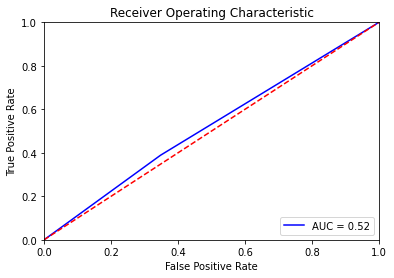

In [ ]:
fpr, tpr, threshold = metrics.roc_curve(Y_test, y_output_arbol)
roc_auc_1 = metrics.auc(fpr, tpr)
# AUC_results.append(roc_auc_1)

# Plot the ROC curve
import matplotlib.pyplot as plt
plt.title('Receiver Operating Characteristic')
plt.plot(fpr, tpr, 'b', label = 'AUC = %0.2f' % roc_auc_1)
plt.legend(loc = 'lower right')
plt.plot([0, 1], [0, 1],'r--')
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.show()

In [ ]:
res_accuracy.append(A1_score)
res_recall.append(r1_score)
res_f1.append(f11_score)
res_roc.append(roc_auc_1)

# ***SVC***

In [ ]:
# Regresión logística con regularización 
from sklearn.linear_model import LogisticRegression
from sklearn import model_selection   
from sklearn import metrics
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split, GridSearchCV

svc=SVC(decision_function_shape='ovo')

# logreg= LogisticRegression(solver='liblinear')
parameters = {'kernel': ['rbf','poly'], 'gamma': [1e-2, 1e-3, 1e-4, 1e-5],
                     'C': [0.001, 0.10, 0.1, 10, 25, 50, 100, 1000]}# l1 lasso l2 ridge
# valor_C=np.array([1e-8,1e-4,1,10,100])
svc=GridSearchCV(svc, parameters, scoring='roc_auc', cv=5, return_train_score=True)

svc.fit(X_train_SFS, Y_train) #Entrenamos

# #Evaluamos las prestaciones para el conjunto de entrenamiento, de validación y representamos
roc_log_train = np.array(svc.cv_results_['mean_train_score']) 
roc_loc_val = np.array(svc.cv_results_['mean_test_score'])

# #Pintamos la evolución de nuestro modelo tanto en train como en validación para ver cuál es el mejor hiperparámetro para generalizar
# plt.plot(valor_C,roc_log_train,'-o',label="train", linewidth=2)
# plt.plot(valor_C,roc_loc_val,'-*b',label="val", linewidth=2)
# plt.xlabel('C',fontsize=14)
# plt.ylabel('Roc_auc',fontsize=14)
# plt.legend()
# plt.show()

# Mostramos el mejor valor del parámetro y el score
print("Valor correspondiente para el hiperparámetro: {}".format(svc.best_params_))
print("Mayor valor de la figura de mérito en validación con características estandarizadas: {:.3f}".format(svc.best_score_))


Valor correspondiente para el hiperparámetro: {'C': 0.001, 'gamma': 1e-05, 'kernel': 'poly'}
Mayor valor de la figura de mérito en validación con características estandarizadas: 0.574


In [ ]:


svc=SVC(C=0.001,kernel='poly',gamma=1e-05,decision_function_shape='ovo')
svc.fit(X_train_SFS,Y_train)
y_test_pred=svc.predict(X_test_SFS)

In [ ]:
A1_score = accuracy_score(Y_test, y_test_pred)
f11_score = f1_score(Y_test, y_test_pred)
r1_score = recall_score(Y_test, y_test_pred)

print("El valor de accuracy obtenido:", A1_score)
print("La matriz de confusión obtenida:", confusion_matrix(Y_test, y_test_pred))
print("El valor de f1_score obtenido:", f11_score)
print("El valor de recall es", r1_score)

El valor de accuracy obtenido: 0.43902439024390244
La matriz de confusión obtenida: [[ 0 23]
 [ 0 18]]
El valor de f1_score obtenido: 0.6101694915254238
El valor de recall es 1.0


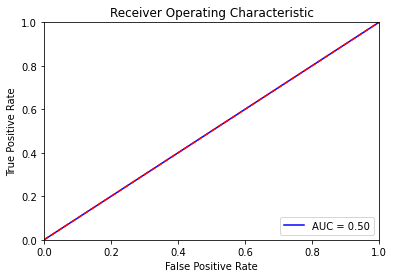

In [ ]:
fpr, tpr, threshold = metrics.roc_curve(Y_test, y_test_pred)
roc_auc_1 = metrics.auc(fpr, tpr)
# AUC_results.append(roc_auc_1)

# Plot the ROC curve
import matplotlib.pyplot as plt
plt.title('Receiver Operating Characteristic')
plt.plot(fpr, tpr, 'b', label = 'AUC = %0.2f' % roc_auc_1)
plt.legend(loc = 'lower right')
plt.plot([0, 1], [0, 1],'r--')
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.show()

In [ ]:
res_accuracy.append(A1_score)
res_recall.append(r1_score)
res_f1.append(f11_score)
res_roc.append(roc_auc_1)

In [ ]:
results = pd.DataFrame()

results["Accuracy"]=res_accuracy
results["Recall"]=res_recall
results["F1-score"]=res_f1
results["Auc"]=res_roc

#results
results["Modelos"] = ["Regresión logística-árbol", "Knn-árbol","Árbol-arbol","SVC-árbol","Regresión logística-chi2", "Knn-chi2","Árbol-chi2","SVC-chi2","Regresión logística-SFS-knn", "Knn-SFS-knn","Árbol-SFS-knn","SVC-SFS-knn","Regresión logística-SBE-knn", "Knn-SBE-knn","Árbol-SBE-knn","SVC-SBE-knn"]
results.set_index("Modelos", inplace = True)

In [ ]:
results

,Accuracy,Recall,F1-score,Auc
Modelos,,,,
Regresión logística-árbol,0.609756,0.666667,0.600000,0.615942
Knn-árbol,0.585366,0.500000,0.514286,0.576087
Árbol-arbol,0.463415,0.500000,0.450000,0.467391
SVC-árbol,0.439024,0.444444,0.410256,0.439614
Regresión logística-chi2,0.487805,0.500000,0.461538,0.489130
Knn-chi2,0.463415,0.500000,0.450000,0.467391
Árbol-chi2,0.463415,0.500000,0.450000,0.467391
SVC-chi2,0.439024,1.000000,0.610169,0.500000
Regresión logística-SFS-knn,0.512195,0.666667,0.545455,0.528986


In [ ]:

from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.neighbors import KNeighborsRegressor
from sklearn.metrics import mean_absolute_error, mean_squared_error
from sklearn import model_selection
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix
from sklearn.metrics import accuracy_score
from sklearn.metrics import f1_score
from sklearn.metrics import recall_score
from sklearn.neighbors import KNeighborsClassifier
from sklearn import preprocessing
#from mlxtend.plotting import plot_learning_curves

In [ ]:
def knn (figura):
  # 5. Selección del hiper-parámetro haciendo uso del conjunto de diseño con características estandarizadas. 

  param_grid = {'n_neighbors': range(1,41,2)}
  k_grid = np.array(range(1,41,2))
  grid_knn = GridSearchCV(KNeighborsClassifier(), param_grid = param_grid, scoring = figura, cv=3, return_train_score=True)
  grid_knn.fit(X_std_train2, Y_train) 

  #Evaluamos las prestaciones para el conjunto de entrenamiento, de validación y representamos
  
  auc_knn_all_train = np.array(grid_knn.cv_results_['mean_train_score'])
  auc_knn_all_val = np.array(grid_knn.cv_results_['mean_test_score'])


  plt.plot(k_grid,auc_knn_all_train,'-o',label="train", linewidth=2)
  plt.plot(k_grid,auc_knn_all_val,'-*b',label="val", linewidth=2)
  plt.xlabel('k',fontsize=14)
  plt.ylabel(figura,fontsize=14)
  plt.legend()
  plt.show()

  print("Mayor valor de la figura de mérito en validación con características estandarizadas: {:.3f}".format(grid_knn.best_score_))
  print("Valor correspondiente para el hiperparámetro: {}".format(grid_knn.best_params_))

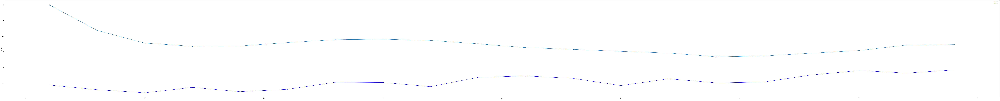

Mayor valor de la figura de mérito en validación con características estandarizadas: 0.583
Valor correspondiente para el hiperparámetro: {'n_neighbors': 39}


In [ ]:
knn('roc_auc')

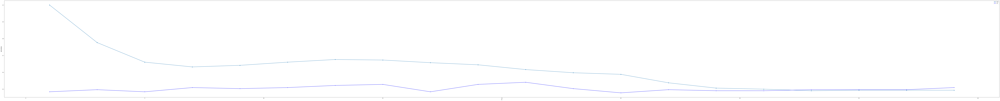

Mayor valor de la figura de mérito en validación con características estandarizadas: 0.541
Valor correspondiente para el hiperparámetro: {'n_neighbors': 21}


In [ ]:
knn('accuracy')

In [ ]:
kNN_clasif_all = KNeighborsClassifier(n_neighbors = 39)
modelo_knn_clasif2 = kNN_clasif_all.fit(X_std_train2, Y_train) 
y_output_knn2 = modelo_knn_clasif2.predict(X_std_test2)
A1_score = accuracy_score(Y_test, y_output_knn2)
f11_score = f1_score(Y_test, y_output_knn2)
r1_score = recall_score(Y_test, y_output_knn2)

print("El valor de accuracy obtenido:", A1_score)
print("La matriz de confusión obtenida:", confusion_matrix(Y_test, y_output_knn2))
print("El valor de f1_score obtenido:", f11_score)
print("El valor de recall es", r1_score)

El valor de accuracy obtenido: 0.475
La matriz de confusión obtenida: [[ 6 17]
 [ 4 13]]
El valor de f1_score obtenido: 0.5531914893617021
El valor de recall es 0.7647058823529411


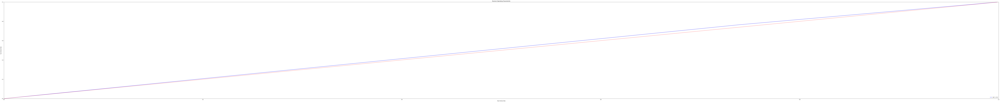

In [ ]:
fpr, tpr, threshold = metrics.roc_curve(Y_test, y_output_knn2)
roc_auc_1 = metrics.auc(fpr, tpr)
# AUC_results.append(roc_auc_1)

# Plot the ROC curve
import matplotlib.pyplot as plt
plt.title('Receiver Operating Characteristic')
plt.plot(fpr, tpr, 'b', label = 'AUC = %0.2f' % roc_auc_1)
plt.legend(loc = 'lower right')
plt.plot([0, 1], [0, 1],'r--')
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.show()

In [ ]:
from sklearn.tree import DecisionTreeClassifier

def arbol(figura):
  # 1. Selección de hiper-parámetros del árbol. En principio, consideraremos sólo la profundidad máxima
  param_grid = {'max_depth': range(1,201)}
  profundidad_grid = np.array(range(1,201))


  grid_arbol_clasif = GridSearchCV(DecisionTreeClassifier(random_state=0), param_grid = param_grid, scoring = figura, cv=3, return_train_score=True)
  modelo_arbol_clasif = grid_arbol_clasif.fit(X_train, Y_train)
  print(grid_arbol_clasif.best_params_)

  perf_train_arbol = np.array(grid_arbol_clasif.cv_results_['mean_train_score'])
  perf_val_arbol = np.array(grid_arbol_clasif.cv_results_['mean_test_score'])

  plt.plot(profundidad_grid,perf_train_arbol,'-o',label="train", linewidth=2)
  plt.plot(profundidad_grid,perf_val_arbol,'-*b',label="val", linewidth=2)
  plt.xlabel('Profundidad',fontsize=14)
  plt.ylabel(figura,fontsize=14)
  plt.legend()
  plt.show()

  print("Mejor valor de la figura de mérito en validación cruzada: {:.3f}".format(grid_arbol_clasif.best_score_))
  print("Mejor valor del hiperparámetro: {}".format(grid_arbol_clasif.best_params_))


{'max_depth': 2}


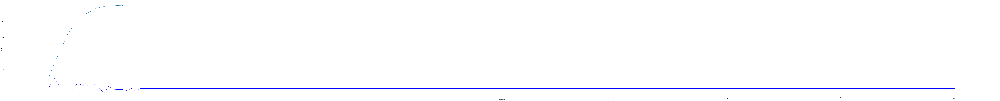

Mejor valor de la figura de mérito en validación cruzada: 0.547
Mejor valor del hiperparámetro: {'max_depth': 2}


In [ ]:
arbol('roc_auc')

{'max_depth': 3}


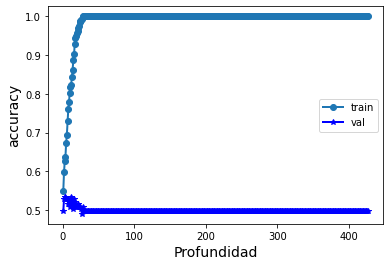

Mejor valor de la figura de mérito en validación cruzada: 0.535
Mejor valor del hiperparámetro: {'max_depth': 3}


In [ ]:
arbol('accuracy')

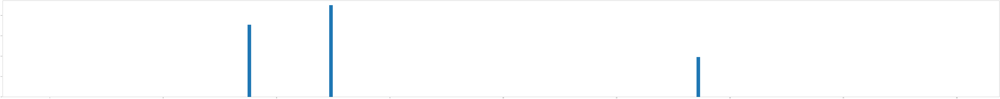

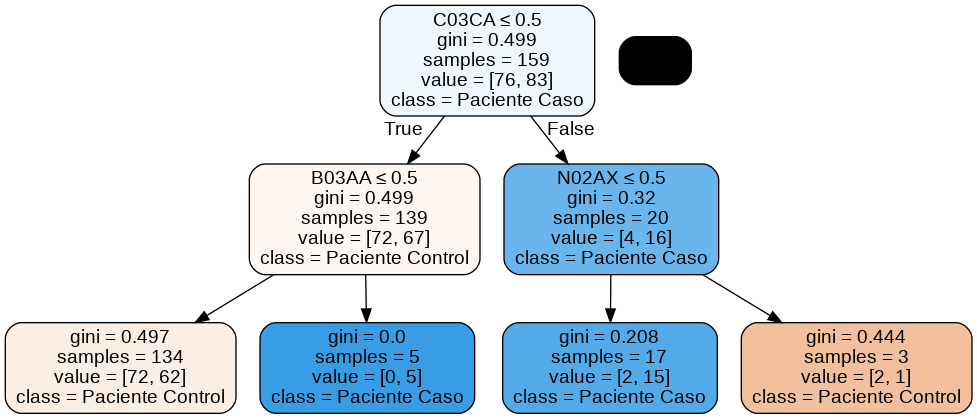

In [ ]:
# 4. Se representa la importancia de cada característica para el árbol diseñado
from matplotlib import pyplot
Arbol_clasif_all = DecisionTreeClassifier(max_depth=2)
modelo_arbol_clasif = Arbol_clasif_all.fit(X_train, Y_train)
y_output_arbol = modelo_arbol_clasif.predict(X_test)
importance_arbol = modelo_arbol_clasif.feature_importances_
pyplot.bar([x for x in range(len(importance_arbol))], importance_arbol)
pyplot.show()

# 5. Se representa gráficamente el modelo de clasificación
from sklearn.tree import export_graphviz
#from sklearn.externals.six import StringIO  
from six import StringIO
from IPython.display import Image  
import pydotplus

dot_data = StringIO()

export_graphviz(modelo_arbol_clasif, out_file=dot_data,  
                filled=True, rounded=True,
                special_characters=True,feature_names = data_final.columns[1:],class_names=['Paciente Control','Paciente Caso'])

graph = pydotplus.graph_from_dot_data(dot_data.getvalue())  
graph.write_png('Tree_Clasif_all.png')
Image(graph.create_png())

In [ ]:
print("El valor de accuracy obtenido:", accuracy_score(Y_test, y_output_arbol))
print("La matriz de confusión obtenida:", confusion_matrix(Y_test, y_output_arbol))
print("El valor de f1_score obtenido:", f1_score(Y_test, y_output_arbol))
print("El valor de recall es", recall_score(Y_test, y_output_arbol))

# A_results.append(accuracy_score(Y_test2, y_output_arbol))
# f1_results.append(f1_score(Y_test2, y_output_arbol))
# S_results.append(recall_score(Y_test2, y_output_arbol))
# MSE_results.append(mean_squared_error(Y_test2, y_output_arbol))

El valor de accuracy obtenido: 0.625
La matriz de confusión obtenida: [[22  1]
 [14  3]]
El valor de f1_score obtenido: 0.2857142857142857
El valor de recall es 0.17647058823529413


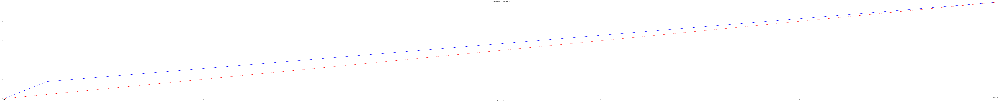

In [ ]:
fpr, tpr, threshold = metrics.roc_curve(Y_test, y_output_arbol)
roc_auc_1 = metrics.auc(fpr, tpr)
# AUC_results.append(roc_auc_1)

# Plot the ROC curve
import matplotlib.pyplot as plt
plt.title('Receiver Operating Characteristic')
plt.plot(fpr, tpr, 'b', label = 'AUC = %0.2f' % roc_auc_1)
plt.legend(loc = 'lower right')
plt.plot([0, 1], [0, 1],'r--')
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.show()

In [ ]:
from sklearn.ensemble import RandomForestClassifier
def RandomForest(figura):
  # 1. Extracción de las dos características de interés para realizar el diseño

  param_grid = {'n_estimators': [10, 20, 30, 40, 50, 100]}
  arboles_grid=[10, 20, 30, 40, 50, 100]

  CV_rfc = GridSearchCV(RandomForestClassifier(max_features= 'sqrt'), param_grid=param_grid, cv= 5, n_jobs=-1, scoring=figura, return_train_score=True)
  CV_rfc.fit(X_std_train2, Y_train)
  print(CV_rfc.best_params_)

  perf_train_rfc = np.array(CV_rfc.cv_results_['mean_train_score'])
  perf_val_rfc = np.array(CV_rfc.cv_results_['mean_test_score'])

  plt.plot(arboles_grid,perf_train_rfc,'-o',label="train", linewidth=2)
  plt.plot(arboles_grid,perf_val_rfc,'-*b',label="val", linewidth=2)
  plt.xlabel('Arboles',fontsize=14)
  plt.ylabel(figura,fontsize=14)
  plt.legend()
  plt.show()


  print("Mejor MSE en validación cruzada: {:.3f}".format(CV_rfc.best_score_))
  print("Mejor valor del hiperparámetro: {}".format(CV_rfc.best_params_))


{'n_estimators': 40}


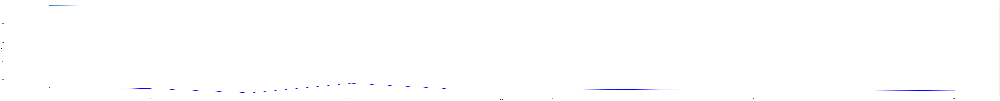

Mejor MSE en validación cruzada: 0.581
Mejor valor del hiperparámetro: {'n_estimators': 40}


In [ ]:
RandomForest('roc_auc')

{'n_estimators': 20}


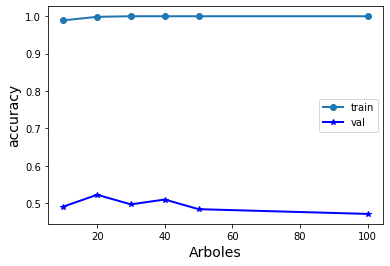

Mejor MSE en validación cruzada: 0.522
Mejor valor del hiperparámetro: {'n_estimators': 20}


In [ ]:
RandomForest('accuracy')

In [ ]:
RF_clasif_all = RandomForestClassifier(n_estimators=40)
modelo_RF_clasif2 = RF_clasif_all.fit(X_std_train2, Y_train) 
y_output_RF = modelo_RF_clasif2.predict(X_std_test2)
print(accuracy_score(Y_test, y_output_RF))
print(confusion_matrix(Y_test, y_output_RF))
print(f1_score(Y_test, y_output_RF))
print(recall_score(Y_test, y_output_RF))

# A_results.append(accuracy_score(Y_test2, y_output_RF))
# f1_results.append(f1_score(Y_test2, y_output_RF))
# S_results.append(recall_score(Y_test2, y_output_RF))
# MSE_results.append(mean_squared_error(Y_test2, y_output_RF))

0.5
[[11 12]
 [ 8  9]]
0.4736842105263158
0.5294117647058824


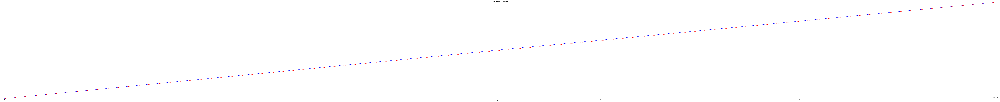

In [ ]:
fpr, tpr, threshold = metrics.roc_curve(Y_test, y_output_RF)
roc_auc_1 = metrics.auc(fpr, tpr)
# AUC_results.append(roc_auc_1)

# Plot the ROC curve
import matplotlib.pyplot as plt
plt.title('Receiver Operating Characteristic')
plt.plot(fpr, tpr, 'b', label = 'AUC = %0.2f' % roc_auc_1)
plt.legend(loc = 'lower right')
plt.plot([0, 1], [0, 1],'r--')
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.show()

# ***SVC***

In [ ]:
from sklearn.svm import SVC


In [ ]:
# Regresión logística con regularización 
from sklearn.linear_model import LogisticRegression
from sklearn import model_selection   
from sklearn import metrics
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split, GridSearchCV

svc=SVC(decision_function_shape='ovo')

# logreg= LogisticRegression(solver='liblinear')
parameters = {'kernel': ['rbf','poly'], 'gamma': [1e-2, 1e-3, 1e-4, 1e-5],
                     'C': [0.001, 0.10, 0.1, 10, 25, 50, 100, 1000]}# l1 lasso l2 ridge
# valor_C=np.array([1e-8,1e-4,1,10,100])
svc=GridSearchCV(svc, parameters, scoring='roc_auc', cv=5, return_train_score=True)

svc.fit(X_std_train2, Y_train) #Entrenamos

# #Evaluamos las prestaciones para el conjunto de entrenamiento, de validación y representamos
roc_log_train = np.array(svc.cv_results_['mean_train_score']) 
roc_loc_val = np.array(svc.cv_results_['mean_test_score'])

# #Pintamos la evolución de nuestro modelo tanto en train como en validación para ver cuál es el mejor hiperparámetro para generalizar
# plt.plot(valor_C,roc_log_train,'-o',label="train", linewidth=2)
# plt.plot(valor_C,roc_loc_val,'-*b',label="val", linewidth=2)
# plt.xlabel('C',fontsize=14)
# plt.ylabel('Roc_auc',fontsize=14)
# plt.legend()
# plt.show()

# Mostramos el mejor valor del parámetro y el score
print("Valor correspondiente para el hiperparámetro: {}".format(svc.best_params_))
print("Mayor valor de la figura de mérito en validación con características estandarizadas: {:.3f}".format(svc.best_score_))


Valor correspondiente para el hiperparámetro: {'C': 25, 'gamma': 0.0001, 'kernel': 'rbf'}
Mayor valor de la figura de mérito en validación con características estandarizadas: 0.585


In [ ]:


svc=SVC(C=25,kernel='rbf',gamma=0.0001,decision_function_shape='ovo')
svc.fit(X_std_train2,Y_train)
y_test_pred=svc.predict(X_std_test2)

In [ ]:
A1_score = accuracy_score(Y_test, y_test_pred)
f11_score = f1_score(Y_test, y_test_pred)
r1_score = recall_score(Y_test, y_test_pred)

print("El valor de accuracy obtenido:", A1_score)
print("La matriz de confusión obtenida:", confusion_matrix(Y_test, y_test_pred))
print("El valor de f1_score obtenido:", f11_score)
print("El valor de recall es", r1_score)

El valor de accuracy obtenido: 0.625
La matriz de confusión obtenida: [[15  8]
 [ 7 10]]
El valor de f1_score obtenido: 0.5714285714285715
El valor de recall es 0.5882352941176471


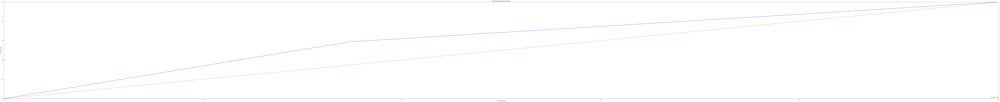

In [ ]:
fpr, tpr, threshold = metrics.roc_curve(Y_test, y_test_pred)
roc_auc_1 = metrics.auc(fpr, tpr)
# AUC_results.append(roc_auc_1)

# Plot the ROC curve
import matplotlib.pyplot as plt
plt.title('Receiver Operating Characteristic')
plt.plot(fpr, tpr, 'b', label = 'AUC = %0.2f' % roc_auc_1)
plt.legend(loc = 'lower right')
plt.plot([0, 1], [0, 1],'r--')
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.show()